## Trying standardization of the data

In [1]:
#Data processing
import os
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
from nptdms import TdmsFile #Process ramping file

#For building ML models
import keras
import keras.models as models
from keras.layers.core import Dense
from keras import regularizers
from sklearn.preprocessing import MinMaxScaler, StandardScaler

np.random.seed(1337) # for reproducibility


Bad key "text.kerning_factor" on line 4 in
/uscms_data/d3/dhoang/miniconda3/lib/python3.7/site-packages/matplotlib/mpl-data/stylelib/_classic_test_patch.mplstyle.
You probably need to get an updated matplotlibrc file from
https://github.com/matplotlib/matplotlib/blob/v3.1.3/matplotlibrc.template
or from the matplotlib source distribution
Using TensorFlow backend.


In [2]:
def load_sensor(dir_path, sensor, time_range = None):
    
    data = pd.DataFrame(data = {sensor: np.load(dir_path + sensor + ".npy"),
                                "time": np.load(dir_path + "time.npy")})
    
    start = min(data["time"])
    end = max(data["time"])
    
    if time_range:
        start = time_range[0]
        end = time_range[1]
    
    
    data = data[(data["time"] > start) & (data["time"] < end)]
   
    %reset -f in
    
    return data[sensor]

def load_time_label(dir_path, time_range, window = 2000, step = 10):
    
    time_label =  np.load(dir_path + "time.npy")
    
    start = min(time_label)
    end = max(time_label)
    
    if time_range:
        start = time_range[0]
        end = time_range[1]
    
    
    time_label = time_label[(time_label > start) & (time_label < end)][window-1::step]
    
    %reset -f in
    
    return time_label

#### Mean of abs(signal)
def generate_mean_data(dir_path, time_range, window = 2000, step = 10):
    #Load the data
    ai0 = load_sensor(dir_path, "ai0", time_range = time_range).abs().rolling(window=window).mean().to_numpy()[window-1::step]
    ai1 = load_sensor(dir_path, "ai1", time_range = time_range).abs().rolling(window=window).mean().to_numpy()[window-1::step]
    ai2 = load_sensor(dir_path, "ai2", time_range = time_range).abs().rolling(window=window).mean().to_numpy()[window-1::step]
    ai3 = load_sensor(dir_path, "ai3", time_range = time_range).abs().rolling(window=window).mean().to_numpy()[window-1::step]
    ai4 = load_sensor(dir_path, "ai4", time_range = time_range).abs().rolling(window=window).mean().to_numpy()[window-1::step]
    
    #Calculate the product
    product = ai0*ai1*ai2*ai3*ai4
    
    #Stack them together
    all_mean = np.vstack((ai0,ai1,ai2,ai3,ai4, product)).transpose()
    
    %reset -f in
    
    return all_mean

#### SD of signal
def generate_sd_data(dir_path, time_range, window = 2000, step = 10):
    #Load the data
    ai0 = load_sensor(dir_path, "ai0", time_range = time_range).rolling(window=window).std().to_numpy()[window-1::step]
    ai1 = load_sensor(dir_path, "ai1", time_range = time_range).rolling(window=window).std().to_numpy()[window-1::step]
    ai2 = load_sensor(dir_path, "ai2", time_range = time_range).rolling(window=window).std().to_numpy()[window-1::step]
    ai3 = load_sensor(dir_path, "ai3", time_range = time_range).rolling(window=window).std().to_numpy()[window-1::step]
    ai4 = load_sensor(dir_path, "ai4", time_range = time_range).rolling(window=window).std().to_numpy()[window-1::step]
    
    #Calculate the product
    product = ai0*ai1*ai2*ai3*ai4
    
    #Stack them together
    all_sd = np.vstack((ai0,ai1,ai2,ai3,ai4, product)).transpose()
    
    %reset -f in
    
    return all_sd

#### Thresholded zero crossings
def zero_crossings(array):
    
    #Set values outside of range (0.001, 0.1) = 0
    array[abs(array) > 0.1] = 0
    array[abs(array) < 0.005] = 0
    
    #Calculate number of zero-crossing points, normalized by the window size
    zero_crossings = ((array[:-1] * array[1:]) < 0).sum()/array.size
    
    return zero_crossings


def generate_crossings_data(dir_path, time_range = None, window = 5000, step = 10):
    
    #Load the data
    ai0 = load_sensor(dir_path, "ai0", time_range = time_range).rolling(window=window).apply(zero_crossings, raw = True).to_numpy()[window-1::step]
    ai1 = load_sensor(dir_path, "ai1", time_range = time_range).rolling(window=window).apply(zero_crossings, raw = True).to_numpy()[window-1::step]
    ai2 = load_sensor(dir_path, "ai2", time_range = time_range).rolling(window=window).apply(zero_crossings, raw = True).to_numpy()[window-1::step]
    ai3 = load_sensor(dir_path, "ai3", time_range = time_range).rolling(window=window).apply(zero_crossings, raw = True).to_numpy()[window-1::step]
    ai4 = load_sensor(dir_path, "ai4", time_range = time_range).rolling(window=window).apply(zero_crossings, raw = True).to_numpy()[window-1::step]
    
    product = ai0*ai1*ai2*ai3*ai4
    
    #Stack them together
    all_crossings = np.vstack((ai0,ai1,ai2,ai3,ai4, product)).transpose()
    
    %reset -f in
    
    return all_crossings


def generate_data(dir_path, time_range, window = 2000, thres_win = 25000, step = 10):
    
    #Selection index due to using different window
    selection_index = int((thres_win - window)/step)
    
    moving_mean = generate_mean_data(dir_path, time_range, window = window, step = step)[selection_index:]
    moving_sd = generate_sd_data(dir_path, time_range, window = window, step = step)[selection_index:]
    #moving_thres_crossings = generate_crossings_data(dir_path, time_range, window = thres_win, step = step)
    time_label = load_time_label(dir_path, time_range, window = window, step = step)[selection_index:]
    
    all_data = np.concatenate((moving_mean, moving_sd), axis = 1)
    
    print("All data's shape: ", all_data.shape)
    
    %reset -f in
    
    return all_data, time_label

#####-------INCREMENTAL LEARNING IMPLEMENTATION-------######

def create_model():
    
    #================BUILD THE MODEL====================
    # Simple model
    # Simple model
    model = models.Sequential()

    model.add(Dense(6, activation = 'elu', kernel_initializer='glorot_uniform',
                    kernel_regularizer=regularizers.l2(0.0),
                    input_dim=12))

    model.add(Dense(3,activation='elu',
                    kernel_initializer='glorot_uniform'))

    model.add(Dense(6,activation='elu',
                    kernel_initializer='glorot_uniform'))

    model.add(Dense(12,
                    kernel_initializer='glorot_uniform'))

    model.compile(loss='mse',optimizer='adam')


    return model

def train(current_weights, X, time_axis, time_range, prev_mean, past_scaler):
    """Take a model, train it in the appropritate time range, return the new weights
    and its reconstruction loss distribution"""
    
    print("Training for section: ", time_range)
    #Select the appropriate time
    start_index = None
    
    if time_range[0] is not None:
        start_index = np.argmax(time_axis > time_range[0])
    else:
        start_index = 0
    
    if time_range[1] == 0:
        end_index = None
    else:
        end_index = np.argmax(time_axis > time_range[1])
    
    X_train = np.copy(X[start_index:end_index])
    
    #Create model
    model = create_model()
    
    if current_weights:
        model.set_weights(current_weights)
    
    #Scaler initiation
    scaler = past_scaler
    scaler.partial_fit(X_train)
    X_train = scaler.transform(X_train)
    
    #Train the model and extract new weights
    model.fit(X_train, X_train,
              batch_size=2000,
              epochs=20, verbose = 0)
    
    new_weights = model.get_weights()
    
    #Evaluate the losses and update the distribution
    X_pred = model.predict(X_train)
    loss = np.mean(np.abs(X_pred-X_train), axis = 1)
    
    #Take the mean of the log loss and update the mean threshold
    current_mean = np.mean(np.log10(loss))
    
    print("Finished training, mean of the log(loss) is: ", current_mean)
    
    return new_weights, current_mean, scaler

def trigger(current_weights, X, time_axis, time_range, prev_mean, scaler):
    
    print("Triggering for section: ", time_range)
    print("Using this mean for triggering:", prev_mean)
    
    #Select the appropriate time
    start_index = None
    
    if time_range[0] is not None:
        start_index = np.argmax(time_axis > time_range[0])
    else:
        start_index = 0
    
    if time_range[1] == 0:
        end_index = None
    else:
        end_index = np.argmax(time_axis > time_range[1])
    
    X_test = np.copy(X[start_index:end_index])
    X_test = scaler.transform(X_test) #Scale the current data
    
    time_test = time_axis[start_index:end_index]
    
    #Create model
    model = create_model()
    
    if current_weights:
        model.set_weights(current_weights)
    
    #Find the test loss (doing this in parallel for the sake of simulation), but in a practical system
    #Ideally we need to do inference every single data point come in
    X_pred_test = model.predict(X_test)
    test_loss = np.mean(np.abs(X_pred_test-X_test), axis = 1)
    
    #Quantify how much each data point is far away from the distribution
    log_test_loss = np.log10(test_loss) - prev_mean
    
    #Plot the reconstruction loss just to check
    plt.figure(figsize=(20,2))
    plt.plot(time_test, test_loss)
    plt.title("Reconstruction loss on {}".format(time_range))
    plt.xlabel("Time [s]")
    plt.show()
    
    #Find the trigger time
    trigger_index = np.argmax(log_test_loss > 2.5)
    
    if  trigger_index != 0:
        #Plot the triggered time
        plt.figure(figsize=(20,2))
        plt.plot(time_test, log_test_loss, color = "firebrick")
        plt.title("Log reconstruction loss on {}".format(time_range))
        plt.xlabel("Time [s]")
        
        #Trigger time
        plt.vlines(time_test[trigger_index], log_test_loss.min(), log_test_loss.max(), color = "blue", linestyles = "dashed", label = "Trigger time")
        plt.legend(loc = "upper left")
        plt.show()
        
        return time_test[trigger_index]
    
    else:
        return None
    
    return trigger_time
    

def simulation(dir_path, section_size, time_range):
    
    #Load data and create the model
    X, time_axis = generate_data(dir_path, time_range = time_range, window = 2000, step = 10)
    
    #For updating model
    current_weights = None
    new_weights = None
    
    #For keeping track of distribution history
    prev_mean = None
    updated_mean = None
    
    #Keeping track of scaler after training
    past_scaler = None
    
    #Create a model
    model = create_model()
    
    #Initialize the scaler
    scaler = MinMaxScaler()
    
    #Calculate number of sections
    num_section = int(abs(time_range[0])/section_size)
    print("Number of sections:", num_section)
    
    #Sequentially go through the data
    for i in range(num_section):
        
        print("Entering sections: ", (-section_size*(num_section - i), -section_size*(num_section - i - 1)))
        print("-------->")
        
        if i == 0:
            continue
        elif i == 1:
            #Train on the first segment
            time_range = (None, -section_size*(num_section - i))
            new_weights, updated_mean, new_scaler = train(current_weights, X, time_axis, time_range, prev_mean, scaler)
        else:
            #Set the model to newly trained model
            model.set_weights(new_weights)
            
            #Set previous distrubution to the newly trained disttribution
            prev_mean = updated_mean
            scaler = new_scaler #Set the scaler as well
            
            #Selecting appropriate time range for training and triggering
            train_time_range = (-section_size*(num_section - i + 1), -section_size*(num_section - i))
            trigger_time_range = (-section_size*(num_section - i), -section_size*(num_section - i - 1))
            
            #Train and predict simutaneously
            new_weights, updated_mean, new_scaler = train(current_weights, X, time_axis, train_time_range, prev_mean, scaler)
            trigger_time = trigger(current_weights, X, time_axis, trigger_time_range, prev_mean, scaler)
            
            if trigger_time:
                print("Triggered at: ", trigger_time)
                return trigger_time
        
        print("<--------")

--------------

## Trigger simulation — 2.5 log threshold — (-100,0)s range — SDs + Means — MinMaxScaler

In [3]:
simulation("./data/Ramp4/", 5, (-100,0))

Flushing input history
Flushing input history
Flushing input history
Flushing input history


KeyboardInterrupt: 

In [ ]:
simulation("./data/Ramp5/", 5, (-100,0))

In [ ]:
simulation("./data/Ramp12d/", 5, (-100,0))

In [ ]:
simulation("./data/Ramp19/", 5, (-100,0))

In [ ]:
simulation("./data/Ramp20/", 5, (-100,0))

In [ ]:
simulation("./data/Ramp21/", 5, (-100,0))

In [ ]:
simulation("./data/Ramp22/", 5, (-100,0))

Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
All data's shape:  (497500, 12)
Flushing input history
Number of sections: 10
Entering sections:  (-50, -45)
-------->
Entering sections:  (-45, -40)
-------->
Training for section:  (None, -45)
Finished training, mean of the log(loss) is:  -1.7012787499951962
<--------
Entering sections:  (-40, -35)
-------->
Training for section:  (-45, -40)
Finished training, mean of the log(loss) is:  -1.81601057701732
Triggering for section:  (-40, -35)
Using this mean for triggering: -1.7012787499951962


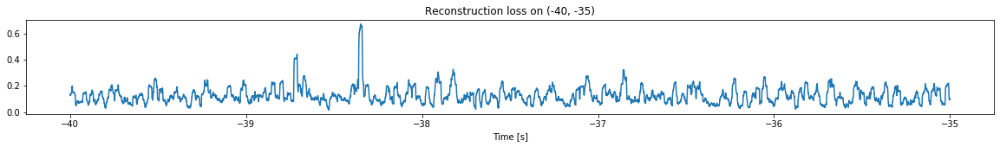

<--------
Entering sections:  (-35, -30)
-------->
Training for section:  (-40, -35)
Finished training, mean of the log(loss) is:  -1.7719835822081187
Triggering for section:  (-35, -30)
Using this mean for triggering: -1.81601057701732


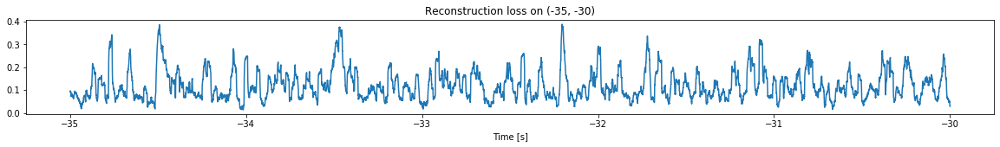

<--------
Entering sections:  (-30, -25)
-------->
Training for section:  (-35, -30)
Finished training, mean of the log(loss) is:  -1.7546963841863457
Triggering for section:  (-30, -25)
Using this mean for triggering: -1.7719835822081187


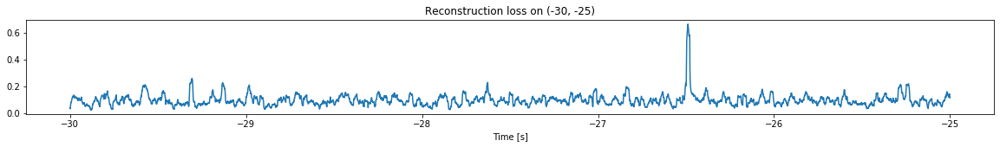

<--------
Entering sections:  (-25, -20)
-------->
Training for section:  (-30, -25)
Finished training, mean of the log(loss) is:  -1.7515097266048198
Triggering for section:  (-25, -20)
Using this mean for triggering: -1.7546963841863457


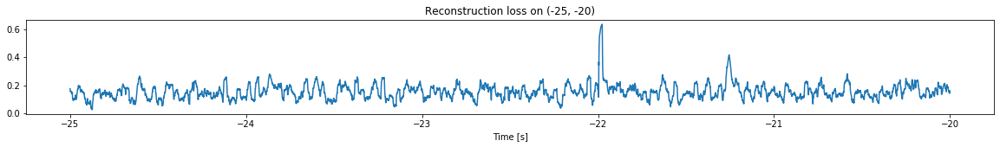

<--------
Entering sections:  (-20, -15)
-------->
Training for section:  (-25, -20)
Finished training, mean of the log(loss) is:  -1.7739329828255361
Triggering for section:  (-20, -15)
Using this mean for triggering: -1.7515097266048198


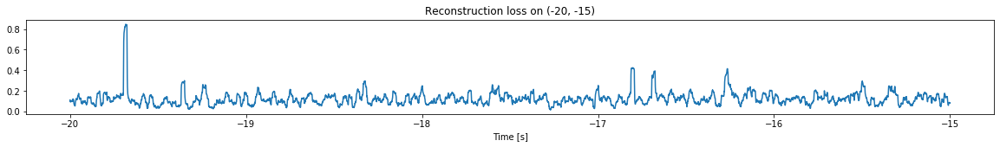

<--------
Entering sections:  (-15, -10)
-------->
Training for section:  (-20, -15)
Finished training, mean of the log(loss) is:  -1.7748695155009537
Triggering for section:  (-15, -10)
Using this mean for triggering: -1.7739329828255361


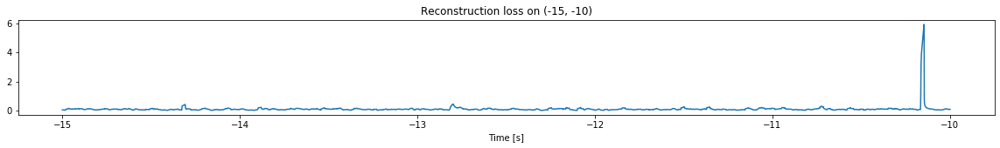

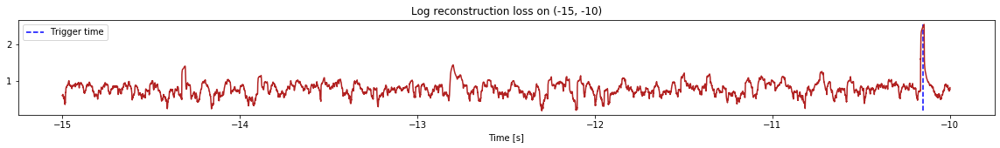

Triggered at:  -10.1504


-10.1504

In [4]:
simulation("./data/Ramp23/", 5, (-50,0))

In [ ]:
simulation("./data/Ramp24/", 5, (-100,0))

Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history


In [ ]:
simulation("./data/Ramp25/", 5, (-100,0))

In [ ]:
simulation("./data/Ramp26/", 5, (-100,0))

In [ ]:
simulation("./data/Ramp27/", 5, (-100,0))

In [ ]:
simulation("./data/Ramp28/", 5, (-100,0))

In [ ]:
simulation("./data/Ramp29/", 5, (-100,0))

In [ ]:
simulation("./data/Ramp30/", 5, (-100,0))

----------

## Trigger simulation — 2.5 log threshold — (-300,0)s range — SDs + Means — StandardScaler

Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
All data's shape:  (2997500, 12)
Flushing input history
Number of sections: 60
Entering sections:  (-300, -295)
-------->
Entering sections:  (-295, -290)
-------->
Training for section:  (None, -295)
Finished training, mean of the log(loss) is:  -0.6325930167034632
<--------
Entering sections:  (-290, -285)
-------->
Training for section:  (-295, -290)
Finished training, mean of the log(loss) is:  -0.6576026545662892
Triggering for section:  (-290, -285)
Using this mean for triggering: -0.6325930167034632


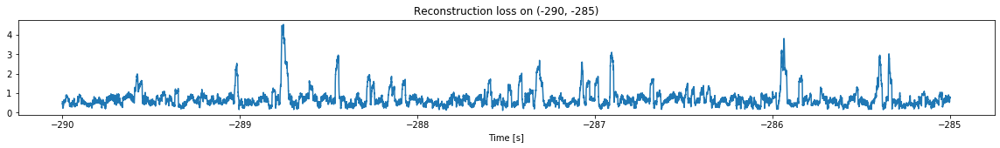

<--------
Entering sections:  (-285, -280)
-------->
Training for section:  (-290, -285)
Finished training, mean of the log(loss) is:  -0.6197161539399932
Triggering for section:  (-285, -280)
Using this mean for triggering: -0.6576026545662892


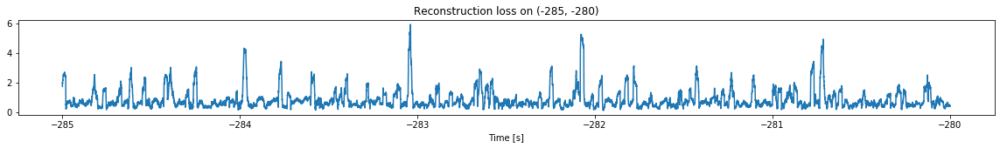

<--------
Entering sections:  (-280, -275)
-------->
Training for section:  (-285, -280)
Finished training, mean of the log(loss) is:  -0.5853529980454482
Triggering for section:  (-280, -275)
Using this mean for triggering: -0.6197161539399932


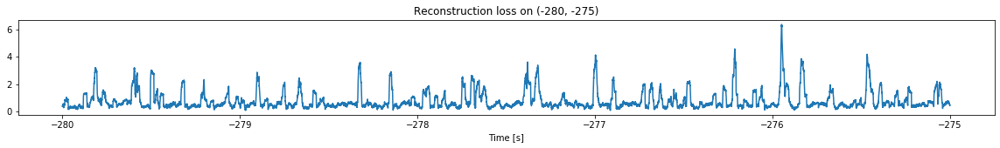

<--------
Entering sections:  (-275, -270)
-------->
Training for section:  (-280, -275)
Finished training, mean of the log(loss) is:  -0.5830142858894504
Triggering for section:  (-275, -270)
Using this mean for triggering: -0.5853529980454482


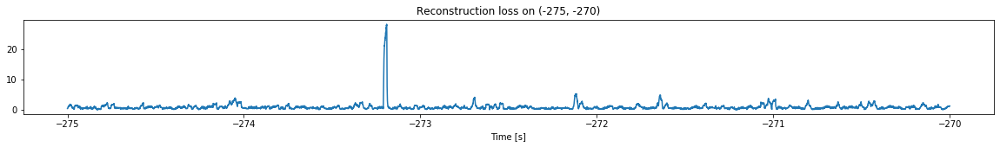

<--------
Entering sections:  (-270, -265)
-------->
Training for section:  (-275, -270)
Finished training, mean of the log(loss) is:  -0.45914377221712677
Triggering for section:  (-270, -265)
Using this mean for triggering: -0.5830142858894504


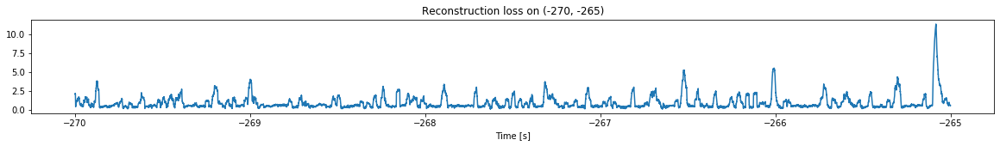

<--------
Entering sections:  (-265, -260)
-------->
Training for section:  (-270, -265)
Finished training, mean of the log(loss) is:  -0.57307945442549
Triggering for section:  (-265, -260)
Using this mean for triggering: -0.45914377221712677


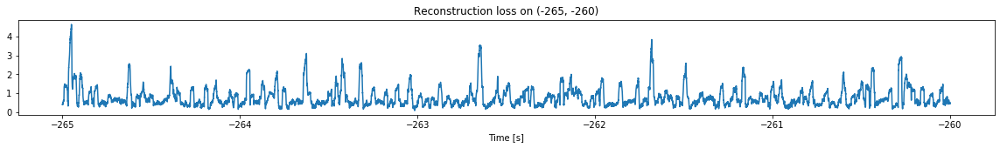

<--------
Entering sections:  (-260, -255)
-------->
Training for section:  (-265, -260)
Finished training, mean of the log(loss) is:  -0.6095446434533471
Triggering for section:  (-260, -255)
Using this mean for triggering: -0.57307945442549


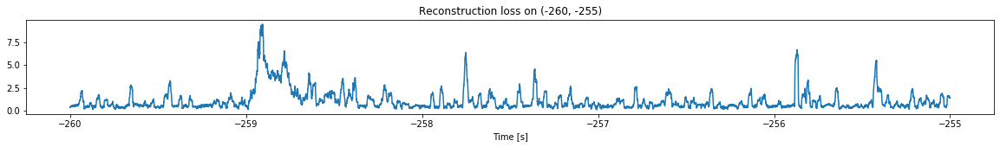

<--------
Entering sections:  (-255, -250)
-------->
Training for section:  (-260, -255)
Finished training, mean of the log(loss) is:  -0.4578002697984703
Triggering for section:  (-255, -250)
Using this mean for triggering: -0.6095446434533471


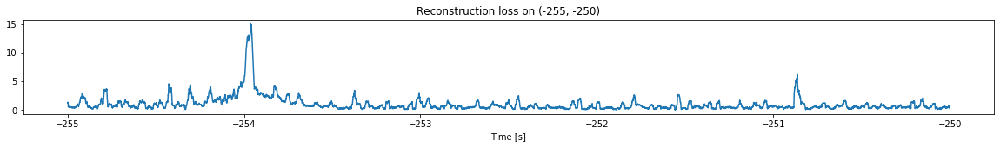

<--------
Entering sections:  (-250, -245)
-------->
Training for section:  (-255, -250)
Finished training, mean of the log(loss) is:  -0.4614888517729899
Triggering for section:  (-250, -245)
Using this mean for triggering: -0.4578002697984703


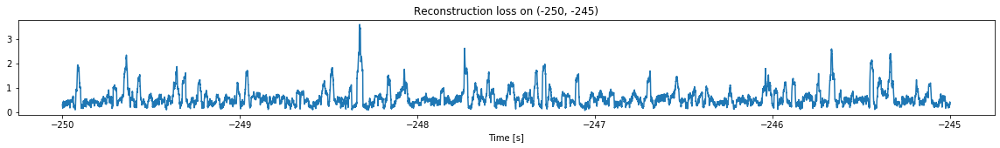

<--------
Entering sections:  (-245, -240)
-------->
Training for section:  (-250, -245)
Finished training, mean of the log(loss) is:  -0.6061099445977405
Triggering for section:  (-245, -240)
Using this mean for triggering: -0.4614888517729899


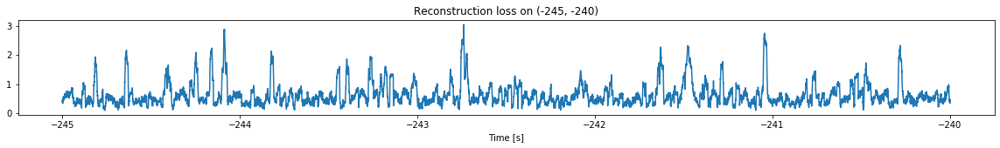

<--------
Entering sections:  (-240, -235)
-------->
Training for section:  (-245, -240)
Finished training, mean of the log(loss) is:  -0.5900230441885277
Triggering for section:  (-240, -235)
Using this mean for triggering: -0.6061099445977405


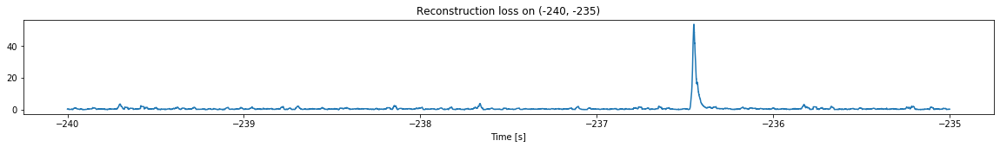

<--------
Entering sections:  (-235, -230)
-------->
Training for section:  (-240, -235)
Finished training, mean of the log(loss) is:  -0.5599527598235429
Triggering for section:  (-235, -230)
Using this mean for triggering: -0.5900230441885277


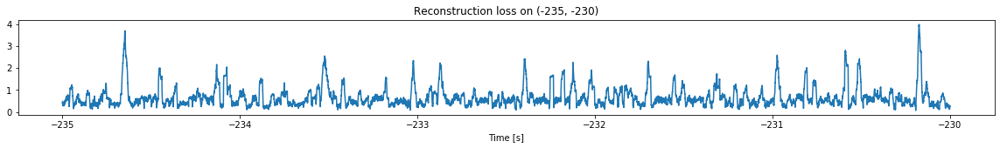

<--------
Entering sections:  (-230, -225)
-------->
Training for section:  (-235, -230)
Finished training, mean of the log(loss) is:  -0.5990541917190482
Triggering for section:  (-230, -225)
Using this mean for triggering: -0.5599527598235429


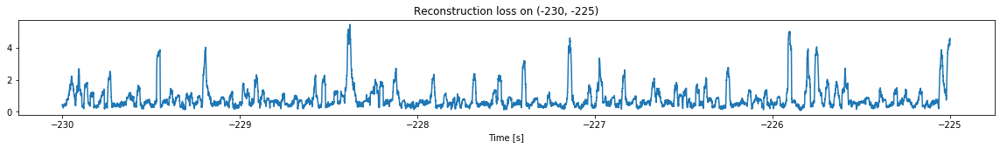

<--------
Entering sections:  (-225, -220)
-------->
Training for section:  (-230, -225)
Finished training, mean of the log(loss) is:  -0.5810016650462567
Triggering for section:  (-225, -220)
Using this mean for triggering: -0.5990541917190482


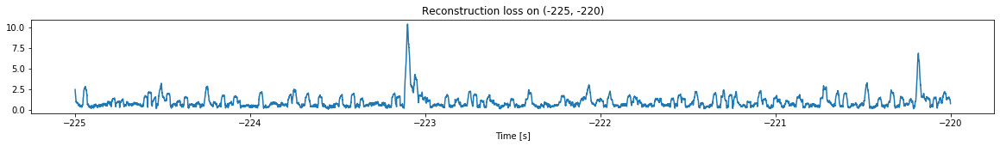

<--------
Entering sections:  (-220, -215)
-------->
Training for section:  (-225, -220)
Finished training, mean of the log(loss) is:  -0.5523320102172642
Triggering for section:  (-220, -215)
Using this mean for triggering: -0.5810016650462567


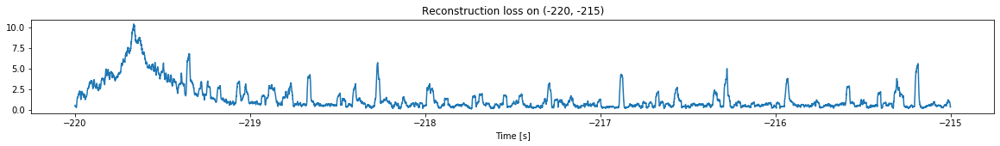

<--------
Entering sections:  (-215, -210)
-------->
Training for section:  (-220, -215)
Finished training, mean of the log(loss) is:  -0.4243175757618709
Triggering for section:  (-215, -210)
Using this mean for triggering: -0.5523320102172642


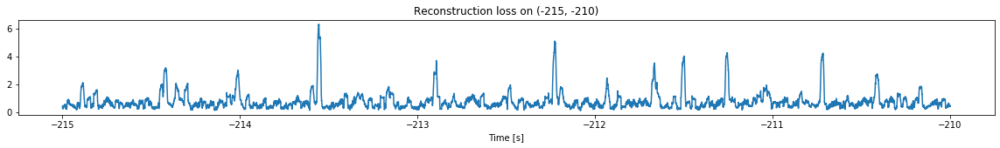

<--------
Entering sections:  (-210, -205)
-------->
Training for section:  (-215, -210)
Finished training, mean of the log(loss) is:  -0.5938657341685827
Triggering for section:  (-210, -205)
Using this mean for triggering: -0.4243175757618709


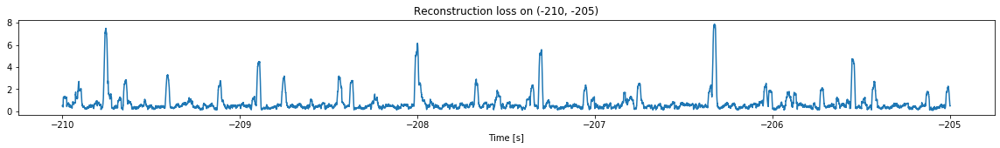

<--------
Entering sections:  (-205, -200)
-------->
Training for section:  (-210, -205)
Finished training, mean of the log(loss) is:  -0.5615205967724488
Triggering for section:  (-205, -200)
Using this mean for triggering: -0.5938657341685827


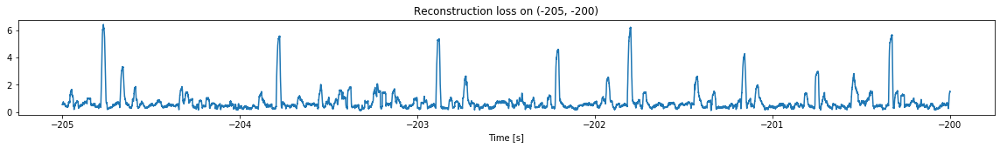

<--------
Entering sections:  (-200, -195)
-------->
Training for section:  (-205, -200)
Finished training, mean of the log(loss) is:  -0.6274369995702684
Triggering for section:  (-200, -195)
Using this mean for triggering: -0.5615205967724488


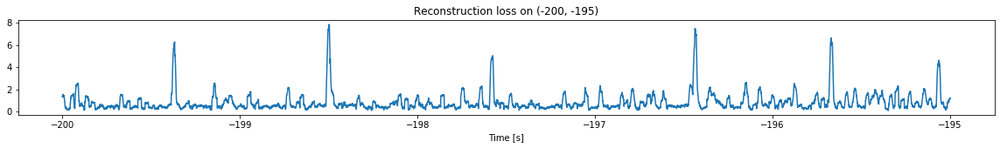

<--------
Entering sections:  (-195, -190)
-------->
Training for section:  (-200, -195)
Finished training, mean of the log(loss) is:  -0.5907604708081572
Triggering for section:  (-195, -190)
Using this mean for triggering: -0.6274369995702684


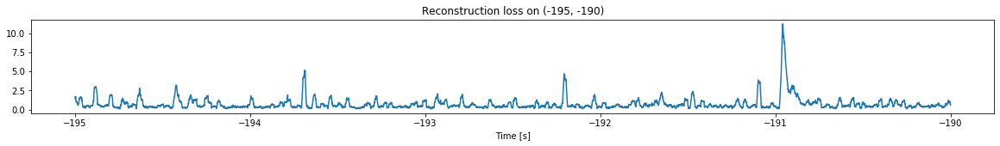

<--------
Entering sections:  (-190, -185)
-------->
Training for section:  (-195, -190)
Finished training, mean of the log(loss) is:  -0.6050525165590687
Triggering for section:  (-190, -185)
Using this mean for triggering: -0.5907604708081572


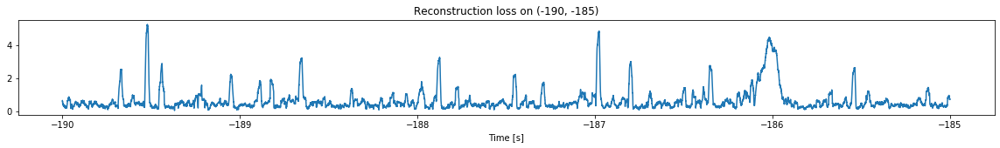

<--------
Entering sections:  (-185, -180)
-------->
Training for section:  (-190, -185)
Finished training, mean of the log(loss) is:  -0.6285685916099457
Triggering for section:  (-185, -180)
Using this mean for triggering: -0.6050525165590687


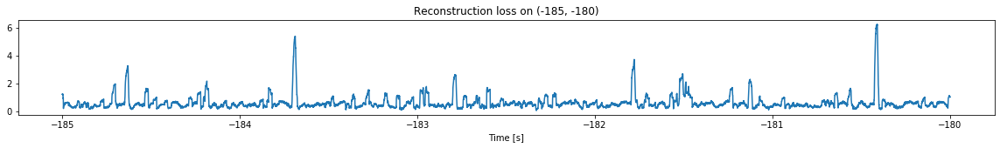

<--------
Entering sections:  (-180, -175)
-------->
Training for section:  (-185, -180)
Finished training, mean of the log(loss) is:  -0.723680590599391
Triggering for section:  (-180, -175)
Using this mean for triggering: -0.6285685916099457


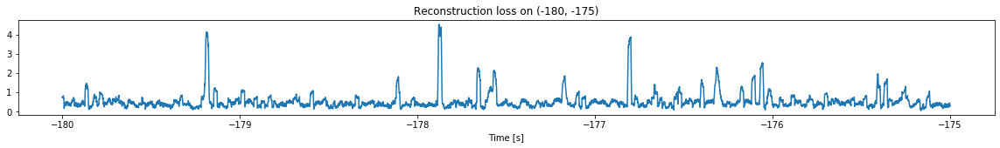

<--------
Entering sections:  (-175, -170)
-------->
Training for section:  (-180, -175)
Finished training, mean of the log(loss) is:  -0.7276803404691867
Triggering for section:  (-175, -170)
Using this mean for triggering: -0.723680590599391


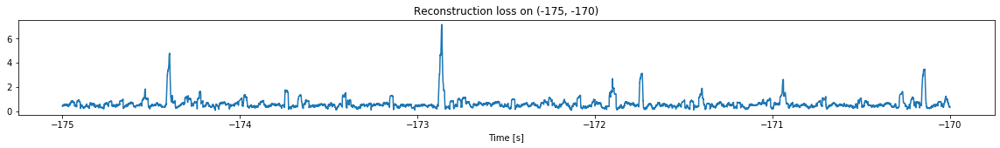

<--------
Entering sections:  (-170, -165)
-------->
Training for section:  (-175, -170)
Finished training, mean of the log(loss) is:  -0.7752542555786038
Triggering for section:  (-170, -165)
Using this mean for triggering: -0.7276803404691867


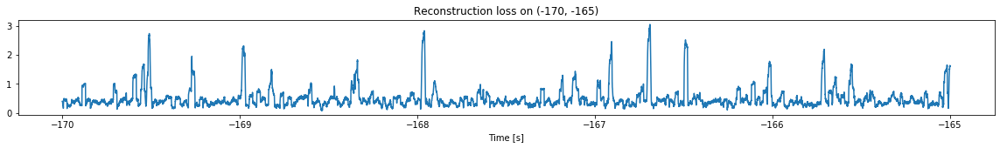

<--------
Entering sections:  (-165, -160)
-------->
Training for section:  (-170, -165)
Finished training, mean of the log(loss) is:  -0.7621033519099493
Triggering for section:  (-165, -160)
Using this mean for triggering: -0.7752542555786038


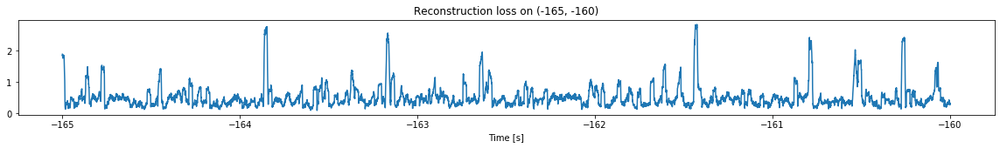

<--------
Entering sections:  (-160, -155)
-------->
Training for section:  (-165, -160)
Finished training, mean of the log(loss) is:  -0.7097011511197331
Triggering for section:  (-160, -155)
Using this mean for triggering: -0.7621033519099493


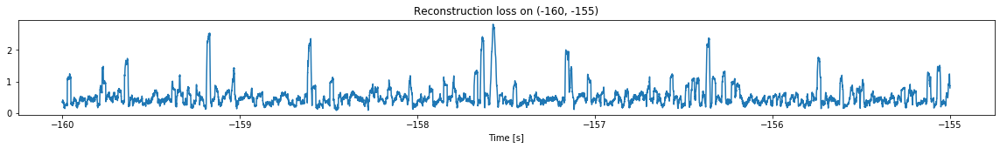

<--------
Entering sections:  (-155, -150)
-------->
Training for section:  (-160, -155)
Finished training, mean of the log(loss) is:  -0.7192006440696286
Triggering for section:  (-155, -150)
Using this mean for triggering: -0.7097011511197331


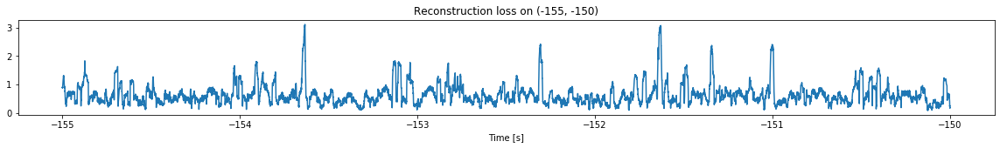

<--------
Entering sections:  (-150, -145)
-------->
Training for section:  (-155, -150)
Finished training, mean of the log(loss) is:  -0.7521947829673036
Triggering for section:  (-150, -145)
Using this mean for triggering: -0.7192006440696286


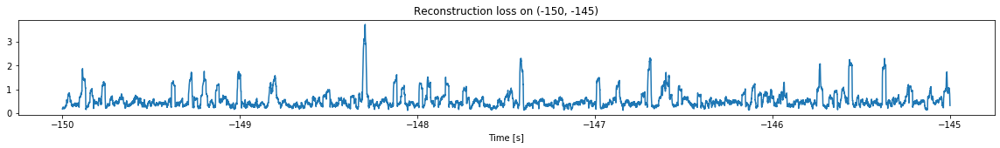

<--------
Entering sections:  (-145, -140)
-------->
Training for section:  (-150, -145)
Finished training, mean of the log(loss) is:  -0.7351612990313143
Triggering for section:  (-145, -140)
Using this mean for triggering: -0.7521947829673036


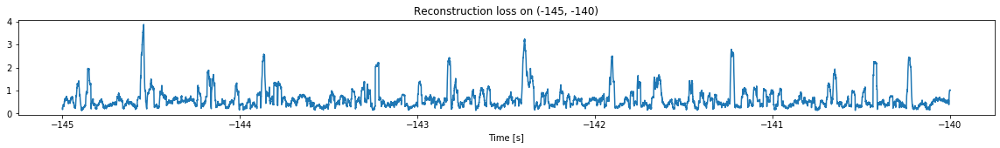

<--------
Entering sections:  (-140, -135)
-------->
Training for section:  (-145, -140)
Finished training, mean of the log(loss) is:  -0.7207657832192036
Triggering for section:  (-140, -135)
Using this mean for triggering: -0.7351612990313143


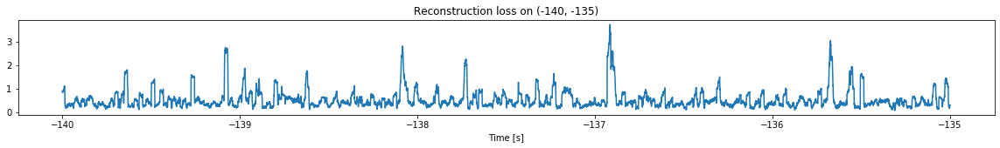

<--------
Entering sections:  (-135, -130)
-------->
Training for section:  (-140, -135)
Finished training, mean of the log(loss) is:  -0.755351086650217
Triggering for section:  (-135, -130)
Using this mean for triggering: -0.7207657832192036


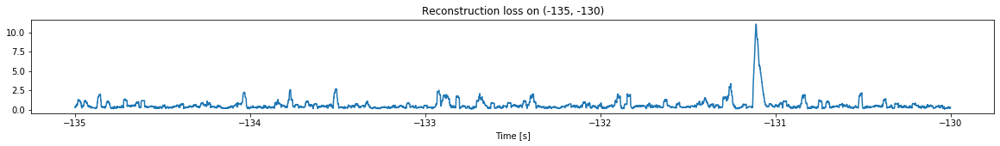

<--------
Entering sections:  (-130, -125)
-------->
Training for section:  (-135, -130)
Finished training, mean of the log(loss) is:  -0.6884813380466867
Triggering for section:  (-130, -125)
Using this mean for triggering: -0.755351086650217


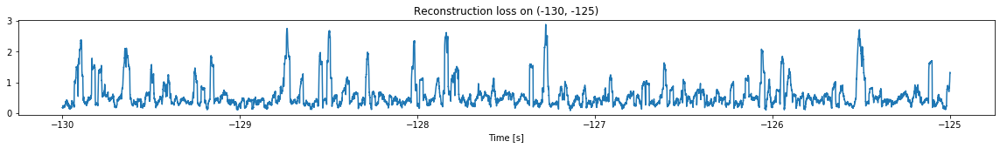

<--------
Entering sections:  (-125, -120)
-------->
Training for section:  (-130, -125)
Finished training, mean of the log(loss) is:  -0.7104288376705272
Triggering for section:  (-125, -120)
Using this mean for triggering: -0.6884813380466867


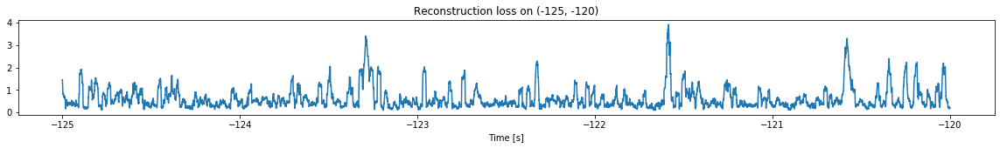

<--------
Entering sections:  (-120, -115)
-------->
Training for section:  (-125, -120)
Finished training, mean of the log(loss) is:  -0.7508968789797512
Triggering for section:  (-120, -115)
Using this mean for triggering: -0.7104288376705272


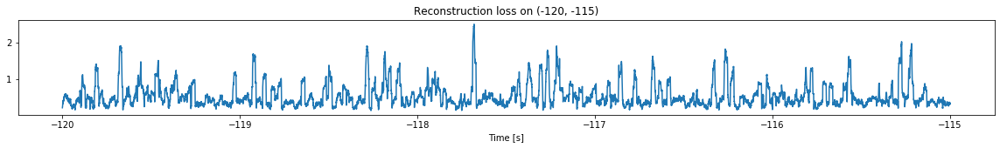

<--------
Entering sections:  (-115, -110)
-------->
Training for section:  (-120, -115)
Finished training, mean of the log(loss) is:  -0.720472511906904
Triggering for section:  (-115, -110)
Using this mean for triggering: -0.7508968789797512


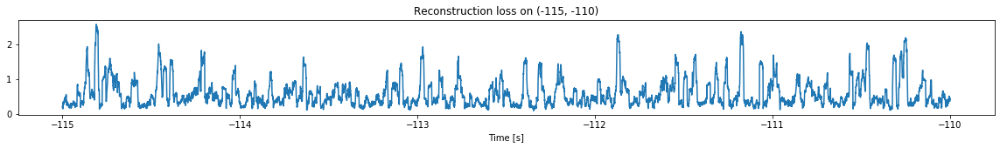

<--------
Entering sections:  (-110, -105)
-------->
Training for section:  (-115, -110)
Finished training, mean of the log(loss) is:  -0.6956686384908779
Triggering for section:  (-110, -105)
Using this mean for triggering: -0.720472511906904


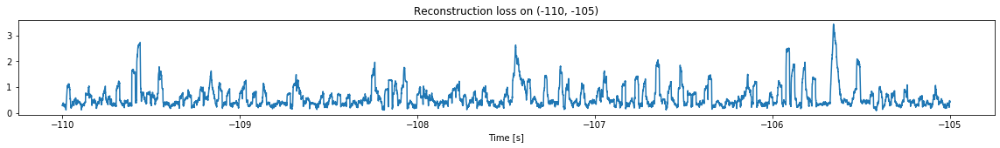

<--------
Entering sections:  (-105, -100)
-------->
Training for section:  (-110, -105)
Finished training, mean of the log(loss) is:  -0.6982725186911832
Triggering for section:  (-105, -100)
Using this mean for triggering: -0.6956686384908779


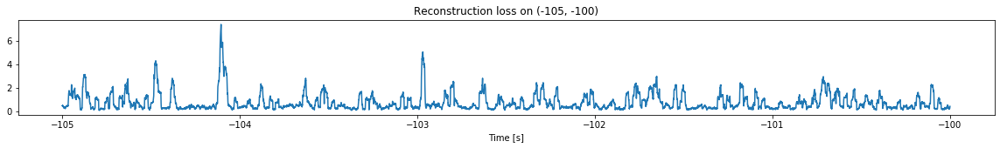

<--------
Entering sections:  (-100, -95)
-------->
Training for section:  (-105, -100)
Finished training, mean of the log(loss) is:  -0.674324109388176
Triggering for section:  (-100, -95)
Using this mean for triggering: -0.6982725186911832


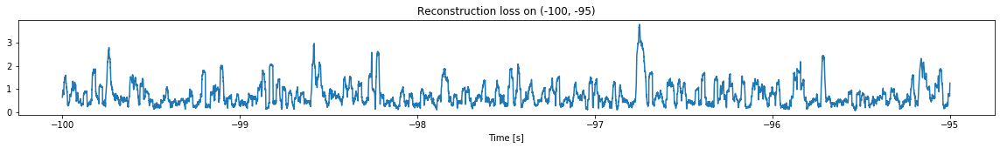

<--------
Entering sections:  (-95, -90)
-------->
Training for section:  (-100, -95)
Finished training, mean of the log(loss) is:  -0.6698395810448508
Triggering for section:  (-95, -90)
Using this mean for triggering: -0.674324109388176


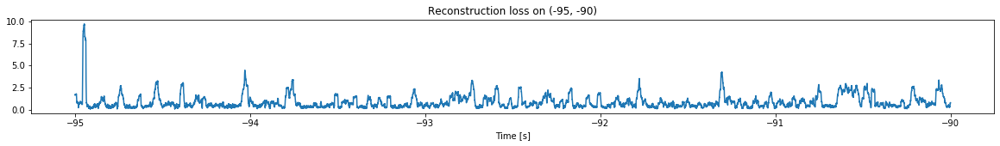

<--------
Entering sections:  (-90, -85)
-------->
Training for section:  (-95, -90)
Finished training, mean of the log(loss) is:  -0.6167956622338693
Triggering for section:  (-90, -85)
Using this mean for triggering: -0.6698395810448508


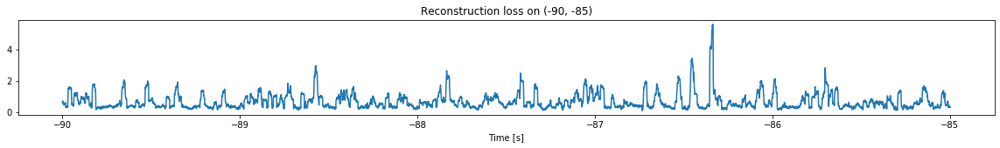

<--------
Entering sections:  (-85, -80)
-------->
Training for section:  (-90, -85)
Finished training, mean of the log(loss) is:  -0.6229181030054861
Triggering for section:  (-85, -80)
Using this mean for triggering: -0.6167956622338693


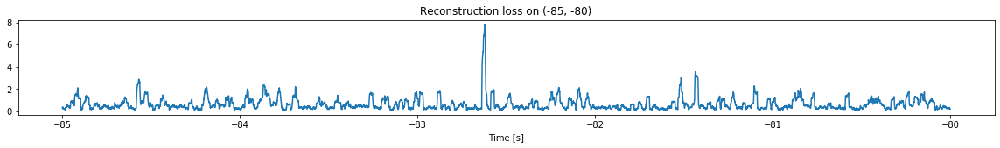

<--------
Entering sections:  (-80, -75)
-------->
Training for section:  (-85, -80)
Finished training, mean of the log(loss) is:  -0.6716003319361956
Triggering for section:  (-80, -75)
Using this mean for triggering: -0.6229181030054861


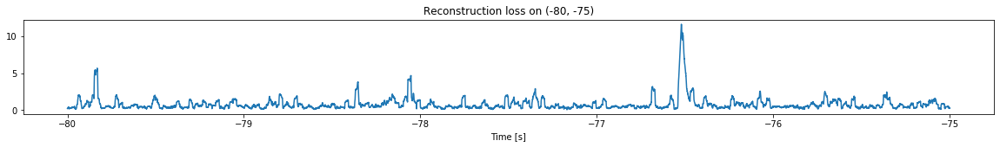

<--------
Entering sections:  (-75, -70)
-------->
Training for section:  (-80, -75)
Finished training, mean of the log(loss) is:  -0.5950460711603892
Triggering for section:  (-75, -70)
Using this mean for triggering: -0.6716003319361956


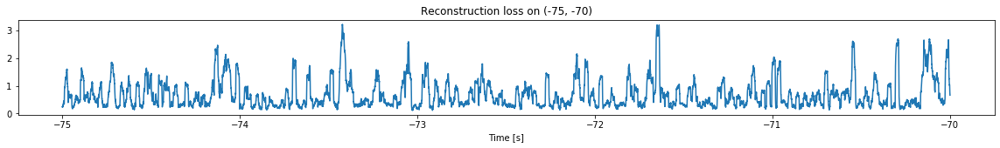

<--------
Entering sections:  (-70, -65)
-------->
Training for section:  (-75, -70)
Finished training, mean of the log(loss) is:  -0.7066376729472607
Triggering for section:  (-70, -65)
Using this mean for triggering: -0.5950460711603892


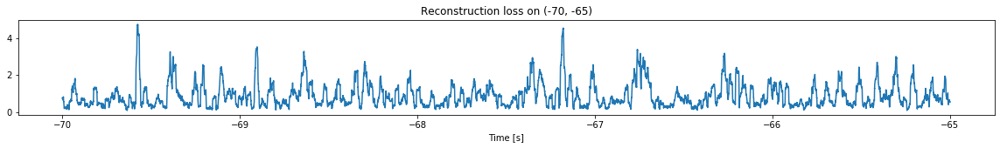

<--------
Entering sections:  (-65, -60)
-------->
Training for section:  (-70, -65)
Finished training, mean of the log(loss) is:  -0.6470564259689437
Triggering for section:  (-65, -60)
Using this mean for triggering: -0.7066376729472607


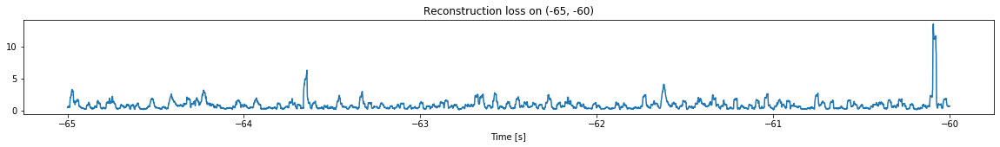

<--------
Entering sections:  (-60, -55)
-------->
Training for section:  (-65, -60)
Finished training, mean of the log(loss) is:  -0.5697441199851805
Triggering for section:  (-60, -55)
Using this mean for triggering: -0.6470564259689437


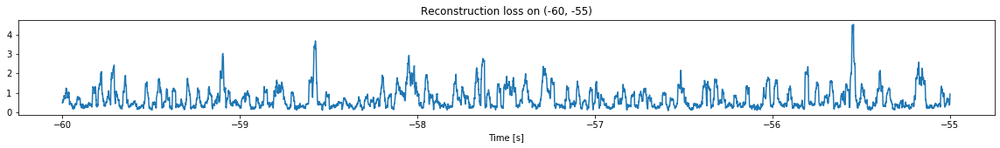

<--------
Entering sections:  (-55, -50)
-------->
Training for section:  (-60, -55)
Finished training, mean of the log(loss) is:  -0.5859568261776866
Triggering for section:  (-55, -50)
Using this mean for triggering: -0.5697441199851805


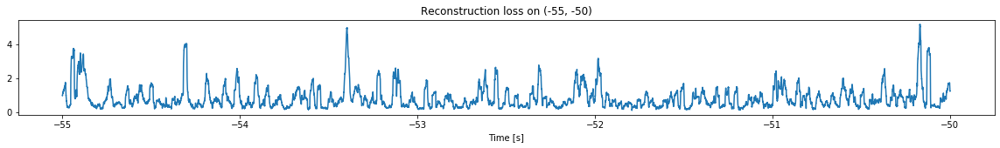

<--------
Entering sections:  (-50, -45)
-------->
Training for section:  (-55, -50)
Finished training, mean of the log(loss) is:  -0.6311788773799215
Triggering for section:  (-50, -45)
Using this mean for triggering: -0.5859568261776866


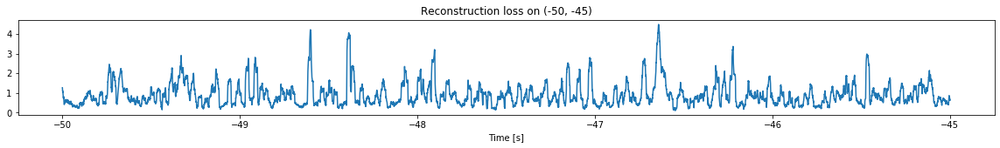

<--------
Entering sections:  (-45, -40)
-------->
Training for section:  (-50, -45)
Finished training, mean of the log(loss) is:  -0.6460200110703346
Triggering for section:  (-45, -40)
Using this mean for triggering: -0.6311788773799215


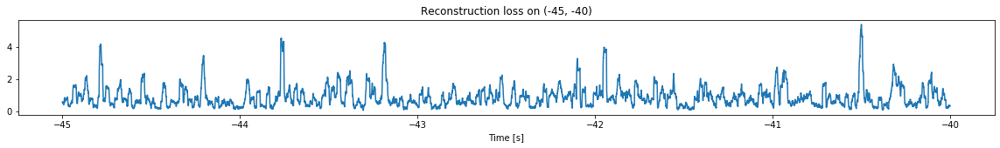

<--------
Entering sections:  (-40, -35)
-------->
Training for section:  (-45, -40)
Finished training, mean of the log(loss) is:  -0.6094523567905528
Triggering for section:  (-40, -35)
Using this mean for triggering: -0.6460200110703346


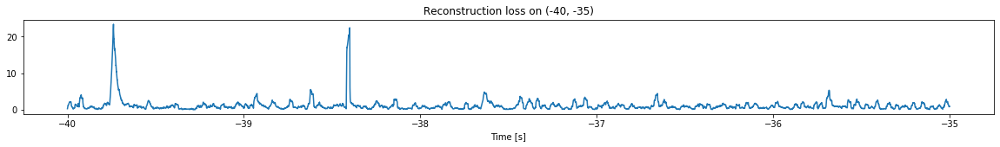

<--------
Entering sections:  (-35, -30)
-------->
Training for section:  (-40, -35)
Finished training, mean of the log(loss) is:  -0.49845685709183085
Triggering for section:  (-35, -30)
Using this mean for triggering: -0.6094523567905528


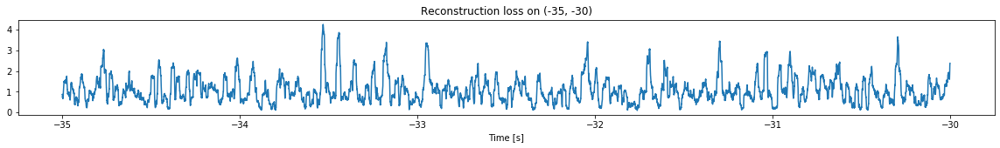

<--------
Entering sections:  (-30, -25)
-------->
Training for section:  (-35, -30)
Finished training, mean of the log(loss) is:  -0.5741564533664602
Triggering for section:  (-30, -25)
Using this mean for triggering: -0.49845685709183085


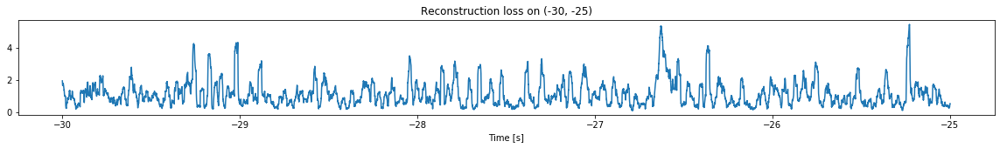

<--------
Entering sections:  (-25, -20)
-------->
Training for section:  (-30, -25)
Finished training, mean of the log(loss) is:  -0.5273545457263097
Triggering for section:  (-25, -20)
Using this mean for triggering: -0.5741564533664602


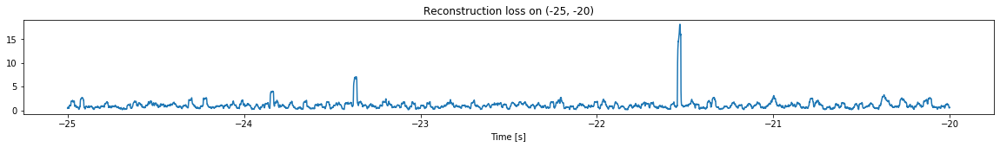

<--------
Entering sections:  (-20, -15)
-------->
Training for section:  (-25, -20)
Finished training, mean of the log(loss) is:  -0.4920782130266901
Triggering for section:  (-20, -15)
Using this mean for triggering: -0.5273545457263097


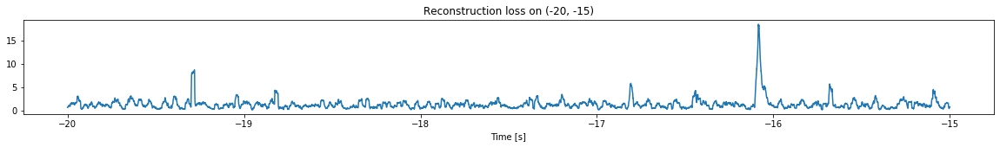

<--------
Entering sections:  (-15, -10)
-------->
Training for section:  (-20, -15)
Finished training, mean of the log(loss) is:  -0.4824812889577953
Triggering for section:  (-15, -10)
Using this mean for triggering: -0.4920782130266901


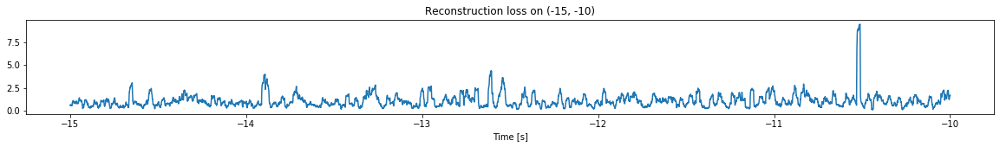

<--------
Entering sections:  (-10, -5)
-------->
Training for section:  (-15, -10)
Finished training, mean of the log(loss) is:  -0.474473290709736
Triggering for section:  (-10, -5)
Using this mean for triggering: -0.4824812889577953


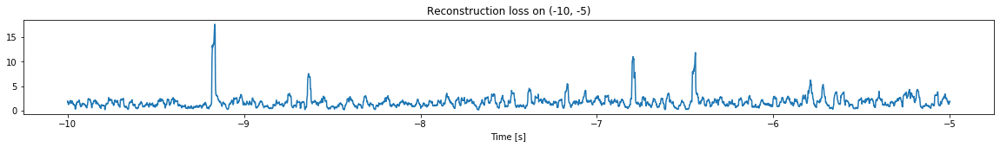

<--------
Entering sections:  (-5, 0)
-------->
Training for section:  (-10, -5)
Finished training, mean of the log(loss) is:  -0.32660288160896866
Triggering for section:  (-5, 0)
Using this mean for triggering: -0.474473290709736


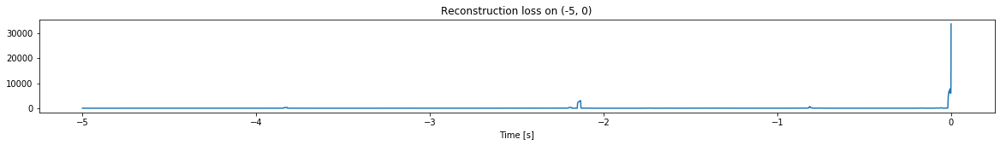

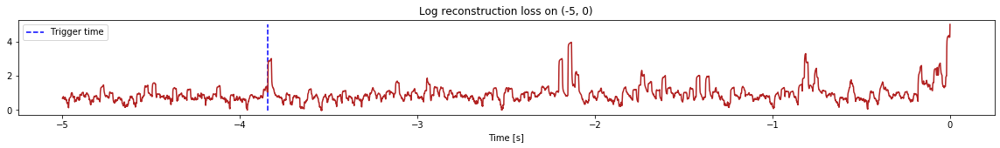

Triggered at:  -3.8414898


-3.8414898

In [3]:
simulation("./data/Ramp4/", 5, (-300,0))

Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
All data's shape:  (2997500, 12)
Flushing input history
Number of sections: 60
Entering sections:  (-300, -295)
-------->
Entering sections:  (-295, -290)
-------->
Training for section:  (None, -295)
Finished training, mean of the log(loss) is:  -0.6492466853729777
<--------
Entering sections:  (-290, -285)
-------->
Training for section:  (-295, -290)
Finished training, mean of the log(loss) is:  -0.6711950496439
Triggering for section:  (-290, -285)
Using this mean for triggering: -0.6492466853729777


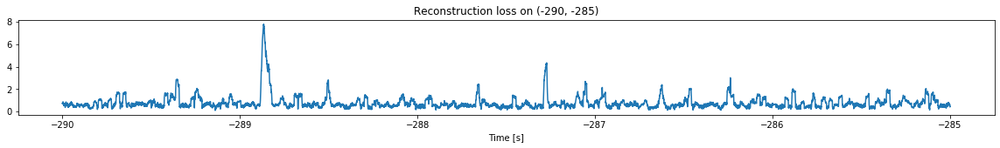

<--------
Entering sections:  (-285, -280)
-------->
Training for section:  (-290, -285)
Finished training, mean of the log(loss) is:  -0.599208850682338
Triggering for section:  (-285, -280)
Using this mean for triggering: -0.6711950496439


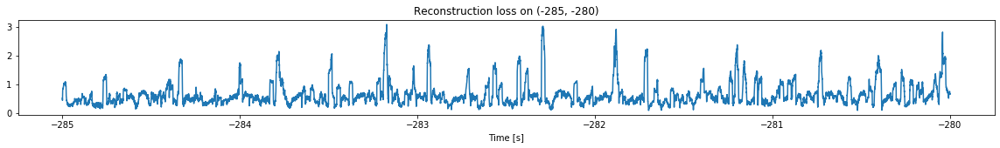

<--------
Entering sections:  (-280, -275)
-------->
Training for section:  (-285, -280)
Finished training, mean of the log(loss) is:  -0.6739116234332647
Triggering for section:  (-280, -275)
Using this mean for triggering: -0.599208850682338


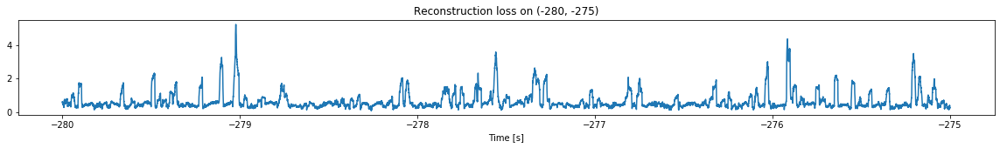

<--------
Entering sections:  (-275, -270)
-------->
Training for section:  (-280, -275)
Finished training, mean of the log(loss) is:  -0.6374697066075109
Triggering for section:  (-275, -270)
Using this mean for triggering: -0.6739116234332647


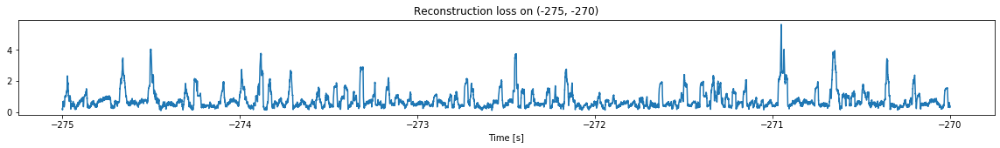

<--------
Entering sections:  (-270, -265)
-------->
Training for section:  (-275, -270)
Finished training, mean of the log(loss) is:  -0.6092799553970486
Triggering for section:  (-270, -265)
Using this mean for triggering: -0.6374697066075109


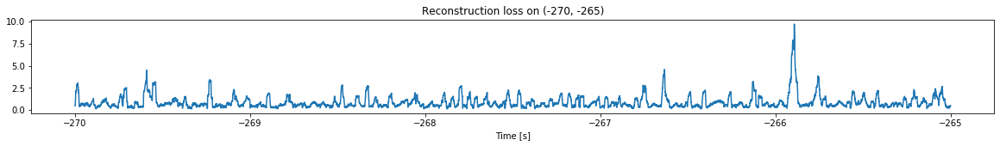

<--------
Entering sections:  (-265, -260)
-------->
Training for section:  (-270, -265)
Finished training, mean of the log(loss) is:  -0.5217519802156025
Triggering for section:  (-265, -260)
Using this mean for triggering: -0.6092799553970486


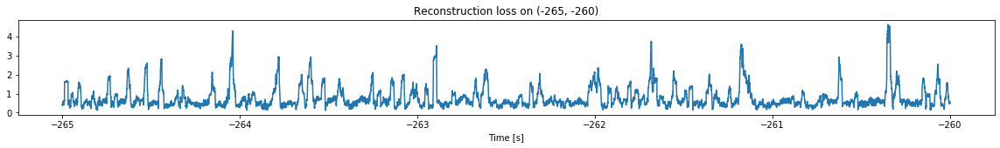

<--------
Entering sections:  (-260, -255)
-------->
Training for section:  (-265, -260)
Finished training, mean of the log(loss) is:  -0.5449196666415641
Triggering for section:  (-260, -255)
Using this mean for triggering: -0.5217519802156025


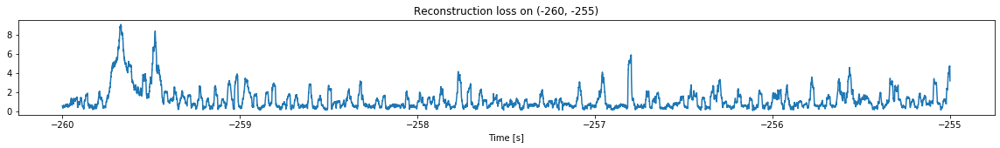

<--------
Entering sections:  (-255, -250)
-------->
Training for section:  (-260, -255)
Finished training, mean of the log(loss) is:  -0.46733084281440385
Triggering for section:  (-255, -250)
Using this mean for triggering: -0.5449196666415641


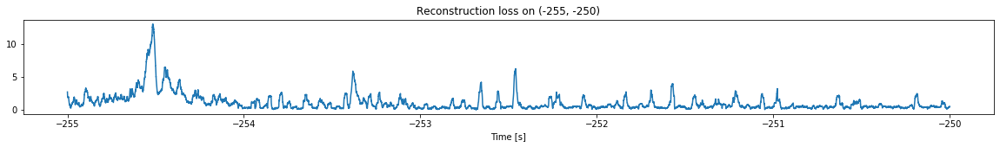

<--------
Entering sections:  (-250, -245)
-------->
Training for section:  (-255, -250)
Finished training, mean of the log(loss) is:  -0.5022368154998312
Triggering for section:  (-250, -245)
Using this mean for triggering: -0.46733084281440385


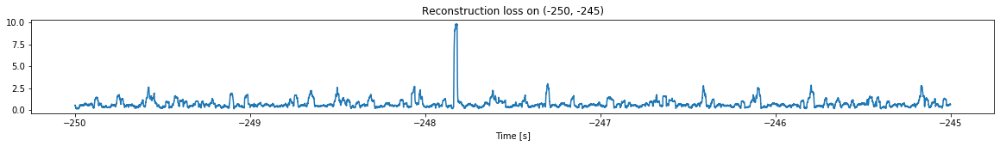

<--------
Entering sections:  (-245, -240)
-------->
Training for section:  (-250, -245)
Finished training, mean of the log(loss) is:  -0.5302133030854513
Triggering for section:  (-245, -240)
Using this mean for triggering: -0.5022368154998312


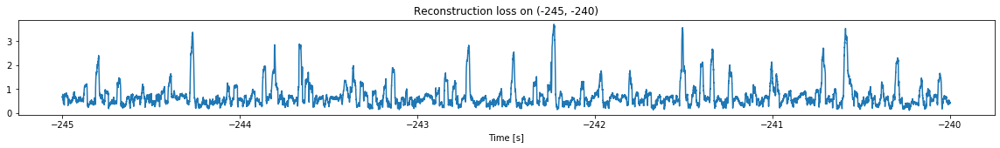

<--------
Entering sections:  (-240, -235)
-------->
Training for section:  (-245, -240)
Finished training, mean of the log(loss) is:  -0.5806332297622798
Triggering for section:  (-240, -235)
Using this mean for triggering: -0.5302133030854513


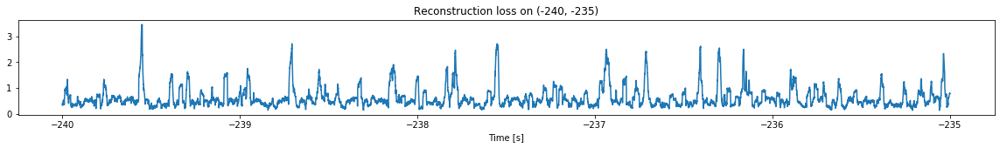

<--------
Entering sections:  (-235, -230)
-------->
Training for section:  (-240, -235)
Finished training, mean of the log(loss) is:  -0.5641325188609898
Triggering for section:  (-235, -230)
Using this mean for triggering: -0.5806332297622798


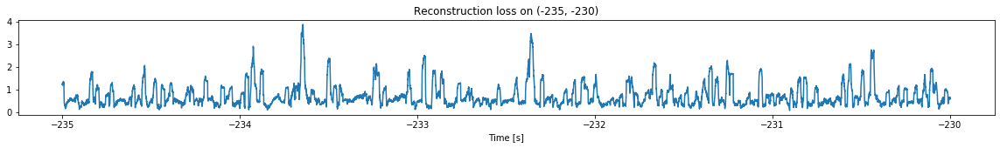

<--------
Entering sections:  (-230, -225)
-------->
Training for section:  (-235, -230)
Finished training, mean of the log(loss) is:  -0.6030986448980342
Triggering for section:  (-230, -225)
Using this mean for triggering: -0.5641325188609898


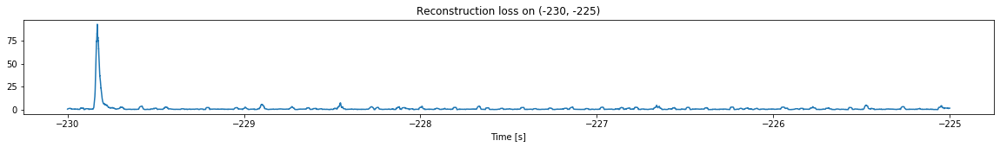

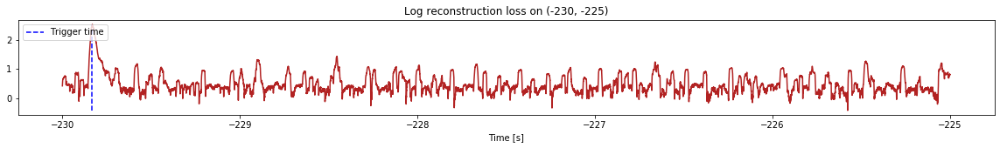

Triggered at:  -229.83228


-229.83228

In [4]:
simulation("./data/Ramp5/", 5, (-300,0))

Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
All data's shape:  (2997500, 12)
Flushing input history
Number of sections: 60
Entering sections:  (-300, -295)
-------->
Entering sections:  (-295, -290)
-------->
Training for section:  (None, -295)
Finished training, mean of the log(loss) is:  -0.57191762221336
<--------
Entering sections:  (-290, -285)
-------->
Training for section:  (-295, -290)
Finished training, mean of the log(loss) is:  -0.6698970711793691
Triggering for section:  (-290, -285)
Using this mean for triggering: -0.57191762221336


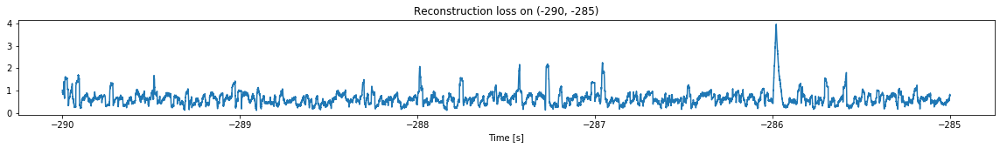

<--------
Entering sections:  (-285, -280)
-------->
Training for section:  (-290, -285)
Finished training, mean of the log(loss) is:  -0.6111640363818753
Triggering for section:  (-285, -280)
Using this mean for triggering: -0.6698970711793691


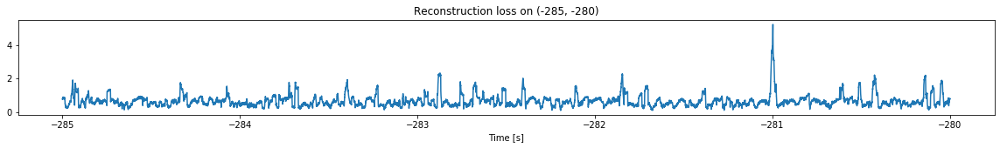

<--------
Entering sections:  (-280, -275)
-------->
Training for section:  (-285, -280)
Finished training, mean of the log(loss) is:  -0.6250822596525927
Triggering for section:  (-280, -275)
Using this mean for triggering: -0.6111640363818753


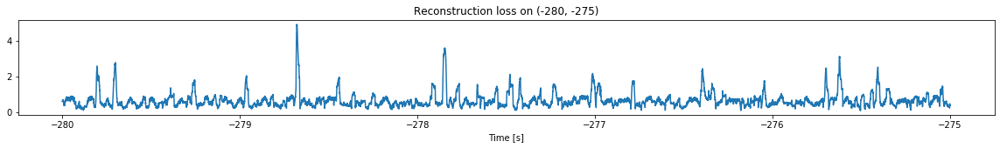

<--------
Entering sections:  (-275, -270)
-------->
Training for section:  (-280, -275)
Finished training, mean of the log(loss) is:  -0.6101574116770223
Triggering for section:  (-275, -270)
Using this mean for triggering: -0.6250822596525927


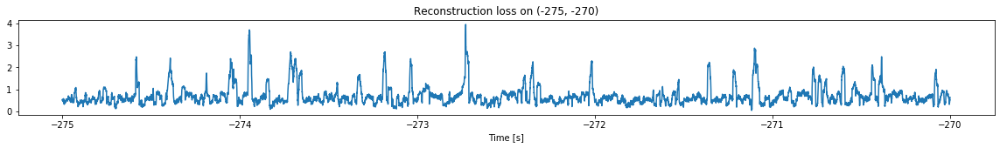

<--------
Entering sections:  (-270, -265)
-------->
Training for section:  (-275, -270)
Finished training, mean of the log(loss) is:  -0.663438078853139
Triggering for section:  (-270, -265)
Using this mean for triggering: -0.6101574116770223


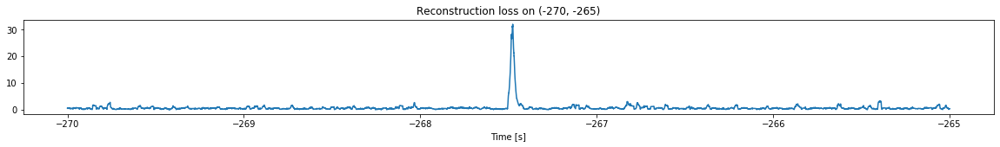

<--------
Entering sections:  (-265, -260)
-------->
Training for section:  (-270, -265)
Finished training, mean of the log(loss) is:  -0.6224912441032271
Triggering for section:  (-265, -260)
Using this mean for triggering: -0.663438078853139


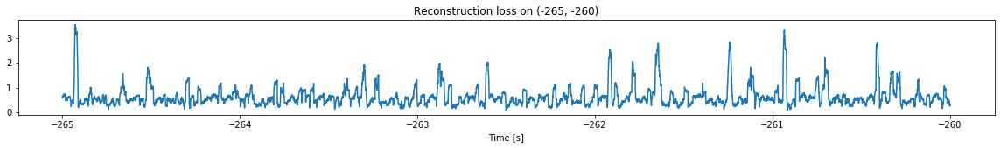

<--------
Entering sections:  (-260, -255)
-------->
Training for section:  (-265, -260)
Finished training, mean of the log(loss) is:  -0.59976375756409
Triggering for section:  (-260, -255)
Using this mean for triggering: -0.6224912441032271


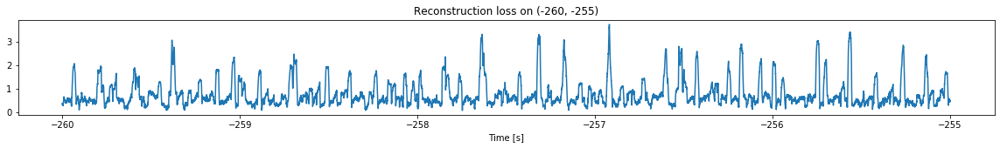

<--------
Entering sections:  (-255, -250)
-------->
Training for section:  (-260, -255)
Finished training, mean of the log(loss) is:  -0.5538269167258397
Triggering for section:  (-255, -250)
Using this mean for triggering: -0.59976375756409


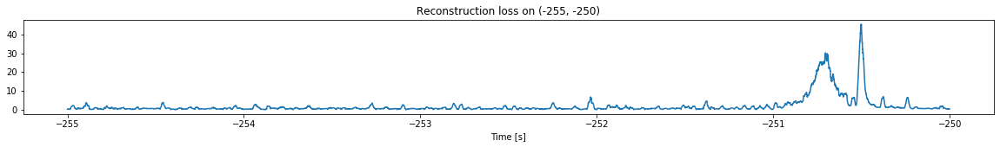

<--------
Entering sections:  (-250, -245)
-------->
Training for section:  (-255, -250)
Finished training, mean of the log(loss) is:  -0.5277367708171269
Triggering for section:  (-250, -245)
Using this mean for triggering: -0.5538269167258397


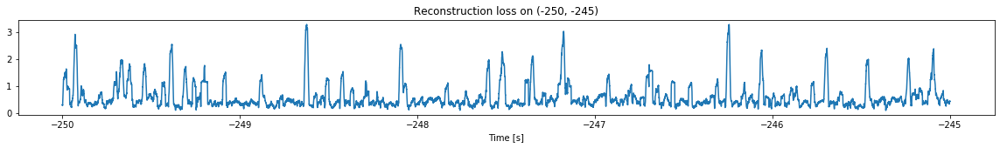

<--------
Entering sections:  (-245, -240)
-------->
Training for section:  (-250, -245)
Finished training, mean of the log(loss) is:  -0.6686664179142986
Triggering for section:  (-245, -240)
Using this mean for triggering: -0.5277367708171269


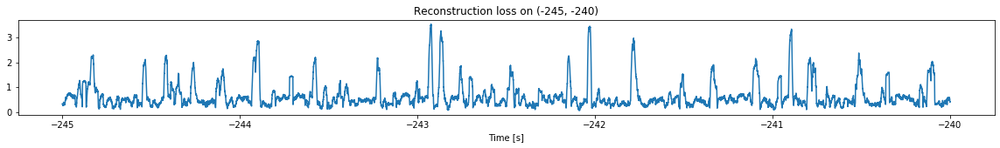

<--------
Entering sections:  (-240, -235)
-------->
Training for section:  (-245, -240)
Finished training, mean of the log(loss) is:  -0.7019736429561458
Triggering for section:  (-240, -235)
Using this mean for triggering: -0.6686664179142986


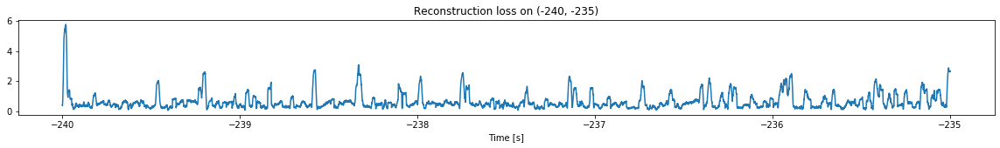

<--------
Entering sections:  (-235, -230)
-------->
Training for section:  (-240, -235)
Finished training, mean of the log(loss) is:  -0.7109875158216525
Triggering for section:  (-235, -230)
Using this mean for triggering: -0.7019736429561458


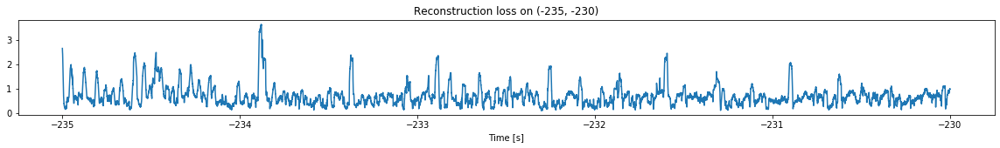

<--------
Entering sections:  (-230, -225)
-------->
Training for section:  (-235, -230)
Finished training, mean of the log(loss) is:  -0.6939683701479447
Triggering for section:  (-230, -225)
Using this mean for triggering: -0.7109875158216525


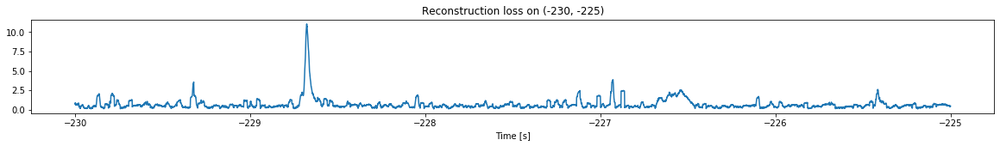

<--------
Entering sections:  (-225, -220)
-------->
Training for section:  (-230, -225)
Finished training, mean of the log(loss) is:  -0.7074054773118854
Triggering for section:  (-225, -220)
Using this mean for triggering: -0.6939683701479447


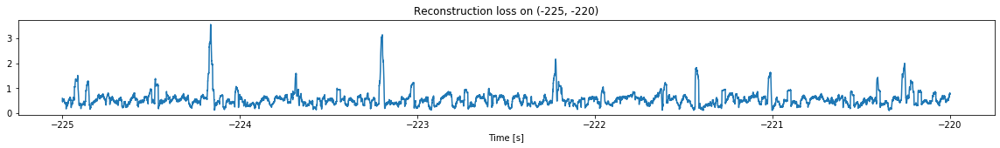

<--------
Entering sections:  (-220, -215)
-------->
Training for section:  (-225, -220)
Finished training, mean of the log(loss) is:  -0.7567944537346263
Triggering for section:  (-220, -215)
Using this mean for triggering: -0.7074054773118854


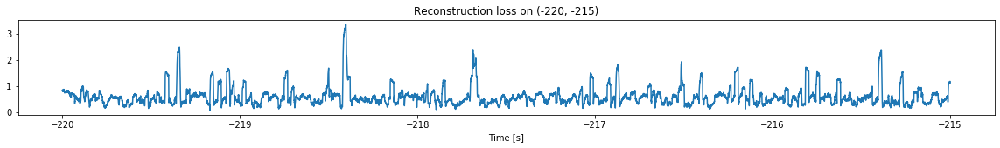

<--------
Entering sections:  (-215, -210)
-------->
Training for section:  (-220, -215)
Finished training, mean of the log(loss) is:  -0.7828502724423196
Triggering for section:  (-215, -210)
Using this mean for triggering: -0.7567944537346263


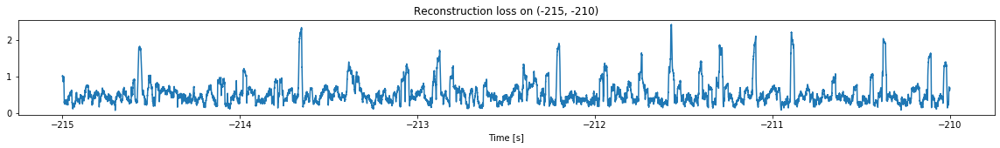

<--------
Entering sections:  (-210, -205)
-------->
Training for section:  (-215, -210)
Finished training, mean of the log(loss) is:  -0.7625331248491932
Triggering for section:  (-210, -205)
Using this mean for triggering: -0.7828502724423196


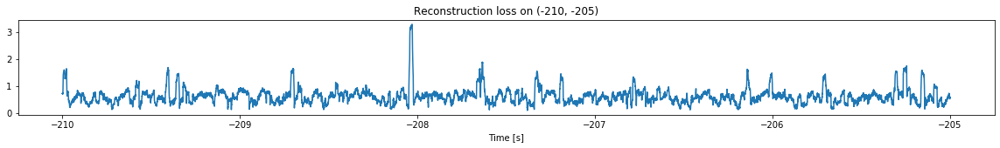

<--------
Entering sections:  (-205, -200)
-------->
Training for section:  (-210, -205)
Finished training, mean of the log(loss) is:  -0.7745586234210062
Triggering for section:  (-205, -200)
Using this mean for triggering: -0.7625331248491932


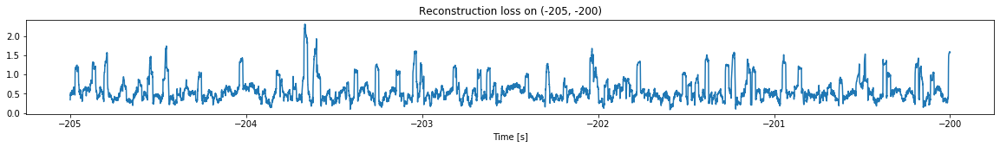

<--------
Entering sections:  (-200, -195)
-------->
Training for section:  (-205, -200)
Finished training, mean of the log(loss) is:  -0.7856594694652557
Triggering for section:  (-200, -195)
Using this mean for triggering: -0.7745586234210062


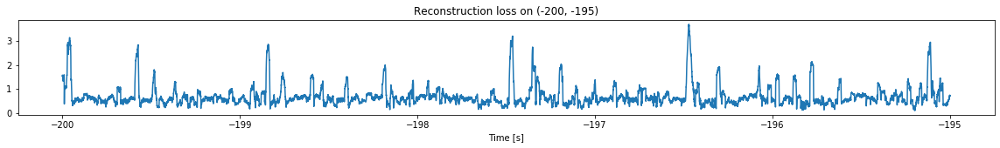

<--------
Entering sections:  (-195, -190)
-------->
Training for section:  (-200, -195)
Finished training, mean of the log(loss) is:  -0.7938243290515106
Triggering for section:  (-195, -190)
Using this mean for triggering: -0.7856594694652557


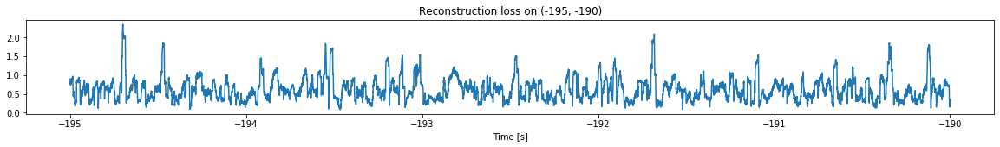

<--------
Entering sections:  (-190, -185)
-------->
Training for section:  (-195, -190)
Finished training, mean of the log(loss) is:  -0.7658919940152998
Triggering for section:  (-190, -185)
Using this mean for triggering: -0.7938243290515106


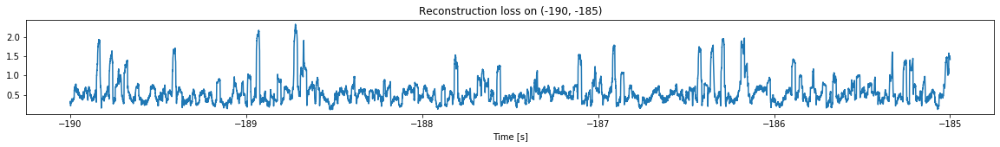

<--------
Entering sections:  (-185, -180)
-------->
Training for section:  (-190, -185)
Finished training, mean of the log(loss) is:  -0.7636321906859996
Triggering for section:  (-185, -180)
Using this mean for triggering: -0.7658919940152998


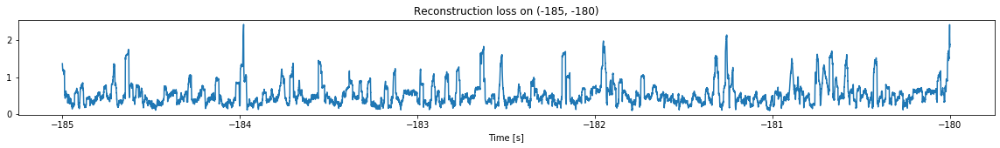

<--------
Entering sections:  (-180, -175)
-------->
Training for section:  (-185, -180)
Finished training, mean of the log(loss) is:  -0.7502604609762348
Triggering for section:  (-180, -175)
Using this mean for triggering: -0.7636321906859996


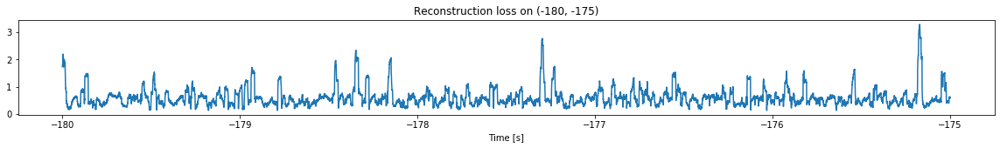

<--------
Entering sections:  (-175, -170)
-------->
Training for section:  (-180, -175)
Finished training, mean of the log(loss) is:  -0.7609934296354013
Triggering for section:  (-175, -170)
Using this mean for triggering: -0.7502604609762348


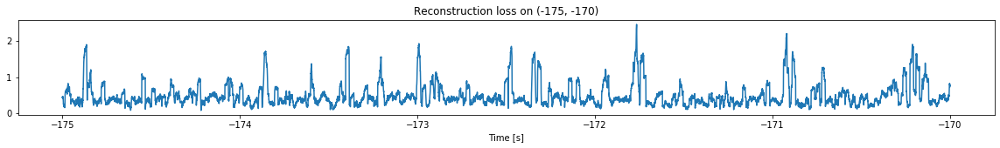

<--------
Entering sections:  (-170, -165)
-------->
Training for section:  (-175, -170)
Finished training, mean of the log(loss) is:  -0.7631538851064534
Triggering for section:  (-170, -165)
Using this mean for triggering: -0.7609934296354013


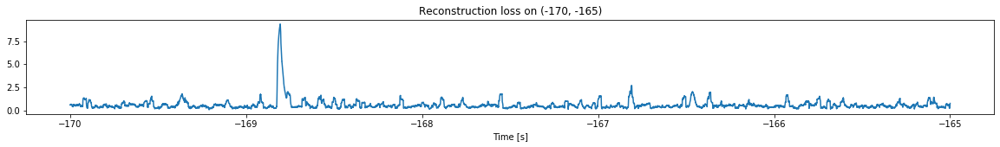

<--------
Entering sections:  (-165, -160)
-------->
Training for section:  (-170, -165)
Finished training, mean of the log(loss) is:  -0.702898288087192
Triggering for section:  (-165, -160)
Using this mean for triggering: -0.7631538851064534


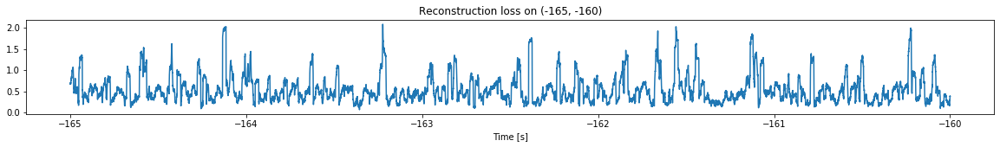

<--------
Entering sections:  (-160, -155)
-------->
Training for section:  (-165, -160)
Finished training, mean of the log(loss) is:  -0.7721817953886119
Triggering for section:  (-160, -155)
Using this mean for triggering: -0.702898288087192


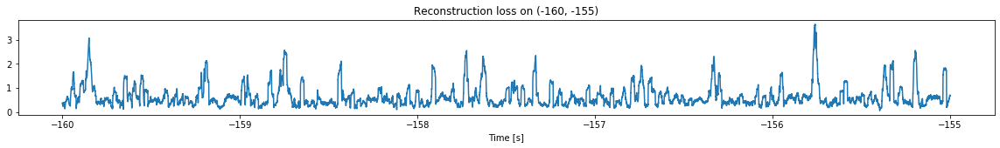

<--------
Entering sections:  (-155, -150)
-------->
Training for section:  (-160, -155)
Finished training, mean of the log(loss) is:  -0.7231711231489231
Triggering for section:  (-155, -150)
Using this mean for triggering: -0.7721817953886119


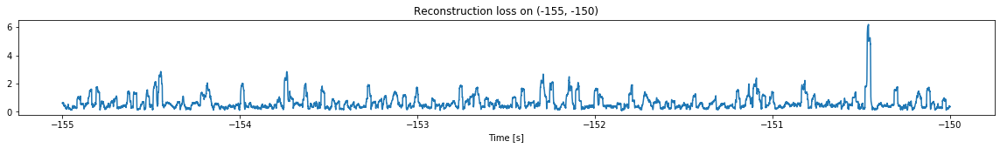

<--------
Entering sections:  (-150, -145)
-------->
Training for section:  (-155, -150)
Finished training, mean of the log(loss) is:  -0.7062739063114584
Triggering for section:  (-150, -145)
Using this mean for triggering: -0.7231711231489231


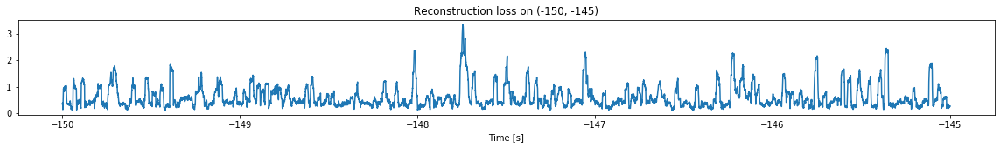

<--------
Entering sections:  (-145, -140)
-------->
Training for section:  (-150, -145)
Finished training, mean of the log(loss) is:  -0.7336015672391274
Triggering for section:  (-145, -140)
Using this mean for triggering: -0.7062739063114584


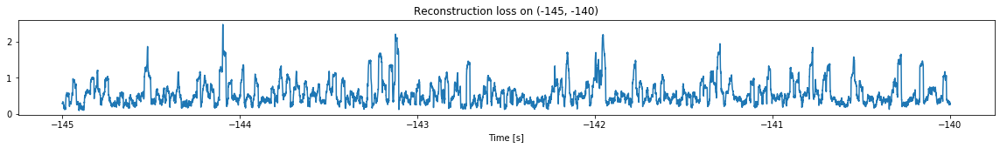

<--------
Entering sections:  (-140, -135)
-------->
Training for section:  (-145, -140)
Finished training, mean of the log(loss) is:  -0.7071765321609114
Triggering for section:  (-140, -135)
Using this mean for triggering: -0.7336015672391274


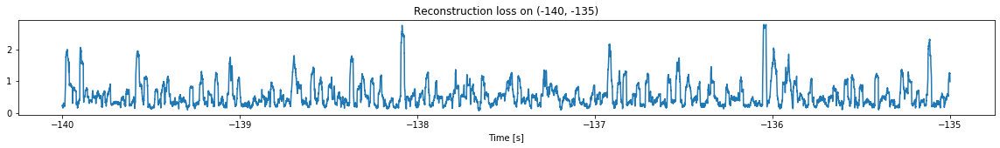

<--------
Entering sections:  (-135, -130)
-------->
Training for section:  (-140, -135)
Finished training, mean of the log(loss) is:  -0.6619102140713566
Triggering for section:  (-135, -130)
Using this mean for triggering: -0.7071765321609114


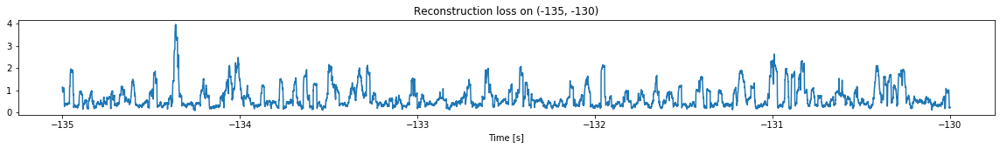

<--------
Entering sections:  (-130, -125)
-------->
Training for section:  (-135, -130)
Finished training, mean of the log(loss) is:  -0.6842241239692607
Triggering for section:  (-130, -125)
Using this mean for triggering: -0.6619102140713566


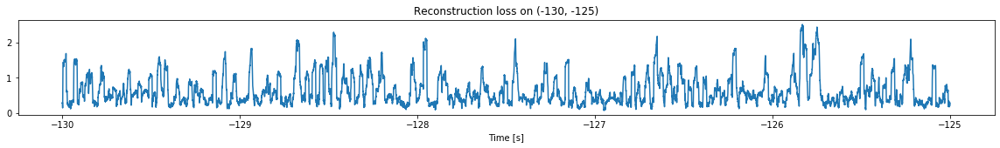

<--------
Entering sections:  (-125, -120)
-------->
Training for section:  (-130, -125)
Finished training, mean of the log(loss) is:  -0.7344355645454662
Triggering for section:  (-125, -120)
Using this mean for triggering: -0.6842241239692607


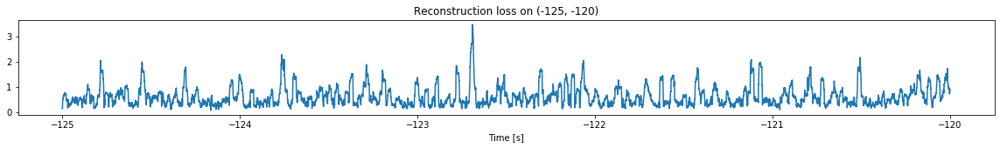

<--------
Entering sections:  (-120, -115)
-------->
Training for section:  (-125, -120)
Finished training, mean of the log(loss) is:  -0.7329644013698834
Triggering for section:  (-120, -115)
Using this mean for triggering: -0.7344355645454662


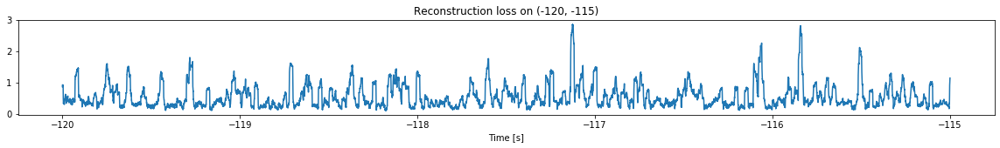

<--------
Entering sections:  (-115, -110)
-------->
Training for section:  (-120, -115)
Finished training, mean of the log(loss) is:  -0.7278075947025433
Triggering for section:  (-115, -110)
Using this mean for triggering: -0.7329644013698834


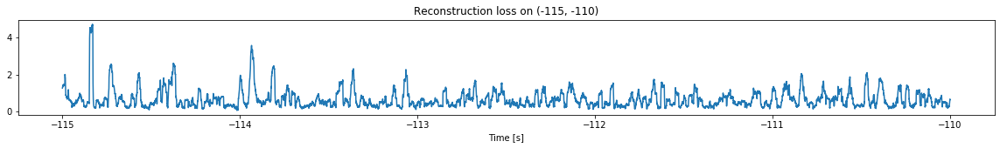

<--------
Entering sections:  (-110, -105)
-------->
Training for section:  (-115, -110)
Finished training, mean of the log(loss) is:  -0.6841117754074992
Triggering for section:  (-110, -105)
Using this mean for triggering: -0.7278075947025433


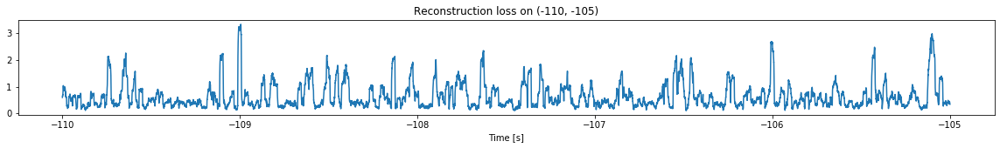

<--------
Entering sections:  (-105, -100)
-------->
Training for section:  (-110, -105)
Finished training, mean of the log(loss) is:  -0.6771753071561519
Triggering for section:  (-105, -100)
Using this mean for triggering: -0.6841117754074992


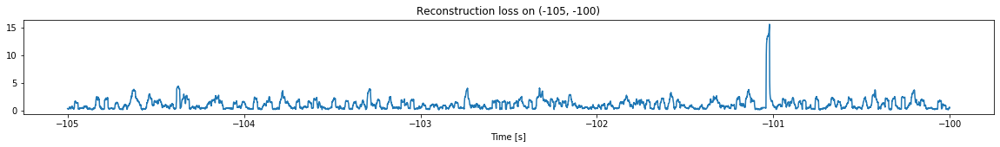

<--------
Entering sections:  (-100, -95)
-------->
Training for section:  (-105, -100)
Finished training, mean of the log(loss) is:  -0.6167892347870798
Triggering for section:  (-100, -95)
Using this mean for triggering: -0.6771753071561519


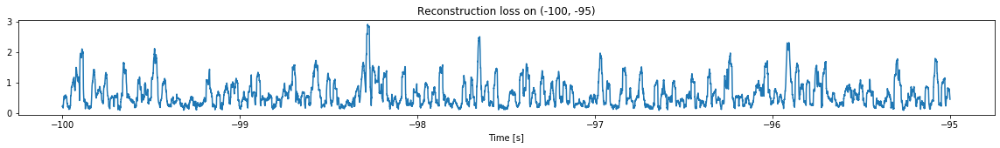

<--------
Entering sections:  (-95, -90)
-------->
Training for section:  (-100, -95)
Finished training, mean of the log(loss) is:  -0.5686600178729854
Triggering for section:  (-95, -90)
Using this mean for triggering: -0.6167892347870798


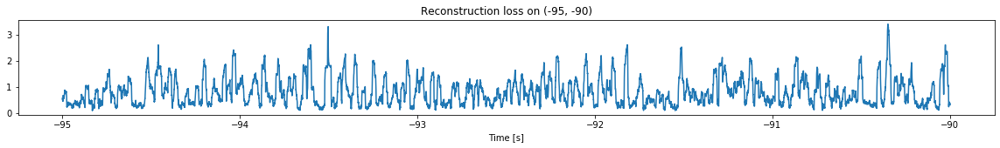

<--------
Entering sections:  (-90, -85)
-------->
Training for section:  (-95, -90)
Finished training, mean of the log(loss) is:  -0.5273046386453271
Triggering for section:  (-90, -85)
Using this mean for triggering: -0.5686600178729854


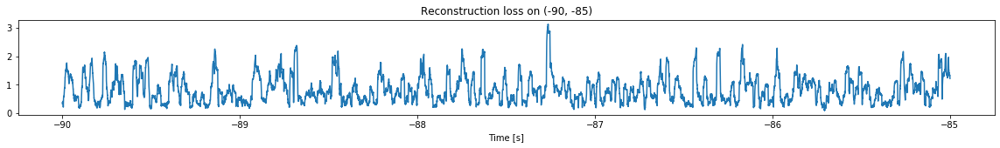

<--------
Entering sections:  (-85, -80)
-------->
Training for section:  (-90, -85)
Finished training, mean of the log(loss) is:  -0.6049909625781511
Triggering for section:  (-85, -80)
Using this mean for triggering: -0.5273046386453271


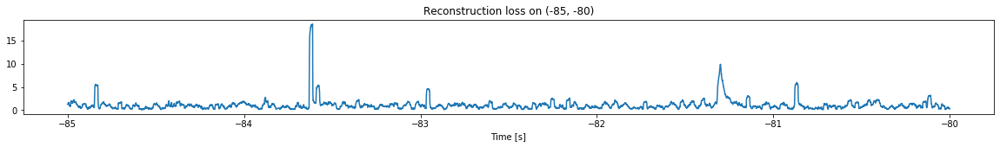

<--------
Entering sections:  (-80, -75)
-------->
Training for section:  (-85, -80)
Finished training, mean of the log(loss) is:  -0.5186723494089003
Triggering for section:  (-80, -75)
Using this mean for triggering: -0.6049909625781511


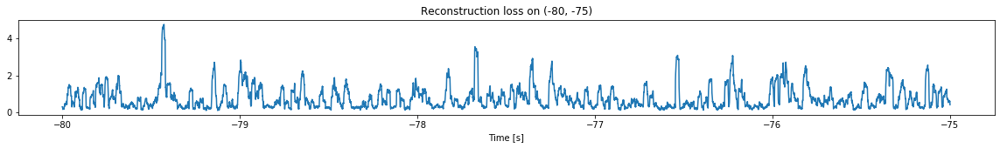

<--------
Entering sections:  (-75, -70)
-------->
Training for section:  (-80, -75)
Finished training, mean of the log(loss) is:  -0.6101448078708652
Triggering for section:  (-75, -70)
Using this mean for triggering: -0.5186723494089003


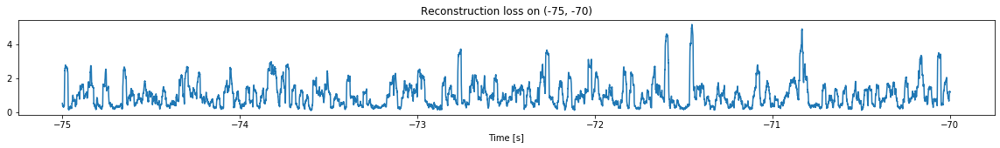

<--------
Entering sections:  (-70, -65)
-------->
Training for section:  (-75, -70)
Finished training, mean of the log(loss) is:  -0.621369677669881
Triggering for section:  (-70, -65)
Using this mean for triggering: -0.6101448078708652


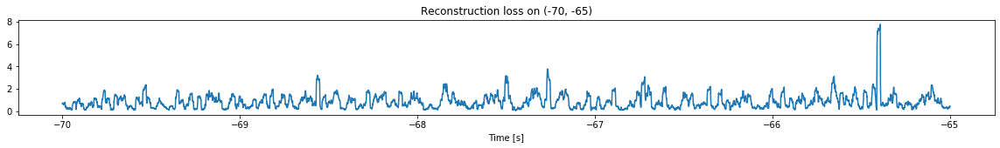

<--------
Entering sections:  (-65, -60)
-------->
Training for section:  (-70, -65)
Finished training, mean of the log(loss) is:  -0.5573093741500595
Triggering for section:  (-65, -60)
Using this mean for triggering: -0.621369677669881


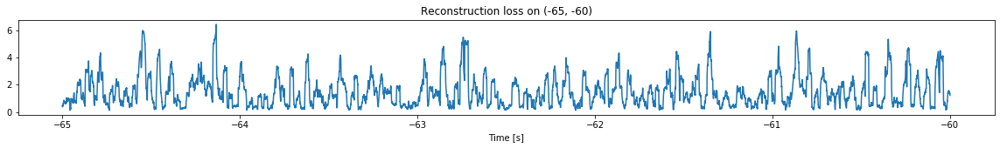

<--------
Entering sections:  (-60, -55)
-------->
Training for section:  (-65, -60)
Finished training, mean of the log(loss) is:  -0.5732305785810607
Triggering for section:  (-60, -55)
Using this mean for triggering: -0.5573093741500595


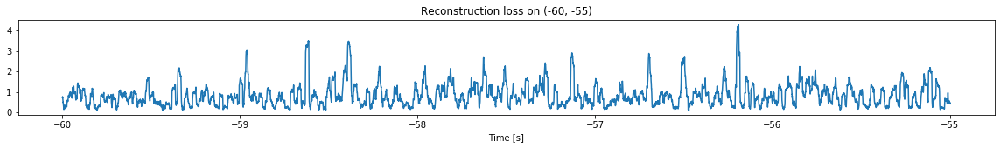

<--------
Entering sections:  (-55, -50)
-------->
Training for section:  (-60, -55)
Finished training, mean of the log(loss) is:  -0.5869286952451688
Triggering for section:  (-55, -50)
Using this mean for triggering: -0.5732305785810607


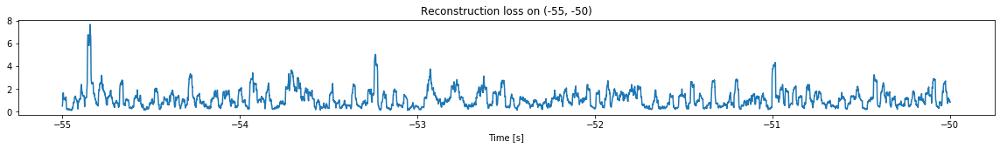

<--------
Entering sections:  (-50, -45)
-------->
Training for section:  (-55, -50)
Finished training, mean of the log(loss) is:  -0.5474549559359786
Triggering for section:  (-50, -45)
Using this mean for triggering: -0.5869286952451688


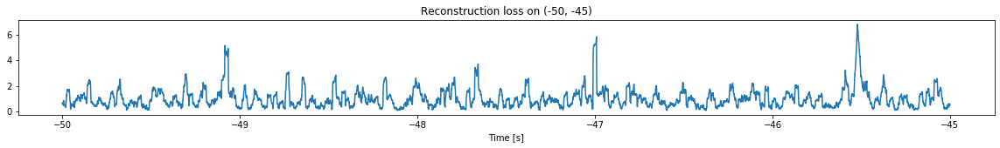

<--------
Entering sections:  (-45, -40)
-------->
Training for section:  (-50, -45)
Finished training, mean of the log(loss) is:  -0.5625525910954002
Triggering for section:  (-45, -40)
Using this mean for triggering: -0.5474549559359786


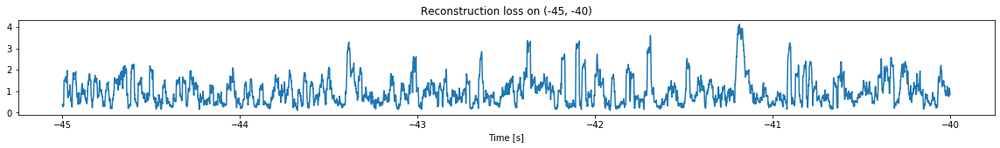

<--------
Entering sections:  (-40, -35)
-------->
Training for section:  (-45, -40)
Finished training, mean of the log(loss) is:  -0.568995356184852
Triggering for section:  (-40, -35)
Using this mean for triggering: -0.5625525910954002


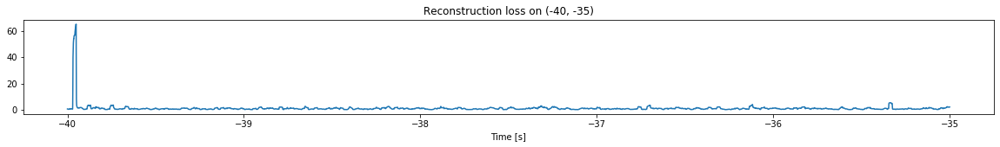

<--------
Entering sections:  (-35, -30)
-------->
Training for section:  (-40, -35)
Finished training, mean of the log(loss) is:  -0.47896031317827614
Triggering for section:  (-35, -30)
Using this mean for triggering: -0.568995356184852


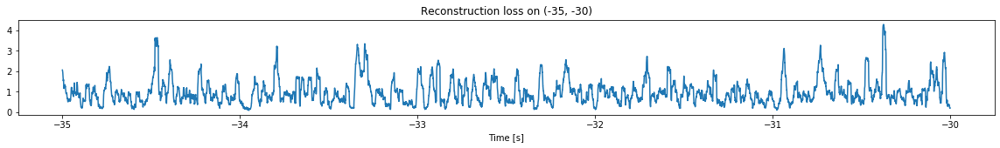

<--------
Entering sections:  (-30, -25)
-------->
Training for section:  (-35, -30)
Finished training, mean of the log(loss) is:  -0.5136231237441622
Triggering for section:  (-30, -25)
Using this mean for triggering: -0.47896031317827614


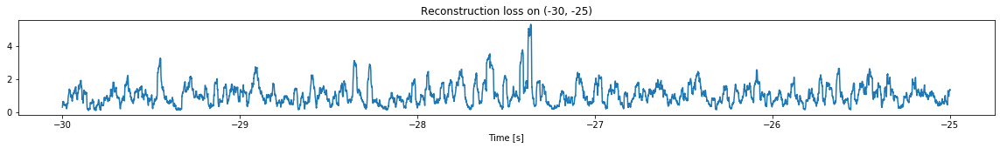

<--------
Entering sections:  (-25, -20)
-------->
Training for section:  (-30, -25)
Finished training, mean of the log(loss) is:  -0.5612331595678476
Triggering for section:  (-25, -20)
Using this mean for triggering: -0.5136231237441622


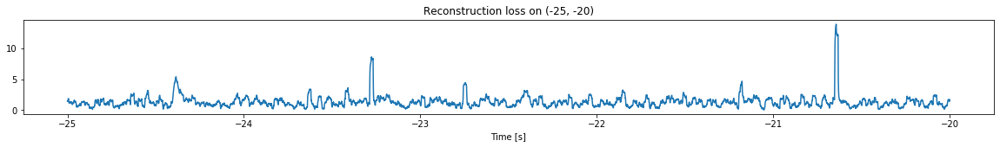

<--------
Entering sections:  (-20, -15)
-------->
Training for section:  (-25, -20)
Finished training, mean of the log(loss) is:  -0.5189343231895032
Triggering for section:  (-20, -15)
Using this mean for triggering: -0.5612331595678476


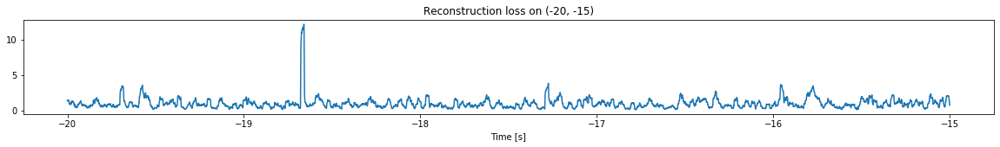

<--------
Entering sections:  (-15, -10)
-------->
Training for section:  (-20, -15)
Finished training, mean of the log(loss) is:  -0.5481081943880027
Triggering for section:  (-15, -10)
Using this mean for triggering: -0.5189343231895032


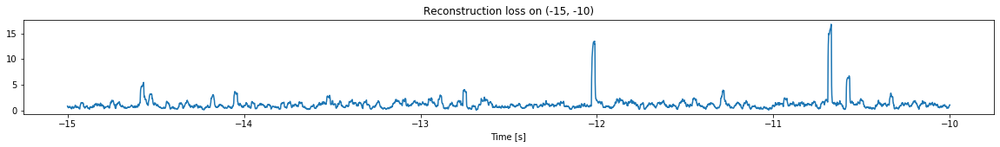

<--------
Entering sections:  (-10, -5)
-------->
Training for section:  (-15, -10)
Finished training, mean of the log(loss) is:  -0.5435092484634503
Triggering for section:  (-10, -5)
Using this mean for triggering: -0.5481081943880027


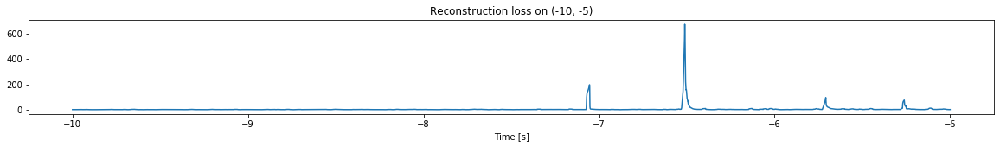

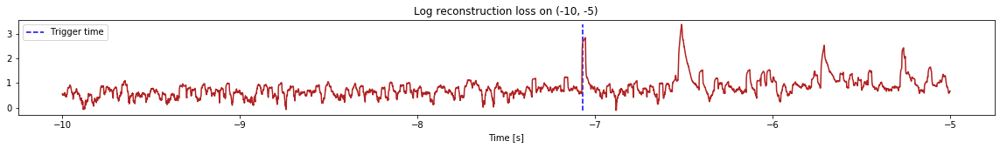

Triggered at:  -7.07119


-7.07119

In [6]:
simulation("./data/Ramp12d/", 5, (-300,0))

Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
All data's shape:  (2997500, 12)
Flushing input history
Number of sections: 60
Entering sections:  (-300, -295)
-------->
Entering sections:  (-295, -290)
-------->
Training for section:  (None, -295)
Finished training, mean of the log(loss) is:  -0.6299429294802507
<--------
Entering sections:  (-290, -285)
-------->
Training for section:  (-295, -290)
Finished training, mean of the log(loss) is:  -0.6363982333692707
Triggering for section:  (-290, -285)
Using this mean for triggering: -0.6299429294802507


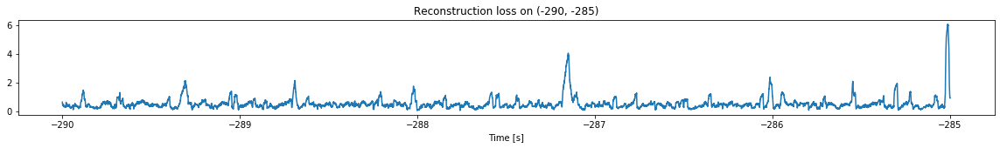

<--------
Entering sections:  (-285, -280)
-------->
Training for section:  (-290, -285)
Finished training, mean of the log(loss) is:  -0.672766234881757
Triggering for section:  (-285, -280)
Using this mean for triggering: -0.6363982333692707


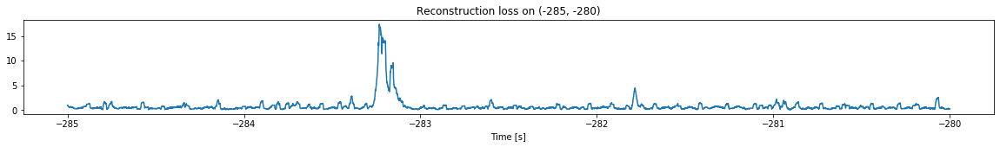

<--------
Entering sections:  (-280, -275)
-------->
Training for section:  (-285, -280)
Finished training, mean of the log(loss) is:  -0.6405125401600922
Triggering for section:  (-280, -275)
Using this mean for triggering: -0.672766234881757


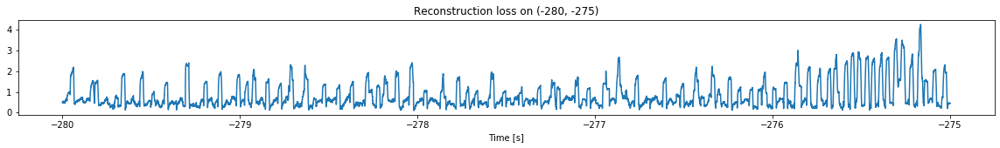

<--------
Entering sections:  (-275, -270)
-------->
Training for section:  (-280, -275)
Finished training, mean of the log(loss) is:  -0.742653103828774
Triggering for section:  (-275, -270)
Using this mean for triggering: -0.6405125401600922


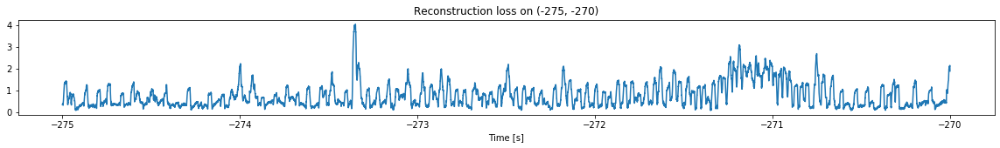

<--------
Entering sections:  (-270, -265)
-------->
Training for section:  (-275, -270)
Finished training, mean of the log(loss) is:  -0.7247910059509666
Triggering for section:  (-270, -265)
Using this mean for triggering: -0.742653103828774


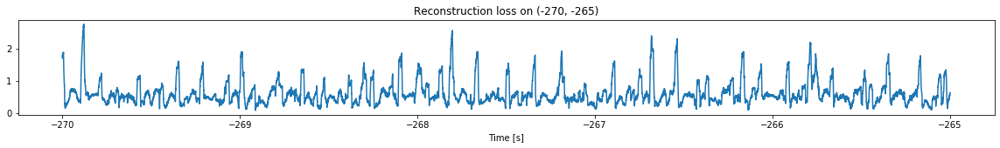

<--------
Entering sections:  (-265, -260)
-------->
Training for section:  (-270, -265)
Finished training, mean of the log(loss) is:  -0.7352386803076901
Triggering for section:  (-265, -260)
Using this mean for triggering: -0.7247910059509666


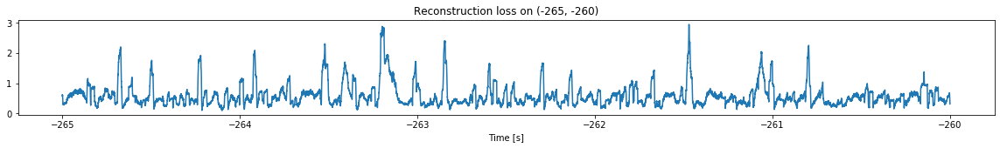

<--------
Entering sections:  (-260, -255)
-------->
Training for section:  (-265, -260)
Finished training, mean of the log(loss) is:  -0.7554823067907289
Triggering for section:  (-260, -255)
Using this mean for triggering: -0.7352386803076901


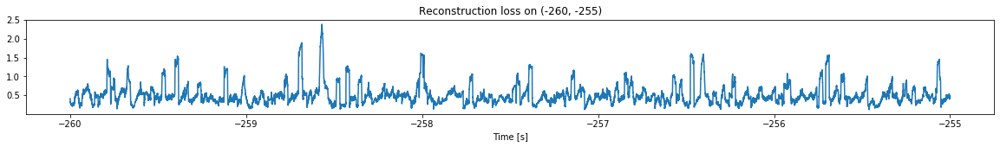

<--------
Entering sections:  (-255, -250)
-------->
Training for section:  (-260, -255)
Finished training, mean of the log(loss) is:  -0.8067400099349007
Triggering for section:  (-255, -250)
Using this mean for triggering: -0.7554823067907289


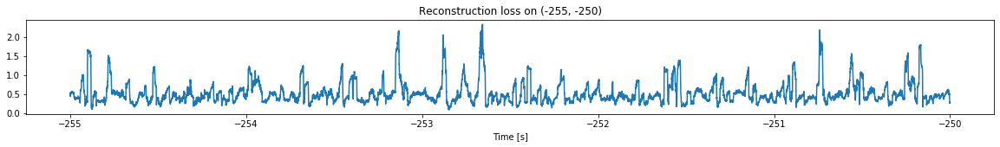

<--------
Entering sections:  (-250, -245)
-------->
Training for section:  (-255, -250)
Finished training, mean of the log(loss) is:  -0.7453510267757086
Triggering for section:  (-250, -245)
Using this mean for triggering: -0.8067400099349007


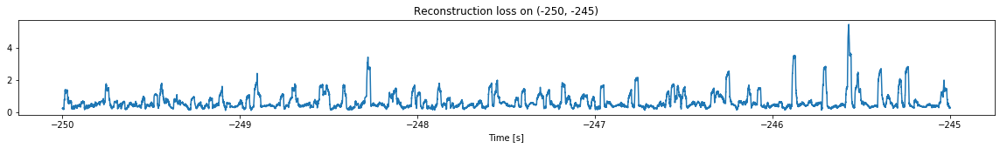

<--------
Entering sections:  (-245, -240)
-------->
Training for section:  (-250, -245)
Finished training, mean of the log(loss) is:  -0.683046113098933
Triggering for section:  (-245, -240)
Using this mean for triggering: -0.7453510267757086


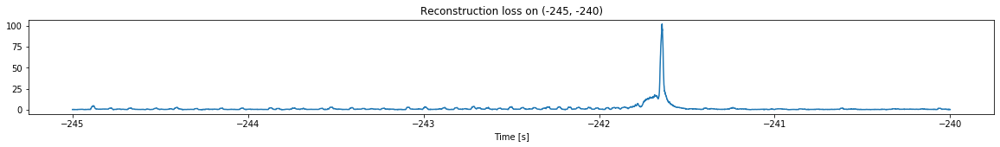

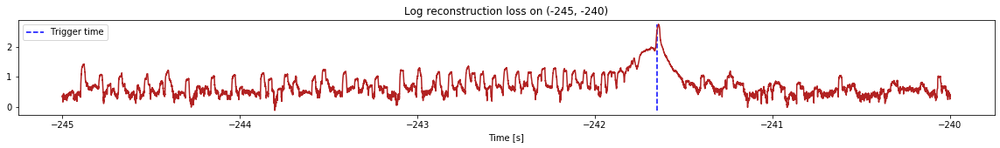

Triggered at:  -241.65147


-241.65147

In [7]:
simulation("./data/Ramp19/", 5, (-300,0))

Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
All data's shape:  (2997500, 12)
Flushing input history
Number of sections: 60
Entering sections:  (-300, -295)
-------->
Entering sections:  (-295, -290)
-------->
Training for section:  (None, -295)
Finished training, mean of the log(loss) is:  -0.7214648652117823
<--------
Entering sections:  (-290, -285)
-------->
Training for section:  (-295, -290)
Finished training, mean of the log(loss) is:  -0.6990527290894215
Triggering for section:  (-290, -285)
Using this mean for triggering: -0.7214648652117823


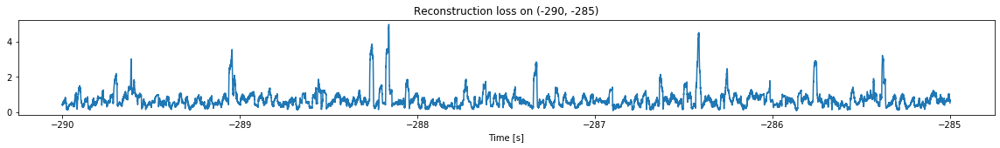

<--------
Entering sections:  (-285, -280)
-------->
Training for section:  (-290, -285)
Finished training, mean of the log(loss) is:  -0.7085976711302809
Triggering for section:  (-285, -280)
Using this mean for triggering: -0.6990527290894215


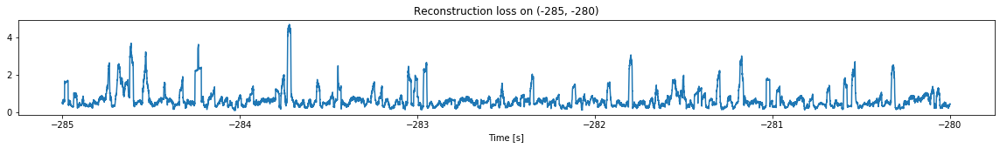

<--------
Entering sections:  (-280, -275)
-------->
Training for section:  (-285, -280)
Finished training, mean of the log(loss) is:  -0.6751788100139118
Triggering for section:  (-280, -275)
Using this mean for triggering: -0.7085976711302809


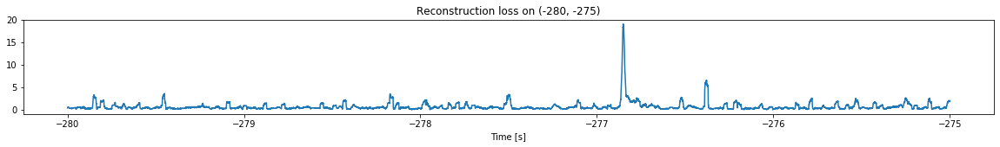

<--------
Entering sections:  (-275, -270)
-------->
Training for section:  (-280, -275)
Finished training, mean of the log(loss) is:  -0.618975448849727
Triggering for section:  (-275, -270)
Using this mean for triggering: -0.6751788100139118


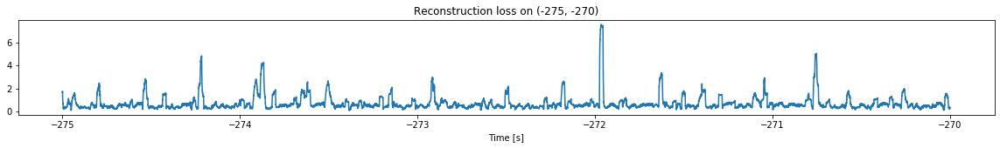

<--------
Entering sections:  (-270, -265)
-------->
Training for section:  (-275, -270)
Finished training, mean of the log(loss) is:  -0.6515001347415466
Triggering for section:  (-270, -265)
Using this mean for triggering: -0.618975448849727


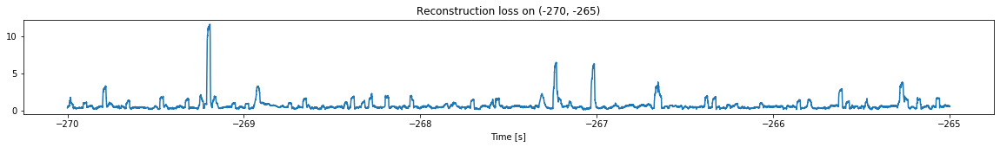

<--------
Entering sections:  (-265, -260)
-------->
Training for section:  (-270, -265)
Finished training, mean of the log(loss) is:  -0.667568570137058
Triggering for section:  (-265, -260)
Using this mean for triggering: -0.6515001347415466


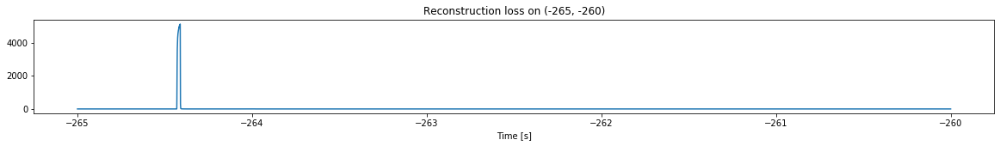

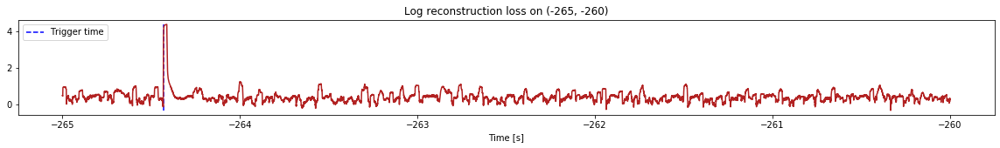

Triggered at:  -264.43118


-264.43118

In [8]:
simulation("./data/Ramp20/", 5, (-300,0))

Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
All data's shape:  (2997500, 12)
Flushing input history
Number of sections: 60
Entering sections:  (-300, -295)
-------->
Entering sections:  (-295, -290)
-------->
Training for section:  (None, -295)
Finished training, mean of the log(loss) is:  -0.6955655354024194
<--------
Entering sections:  (-290, -285)
-------->
Training for section:  (-295, -290)
Finished training, mean of the log(loss) is:  -0.6827436535355698
Triggering for section:  (-290, -285)
Using this mean for triggering: -0.6955655354024194


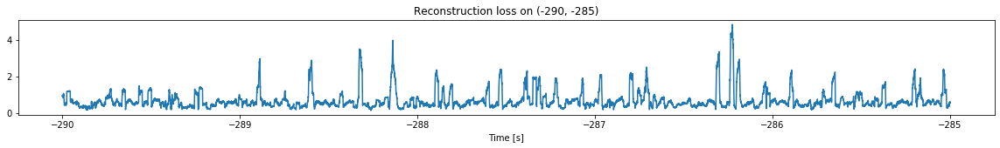

<--------
Entering sections:  (-285, -280)
-------->
Training for section:  (-290, -285)
Finished training, mean of the log(loss) is:  -0.6791248762036898
Triggering for section:  (-285, -280)
Using this mean for triggering: -0.6827436535355698


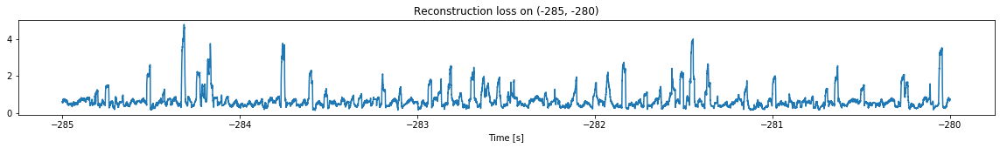

<--------
Entering sections:  (-280, -275)
-------->
Training for section:  (-285, -280)
Finished training, mean of the log(loss) is:  -0.7161144901558251
Triggering for section:  (-280, -275)
Using this mean for triggering: -0.6791248762036898


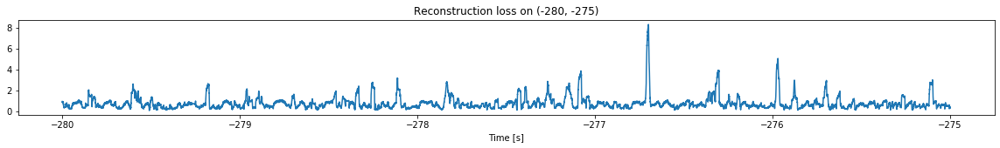

<--------
Entering sections:  (-275, -270)
-------->
Training for section:  (-280, -275)
Finished training, mean of the log(loss) is:  -0.679659899407713
Triggering for section:  (-275, -270)
Using this mean for triggering: -0.7161144901558251


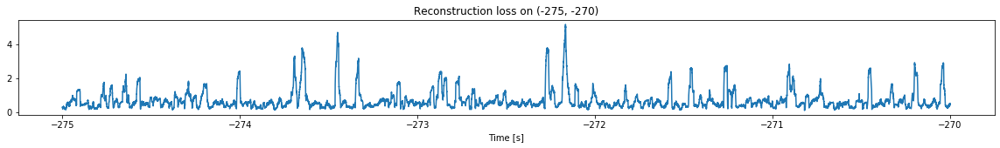

<--------
Entering sections:  (-270, -265)
-------->
Training for section:  (-275, -270)
Finished training, mean of the log(loss) is:  -0.6160376285069649
Triggering for section:  (-270, -265)
Using this mean for triggering: -0.679659899407713


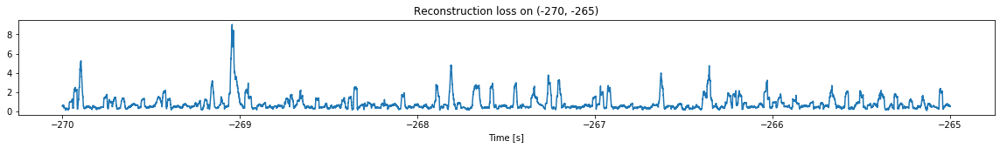

<--------
Entering sections:  (-265, -260)
-------->
Training for section:  (-270, -265)
Finished training, mean of the log(loss) is:  -0.5591856599265923
Triggering for section:  (-265, -260)
Using this mean for triggering: -0.6160376285069649


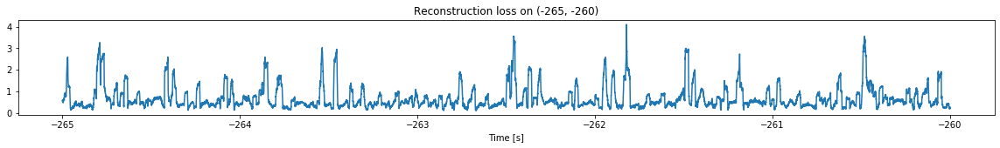

<--------
Entering sections:  (-260, -255)
-------->
Training for section:  (-265, -260)
Finished training, mean of the log(loss) is:  -0.6602461596416054
Triggering for section:  (-260, -255)
Using this mean for triggering: -0.5591856599265923


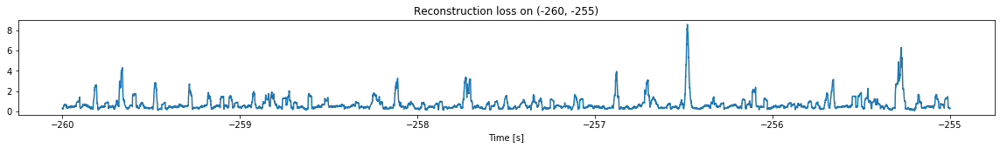

<--------
Entering sections:  (-255, -250)
-------->
Training for section:  (-260, -255)
Finished training, mean of the log(loss) is:  -0.585870310445719
Triggering for section:  (-255, -250)
Using this mean for triggering: -0.6602461596416054


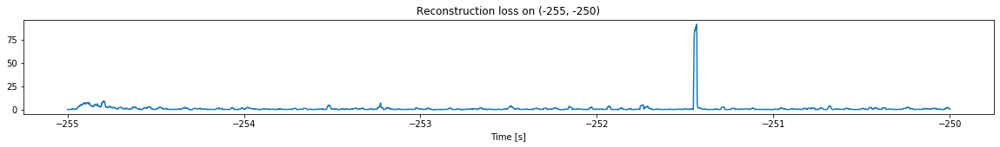

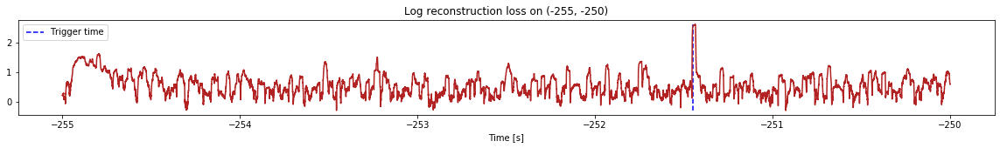

Triggered at:  -251.44968


-251.44968

In [9]:
simulation("./data/Ramp21/", 5, (-300,0))

Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
All data's shape:  (2997500, 12)
Flushing input history
Number of sections: 60
Entering sections:  (-300, -295)
-------->
Entering sections:  (-295, -290)
-------->
Training for section:  (None, -295)
Finished training, mean of the log(loss) is:  -0.6958949637106197
<--------
Entering sections:  (-290, -285)
-------->
Training for section:  (-295, -290)
Finished training, mean of the log(loss) is:  -0.7176601979581547
Triggering for section:  (-290, -285)
Using this mean for triggering: -0.6958949637106197


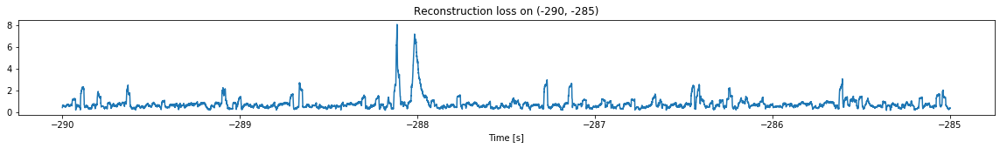

<--------
Entering sections:  (-285, -280)
-------->
Training for section:  (-290, -285)
Finished training, mean of the log(loss) is:  -0.6725035924525101
Triggering for section:  (-285, -280)
Using this mean for triggering: -0.7176601979581547


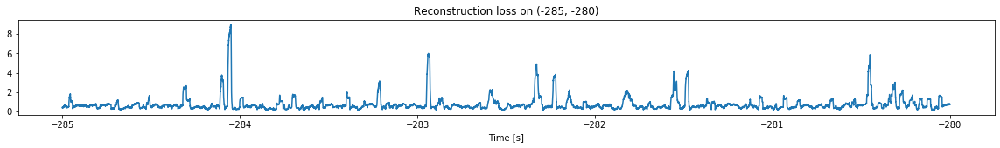

<--------
Entering sections:  (-280, -275)
-------->
Training for section:  (-285, -280)
Finished training, mean of the log(loss) is:  -0.6669694228008701
Triggering for section:  (-280, -275)
Using this mean for triggering: -0.6725035924525101


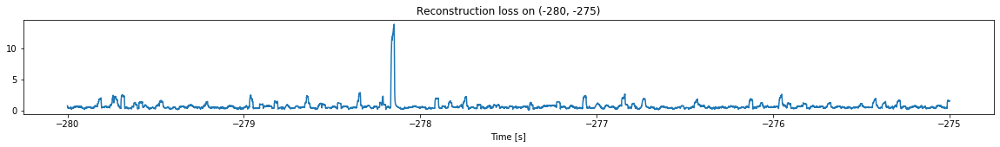

<--------
Entering sections:  (-275, -270)
-------->
Training for section:  (-280, -275)
Finished training, mean of the log(loss) is:  -0.6363884708866754
Triggering for section:  (-275, -270)
Using this mean for triggering: -0.6669694228008701


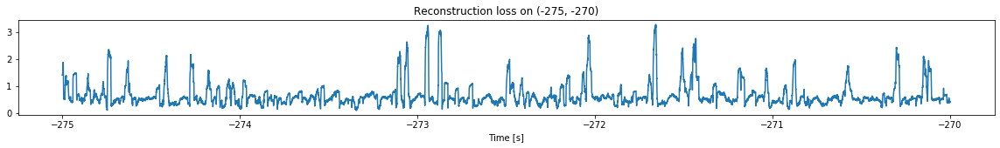

<--------
Entering sections:  (-270, -265)
-------->
Training for section:  (-275, -270)
Finished training, mean of the log(loss) is:  -0.6352402011398295
Triggering for section:  (-270, -265)
Using this mean for triggering: -0.6363884708866754


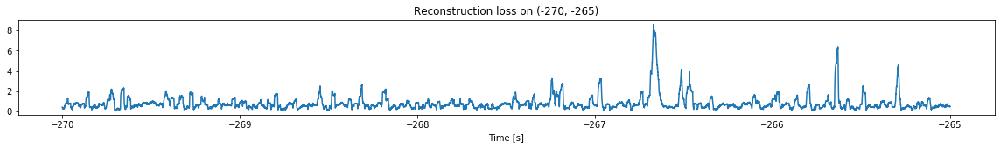

<--------
Entering sections:  (-265, -260)
-------->
Training for section:  (-270, -265)
Finished training, mean of the log(loss) is:  -0.6605964521603769
Triggering for section:  (-265, -260)
Using this mean for triggering: -0.6352402011398295


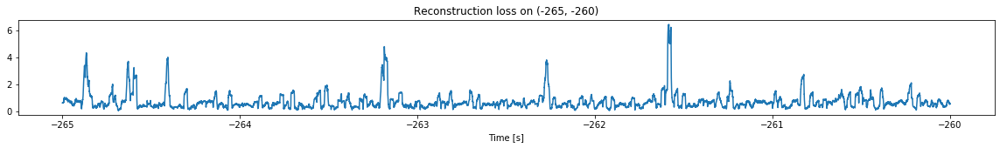

<--------
Entering sections:  (-260, -255)
-------->
Training for section:  (-265, -260)
Finished training, mean of the log(loss) is:  -0.6300504350254225
Triggering for section:  (-260, -255)
Using this mean for triggering: -0.6605964521603769


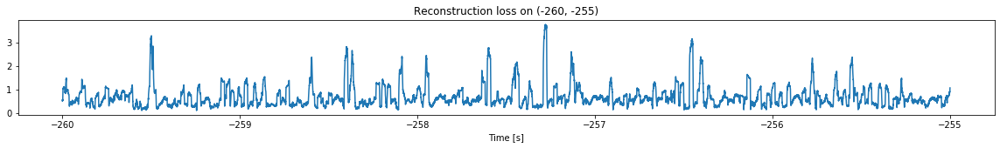

<--------
Entering sections:  (-255, -250)
-------->
Training for section:  (-260, -255)
Finished training, mean of the log(loss) is:  -0.6931367942120107
Triggering for section:  (-255, -250)
Using this mean for triggering: -0.6300504350254225


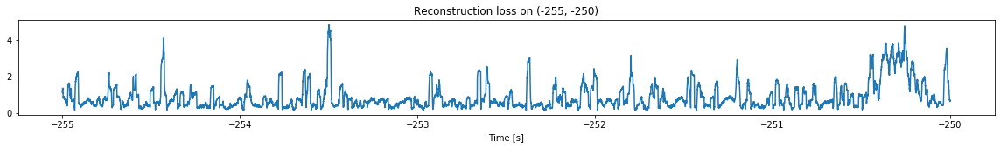

<--------
Entering sections:  (-250, -245)
-------->
Training for section:  (-255, -250)
Finished training, mean of the log(loss) is:  -0.6119931785052047
Triggering for section:  (-250, -245)
Using this mean for triggering: -0.6931367942120107


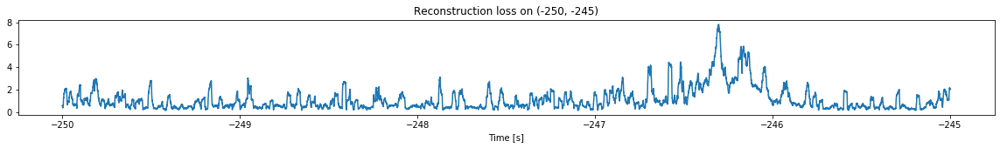

<--------
Entering sections:  (-245, -240)
-------->
Training for section:  (-250, -245)
Finished training, mean of the log(loss) is:  -0.5353229834284126
Triggering for section:  (-245, -240)
Using this mean for triggering: -0.6119931785052047


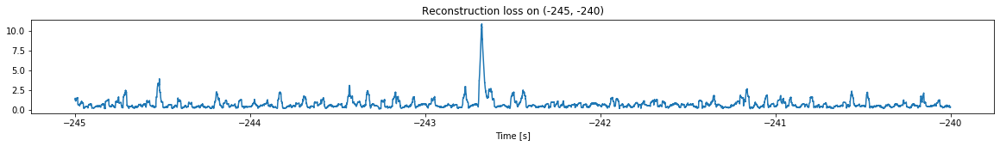

<--------
Entering sections:  (-240, -235)
-------->
Training for section:  (-245, -240)
Finished training, mean of the log(loss) is:  -0.5107314902200455
Triggering for section:  (-240, -235)
Using this mean for triggering: -0.5353229834284126


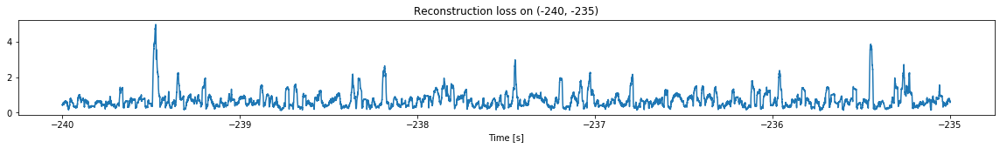

<--------
Entering sections:  (-235, -230)
-------->
Training for section:  (-240, -235)
Finished training, mean of the log(loss) is:  -0.640861069354973
Triggering for section:  (-235, -230)
Using this mean for triggering: -0.5107314902200455


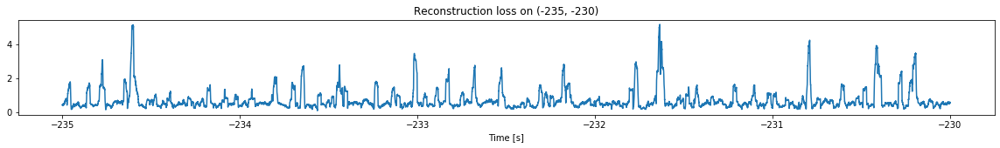

<--------
Entering sections:  (-230, -225)
-------->
Training for section:  (-235, -230)
Finished training, mean of the log(loss) is:  -0.5784543252853213
Triggering for section:  (-230, -225)
Using this mean for triggering: -0.640861069354973


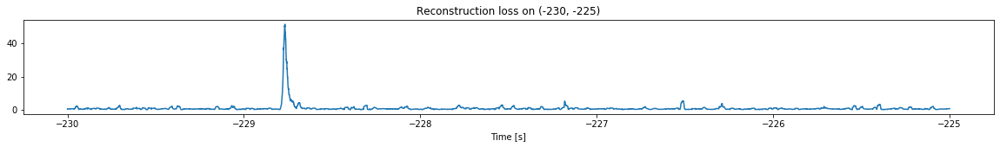

<--------
Entering sections:  (-225, -220)
-------->
Training for section:  (-230, -225)
Finished training, mean of the log(loss) is:  -0.4841199106079668
Triggering for section:  (-225, -220)
Using this mean for triggering: -0.5784543252853213


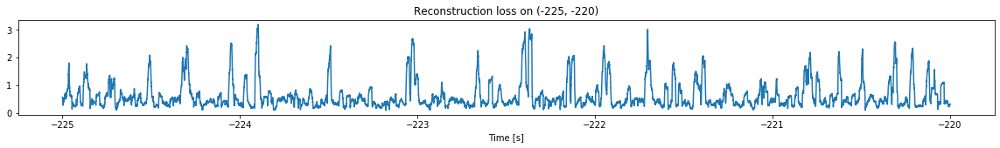

<--------
Entering sections:  (-220, -215)
-------->
Training for section:  (-225, -220)
Finished training, mean of the log(loss) is:  -0.5996227502118405
Triggering for section:  (-220, -215)
Using this mean for triggering: -0.4841199106079668


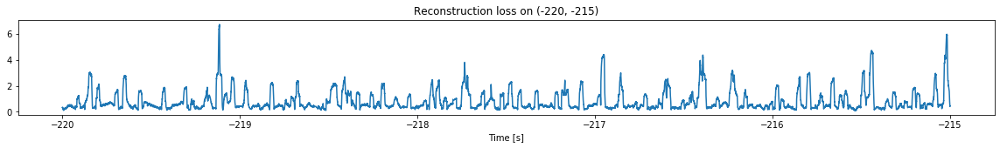

<--------
Entering sections:  (-215, -210)
-------->
Training for section:  (-220, -215)
Finished training, mean of the log(loss) is:  -0.5756502956321986
Triggering for section:  (-215, -210)
Using this mean for triggering: -0.5996227502118405


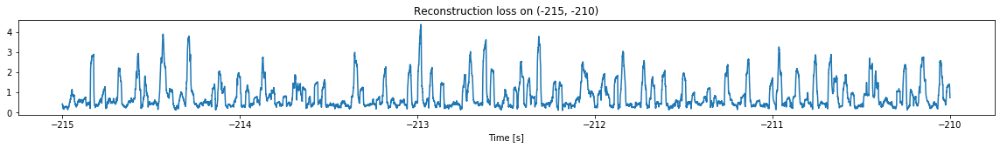

<--------
Entering sections:  (-210, -205)
-------->
Training for section:  (-215, -210)
Finished training, mean of the log(loss) is:  -0.5660782393667645
Triggering for section:  (-210, -205)
Using this mean for triggering: -0.5756502956321986


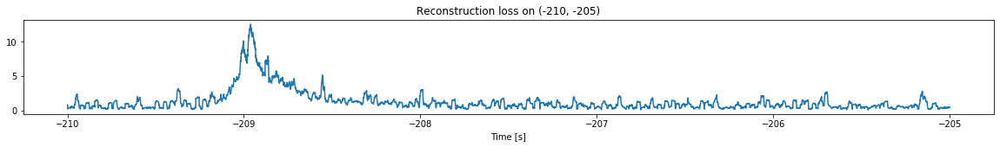

<--------
Entering sections:  (-205, -200)
-------->
Training for section:  (-210, -205)
Finished training, mean of the log(loss) is:  -0.4780314056736369
Triggering for section:  (-205, -200)
Using this mean for triggering: -0.5660782393667645


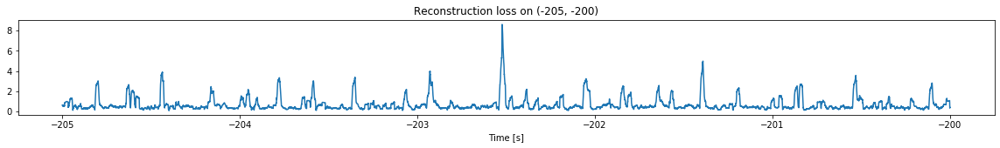

<--------
Entering sections:  (-200, -195)
-------->
Training for section:  (-205, -200)
Finished training, mean of the log(loss) is:  -0.5782817654824322
Triggering for section:  (-200, -195)
Using this mean for triggering: -0.4780314056736369


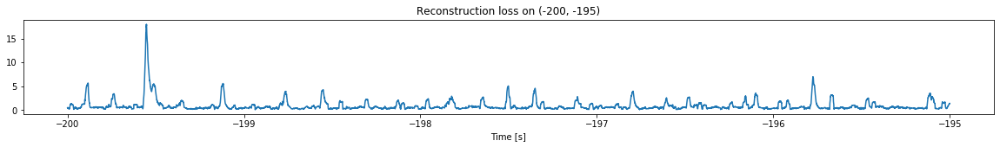

<--------
Entering sections:  (-195, -190)
-------->
Training for section:  (-200, -195)
Finished training, mean of the log(loss) is:  -0.580829398437526
Triggering for section:  (-195, -190)
Using this mean for triggering: -0.5782817654824322


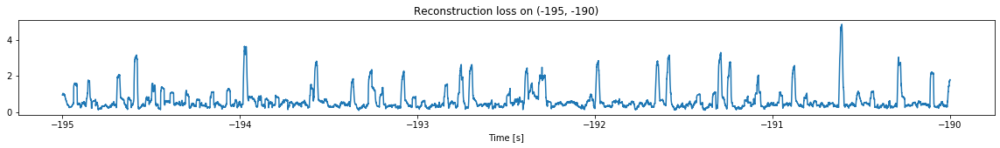

<--------
Entering sections:  (-190, -185)
-------->
Training for section:  (-195, -190)
Finished training, mean of the log(loss) is:  -0.6464995542736003
Triggering for section:  (-190, -185)
Using this mean for triggering: -0.580829398437526


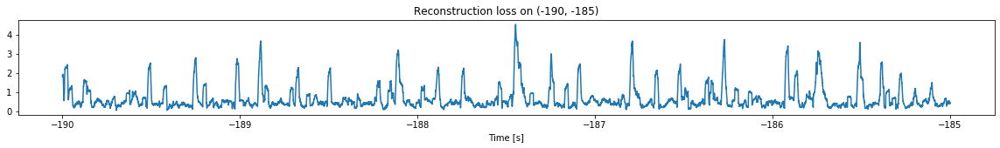

<--------
Entering sections:  (-185, -180)
-------->
Training for section:  (-190, -185)
Finished training, mean of the log(loss) is:  -0.6453934138916089
Triggering for section:  (-185, -180)
Using this mean for triggering: -0.6464995542736003


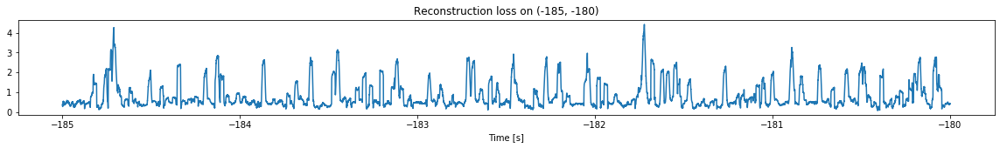

<--------
Entering sections:  (-180, -175)
-------->
Training for section:  (-185, -180)
Finished training, mean of the log(loss) is:  -0.5994892741902654
Triggering for section:  (-180, -175)
Using this mean for triggering: -0.6453934138916089


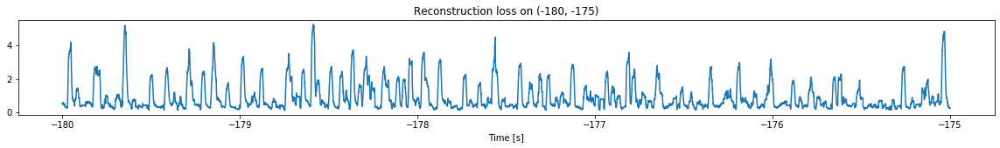

<--------
Entering sections:  (-175, -170)
-------->
Training for section:  (-180, -175)
Finished training, mean of the log(loss) is:  -0.6295826524941703
Triggering for section:  (-175, -170)
Using this mean for triggering: -0.5994892741902654


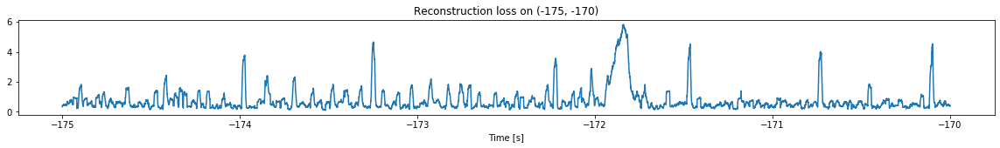

<--------
Entering sections:  (-170, -165)
-------->
Training for section:  (-175, -170)
Finished training, mean of the log(loss) is:  -0.5970470004788508
Triggering for section:  (-170, -165)
Using this mean for triggering: -0.6295826524941703


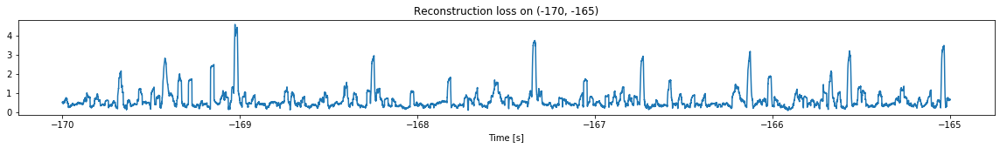

<--------
Entering sections:  (-165, -160)
-------->
Training for section:  (-170, -165)
Finished training, mean of the log(loss) is:  -0.7411863300616908
Triggering for section:  (-165, -160)
Using this mean for triggering: -0.5970470004788508


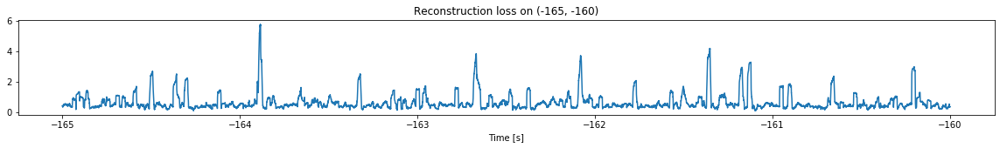

<--------
Entering sections:  (-160, -155)
-------->
Training for section:  (-165, -160)
Finished training, mean of the log(loss) is:  -0.7551638610123552
Triggering for section:  (-160, -155)
Using this mean for triggering: -0.7411863300616908


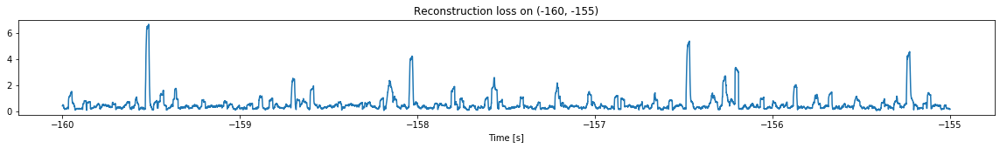

<--------
Entering sections:  (-155, -150)
-------->
Training for section:  (-160, -155)
Finished training, mean of the log(loss) is:  -0.6943125658275158
Triggering for section:  (-155, -150)
Using this mean for triggering: -0.7551638610123552


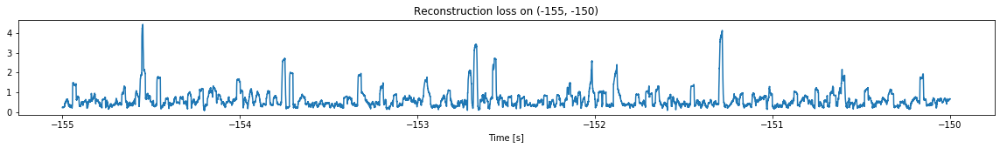

<--------
Entering sections:  (-150, -145)
-------->
Training for section:  (-155, -150)
Finished training, mean of the log(loss) is:  -0.7375161698452465
Triggering for section:  (-150, -145)
Using this mean for triggering: -0.6943125658275158


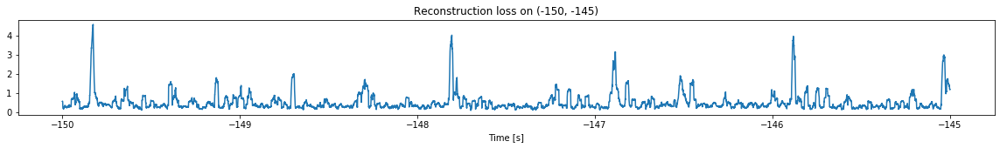

<--------
Entering sections:  (-145, -140)
-------->
Training for section:  (-150, -145)
Finished training, mean of the log(loss) is:  -0.6863958972339042
Triggering for section:  (-145, -140)
Using this mean for triggering: -0.7375161698452465


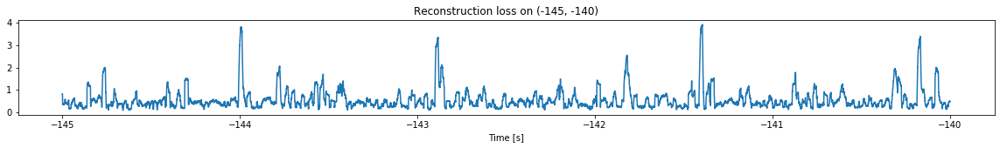

<--------
Entering sections:  (-140, -135)
-------->
Training for section:  (-145, -140)
Finished training, mean of the log(loss) is:  -0.7327309631668334
Triggering for section:  (-140, -135)
Using this mean for triggering: -0.6863958972339042


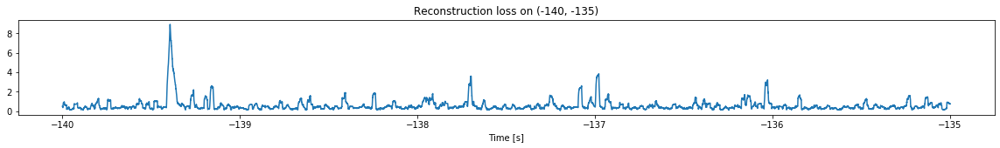

<--------
Entering sections:  (-135, -130)
-------->
Training for section:  (-140, -135)
Finished training, mean of the log(loss) is:  -0.6594574688332706
Triggering for section:  (-135, -130)
Using this mean for triggering: -0.7327309631668334


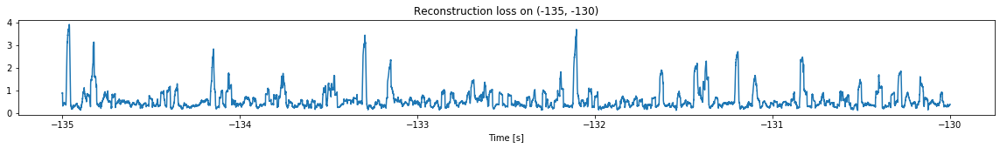

<--------
Entering sections:  (-130, -125)
-------->
Training for section:  (-135, -130)
Finished training, mean of the log(loss) is:  -0.7330572378235801
Triggering for section:  (-130, -125)
Using this mean for triggering: -0.6594574688332706


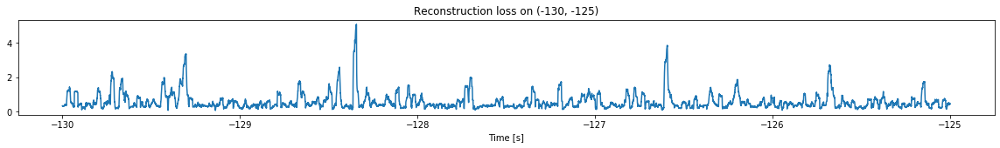

<--------
Entering sections:  (-125, -120)
-------->
Training for section:  (-130, -125)
Finished training, mean of the log(loss) is:  -0.7087190093508298
Triggering for section:  (-125, -120)
Using this mean for triggering: -0.7330572378235801


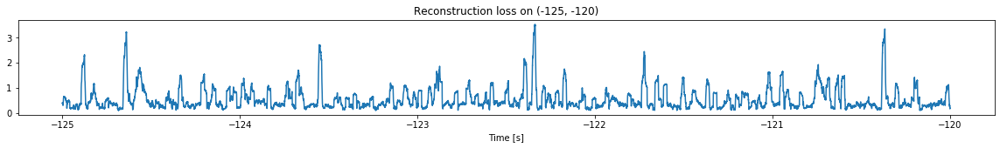

<--------
Entering sections:  (-120, -115)
-------->
Training for section:  (-125, -120)
Finished training, mean of the log(loss) is:  -0.7013047177717089
Triggering for section:  (-120, -115)
Using this mean for triggering: -0.7087190093508298


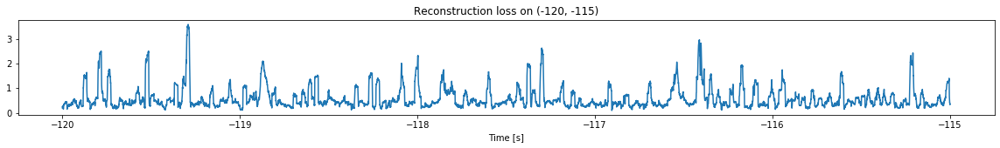

<--------
Entering sections:  (-115, -110)
-------->
Training for section:  (-120, -115)
Finished training, mean of the log(loss) is:  -0.7104226605575679
Triggering for section:  (-115, -110)
Using this mean for triggering: -0.7013047177717089


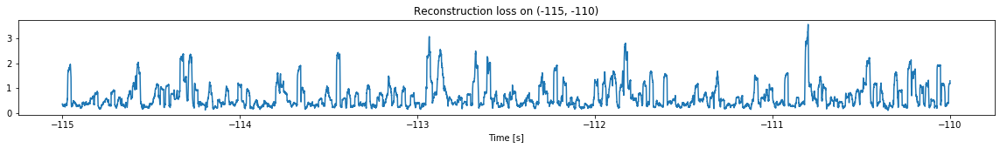

<--------
Entering sections:  (-110, -105)
-------->
Training for section:  (-115, -110)
Finished training, mean of the log(loss) is:  -0.7132872507744056
Triggering for section:  (-110, -105)
Using this mean for triggering: -0.7104226605575679


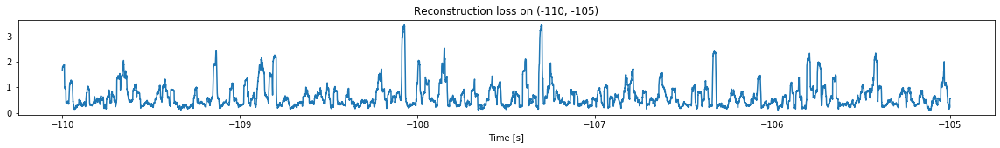

<--------
Entering sections:  (-105, -100)
-------->
Training for section:  (-110, -105)
Finished training, mean of the log(loss) is:  -0.6975541386082109
Triggering for section:  (-105, -100)
Using this mean for triggering: -0.7132872507744056


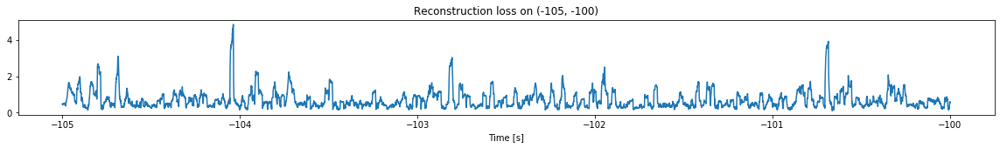

<--------
Entering sections:  (-100, -95)
-------->
Training for section:  (-105, -100)
Finished training, mean of the log(loss) is:  -0.6074041096158116
Triggering for section:  (-100, -95)
Using this mean for triggering: -0.6975541386082109


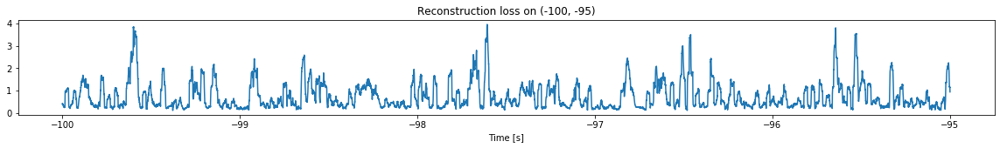

<--------
Entering sections:  (-95, -90)
-------->
Training for section:  (-100, -95)
Finished training, mean of the log(loss) is:  -0.6318714445348664
Triggering for section:  (-95, -90)
Using this mean for triggering: -0.6074041096158116


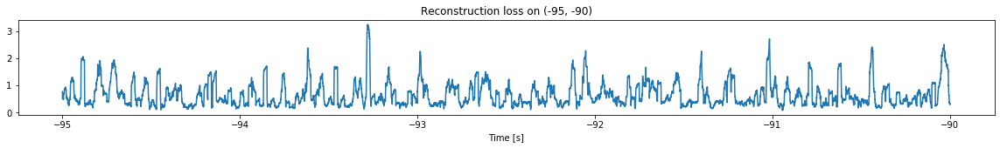

<--------
Entering sections:  (-90, -85)
-------->
Training for section:  (-95, -90)
Finished training, mean of the log(loss) is:  -0.6127744240607127
Triggering for section:  (-90, -85)
Using this mean for triggering: -0.6318714445348664


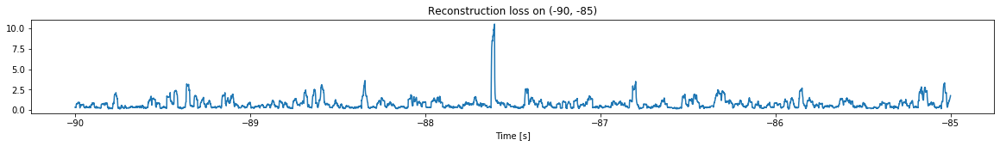

<--------
Entering sections:  (-85, -80)
-------->
Training for section:  (-90, -85)
Finished training, mean of the log(loss) is:  -0.6372895515865021
Triggering for section:  (-85, -80)
Using this mean for triggering: -0.6127744240607127


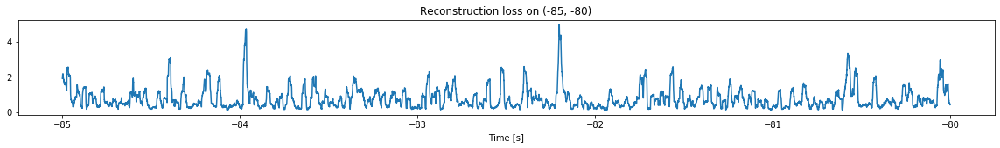

<--------
Entering sections:  (-80, -75)
-------->
Training for section:  (-85, -80)
Finished training, mean of the log(loss) is:  -0.6138829970476863
Triggering for section:  (-80, -75)
Using this mean for triggering: -0.6372895515865021


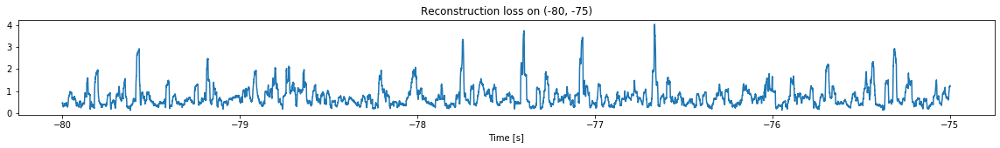

<--------
Entering sections:  (-75, -70)
-------->
Training for section:  (-80, -75)
Finished training, mean of the log(loss) is:  -0.6421519116398415
Triggering for section:  (-75, -70)
Using this mean for triggering: -0.6138829970476863


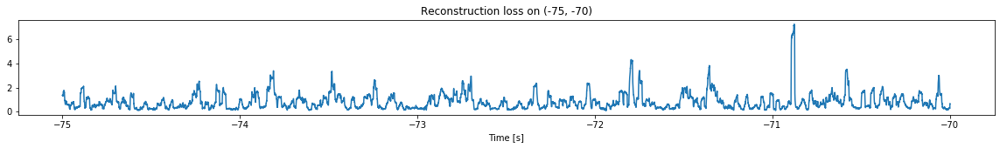

<--------
Entering sections:  (-70, -65)
-------->
Training for section:  (-75, -70)
Finished training, mean of the log(loss) is:  -0.602264014122692
Triggering for section:  (-70, -65)
Using this mean for triggering: -0.6421519116398415


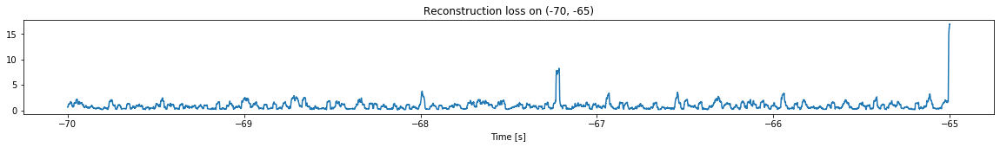

<--------
Entering sections:  (-65, -60)
-------->
Training for section:  (-70, -65)
Finished training, mean of the log(loss) is:  -0.5280838541816077
Triggering for section:  (-65, -60)
Using this mean for triggering: -0.602264014122692


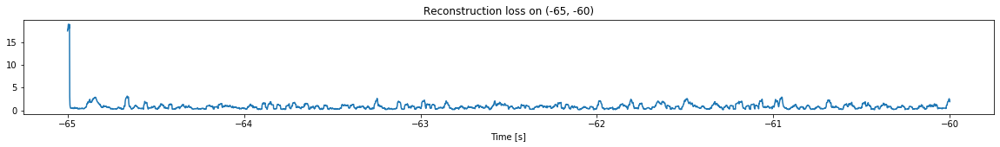

<--------
Entering sections:  (-60, -55)
-------->
Training for section:  (-65, -60)
Finished training, mean of the log(loss) is:  -0.5399630013228148
Triggering for section:  (-60, -55)
Using this mean for triggering: -0.5280838541816077


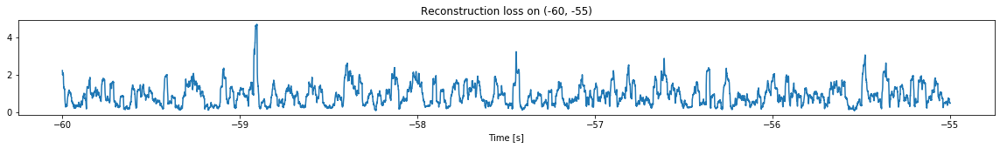

<--------
Entering sections:  (-55, -50)
-------->
Training for section:  (-60, -55)
Finished training, mean of the log(loss) is:  -0.6247403428583707
Triggering for section:  (-55, -50)
Using this mean for triggering: -0.5399630013228148


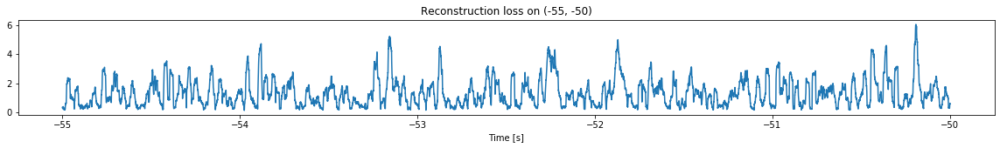

<--------
Entering sections:  (-50, -45)
-------->
Training for section:  (-55, -50)
Finished training, mean of the log(loss) is:  -0.6176928807029461
Triggering for section:  (-50, -45)
Using this mean for triggering: -0.6247403428583707


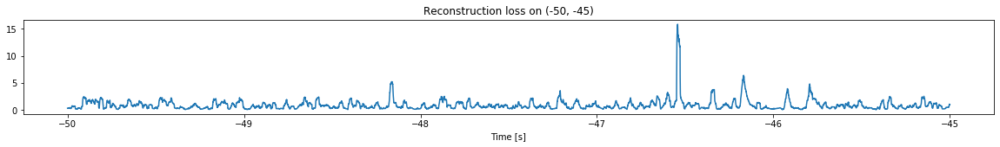

<--------
Entering sections:  (-45, -40)
-------->
Training for section:  (-50, -45)
Finished training, mean of the log(loss) is:  -0.5261432593789424
Triggering for section:  (-45, -40)
Using this mean for triggering: -0.6176928807029461


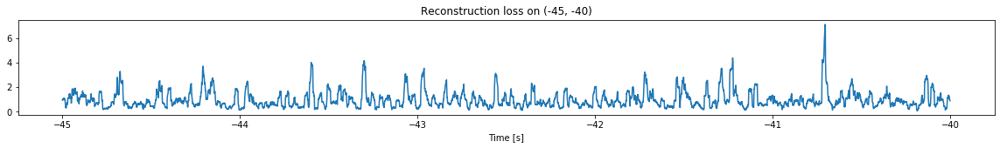

<--------
Entering sections:  (-40, -35)
-------->
Training for section:  (-45, -40)
Finished training, mean of the log(loss) is:  -0.5217197325301896
Triggering for section:  (-40, -35)
Using this mean for triggering: -0.5261432593789424


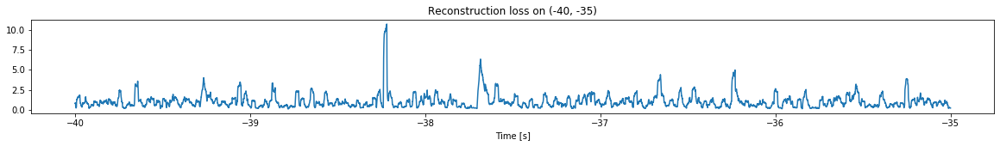

<--------
Entering sections:  (-35, -30)
-------->
Training for section:  (-40, -35)
Finished training, mean of the log(loss) is:  -0.5021861752485707
Triggering for section:  (-35, -30)
Using this mean for triggering: -0.5217197325301896


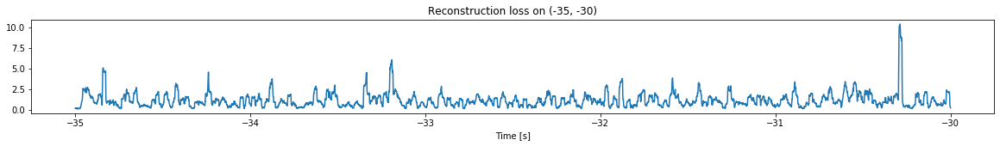

<--------
Entering sections:  (-30, -25)
-------->
Training for section:  (-35, -30)
Finished training, mean of the log(loss) is:  -0.507915724724178
Triggering for section:  (-30, -25)
Using this mean for triggering: -0.5021861752485707


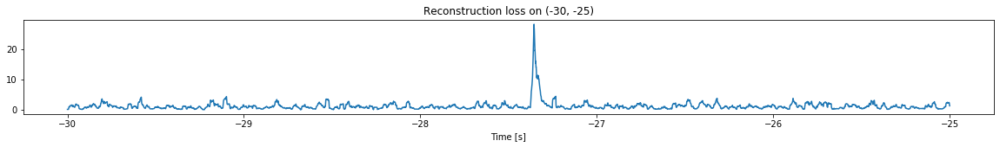

<--------
Entering sections:  (-25, -20)
-------->
Training for section:  (-30, -25)
Finished training, mean of the log(loss) is:  -0.49162556971637106
Triggering for section:  (-25, -20)
Using this mean for triggering: -0.507915724724178


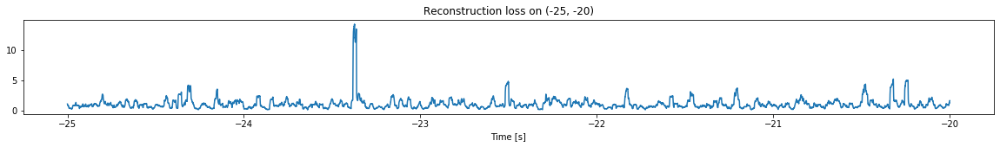

<--------
Entering sections:  (-20, -15)
-------->
Training for section:  (-25, -20)
Finished training, mean of the log(loss) is:  -0.47989125115490194
Triggering for section:  (-20, -15)
Using this mean for triggering: -0.49162556971637106


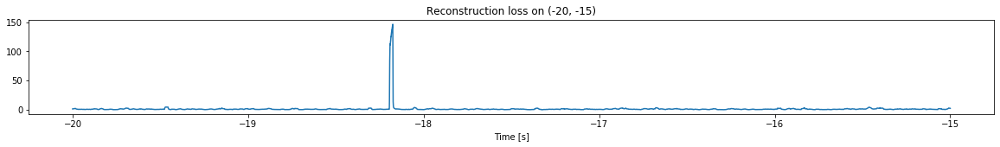

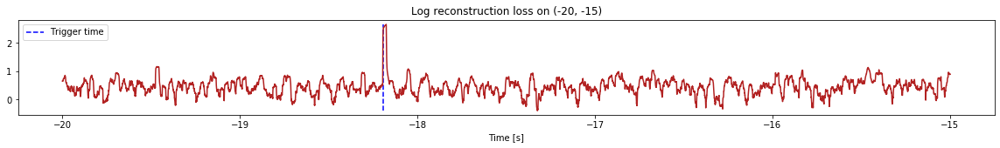

Triggered at:  -18.19229


-18.19229

In [10]:
simulation("./data/Ramp22/", 5, (-300,0))

Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
All data's shape:  (497500, 12)
Flushing input history
Number of sections: 10
Entering sections:  (-50, -45)
-------->
Entering sections:  (-45, -40)
-------->
Training for section:  (None, -45)
Finished training, mean of the log(loss) is:  -0.6813239586520949
<--------
Entering sections:  (-40, -35)
-------->
Training for section:  (-45, -40)
Finished training, mean of the log(loss) is:  -0.76296242749724
Triggering for section:  (-40, -35)
Using this mean for triggering: -0.6813239586520949


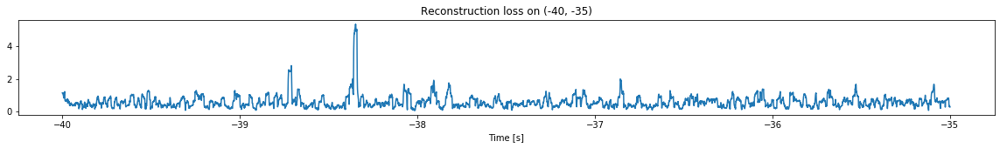

<--------
Entering sections:  (-35, -30)
-------->
Training for section:  (-40, -35)
Finished training, mean of the log(loss) is:  -0.6730288228708715
Triggering for section:  (-35, -30)
Using this mean for triggering: -0.76296242749724


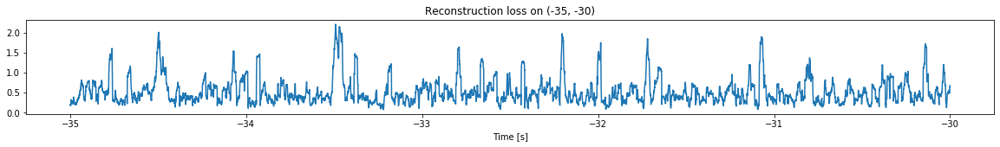

<--------
Entering sections:  (-30, -25)
-------->
Training for section:  (-35, -30)
Finished training, mean of the log(loss) is:  -0.7014230422074267
Triggering for section:  (-30, -25)
Using this mean for triggering: -0.6730288228708715


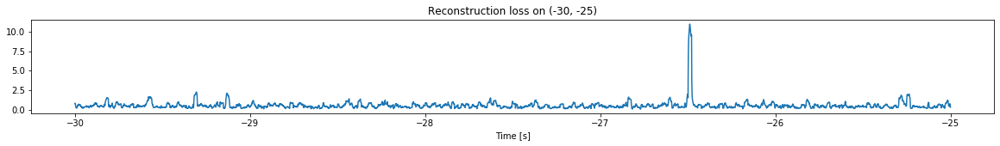

<--------
Entering sections:  (-25, -20)
-------->
Training for section:  (-30, -25)
Finished training, mean of the log(loss) is:  -0.6611968520470921
Triggering for section:  (-25, -20)
Using this mean for triggering: -0.7014230422074267


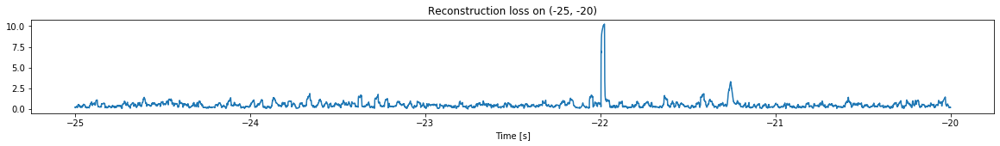

<--------
Entering sections:  (-20, -15)
-------->
Training for section:  (-25, -20)
Finished training, mean of the log(loss) is:  -0.6410812962829132
Triggering for section:  (-20, -15)
Using this mean for triggering: -0.6611968520470921


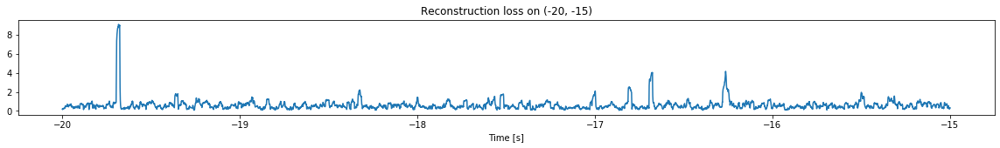

<--------
Entering sections:  (-15, -10)
-------->
Training for section:  (-20, -15)
Finished training, mean of the log(loss) is:  -0.6476874417422147
Triggering for section:  (-15, -10)
Using this mean for triggering: -0.6410812962829132


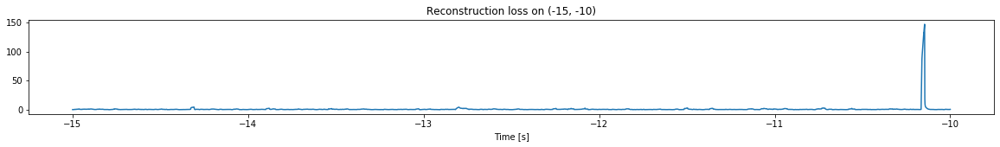

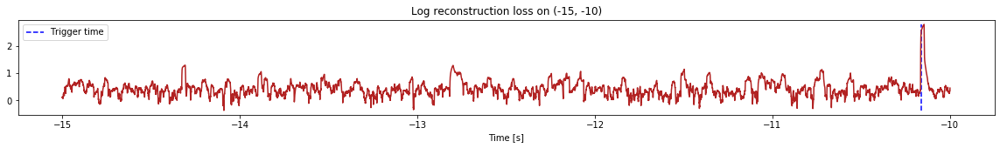

Triggered at:  -10.1627


-10.1627

In [11]:
simulation("./data/Ramp23/", 5, (-50,0))

Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
All data's shape:  (2997500, 12)
Flushing input history
Number of sections: 60
Entering sections:  (-300, -295)
-------->
Entering sections:  (-295, -290)
-------->
Training for section:  (None, -295)
Finished training, mean of the log(loss) is:  -0.6991130120808394
<--------
Entering sections:  (-290, -285)
-------->
Training for section:  (-295, -290)
Finished training, mean of the log(loss) is:  -0.6940957407341592
Triggering for section:  (-290, -285)
Using this mean for triggering: -0.6991130120808394


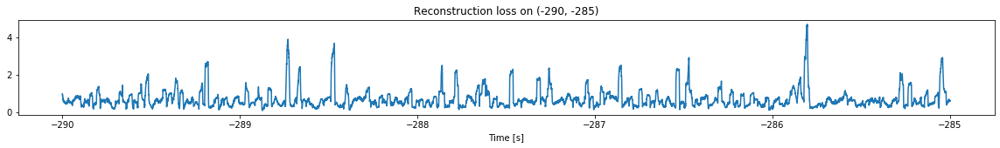

<--------
Entering sections:  (-285, -280)
-------->
Training for section:  (-290, -285)
Finished training, mean of the log(loss) is:  -0.6967797542878069
Triggering for section:  (-285, -280)
Using this mean for triggering: -0.6940957407341592


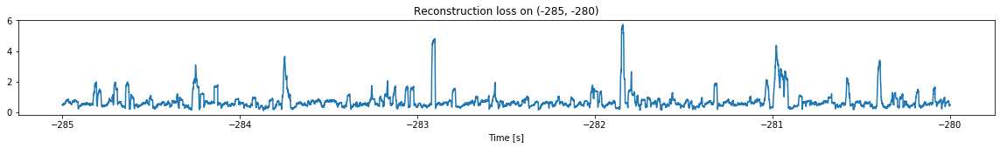

<--------
Entering sections:  (-280, -275)
-------->
Training for section:  (-285, -280)
Finished training, mean of the log(loss) is:  -0.6774516125702785
Triggering for section:  (-280, -275)
Using this mean for triggering: -0.6967797542878069


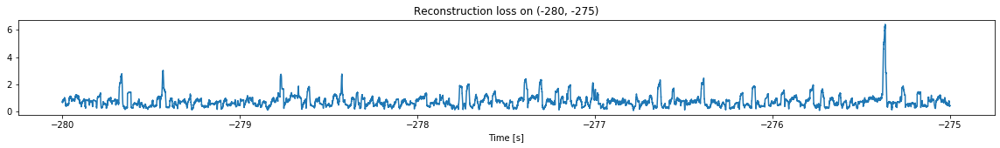

<--------
Entering sections:  (-275, -270)
-------->
Training for section:  (-280, -275)
Finished training, mean of the log(loss) is:  -0.6315963444737693
Triggering for section:  (-275, -270)
Using this mean for triggering: -0.6774516125702785


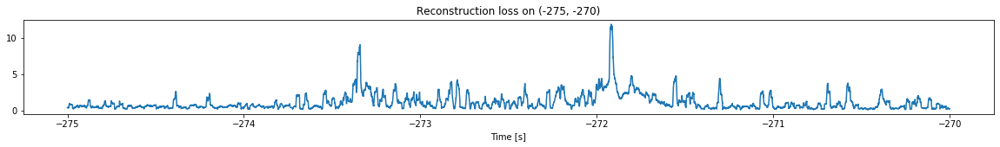

<--------
Entering sections:  (-270, -265)
-------->
Training for section:  (-275, -270)
Finished training, mean of the log(loss) is:  -0.5556633620339929
Triggering for section:  (-270, -265)
Using this mean for triggering: -0.6315963444737693


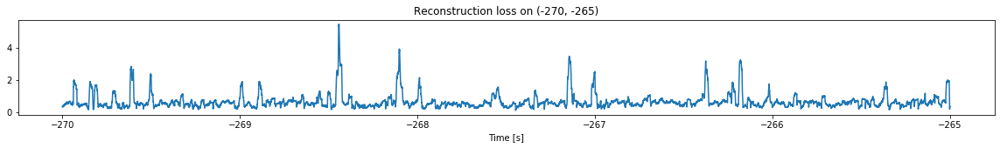

<--------
Entering sections:  (-265, -260)
-------->
Training for section:  (-270, -265)
Finished training, mean of the log(loss) is:  -0.6273414490256424
Triggering for section:  (-265, -260)
Using this mean for triggering: -0.5556633620339929


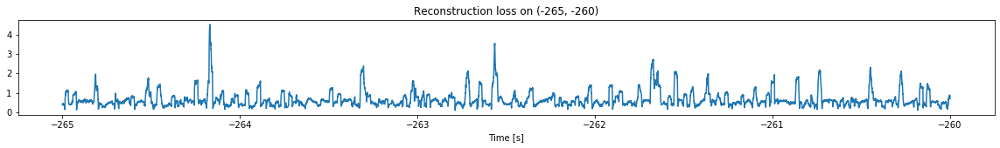

<--------
Entering sections:  (-260, -255)
-------->
Training for section:  (-265, -260)
Finished training, mean of the log(loss) is:  -0.681022013823442
Triggering for section:  (-260, -255)
Using this mean for triggering: -0.6273414490256424


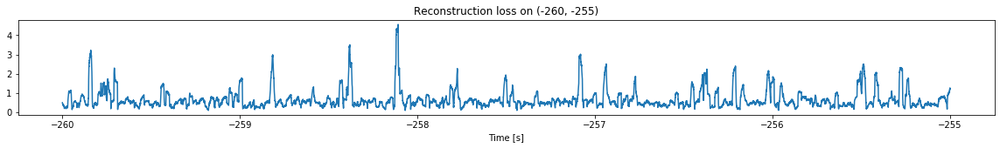

<--------
Entering sections:  (-255, -250)
-------->
Training for section:  (-260, -255)
Finished training, mean of the log(loss) is:  -0.649373285478074
Triggering for section:  (-255, -250)
Using this mean for triggering: -0.681022013823442


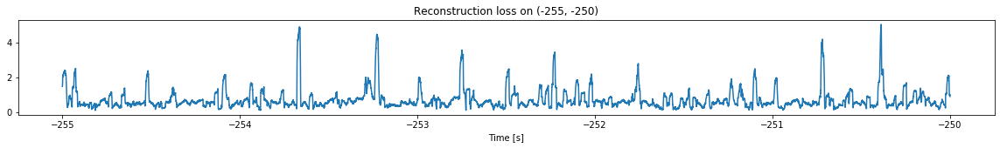

<--------
Entering sections:  (-250, -245)
-------->
Training for section:  (-255, -250)
Finished training, mean of the log(loss) is:  -0.6148053857605046
Triggering for section:  (-250, -245)
Using this mean for triggering: -0.649373285478074


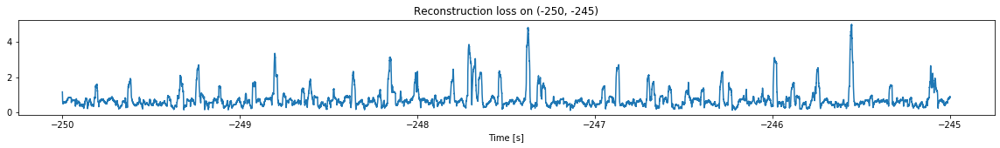

<--------
Entering sections:  (-245, -240)
-------->
Training for section:  (-250, -245)
Finished training, mean of the log(loss) is:  -0.6737663965303105
Triggering for section:  (-245, -240)
Using this mean for triggering: -0.6148053857605046


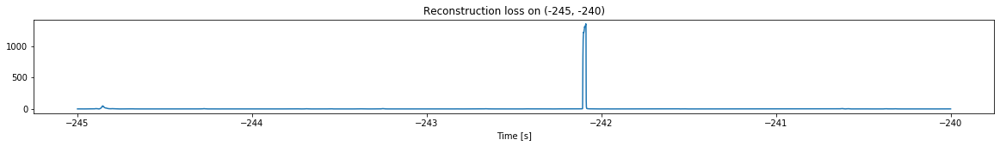

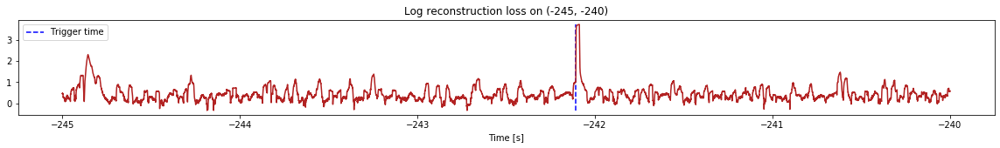

Triggered at:  -242.10707


-242.10707

In [12]:
simulation("./data/Ramp24/", 5, (-300,0))

Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
All data's shape:  (2997500, 12)
Flushing input history
Number of sections: 60
Entering sections:  (-300, -295)
-------->
Entering sections:  (-295, -290)
-------->
Training for section:  (None, -295)
Finished training, mean of the log(loss) is:  -0.6911724499316765
<--------
Entering sections:  (-290, -285)
-------->
Training for section:  (-295, -290)
Finished training, mean of the log(loss) is:  -0.6773954999477765
Triggering for section:  (-290, -285)
Using this mean for triggering: -0.6911724499316765


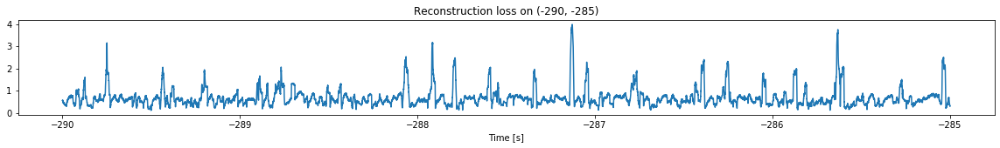

<--------
Entering sections:  (-285, -280)
-------->
Training for section:  (-290, -285)
Finished training, mean of the log(loss) is:  -0.724501078801979
Triggering for section:  (-285, -280)
Using this mean for triggering: -0.6773954999477765


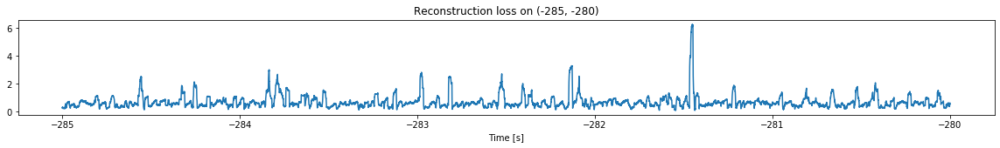

<--------
Entering sections:  (-280, -275)
-------->
Training for section:  (-285, -280)
Finished training, mean of the log(loss) is:  -0.7227853880558196
Triggering for section:  (-280, -275)
Using this mean for triggering: -0.724501078801979


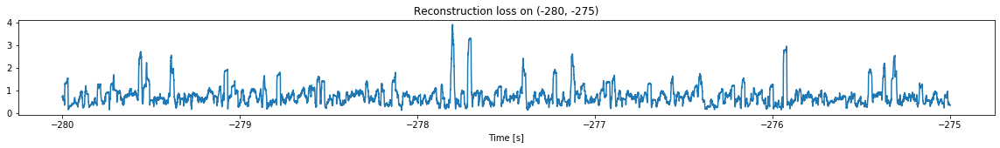

<--------
Entering sections:  (-275, -270)
-------->
Training for section:  (-280, -275)
Finished training, mean of the log(loss) is:  -0.7274069584508347
Triggering for section:  (-275, -270)
Using this mean for triggering: -0.7227853880558196


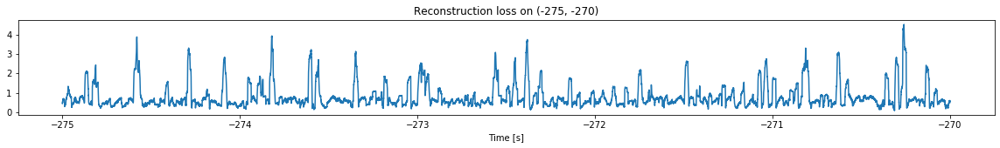

<--------
Entering sections:  (-270, -265)
-------->
Training for section:  (-275, -270)
Finished training, mean of the log(loss) is:  -0.6718800545785849
Triggering for section:  (-270, -265)
Using this mean for triggering: -0.7274069584508347


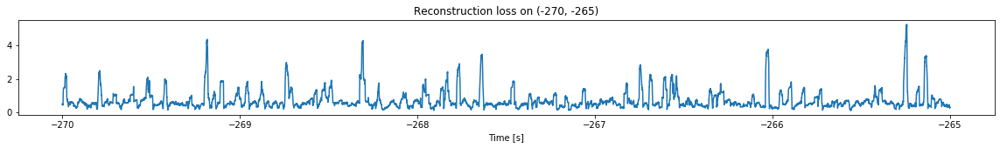

<--------
Entering sections:  (-265, -260)
-------->
Training for section:  (-270, -265)
Finished training, mean of the log(loss) is:  -0.6602695759211239
Triggering for section:  (-265, -260)
Using this mean for triggering: -0.6718800545785849


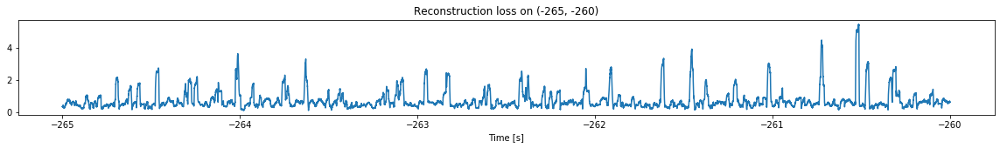

<--------
Entering sections:  (-260, -255)
-------->
Training for section:  (-265, -260)
Finished training, mean of the log(loss) is:  -0.6499766804514004
Triggering for section:  (-260, -255)
Using this mean for triggering: -0.6602695759211239


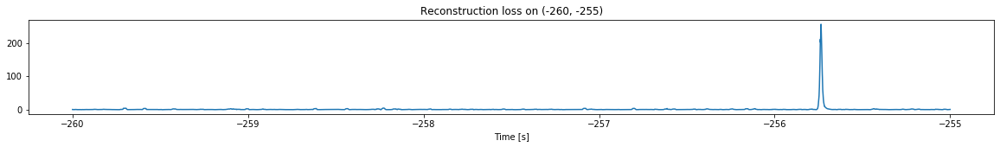

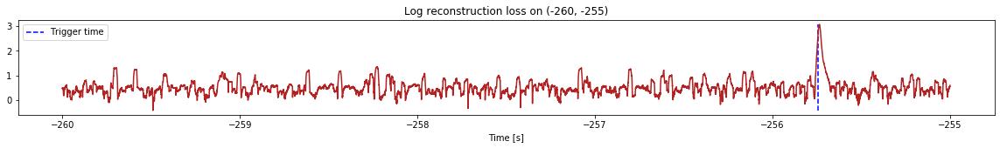

Triggered at:  -255.74467


-255.74467

In [13]:
simulation("./data/Ramp25/", 5, (-300,0))

Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
All data's shape:  (2997500, 12)
Flushing input history
Number of sections: 60
Entering sections:  (-300, -295)
-------->
Entering sections:  (-295, -290)
-------->
Training for section:  (None, -295)
Finished training, mean of the log(loss) is:  -0.6558603436342056
<--------
Entering sections:  (-290, -285)
-------->
Training for section:  (-295, -290)
Finished training, mean of the log(loss) is:  -0.6598402250424839
Triggering for section:  (-290, -285)
Using this mean for triggering: -0.6558603436342056


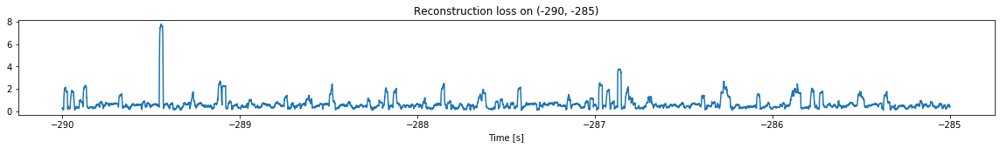

<--------
Entering sections:  (-285, -280)
-------->
Training for section:  (-290, -285)
Finished training, mean of the log(loss) is:  -0.6962369505853476
Triggering for section:  (-285, -280)
Using this mean for triggering: -0.6598402250424839


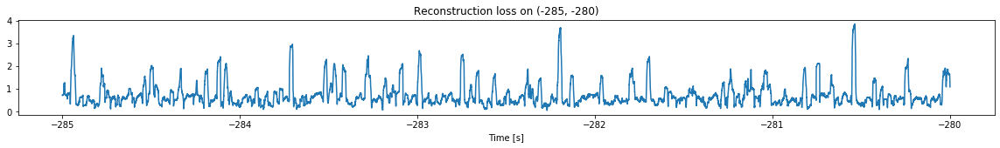

<--------
Entering sections:  (-280, -275)
-------->
Training for section:  (-285, -280)
Finished training, mean of the log(loss) is:  -0.7206989879882236
Triggering for section:  (-280, -275)
Using this mean for triggering: -0.6962369505853476


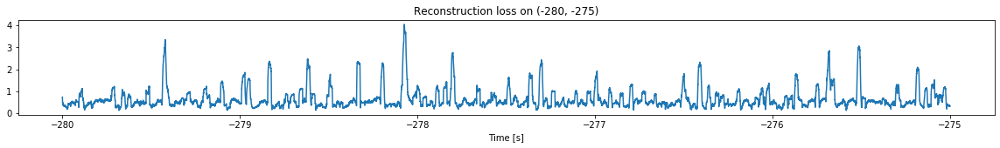

<--------
Entering sections:  (-275, -270)
-------->
Training for section:  (-280, -275)
Finished training, mean of the log(loss) is:  -0.7012518472248989
Triggering for section:  (-275, -270)
Using this mean for triggering: -0.7206989879882236


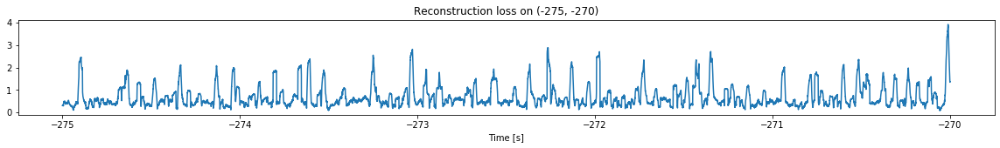

<--------
Entering sections:  (-270, -265)
-------->
Training for section:  (-275, -270)
Finished training, mean of the log(loss) is:  -0.649943133512531
Triggering for section:  (-270, -265)
Using this mean for triggering: -0.7012518472248989


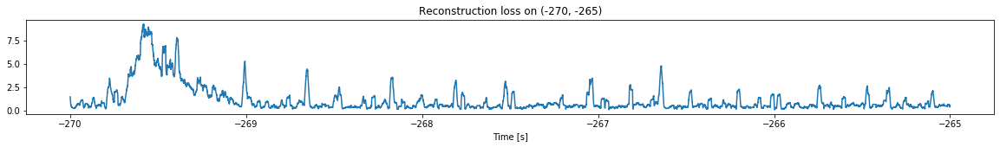

<--------
Entering sections:  (-265, -260)
-------->
Training for section:  (-270, -265)
Finished training, mean of the log(loss) is:  -0.5705550483530537
Triggering for section:  (-265, -260)
Using this mean for triggering: -0.649943133512531


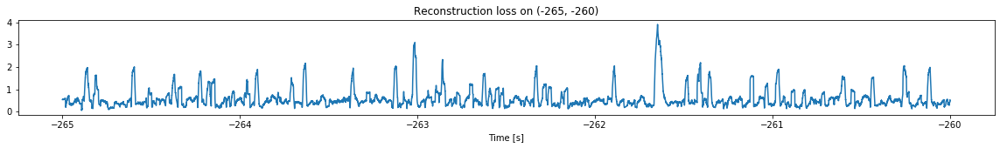

<--------
Entering sections:  (-260, -255)
-------->
Training for section:  (-265, -260)
Finished training, mean of the log(loss) is:  -0.6933285940935608
Triggering for section:  (-260, -255)
Using this mean for triggering: -0.5705550483530537


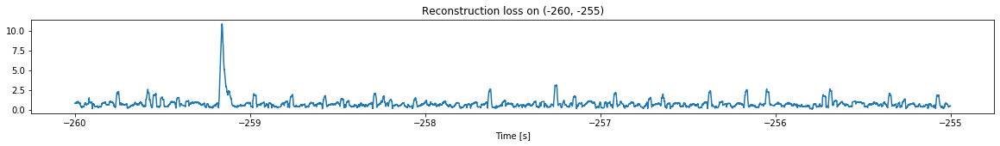

<--------
Entering sections:  (-255, -250)
-------->
Training for section:  (-260, -255)
Finished training, mean of the log(loss) is:  -0.6800338746813134
Triggering for section:  (-255, -250)
Using this mean for triggering: -0.6933285940935608


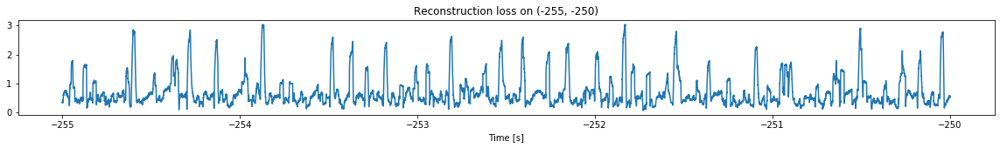

<--------
Entering sections:  (-250, -245)
-------->
Training for section:  (-255, -250)
Finished training, mean of the log(loss) is:  -0.7091737918729248
Triggering for section:  (-250, -245)
Using this mean for triggering: -0.6800338746813134


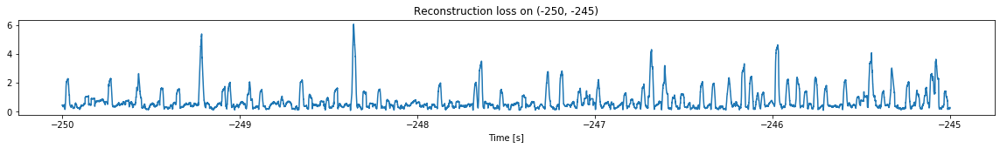

<--------
Entering sections:  (-245, -240)
-------->
Training for section:  (-250, -245)
Finished training, mean of the log(loss) is:  -0.6286065130466397
Triggering for section:  (-245, -240)
Using this mean for triggering: -0.7091737918729248


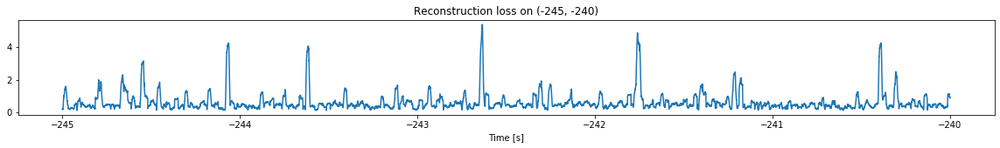

<--------
Entering sections:  (-240, -235)
-------->
Training for section:  (-245, -240)
Finished training, mean of the log(loss) is:  -0.7077803001982967
Triggering for section:  (-240, -235)
Using this mean for triggering: -0.6286065130466397


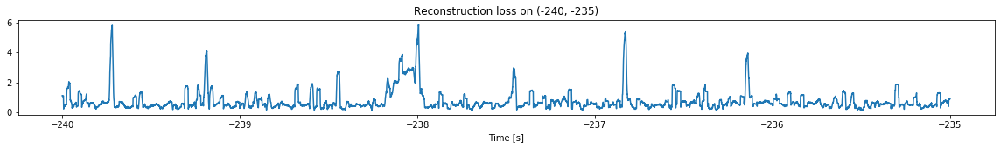

<--------
Entering sections:  (-235, -230)
-------->
Training for section:  (-240, -235)
Finished training, mean of the log(loss) is:  -0.7275220748496406
Triggering for section:  (-235, -230)
Using this mean for triggering: -0.7077803001982967


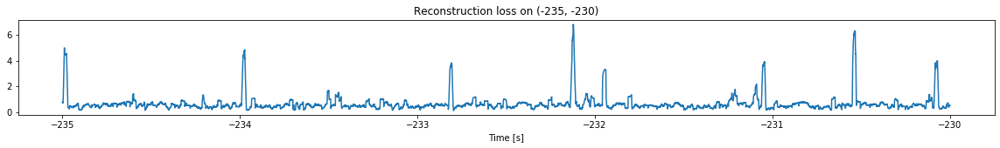

<--------
Entering sections:  (-230, -225)
-------->
Training for section:  (-235, -230)
Finished training, mean of the log(loss) is:  -0.7626106472987763
Triggering for section:  (-230, -225)
Using this mean for triggering: -0.7275220748496406


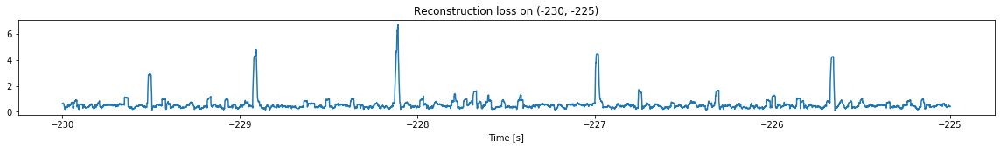

<--------
Entering sections:  (-225, -220)
-------->
Training for section:  (-230, -225)
Finished training, mean of the log(loss) is:  -0.73808794621479
Triggering for section:  (-225, -220)
Using this mean for triggering: -0.7626106472987763


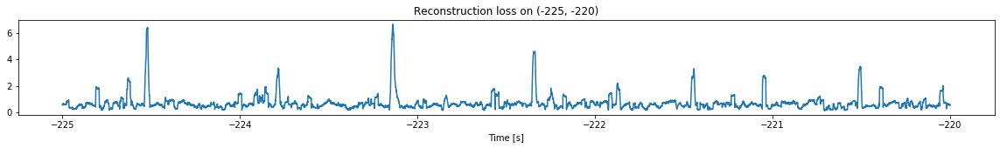

<--------
Entering sections:  (-220, -215)
-------->
Training for section:  (-225, -220)
Finished training, mean of the log(loss) is:  -0.7553965402898035
Triggering for section:  (-220, -215)
Using this mean for triggering: -0.73808794621479


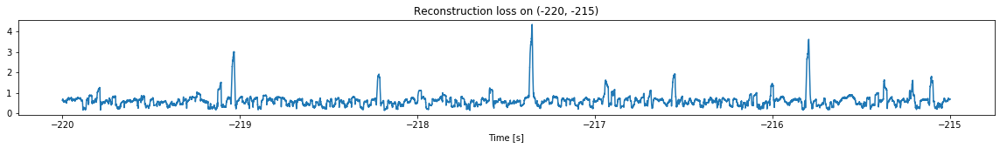

<--------
Entering sections:  (-215, -210)
-------->
Training for section:  (-220, -215)
Finished training, mean of the log(loss) is:  -0.7997662269066395
Triggering for section:  (-215, -210)
Using this mean for triggering: -0.7553965402898035


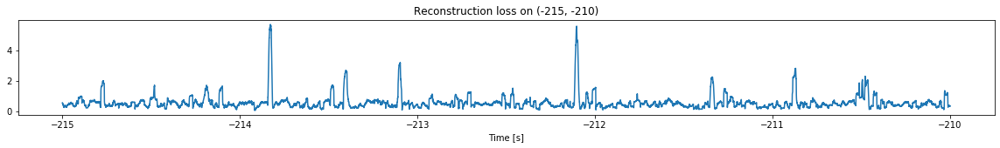

<--------
Entering sections:  (-210, -205)
-------->
Training for section:  (-215, -210)
Finished training, mean of the log(loss) is:  -0.8313353349976992
Triggering for section:  (-210, -205)
Using this mean for triggering: -0.7997662269066395


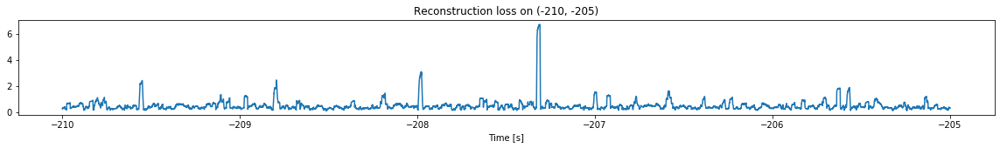

<--------
Entering sections:  (-205, -200)
-------->
Training for section:  (-210, -205)
Finished training, mean of the log(loss) is:  -0.7691816142137988
Triggering for section:  (-205, -200)
Using this mean for triggering: -0.8313353349976992


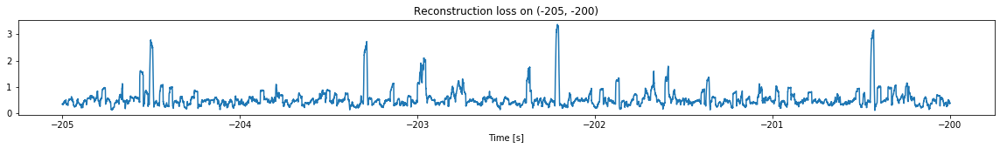

<--------
Entering sections:  (-200, -195)
-------->
Training for section:  (-205, -200)
Finished training, mean of the log(loss) is:  -0.7417707481756417
Triggering for section:  (-200, -195)
Using this mean for triggering: -0.7691816142137988


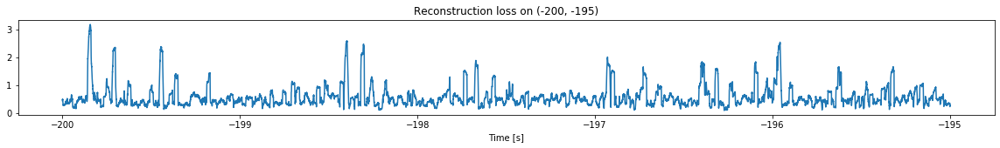

<--------
Entering sections:  (-195, -190)
-------->
Training for section:  (-200, -195)
Finished training, mean of the log(loss) is:  -0.7802550466236982
Triggering for section:  (-195, -190)
Using this mean for triggering: -0.7417707481756417


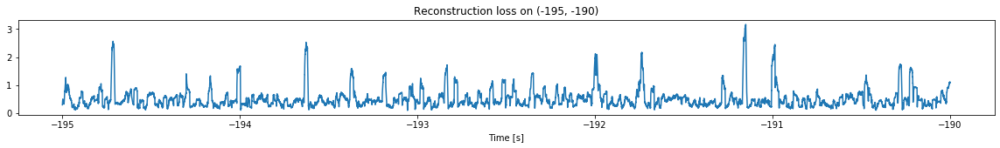

<--------
Entering sections:  (-190, -185)
-------->
Training for section:  (-195, -190)
Finished training, mean of the log(loss) is:  -0.8301541472303378
Triggering for section:  (-190, -185)
Using this mean for triggering: -0.7802550466236982


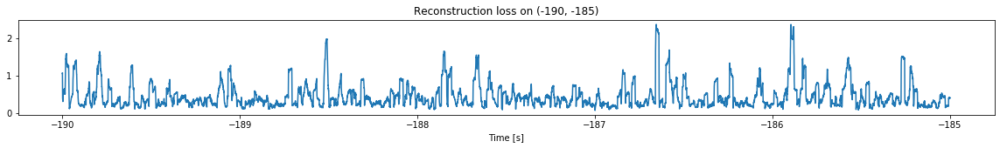

<--------
Entering sections:  (-185, -180)
-------->
Training for section:  (-190, -185)
Finished training, mean of the log(loss) is:  -0.7700105246250935
Triggering for section:  (-185, -180)
Using this mean for triggering: -0.8301541472303378


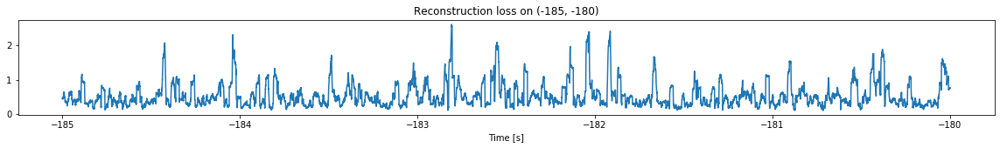

<--------
Entering sections:  (-180, -175)
-------->
Training for section:  (-185, -180)
Finished training, mean of the log(loss) is:  -0.7488702828306519
Triggering for section:  (-180, -175)
Using this mean for triggering: -0.7700105246250935


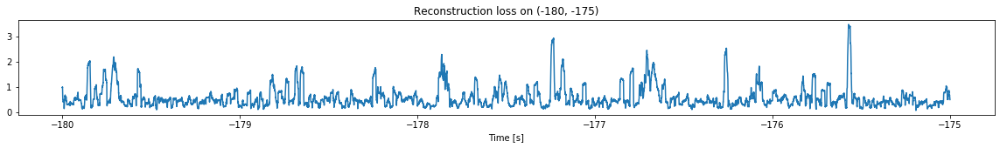

<--------
Entering sections:  (-175, -170)
-------->
Training for section:  (-180, -175)
Finished training, mean of the log(loss) is:  -0.7054829625724993
Triggering for section:  (-175, -170)
Using this mean for triggering: -0.7488702828306519


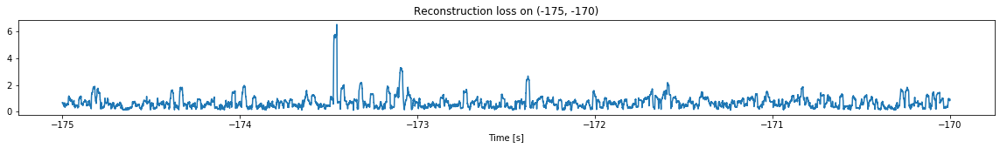

<--------
Entering sections:  (-170, -165)
-------->
Training for section:  (-175, -170)
Finished training, mean of the log(loss) is:  -0.6663263945987327
Triggering for section:  (-170, -165)
Using this mean for triggering: -0.7054829625724993


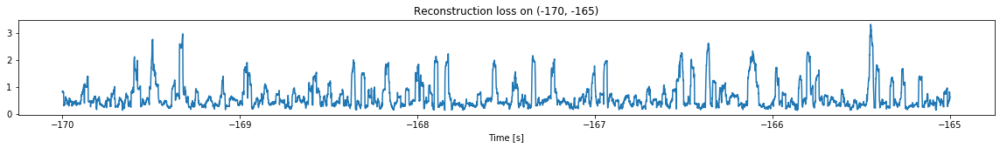

<--------
Entering sections:  (-165, -160)
-------->
Training for section:  (-170, -165)
Finished training, mean of the log(loss) is:  -0.7429435087088145
Triggering for section:  (-165, -160)
Using this mean for triggering: -0.6663263945987327


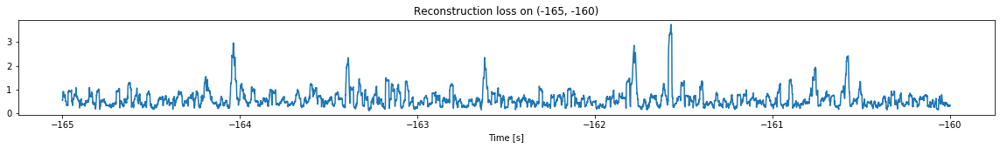

<--------
Entering sections:  (-160, -155)
-------->
Training for section:  (-165, -160)
Finished training, mean of the log(loss) is:  -0.7274941399378214
Triggering for section:  (-160, -155)
Using this mean for triggering: -0.7429435087088145


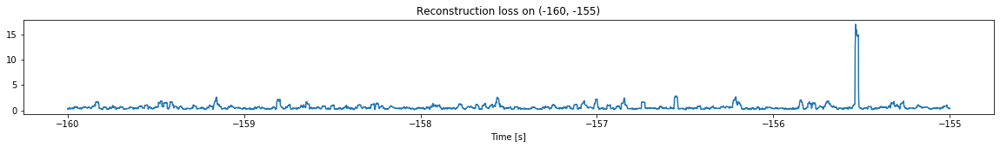

<--------
Entering sections:  (-155, -150)
-------->
Training for section:  (-160, -155)
Finished training, mean of the log(loss) is:  -0.6462286524956611
Triggering for section:  (-155, -150)
Using this mean for triggering: -0.7274941399378214


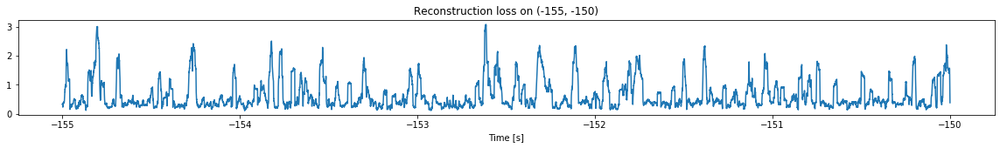

<--------
Entering sections:  (-150, -145)
-------->
Training for section:  (-155, -150)
Finished training, mean of the log(loss) is:  -0.6751871207176878
Triggering for section:  (-150, -145)
Using this mean for triggering: -0.6462286524956611


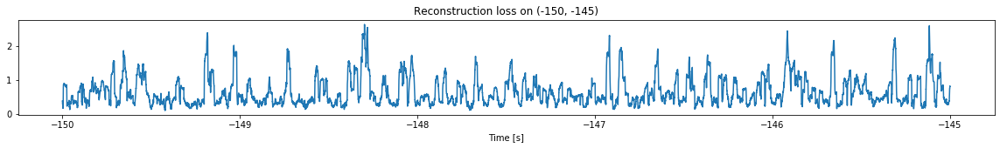

<--------
Entering sections:  (-145, -140)
-------->
Training for section:  (-150, -145)
Finished training, mean of the log(loss) is:  -0.6799765750424149
Triggering for section:  (-145, -140)
Using this mean for triggering: -0.6751871207176878


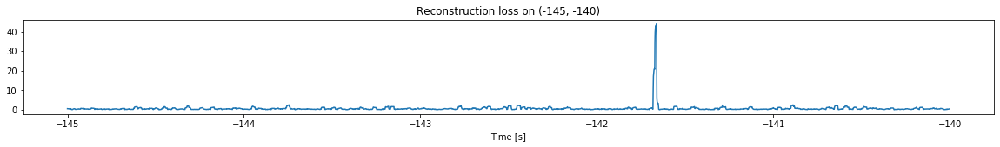

<--------
Entering sections:  (-140, -135)
-------->
Training for section:  (-145, -140)
Finished training, mean of the log(loss) is:  -0.5964911085274556
Triggering for section:  (-140, -135)
Using this mean for triggering: -0.6799765750424149


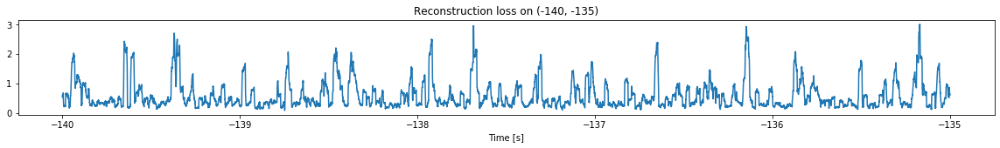

<--------
Entering sections:  (-135, -130)
-------->
Training for section:  (-140, -135)
Finished training, mean of the log(loss) is:  -0.6519602734996607
Triggering for section:  (-135, -130)
Using this mean for triggering: -0.5964911085274556


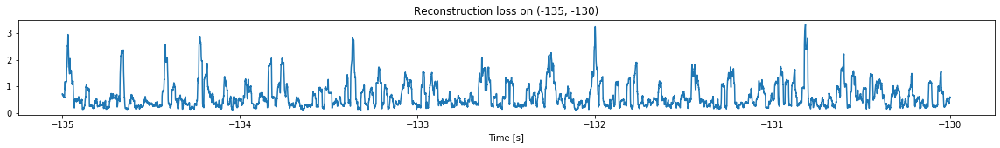

<--------
Entering sections:  (-130, -125)
-------->
Training for section:  (-135, -130)
Finished training, mean of the log(loss) is:  -0.6802015803008478
Triggering for section:  (-130, -125)
Using this mean for triggering: -0.6519602734996607


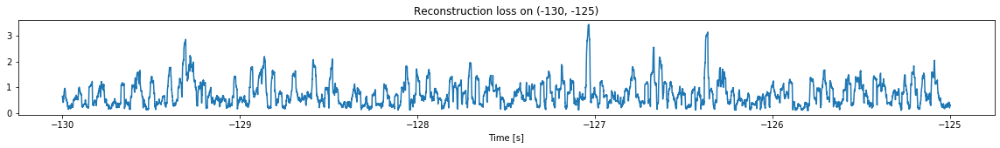

<--------
Entering sections:  (-125, -120)
-------->
Training for section:  (-130, -125)
Finished training, mean of the log(loss) is:  -0.6970331976290504
Triggering for section:  (-125, -120)
Using this mean for triggering: -0.6802015803008478


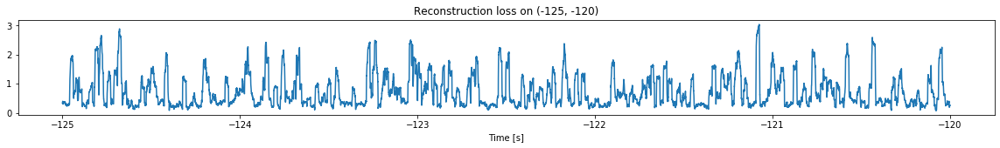

<--------
Entering sections:  (-120, -115)
-------->
Training for section:  (-125, -120)
Finished training, mean of the log(loss) is:  -0.6554792051155145
Triggering for section:  (-120, -115)
Using this mean for triggering: -0.6970331976290504


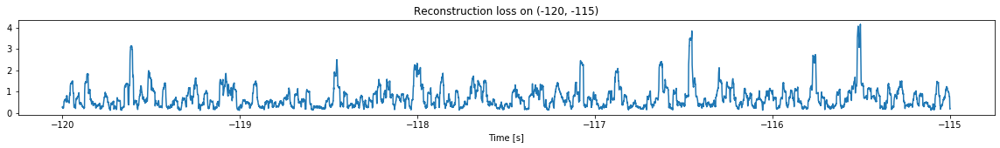

<--------
Entering sections:  (-115, -110)
-------->
Training for section:  (-120, -115)
Finished training, mean of the log(loss) is:  -0.5933055323669374
Triggering for section:  (-115, -110)
Using this mean for triggering: -0.6554792051155145


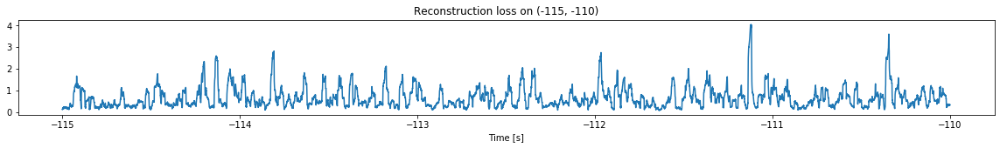

<--------
Entering sections:  (-110, -105)
-------->
Training for section:  (-115, -110)
Finished training, mean of the log(loss) is:  -0.5843170733202807
Triggering for section:  (-110, -105)
Using this mean for triggering: -0.5933055323669374


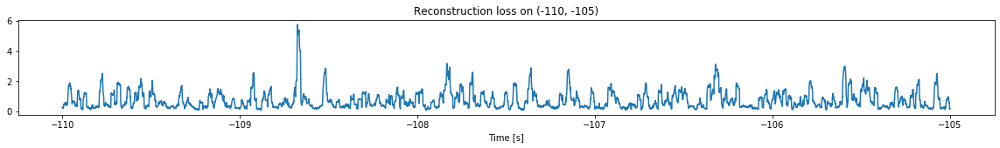

<--------
Entering sections:  (-105, -100)
-------->
Training for section:  (-110, -105)
Finished training, mean of the log(loss) is:  -0.6390045309605437
Triggering for section:  (-105, -100)
Using this mean for triggering: -0.5843170733202807


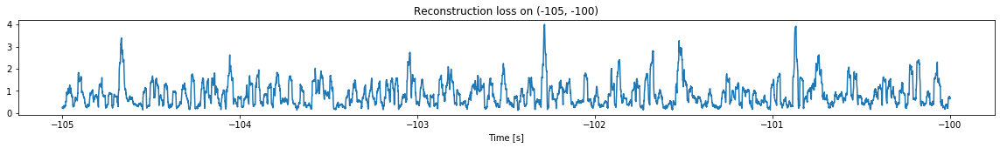

<--------
Entering sections:  (-100, -95)
-------->
Training for section:  (-105, -100)
Finished training, mean of the log(loss) is:  -0.5730593276730966
Triggering for section:  (-100, -95)
Using this mean for triggering: -0.6390045309605437


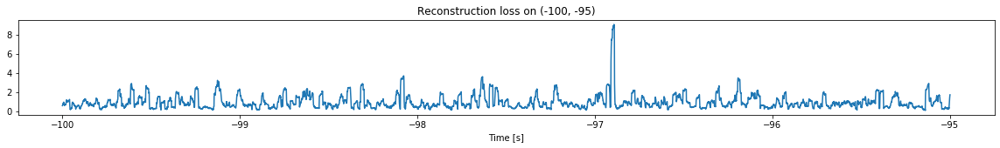

<--------
Entering sections:  (-95, -90)
-------->
Training for section:  (-100, -95)
Finished training, mean of the log(loss) is:  -0.5453974568490523
Triggering for section:  (-95, -90)
Using this mean for triggering: -0.5730593276730966


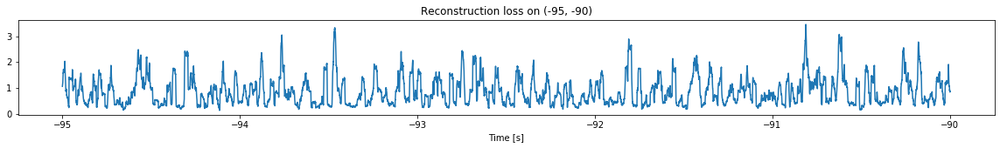

<--------
Entering sections:  (-90, -85)
-------->
Training for section:  (-95, -90)
Finished training, mean of the log(loss) is:  -0.5814350481348031
Triggering for section:  (-90, -85)
Using this mean for triggering: -0.5453974568490523


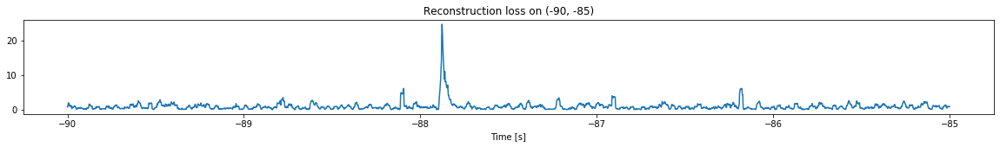

<--------
Entering sections:  (-85, -80)
-------->
Training for section:  (-90, -85)
Finished training, mean of the log(loss) is:  -0.5195679773526632
Triggering for section:  (-85, -80)
Using this mean for triggering: -0.5814350481348031


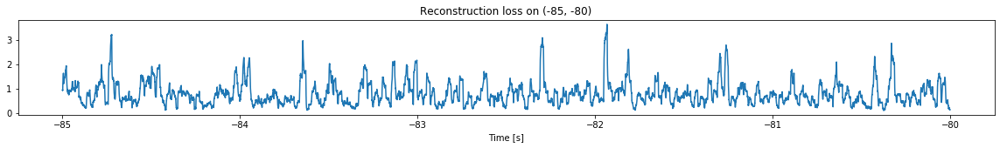

<--------
Entering sections:  (-80, -75)
-------->
Training for section:  (-85, -80)
Finished training, mean of the log(loss) is:  -0.4830941140998847
Triggering for section:  (-80, -75)
Using this mean for triggering: -0.5195679773526632


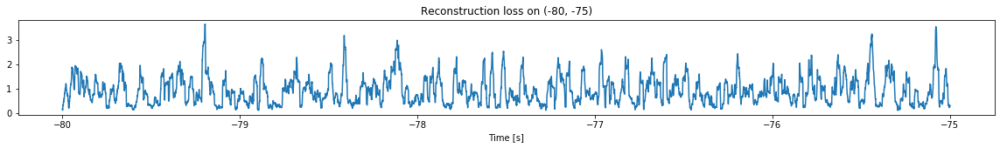

<--------
Entering sections:  (-75, -70)
-------->
Training for section:  (-80, -75)
Finished training, mean of the log(loss) is:  -0.5452726827211688
Triggering for section:  (-75, -70)
Using this mean for triggering: -0.4830941140998847


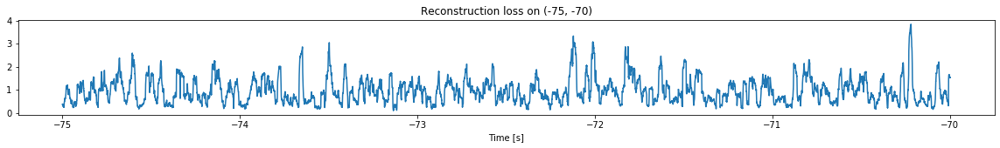

<--------
Entering sections:  (-70, -65)
-------->
Training for section:  (-75, -70)
Finished training, mean of the log(loss) is:  -0.530710680822021
Triggering for section:  (-70, -65)
Using this mean for triggering: -0.5452726827211688


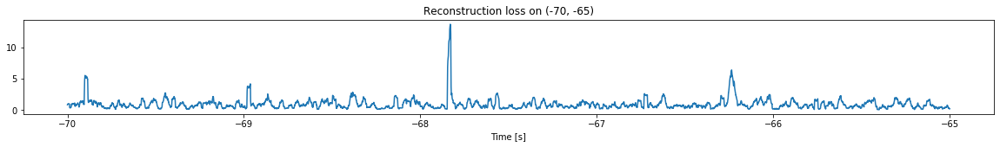

<--------
Entering sections:  (-65, -60)
-------->
Training for section:  (-70, -65)
Finished training, mean of the log(loss) is:  -0.5349290204156447
Triggering for section:  (-65, -60)
Using this mean for triggering: -0.530710680822021


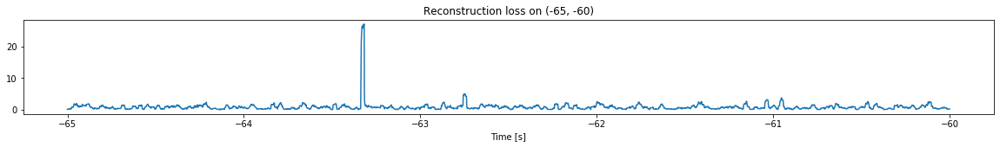

<--------
Entering sections:  (-60, -55)
-------->
Training for section:  (-65, -60)
Finished training, mean of the log(loss) is:  -0.5123301283545542
Triggering for section:  (-60, -55)
Using this mean for triggering: -0.5349290204156447


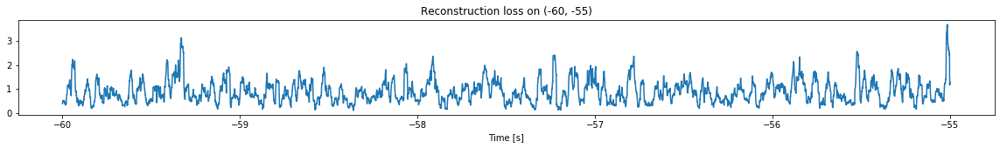

<--------
Entering sections:  (-55, -50)
-------->
Training for section:  (-60, -55)
Finished training, mean of the log(loss) is:  -0.5746259639189787
Triggering for section:  (-55, -50)
Using this mean for triggering: -0.5123301283545542


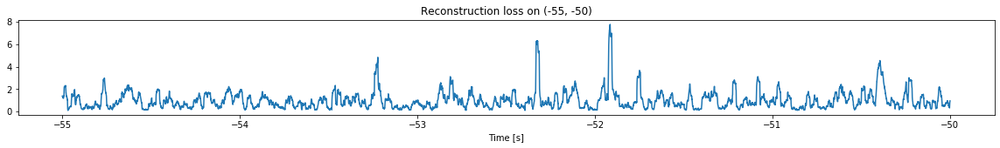

<--------
Entering sections:  (-50, -45)
-------->
Training for section:  (-55, -50)
Finished training, mean of the log(loss) is:  -0.561957079448401
Triggering for section:  (-50, -45)
Using this mean for triggering: -0.5746259639189787


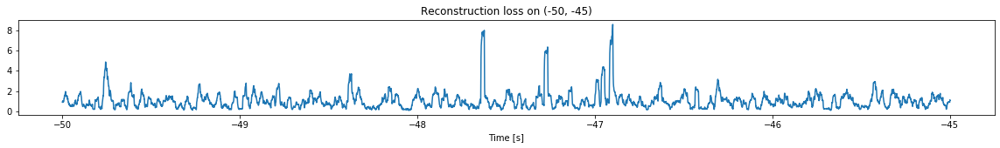

<--------
Entering sections:  (-45, -40)
-------->
Training for section:  (-50, -45)
Finished training, mean of the log(loss) is:  -0.5420756919082639
Triggering for section:  (-45, -40)
Using this mean for triggering: -0.561957079448401


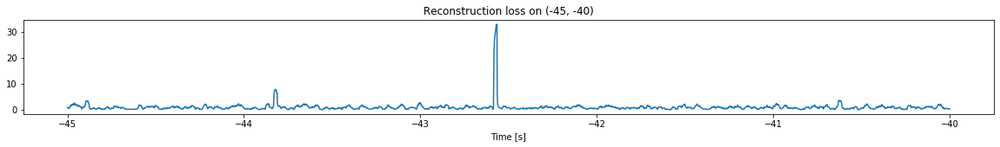

<--------
Entering sections:  (-40, -35)
-------->
Training for section:  (-45, -40)
Finished training, mean of the log(loss) is:  -0.5239547172256341
Triggering for section:  (-40, -35)
Using this mean for triggering: -0.5420756919082639


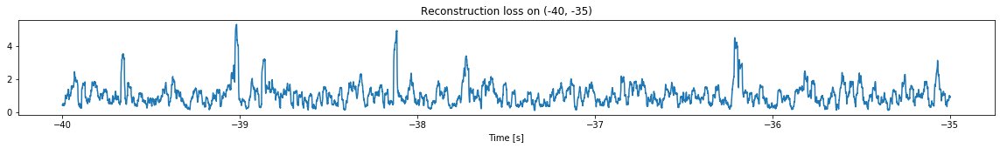

<--------
Entering sections:  (-35, -30)
-------->
Training for section:  (-40, -35)
Finished training, mean of the log(loss) is:  -0.47741583114859387
Triggering for section:  (-35, -30)
Using this mean for triggering: -0.5239547172256341


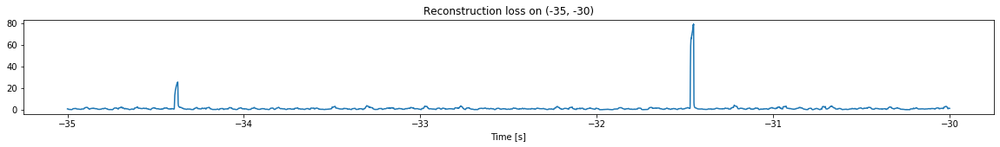

<--------
Entering sections:  (-30, -25)
-------->
Training for section:  (-35, -30)
Finished training, mean of the log(loss) is:  -0.4609876544862115
Triggering for section:  (-30, -25)
Using this mean for triggering: -0.47741583114859387


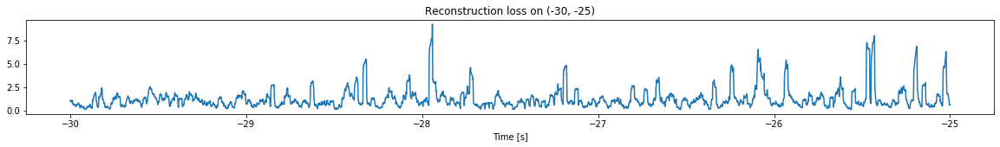

<--------
Entering sections:  (-25, -20)
-------->
Training for section:  (-30, -25)
Finished training, mean of the log(loss) is:  -0.45180893259412974
Triggering for section:  (-25, -20)
Using this mean for triggering: -0.4609876544862115


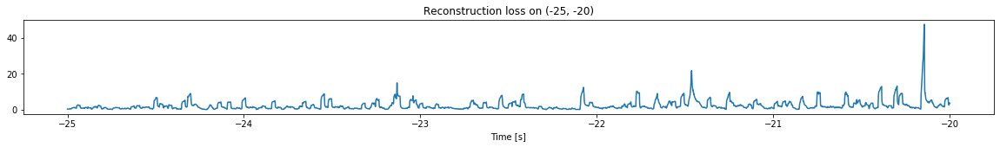

<--------
Entering sections:  (-20, -15)
-------->
Training for section:  (-25, -20)
Finished training, mean of the log(loss) is:  -0.2798252687956485
Triggering for section:  (-20, -15)
Using this mean for triggering: -0.45180893259412974


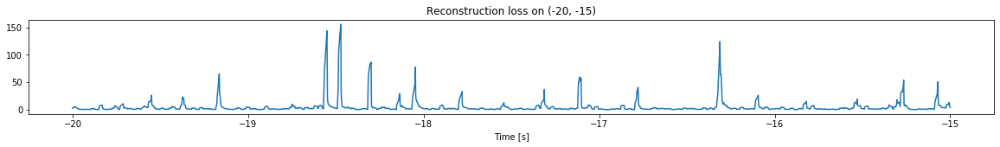

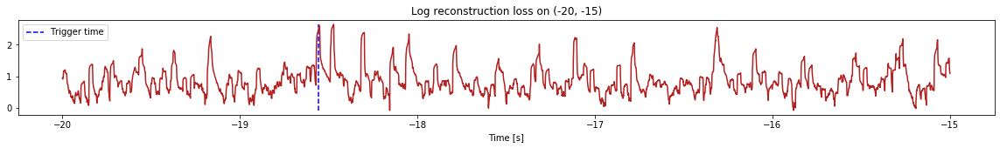

Triggered at:  -18.557089


-18.557089

In [14]:
simulation("./data/Ramp26/", 5, (-300,0))

Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
All data's shape:  (2997500, 12)
Flushing input history
Number of sections: 60
Entering sections:  (-300, -295)
-------->
Entering sections:  (-295, -290)
-------->
Training for section:  (None, -295)
Finished training, mean of the log(loss) is:  -0.6801442806433174
<--------
Entering sections:  (-290, -285)
-------->
Training for section:  (-295, -290)
Finished training, mean of the log(loss) is:  -0.6158579763603944
Triggering for section:  (-290, -285)
Using this mean for triggering: -0.6801442806433174


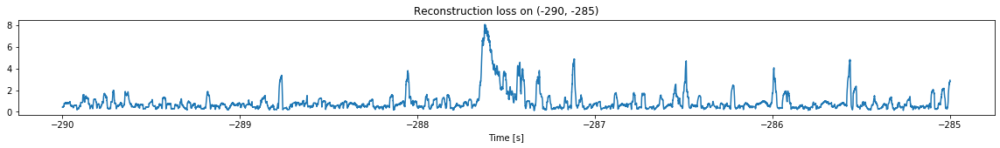

<--------
Entering sections:  (-285, -280)
-------->
Training for section:  (-290, -285)
Finished training, mean of the log(loss) is:  -0.5903794221361823
Triggering for section:  (-285, -280)
Using this mean for triggering: -0.6158579763603944


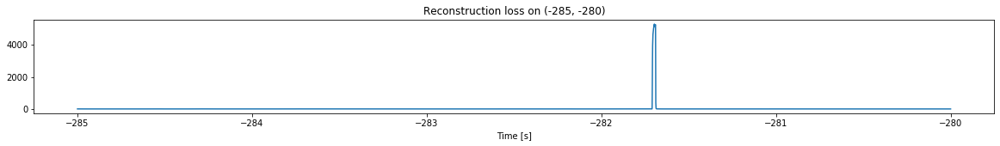

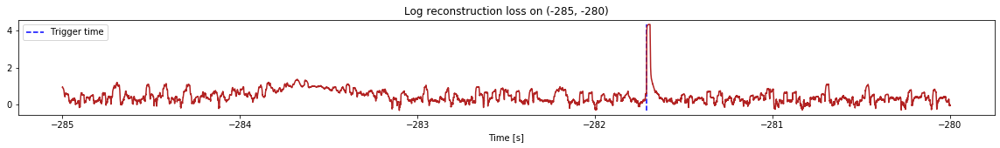

Triggered at:  -281.7092


-281.7092

In [15]:
simulation("./data/Ramp27/", 5, (-300,0))

Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
All data's shape:  (2997500, 12)
Flushing input history
Number of sections: 60
Entering sections:  (-300, -295)
-------->
Entering sections:  (-295, -290)
-------->
Training for section:  (None, -295)
Finished training, mean of the log(loss) is:  -0.7317668825696431
<--------
Entering sections:  (-290, -285)
-------->
Training for section:  (-295, -290)
Finished training, mean of the log(loss) is:  -0.7248219731106427
Triggering for section:  (-290, -285)
Using this mean for triggering: -0.7317668825696431


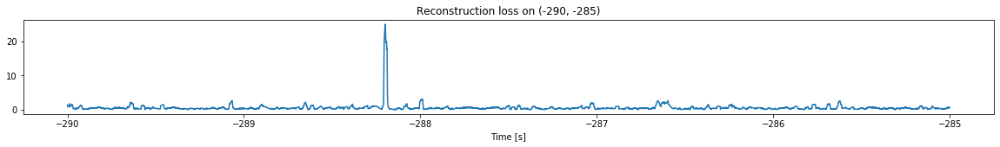

<--------
Entering sections:  (-285, -280)
-------->
Training for section:  (-290, -285)
Finished training, mean of the log(loss) is:  -0.7414988229213207
Triggering for section:  (-285, -280)
Using this mean for triggering: -0.7248219731106427


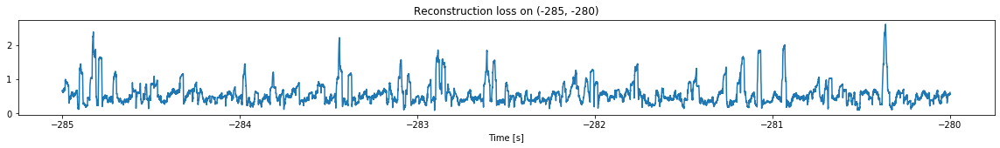

<--------
Entering sections:  (-280, -275)
-------->
Training for section:  (-285, -280)
Finished training, mean of the log(loss) is:  -0.798897836151358
Triggering for section:  (-280, -275)
Using this mean for triggering: -0.7414988229213207


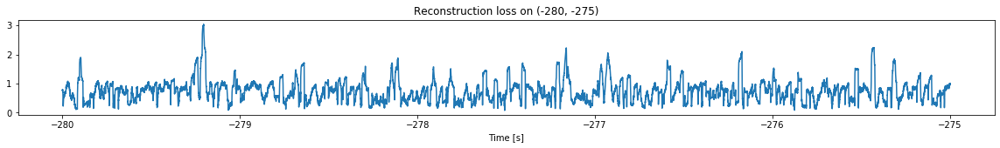

<--------
Entering sections:  (-275, -270)
-------->
Training for section:  (-280, -275)
Finished training, mean of the log(loss) is:  -0.7216171386977275
Triggering for section:  (-275, -270)
Using this mean for triggering: -0.798897836151358


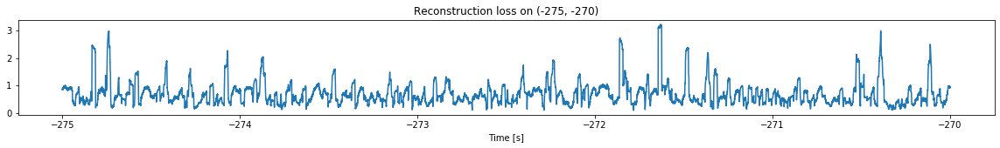

<--------
Entering sections:  (-270, -265)
-------->
Training for section:  (-275, -270)
Finished training, mean of the log(loss) is:  -0.7391644594836466
Triggering for section:  (-270, -265)
Using this mean for triggering: -0.7216171386977275


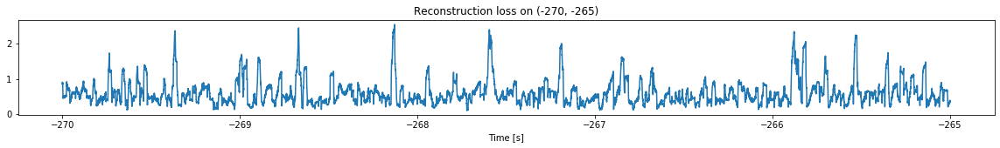

<--------
Entering sections:  (-265, -260)
-------->
Training for section:  (-270, -265)
Finished training, mean of the log(loss) is:  -0.7126849368114783
Triggering for section:  (-265, -260)
Using this mean for triggering: -0.7391644594836466


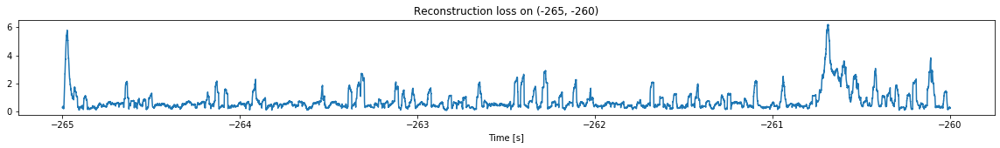

<--------
Entering sections:  (-260, -255)
-------->
Training for section:  (-265, -260)
Finished training, mean of the log(loss) is:  -0.666826480503151
Triggering for section:  (-260, -255)
Using this mean for triggering: -0.7126849368114783


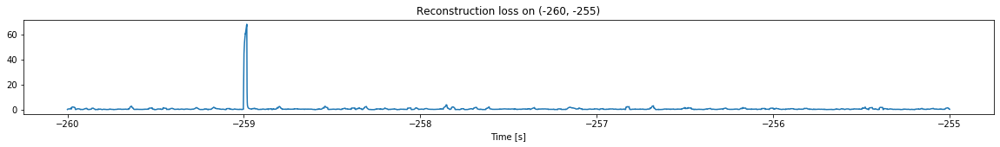

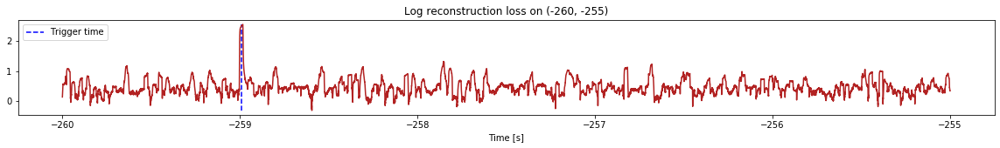

Triggered at:  -258.9906


-258.9906

In [16]:
simulation("./data/Ramp28/", 5, (-300,0))

Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
All data's shape:  (2997500, 12)
Flushing input history
Number of sections: 60
Entering sections:  (-300, -295)
-------->
Entering sections:  (-295, -290)
-------->
Training for section:  (None, -295)
Finished training, mean of the log(loss) is:  -0.6694319989517787
<--------
Entering sections:  (-290, -285)
-------->
Training for section:  (-295, -290)
Finished training, mean of the log(loss) is:  -0.6408056925368918
Triggering for section:  (-290, -285)
Using this mean for triggering: -0.6694319989517787


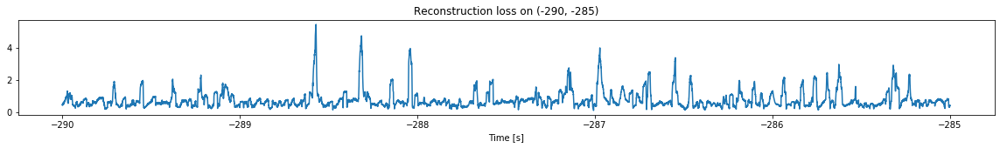

<--------
Entering sections:  (-285, -280)
-------->
Training for section:  (-290, -285)
Finished training, mean of the log(loss) is:  -0.6399891550706608
Triggering for section:  (-285, -280)
Using this mean for triggering: -0.6408056925368918


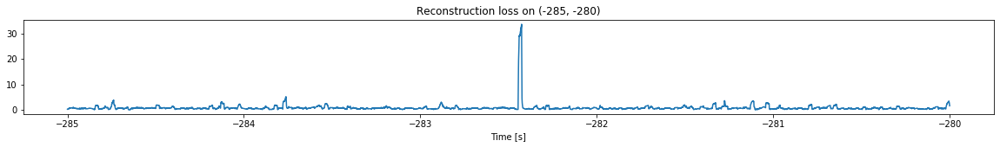

<--------
Entering sections:  (-280, -275)
-------->
Training for section:  (-285, -280)
Finished training, mean of the log(loss) is:  -0.6476289328444165
Triggering for section:  (-280, -275)
Using this mean for triggering: -0.6399891550706608


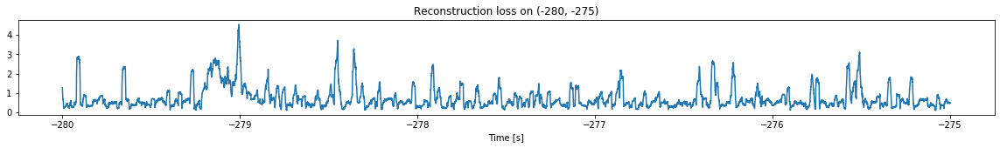

<--------
Entering sections:  (-275, -270)
-------->
Training for section:  (-280, -275)
Finished training, mean of the log(loss) is:  -0.6398516875712292
Triggering for section:  (-275, -270)
Using this mean for triggering: -0.6476289328444165


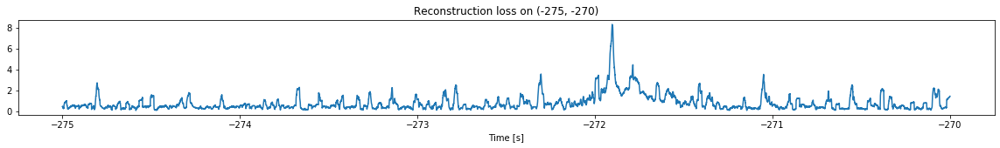

<--------
Entering sections:  (-270, -265)
-------->
Training for section:  (-275, -270)
Finished training, mean of the log(loss) is:  -0.5568703737372174
Triggering for section:  (-270, -265)
Using this mean for triggering: -0.6398516875712292


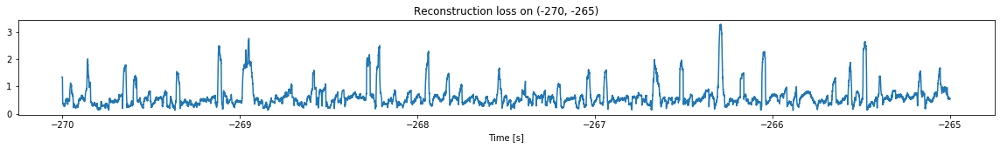

<--------
Entering sections:  (-265, -260)
-------->
Training for section:  (-270, -265)
Finished training, mean of the log(loss) is:  -0.6924720314878836
Triggering for section:  (-265, -260)
Using this mean for triggering: -0.5568703737372174


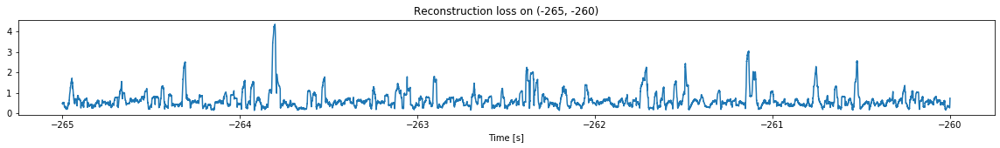

<--------
Entering sections:  (-260, -255)
-------->
Training for section:  (-265, -260)
Finished training, mean of the log(loss) is:  -0.6807674077486965
Triggering for section:  (-260, -255)
Using this mean for triggering: -0.6924720314878836


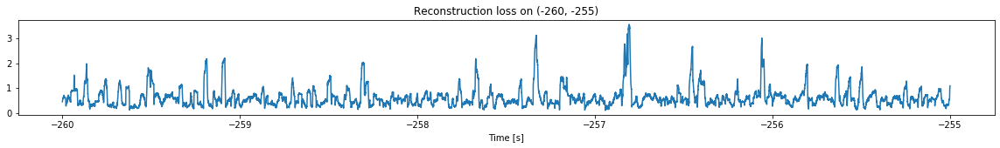

<--------
Entering sections:  (-255, -250)
-------->
Training for section:  (-260, -255)
Finished training, mean of the log(loss) is:  -0.7378958669823238
Triggering for section:  (-255, -250)
Using this mean for triggering: -0.6807674077486965


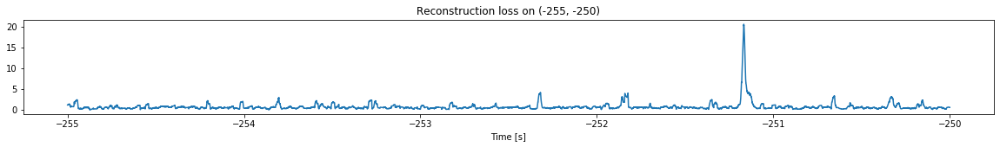

<--------
Entering sections:  (-250, -245)
-------->
Training for section:  (-255, -250)
Finished training, mean of the log(loss) is:  -0.6538166591552259
Triggering for section:  (-250, -245)
Using this mean for triggering: -0.7378958669823238


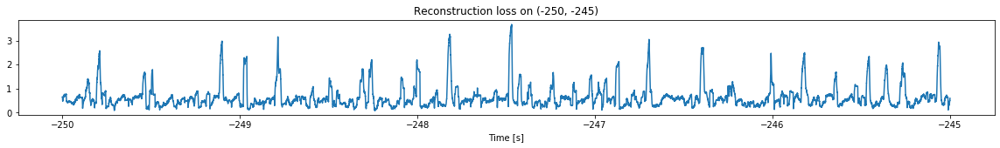

<--------
Entering sections:  (-245, -240)
-------->
Training for section:  (-250, -245)
Finished training, mean of the log(loss) is:  -0.6957826506304746
Triggering for section:  (-245, -240)
Using this mean for triggering: -0.6538166591552259


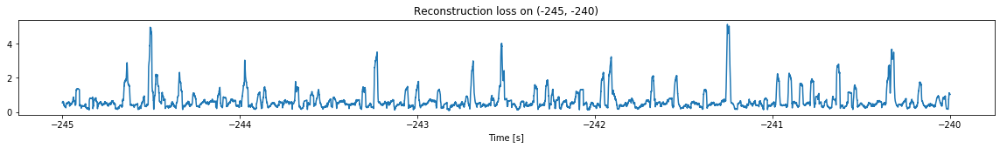

<--------
Entering sections:  (-240, -235)
-------->
Training for section:  (-245, -240)
Finished training, mean of the log(loss) is:  -0.6382583190657418
Triggering for section:  (-240, -235)
Using this mean for triggering: -0.6957826506304746


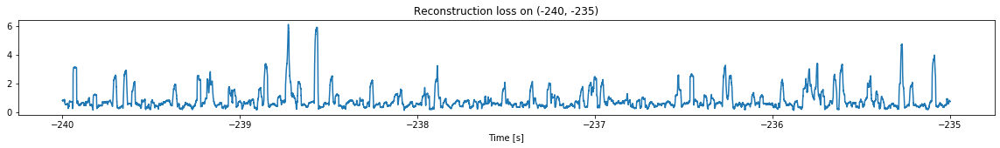

<--------
Entering sections:  (-235, -230)
-------->
Training for section:  (-240, -235)
Finished training, mean of the log(loss) is:  -0.6089804405679399
Triggering for section:  (-235, -230)
Using this mean for triggering: -0.6382583190657418


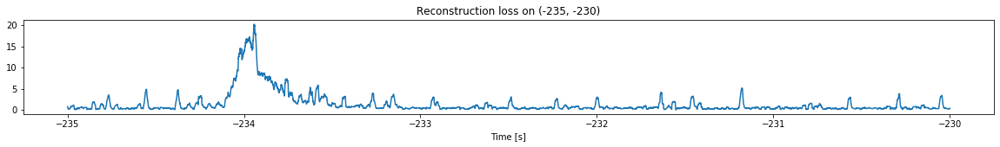

<--------
Entering sections:  (-230, -225)
-------->
Training for section:  (-235, -230)
Finished training, mean of the log(loss) is:  -0.5098540090042841
Triggering for section:  (-230, -225)
Using this mean for triggering: -0.6089804405679399


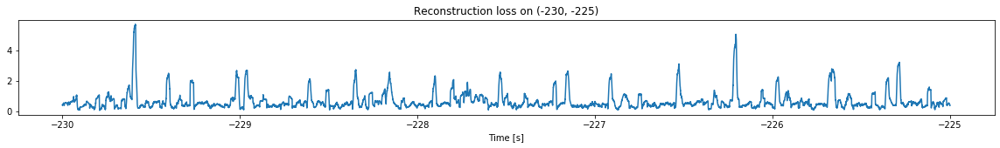

<--------
Entering sections:  (-225, -220)
-------->
Training for section:  (-230, -225)
Finished training, mean of the log(loss) is:  -0.5832282184466504
Triggering for section:  (-225, -220)
Using this mean for triggering: -0.5098540090042841


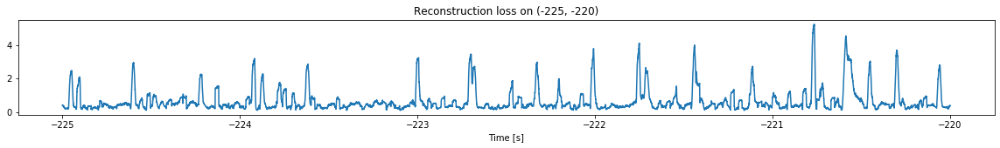

<--------
Entering sections:  (-220, -215)
-------->
Training for section:  (-225, -220)
Finished training, mean of the log(loss) is:  -0.6495065047113275
Triggering for section:  (-220, -215)
Using this mean for triggering: -0.5832282184466504


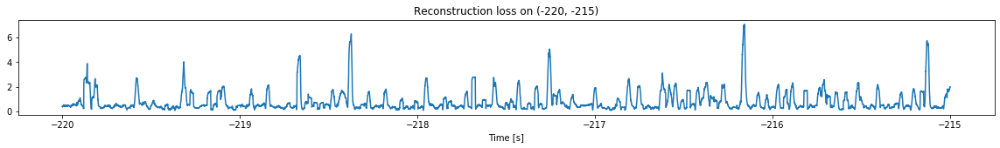

<--------
Entering sections:  (-215, -210)
-------->
Training for section:  (-220, -215)
Finished training, mean of the log(loss) is:  -0.5633032297899725
Triggering for section:  (-215, -210)
Using this mean for triggering: -0.6495065047113275


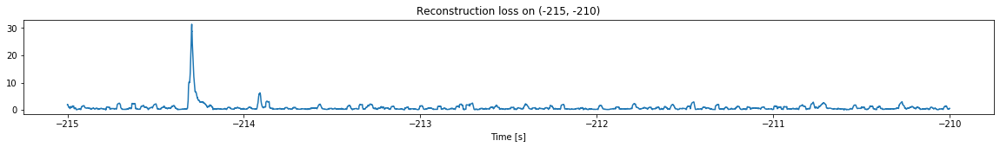

<--------
Entering sections:  (-210, -205)
-------->
Training for section:  (-215, -210)
Finished training, mean of the log(loss) is:  -0.6511016978356725
Triggering for section:  (-210, -205)
Using this mean for triggering: -0.5633032297899725


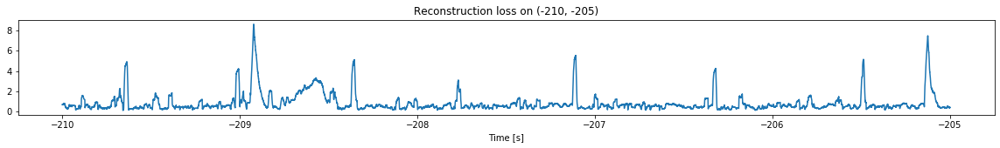

<--------
Entering sections:  (-205, -200)
-------->
Training for section:  (-210, -205)
Finished training, mean of the log(loss) is:  -0.6996219878515467
Triggering for section:  (-205, -200)
Using this mean for triggering: -0.6511016978356725


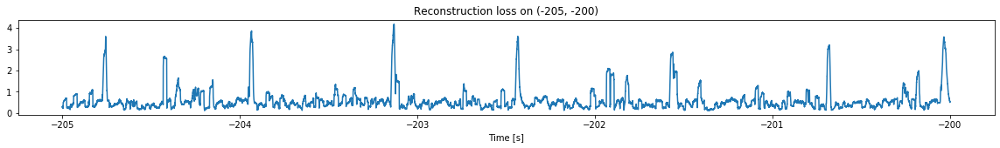

<--------
Entering sections:  (-200, -195)
-------->
Training for section:  (-205, -200)
Finished training, mean of the log(loss) is:  -0.7815696473398721
Triggering for section:  (-200, -195)
Using this mean for triggering: -0.6996219878515467


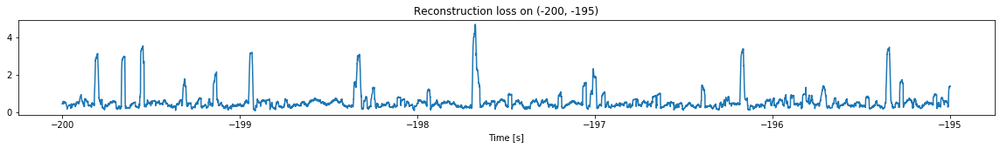

<--------
Entering sections:  (-195, -190)
-------->
Training for section:  (-200, -195)
Finished training, mean of the log(loss) is:  -0.7828230021884505
Triggering for section:  (-195, -190)
Using this mean for triggering: -0.7815696473398721


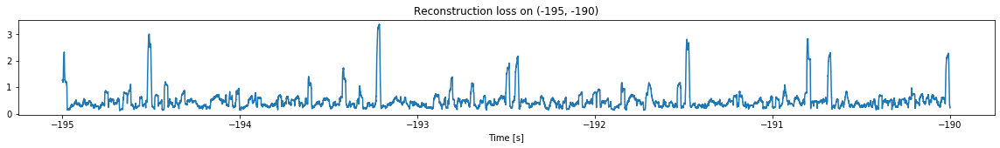

<--------
Entering sections:  (-190, -185)
-------->
Training for section:  (-195, -190)
Finished training, mean of the log(loss) is:  -0.8179611975450217
Triggering for section:  (-190, -185)
Using this mean for triggering: -0.7828230021884505


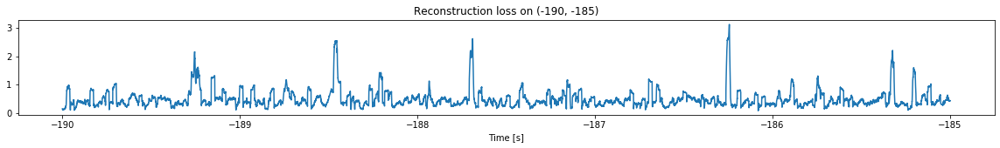

<--------
Entering sections:  (-185, -180)
-------->
Training for section:  (-190, -185)
Finished training, mean of the log(loss) is:  -0.8461766345334396
Triggering for section:  (-185, -180)
Using this mean for triggering: -0.8179611975450217


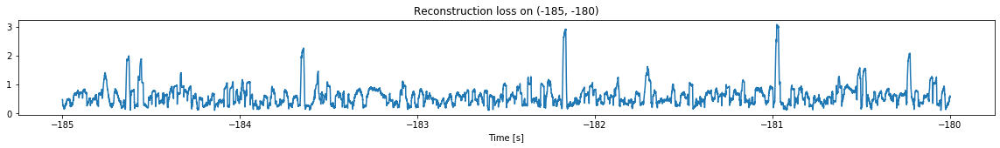

<--------
Entering sections:  (-180, -175)
-------->
Training for section:  (-185, -180)
Finished training, mean of the log(loss) is:  -0.8407420473830103
Triggering for section:  (-180, -175)
Using this mean for triggering: -0.8461766345334396


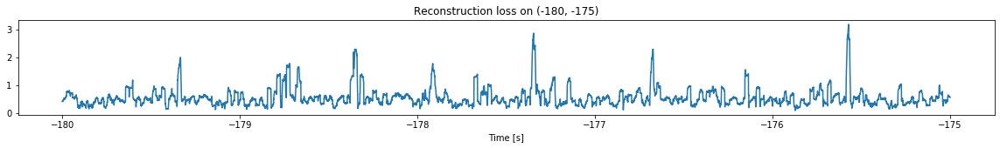

<--------
Entering sections:  (-175, -170)
-------->
Training for section:  (-180, -175)
Finished training, mean of the log(loss) is:  -0.825945733127939
Triggering for section:  (-175, -170)
Using this mean for triggering: -0.8407420473830103


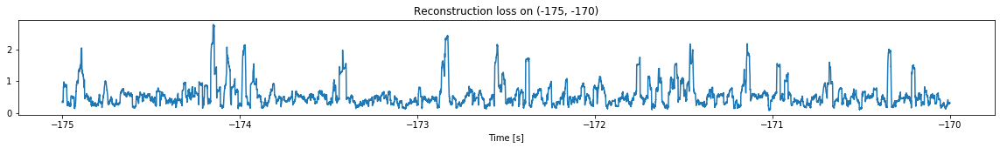

<--------
Entering sections:  (-170, -165)
-------->
Training for section:  (-175, -170)
Finished training, mean of the log(loss) is:  -0.8511316144429021
Triggering for section:  (-170, -165)
Using this mean for triggering: -0.825945733127939


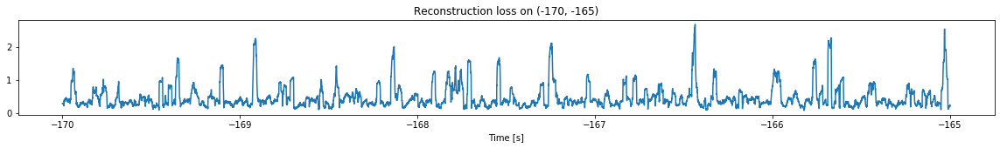

<--------
Entering sections:  (-165, -160)
-------->
Training for section:  (-170, -165)
Finished training, mean of the log(loss) is:  -0.8447503978952817
Triggering for section:  (-165, -160)
Using this mean for triggering: -0.8511316144429021


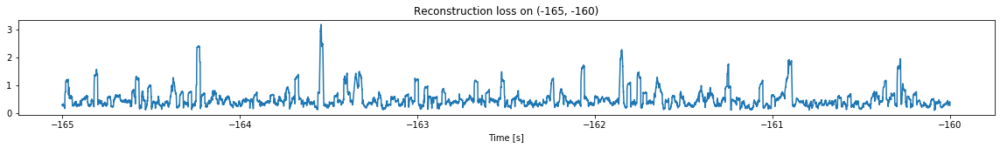

<--------
Entering sections:  (-160, -155)
-------->
Training for section:  (-165, -160)
Finished training, mean of the log(loss) is:  -0.7982207975670312
Triggering for section:  (-160, -155)
Using this mean for triggering: -0.8447503978952817


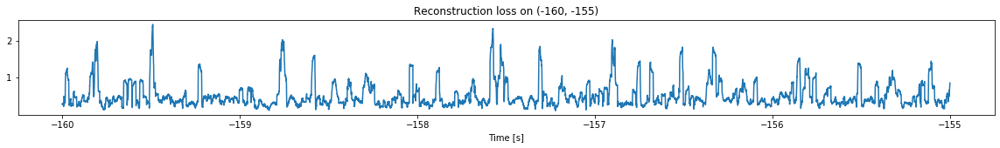

<--------
Entering sections:  (-155, -150)
-------->
Training for section:  (-160, -155)
Finished training, mean of the log(loss) is:  -0.8113366307587547
Triggering for section:  (-155, -150)
Using this mean for triggering: -0.7982207975670312


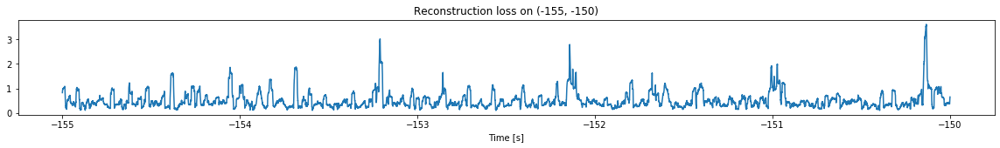

<--------
Entering sections:  (-150, -145)
-------->
Training for section:  (-155, -150)
Finished training, mean of the log(loss) is:  -0.8295474257687712
Triggering for section:  (-150, -145)
Using this mean for triggering: -0.8113366307587547


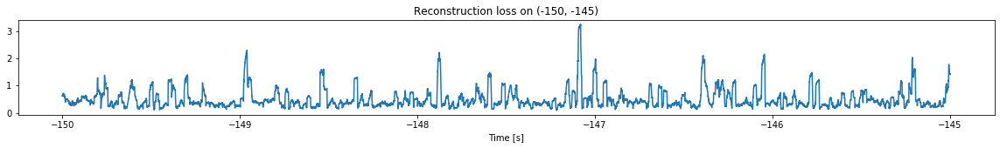

<--------
Entering sections:  (-145, -140)
-------->
Training for section:  (-150, -145)
Finished training, mean of the log(loss) is:  -0.8172372936490228
Triggering for section:  (-145, -140)
Using this mean for triggering: -0.8295474257687712


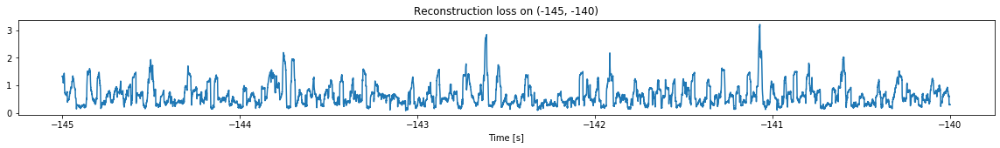

<--------
Entering sections:  (-140, -135)
-------->
Training for section:  (-145, -140)
Finished training, mean of the log(loss) is:  -0.7579099289139711
Triggering for section:  (-140, -135)
Using this mean for triggering: -0.8172372936490228


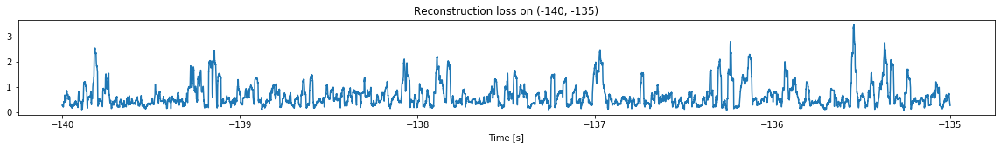

<--------
Entering sections:  (-135, -130)
-------->
Training for section:  (-140, -135)
Finished training, mean of the log(loss) is:  -0.7315727322119916
Triggering for section:  (-135, -130)
Using this mean for triggering: -0.7579099289139711


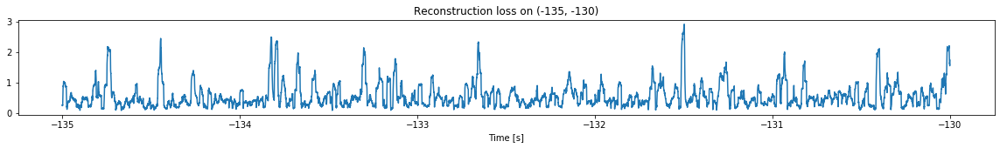

<--------
Entering sections:  (-130, -125)
-------->
Training for section:  (-135, -130)
Finished training, mean of the log(loss) is:  -0.7697674104213801
Triggering for section:  (-130, -125)
Using this mean for triggering: -0.7315727322119916


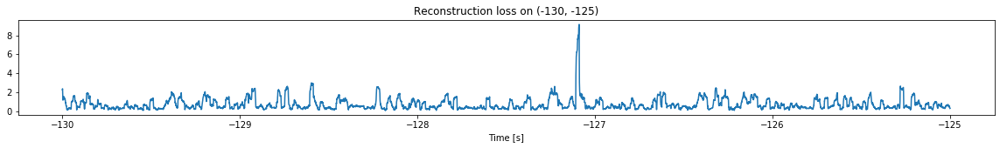

<--------
Entering sections:  (-125, -120)
-------->
Training for section:  (-130, -125)
Finished training, mean of the log(loss) is:  -0.7289231180561944
Triggering for section:  (-125, -120)
Using this mean for triggering: -0.7697674104213801


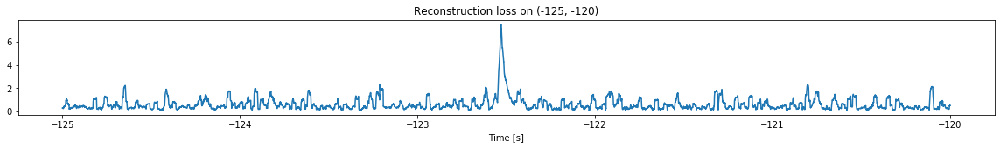

<--------
Entering sections:  (-120, -115)
-------->
Training for section:  (-125, -120)
Finished training, mean of the log(loss) is:  -0.6849432466317706
Triggering for section:  (-120, -115)
Using this mean for triggering: -0.7289231180561944


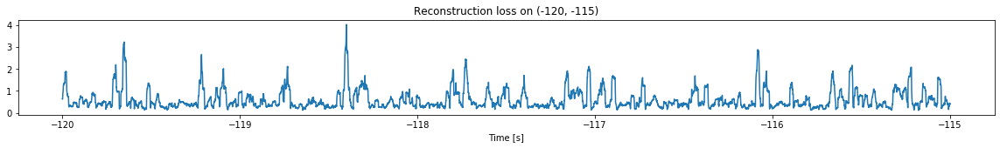

<--------
Entering sections:  (-115, -110)
-------->
Training for section:  (-120, -115)
Finished training, mean of the log(loss) is:  -0.7035051336811529
Triggering for section:  (-115, -110)
Using this mean for triggering: -0.6849432466317706


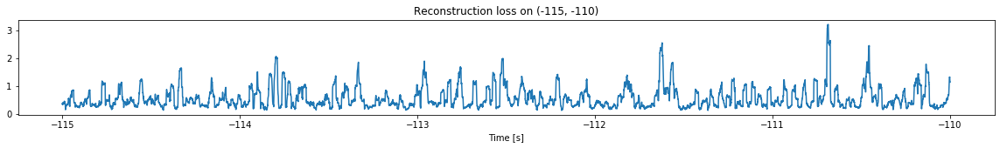

<--------
Entering sections:  (-110, -105)
-------->
Training for section:  (-115, -110)
Finished training, mean of the log(loss) is:  -0.7167775852873037
Triggering for section:  (-110, -105)
Using this mean for triggering: -0.7035051336811529


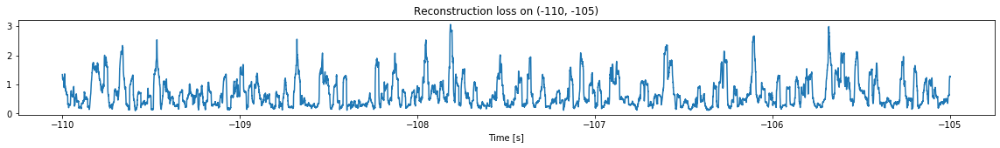

<--------
Entering sections:  (-105, -100)
-------->
Training for section:  (-110, -105)
Finished training, mean of the log(loss) is:  -0.6960899897954211
Triggering for section:  (-105, -100)
Using this mean for triggering: -0.7167775852873037


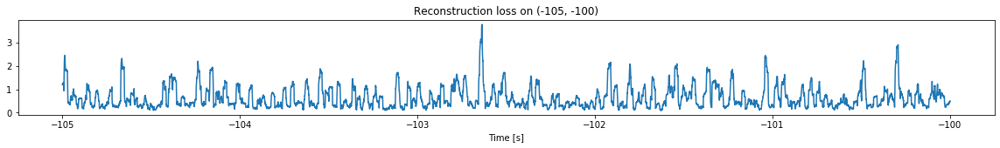

<--------
Entering sections:  (-100, -95)
-------->
Training for section:  (-105, -100)
Finished training, mean of the log(loss) is:  -0.6388297109331101
Triggering for section:  (-100, -95)
Using this mean for triggering: -0.6960899897954211


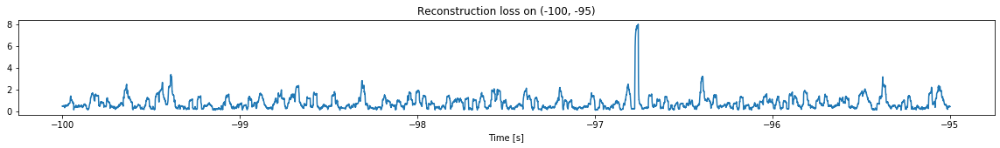

<--------
Entering sections:  (-95, -90)
-------->
Training for section:  (-100, -95)
Finished training, mean of the log(loss) is:  -0.6266825714980432
Triggering for section:  (-95, -90)
Using this mean for triggering: -0.6388297109331101


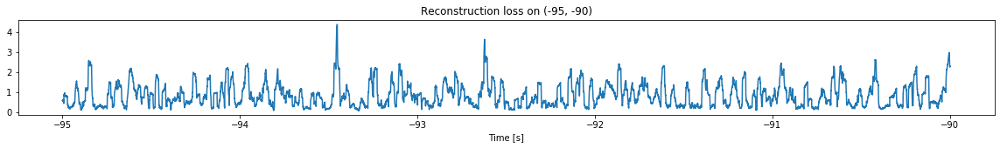

<--------
Entering sections:  (-90, -85)
-------->
Training for section:  (-95, -90)
Finished training, mean of the log(loss) is:  -0.6639002662669626
Triggering for section:  (-90, -85)
Using this mean for triggering: -0.6266825714980432


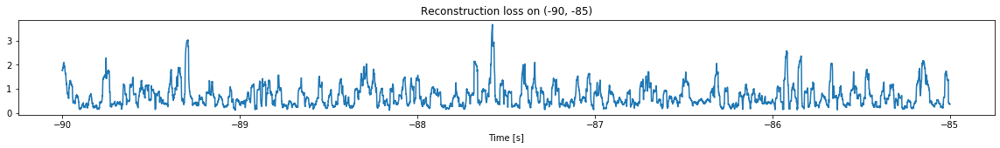

<--------
Entering sections:  (-85, -80)
-------->
Training for section:  (-90, -85)
Finished training, mean of the log(loss) is:  -0.6070057644861022
Triggering for section:  (-85, -80)
Using this mean for triggering: -0.6639002662669626


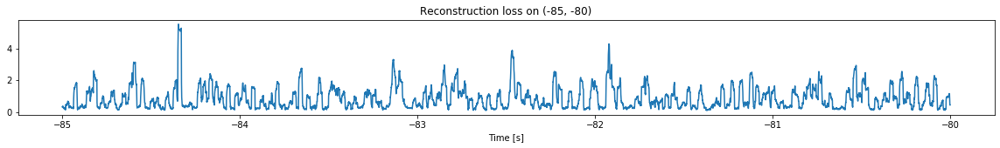

<--------
Entering sections:  (-80, -75)
-------->
Training for section:  (-85, -80)
Finished training, mean of the log(loss) is:  -0.6433159952714572
Triggering for section:  (-80, -75)
Using this mean for triggering: -0.6070057644861022


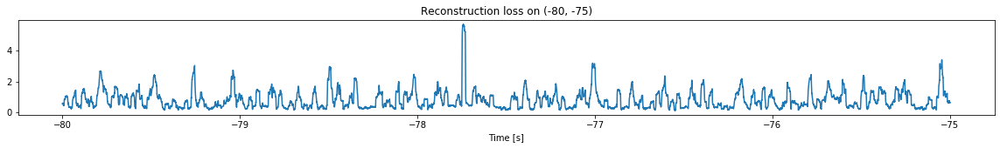

<--------
Entering sections:  (-75, -70)
-------->
Training for section:  (-80, -75)
Finished training, mean of the log(loss) is:  -0.586178552810237
Triggering for section:  (-75, -70)
Using this mean for triggering: -0.6433159952714572


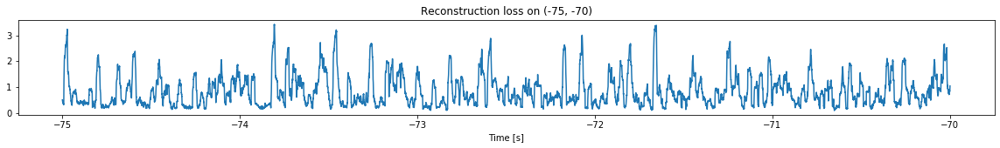

<--------
Entering sections:  (-70, -65)
-------->
Training for section:  (-75, -70)
Finished training, mean of the log(loss) is:  -0.6223822155723919
Triggering for section:  (-70, -65)
Using this mean for triggering: -0.586178552810237


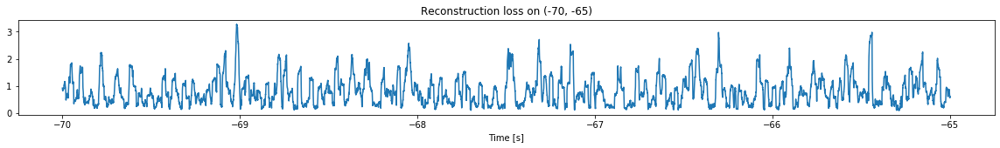

<--------
Entering sections:  (-65, -60)
-------->
Training for section:  (-70, -65)
Finished training, mean of the log(loss) is:  -0.629481687987231
Triggering for section:  (-65, -60)
Using this mean for triggering: -0.6223822155723919


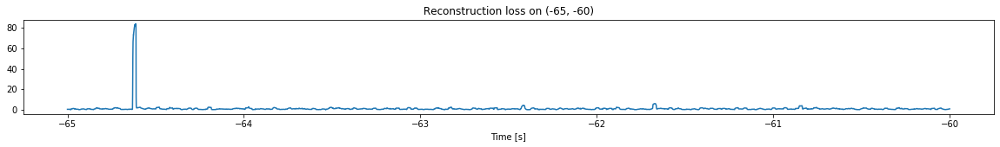

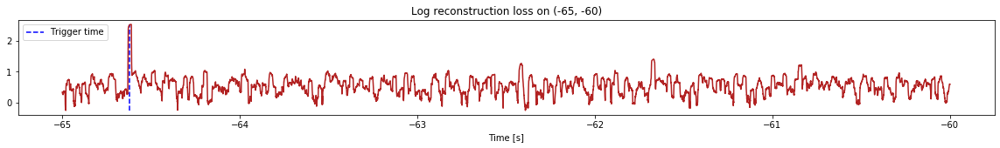

Triggered at:  -64.623985


-64.623985

In [17]:
simulation("./data/Ramp29/", 5, (-300,0))

Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
All data's shape:  (2997500, 12)
Flushing input history
Number of sections: 60
Entering sections:  (-300, -295)
-------->
Entering sections:  (-295, -290)
-------->
Training for section:  (None, -295)
Finished training, mean of the log(loss) is:  -0.7462516392078785
<--------
Entering sections:  (-290, -285)
-------->
Training for section:  (-295, -290)
Finished training, mean of the log(loss) is:  -0.6737730922216527
Triggering for section:  (-290, -285)
Using this mean for triggering: -0.7462516392078785


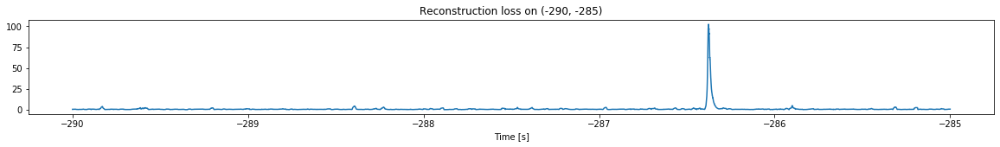

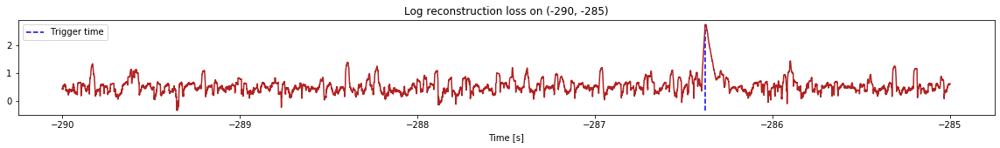

Triggered at:  -286.38147


-286.38147

In [18]:
simulation("./data/Ramp30/", 5, (-300,0))

In [19]:
#### Plot the distribution of trigger time

Text(0.5, 0, 'Time to quench (s)')

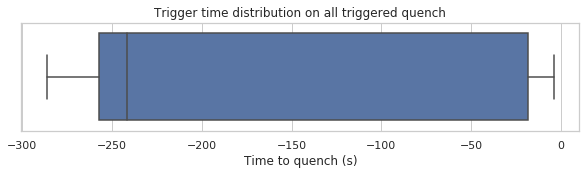

In [20]:
all_trigger_time = [-3.8414898, -229.83228, -7.07119, -241.65147, 
                    -264.43118, -251.44968, -18.19229, -10.1627, -242.10707, -255.74467, -18.557089, -281.7092
                    , -258.9906, -64.623985, -286.38147]
import seaborn as sns
sns.set(style="whitegrid")
plt.figure(figsize=(10,2))
sns.boxplot(x=all_trigger_time)
plt.title("Trigger time distribution on all triggered quench")
plt.xlabel("Time to quench (s)")

---------

## Trigger simulation — 2.5 log threshold — (-300,0)s range — SDs + Means — MinMaxScaler

In [ ]:
simulation("./data/Ramp4/", 5, (-300,0))

In [ ]:
simulation("./data/Ramp5/", 5, (-300,0))

In [ ]:
simulation("./data/Ramp12d/", 5, (-300,0))

In [ ]:
simulation("./data/Ramp19/", 5, (-300,0))

In [ ]:
simulation("./data/Ramp20/", 5, (-300,0))

In [ ]:
simulation("./data/Ramp21/", 5, (-300,0))

In [ ]:
simulation("./data/Ramp22/", 5, (-300,0))

In [ ]:
simulation("./data/Ramp23/", 5, (-50,0))

In [ ]:
simulation("./data/Ramp24/", 5, (-300,0))

In [ ]:
simulation("./data/Ramp25/", 5, (-300,0))

In [ ]:
simulation("./data/Ramp26/", 5, (-300,0))

In [ ]:
simulation("./data/Ramp27/", 5, (-300,0))

In [ ]:
simulation("./data/Ramp28/", 5, (-300,0))

In [ ]:
simulation("./data/Ramp29/", 5, (-300,0))

In [ ]:
simulation("./data/Ramp30/", 5, (-300,0))

Text(0.5, 0, 'Time to quench (s)')

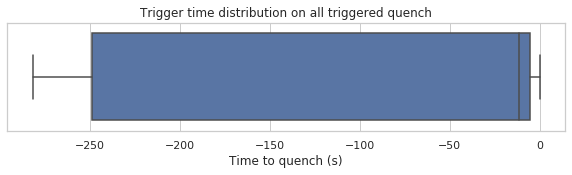

In [20]:
all_trigger_time = [-3.8242898, -4.26719, -6.51759, -100.93059, -264.43088, -11.77779, -0.01529, 
                    -242.10687, -255.74147, -281.7092, -7.3904896]

import seaborn as sns
sns.set(style="whitegrid")
plt.figure(figsize=(10,2))
sns.boxplot(x=all_trigger_time)
plt.title("Trigger time distribution on all triggered quench")
plt.xlabel("Time to quench (s)")

In [ ]:
## Only triggered on 10/14 quenches, also triggered on Ramp19

--------

## Trigger simulation — 2.65 log threshold — (-300,0)s range — SDs + Means — MinMaxScaler

Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
All data's shape:  (2997500, 12)
Flushing input history
Number of sections: 60
Entering sections:  (-300, -295)
-------->
Entering sections:  (-295, -290)
-------->
Training for section:  (None, -295)
Finished training, mean of the log(loss) is:  -1.5274652888182128
<--------
Entering sections:  (-290, -285)
-------->
Training for section:  (-295, -290)
Finished training, mean of the log(loss) is:  -1.6057111809512556
Triggering for section:  (-290, -285)
Using this mean for triggering: -1.5274652888182128


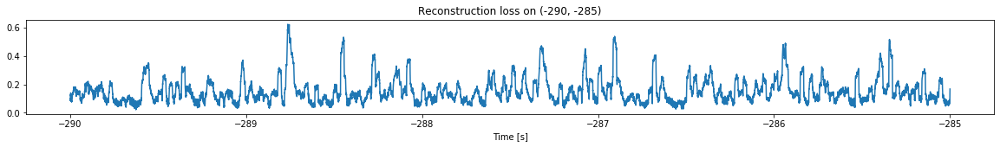

<--------
Entering sections:  (-285, -280)
-------->
Training for section:  (-290, -285)
Finished training, mean of the log(loss) is:  -1.5579948522829425
Triggering for section:  (-285, -280)
Using this mean for triggering: -1.6057111809512556


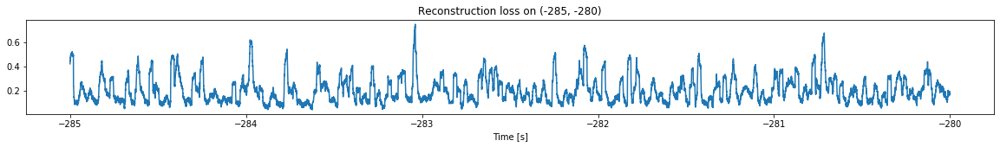

<--------
Entering sections:  (-280, -275)
-------->
Training for section:  (-285, -280)
Finished training, mean of the log(loss) is:  -1.4603577375097565
Triggering for section:  (-280, -275)
Using this mean for triggering: -1.5579948522829425


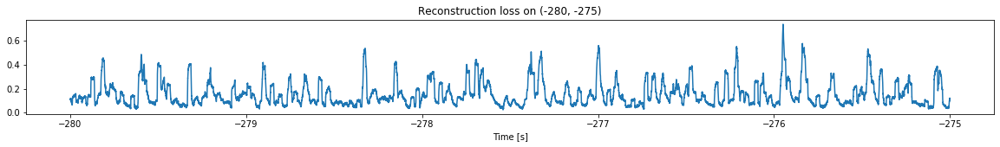

<--------
Entering sections:  (-275, -270)
-------->
Training for section:  (-280, -275)
Finished training, mean of the log(loss) is:  -1.495856725302703
Triggering for section:  (-275, -270)
Using this mean for triggering: -1.4603577375097565


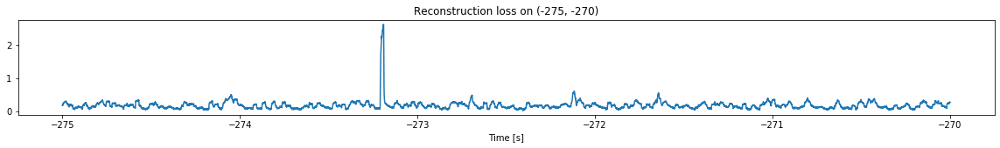

<--------
Entering sections:  (-270, -265)
-------->
Training for section:  (-275, -270)
Finished training, mean of the log(loss) is:  -1.5107207812014531
Triggering for section:  (-270, -265)
Using this mean for triggering: -1.495856725302703


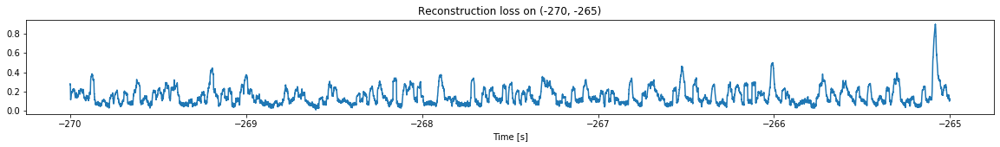

<--------
Entering sections:  (-265, -260)
-------->
Training for section:  (-270, -265)
Finished training, mean of the log(loss) is:  -1.61759551780127
Triggering for section:  (-265, -260)
Using this mean for triggering: -1.5107207812014531


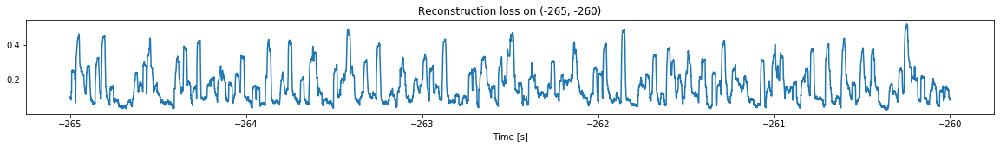

<--------
Entering sections:  (-260, -255)
-------->
Training for section:  (-265, -260)
Finished training, mean of the log(loss) is:  -1.6601913645465318
Triggering for section:  (-260, -255)
Using this mean for triggering: -1.61759551780127


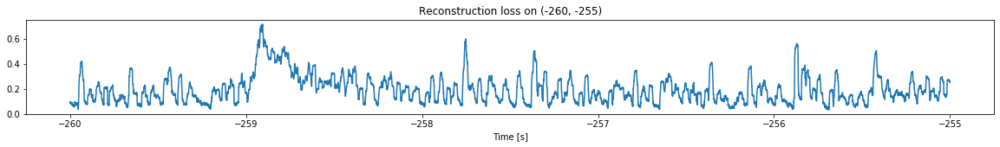

<--------
Entering sections:  (-255, -250)
-------->
Training for section:  (-260, -255)
Finished training, mean of the log(loss) is:  -1.5035235535895017
Triggering for section:  (-255, -250)
Using this mean for triggering: -1.6601913645465318


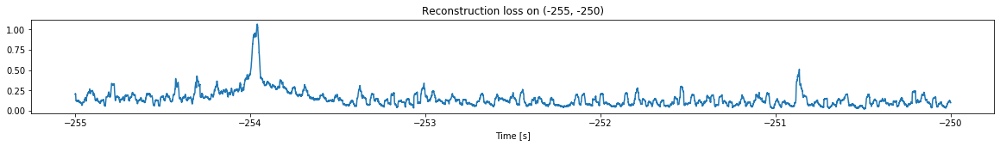

<--------
Entering sections:  (-250, -245)
-------->
Training for section:  (-255, -250)
Finished training, mean of the log(loss) is:  -1.565578483519372
Triggering for section:  (-250, -245)
Using this mean for triggering: -1.5035235535895017


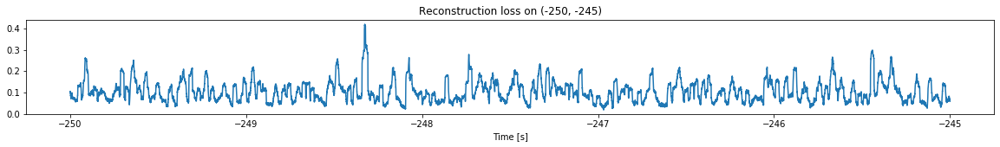

<--------
Entering sections:  (-245, -240)
-------->
Training for section:  (-250, -245)
Finished training, mean of the log(loss) is:  -1.7057213180861854
Triggering for section:  (-245, -240)
Using this mean for triggering: -1.565578483519372


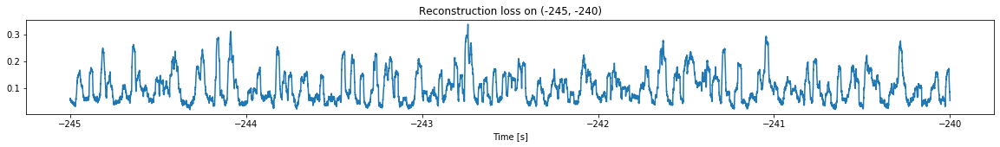

<--------
Entering sections:  (-240, -235)
-------->
Training for section:  (-245, -240)
Finished training, mean of the log(loss) is:  -1.685251826777741
Triggering for section:  (-240, -235)
Using this mean for triggering: -1.7057213180861854


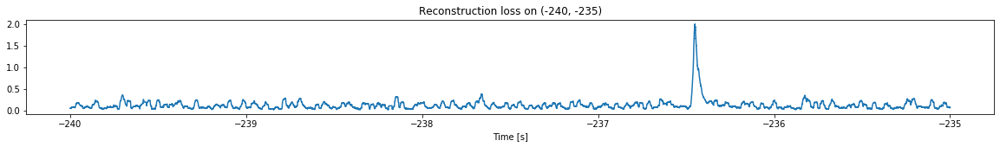

<--------
Entering sections:  (-235, -230)
-------->
Training for section:  (-240, -235)
Finished training, mean of the log(loss) is:  -1.7473067921532999
Triggering for section:  (-235, -230)
Using this mean for triggering: -1.685251826777741


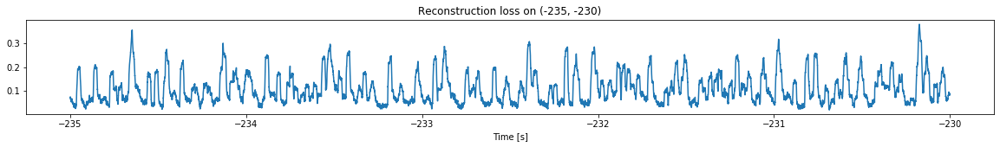

<--------
Entering sections:  (-230, -225)
-------->
Training for section:  (-235, -230)
Finished training, mean of the log(loss) is:  -1.8324273022604882
Triggering for section:  (-230, -225)
Using this mean for triggering: -1.7473067921532999


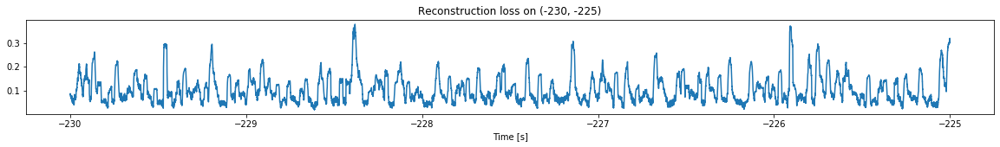

<--------
Entering sections:  (-225, -220)
-------->
Training for section:  (-230, -225)
Finished training, mean of the log(loss) is:  -1.7493461114298277
Triggering for section:  (-225, -220)
Using this mean for triggering: -1.8324273022604882


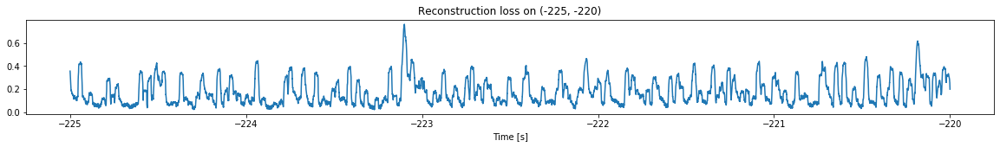

<--------
Entering sections:  (-220, -215)
-------->
Training for section:  (-225, -220)
Finished training, mean of the log(loss) is:  -1.7890248933737007
Triggering for section:  (-220, -215)
Using this mean for triggering: -1.7493461114298277


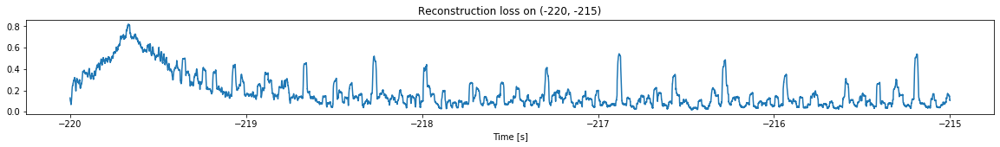

<--------
Entering sections:  (-215, -210)
-------->
Training for section:  (-220, -215)
Finished training, mean of the log(loss) is:  -1.6747000919435944
Triggering for section:  (-215, -210)
Using this mean for triggering: -1.7890248933737007


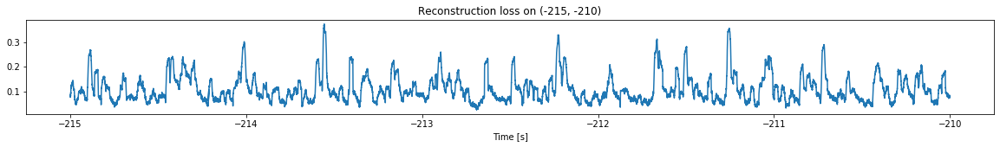

<--------
Entering sections:  (-210, -205)
-------->
Training for section:  (-215, -210)
Finished training, mean of the log(loss) is:  -1.831180150979486
Triggering for section:  (-210, -205)
Using this mean for triggering: -1.6747000919435944


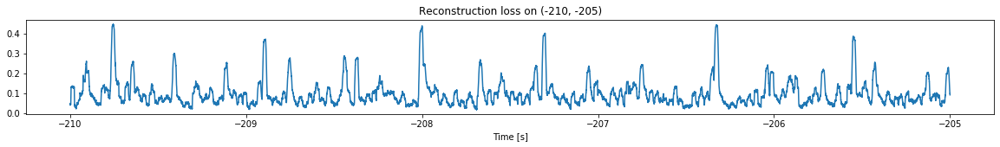

<--------
Entering sections:  (-205, -200)
-------->
Training for section:  (-210, -205)
Finished training, mean of the log(loss) is:  -1.797221803215396
Triggering for section:  (-205, -200)
Using this mean for triggering: -1.831180150979486


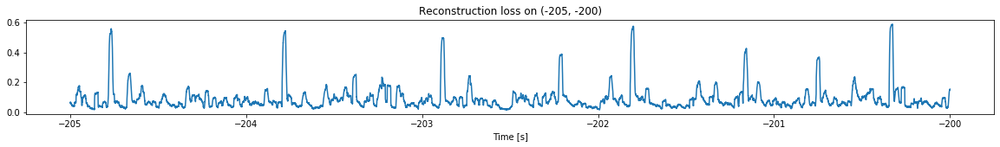

<--------
Entering sections:  (-200, -195)
-------->
Training for section:  (-205, -200)
Finished training, mean of the log(loss) is:  -1.7683716632018731
Triggering for section:  (-200, -195)
Using this mean for triggering: -1.797221803215396


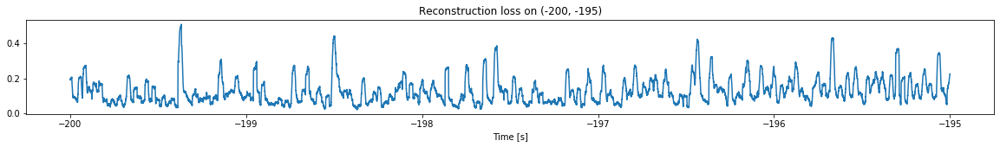

<--------
Entering sections:  (-195, -190)
-------->
Training for section:  (-200, -195)
Finished training, mean of the log(loss) is:  -1.788754108193572
Triggering for section:  (-195, -190)
Using this mean for triggering: -1.7683716632018731


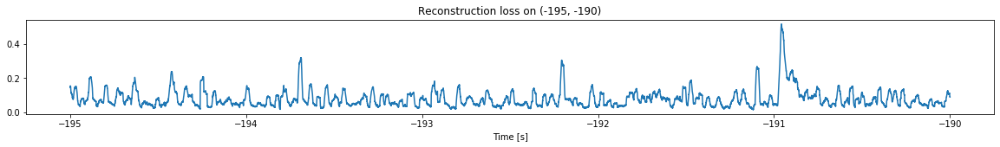

<--------
Entering sections:  (-190, -185)
-------->
Training for section:  (-195, -190)
Finished training, mean of the log(loss) is:  -1.8355023593302122
Triggering for section:  (-190, -185)
Using this mean for triggering: -1.788754108193572


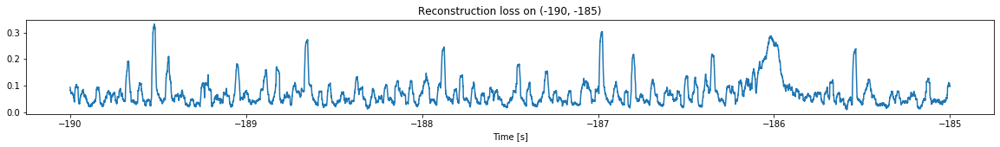

<--------
Entering sections:  (-185, -180)
-------->
Training for section:  (-190, -185)
Finished training, mean of the log(loss) is:  -1.8416639128855852
Triggering for section:  (-185, -180)
Using this mean for triggering: -1.8355023593302122


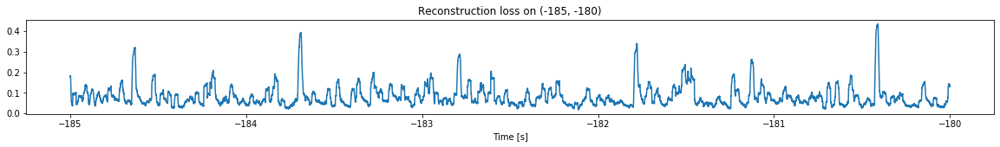

<--------
Entering sections:  (-180, -175)
-------->
Training for section:  (-185, -180)
Finished training, mean of the log(loss) is:  -1.899704251609185
Triggering for section:  (-180, -175)
Using this mean for triggering: -1.8416639128855852


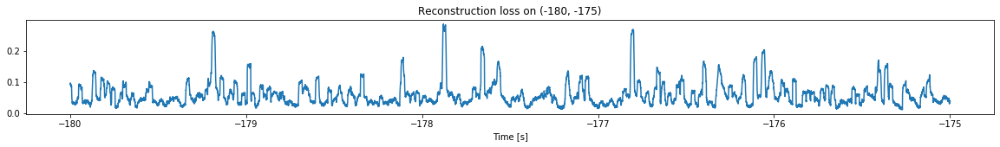

<--------
Entering sections:  (-175, -170)
-------->
Training for section:  (-180, -175)
Finished training, mean of the log(loss) is:  -2.0026178118969464
Triggering for section:  (-175, -170)
Using this mean for triggering: -1.899704251609185


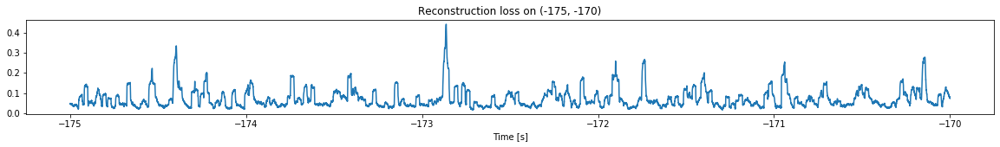

<--------
Entering sections:  (-170, -165)
-------->
Training for section:  (-175, -170)
Finished training, mean of the log(loss) is:  -1.9910207926694934
Triggering for section:  (-170, -165)
Using this mean for triggering: -2.0026178118969464


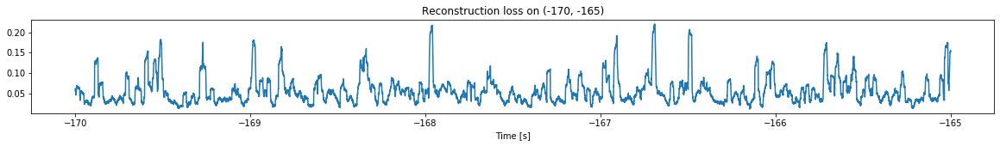

<--------
Entering sections:  (-165, -160)
-------->
Training for section:  (-170, -165)
Finished training, mean of the log(loss) is:  -1.9743758414717514
Triggering for section:  (-165, -160)
Using this mean for triggering: -1.9910207926694934


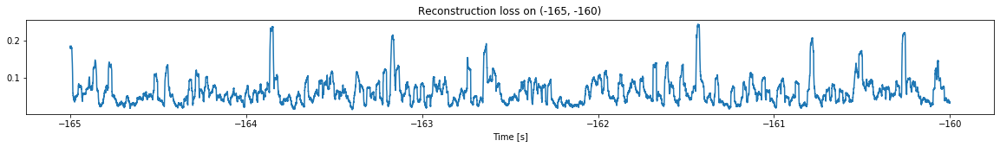

<--------
Entering sections:  (-160, -155)
-------->
Training for section:  (-165, -160)
Finished training, mean of the log(loss) is:  -1.8907180547618108
Triggering for section:  (-160, -155)
Using this mean for triggering: -1.9743758414717514


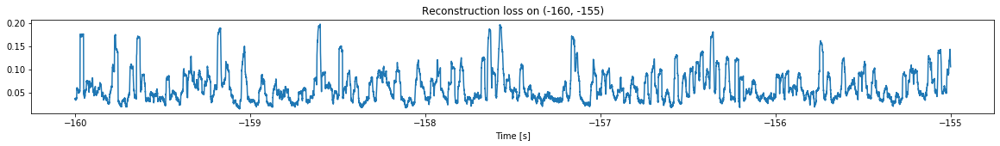

<--------
Entering sections:  (-155, -150)
-------->
Training for section:  (-160, -155)
Finished training, mean of the log(loss) is:  -1.9859722989756452
Triggering for section:  (-155, -150)
Using this mean for triggering: -1.8907180547618108


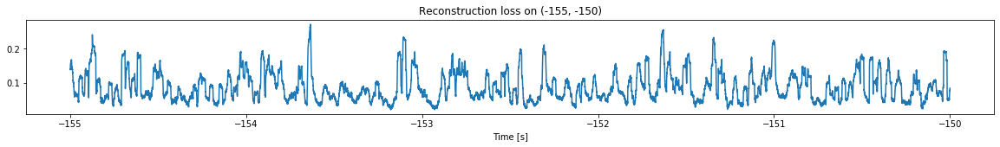

<--------
Entering sections:  (-150, -145)
-------->
Training for section:  (-155, -150)
Finished training, mean of the log(loss) is:  -1.9822056472972296
Triggering for section:  (-150, -145)
Using this mean for triggering: -1.9859722989756452


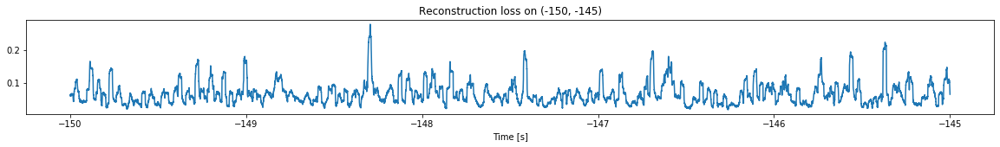

<--------
Entering sections:  (-145, -140)
-------->
Training for section:  (-150, -145)
Finished training, mean of the log(loss) is:  -1.8885273385318078
Triggering for section:  (-145, -140)
Using this mean for triggering: -1.9822056472972296


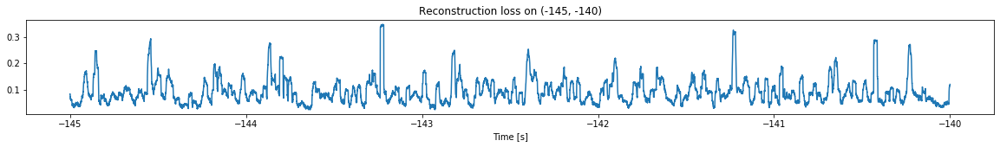

<--------
Entering sections:  (-140, -135)
-------->
Training for section:  (-145, -140)
Finished training, mean of the log(loss) is:  -1.7318905443903676
Triggering for section:  (-140, -135)
Using this mean for triggering: -1.8885273385318078


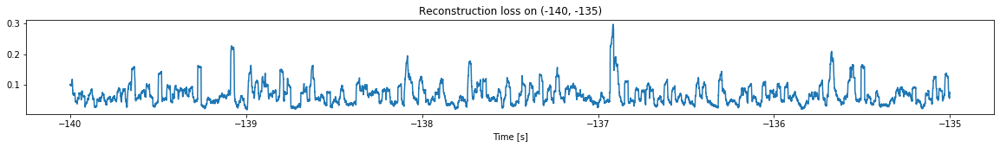

<--------
Entering sections:  (-135, -130)
-------->
Training for section:  (-140, -135)
Finished training, mean of the log(loss) is:  -1.9437498830153213
Triggering for section:  (-135, -130)
Using this mean for triggering: -1.7318905443903676


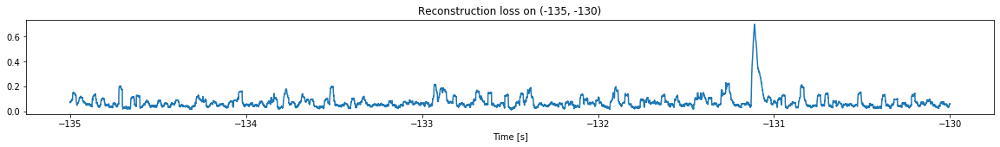

<--------
Entering sections:  (-130, -125)
-------->
Training for section:  (-135, -130)
Finished training, mean of the log(loss) is:  -1.9357087824559462
Triggering for section:  (-130, -125)
Using this mean for triggering: -1.9437498830153213


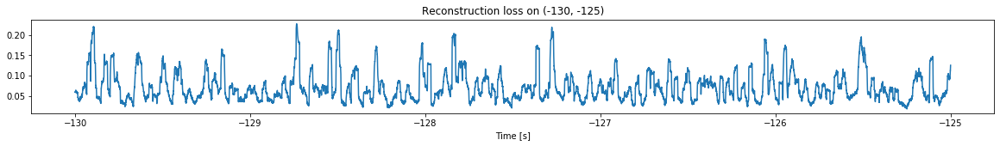

<--------
Entering sections:  (-125, -120)
-------->
Training for section:  (-130, -125)
Finished training, mean of the log(loss) is:  -1.9193711147226393
Triggering for section:  (-125, -120)
Using this mean for triggering: -1.9357087824559462


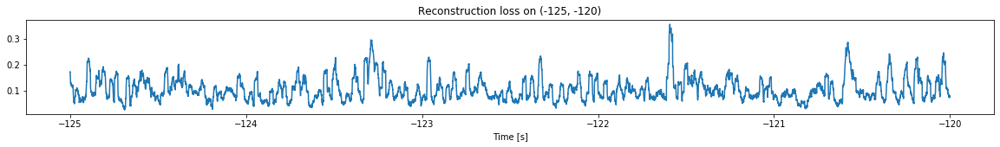

<--------
Entering sections:  (-120, -115)
-------->
Training for section:  (-125, -120)
Finished training, mean of the log(loss) is:  -1.9863554221357158
Triggering for section:  (-120, -115)
Using this mean for triggering: -1.9193711147226393


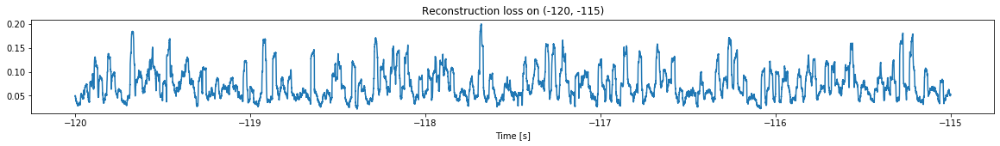

<--------
Entering sections:  (-115, -110)
-------->
Training for section:  (-120, -115)
Finished training, mean of the log(loss) is:  -1.8863619568129493
Triggering for section:  (-115, -110)
Using this mean for triggering: -1.9863554221357158


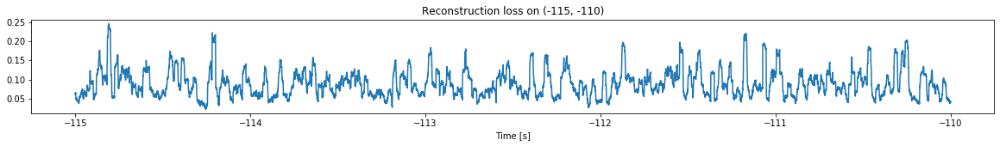

<--------
Entering sections:  (-110, -105)
-------->
Training for section:  (-115, -110)
Finished training, mean of the log(loss) is:  -1.8943775377650134
Triggering for section:  (-110, -105)
Using this mean for triggering: -1.8863619568129493


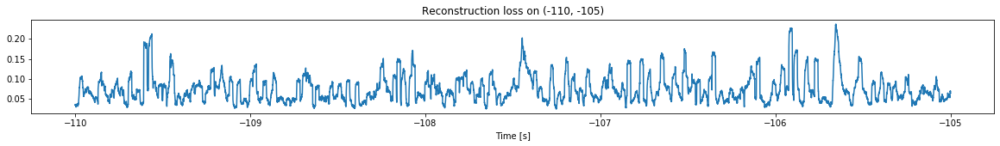

<--------
Entering sections:  (-105, -100)
-------->
Training for section:  (-110, -105)
Finished training, mean of the log(loss) is:  -1.9221061141303224
Triggering for section:  (-105, -100)
Using this mean for triggering: -1.8943775377650134


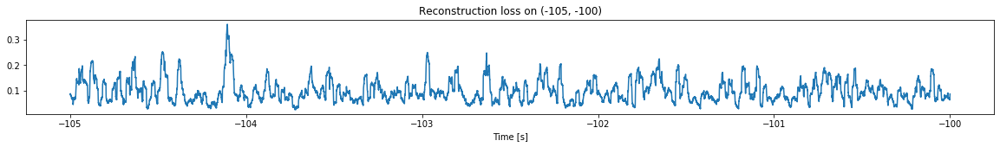

<--------
Entering sections:  (-100, -95)
-------->
Training for section:  (-105, -100)
Finished training, mean of the log(loss) is:  -1.89230014111895
Triggering for section:  (-100, -95)
Using this mean for triggering: -1.9221061141303224


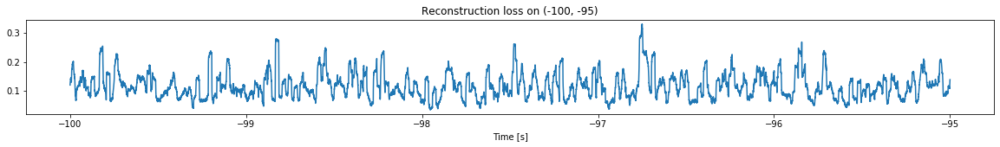

<--------
Entering sections:  (-95, -90)
-------->
Training for section:  (-100, -95)
Finished training, mean of the log(loss) is:  -1.8745803038977764
Triggering for section:  (-95, -90)
Using this mean for triggering: -1.89230014111895


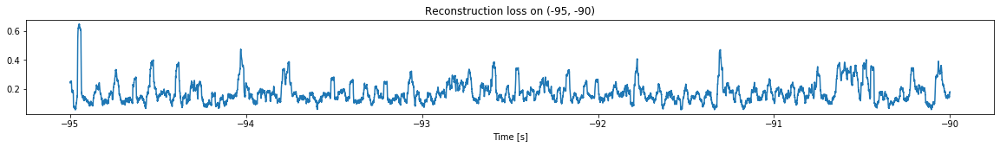

<--------
Entering sections:  (-90, -85)
-------->
Training for section:  (-95, -90)
Finished training, mean of the log(loss) is:  -1.7957647375711228
Triggering for section:  (-90, -85)
Using this mean for triggering: -1.8745803038977764


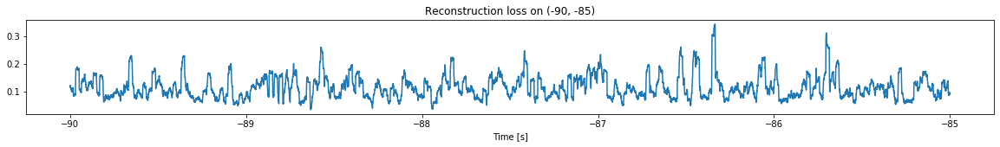

<--------
Entering sections:  (-85, -80)
-------->
Training for section:  (-90, -85)
Finished training, mean of the log(loss) is:  -1.8250143759557442
Triggering for section:  (-85, -80)
Using this mean for triggering: -1.7957647375711228


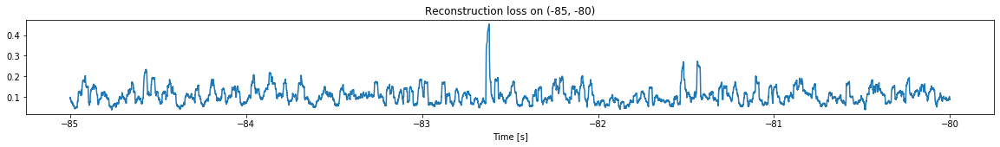

<--------
Entering sections:  (-80, -75)
-------->
Training for section:  (-85, -80)
Finished training, mean of the log(loss) is:  -1.833389881833479
Triggering for section:  (-80, -75)
Using this mean for triggering: -1.8250143759557442


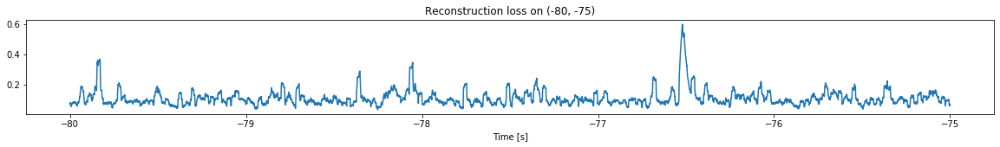

<--------
Entering sections:  (-75, -70)
-------->
Training for section:  (-80, -75)
Finished training, mean of the log(loss) is:  -1.871363678454421
Triggering for section:  (-75, -70)
Using this mean for triggering: -1.833389881833479


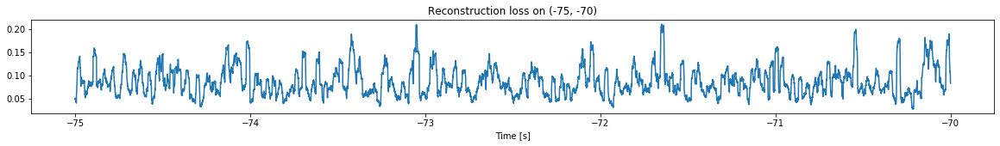

<--------
Entering sections:  (-70, -65)
-------->
Training for section:  (-75, -70)
Finished training, mean of the log(loss) is:  -1.926332114284931
Triggering for section:  (-70, -65)
Using this mean for triggering: -1.871363678454421


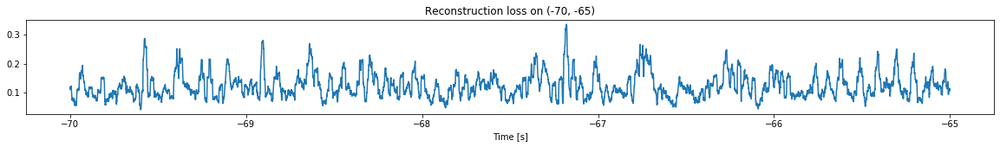

<--------
Entering sections:  (-65, -60)
-------->
Training for section:  (-70, -65)
Finished training, mean of the log(loss) is:  -1.799344757051125
Triggering for section:  (-65, -60)
Using this mean for triggering: -1.926332114284931


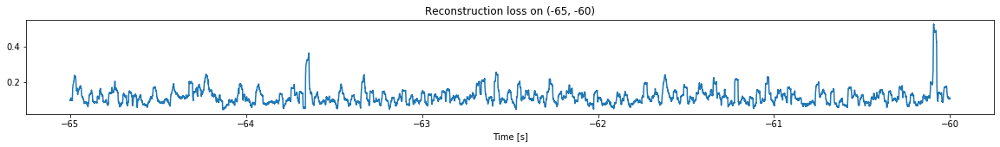

<--------
Entering sections:  (-60, -55)
-------->
Training for section:  (-65, -60)
Finished training, mean of the log(loss) is:  -1.7901023134430987
Triggering for section:  (-60, -55)
Using this mean for triggering: -1.799344757051125


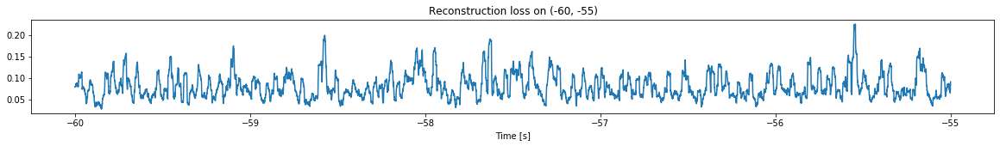

<--------
Entering sections:  (-55, -50)
-------->
Training for section:  (-60, -55)
Finished training, mean of the log(loss) is:  -1.7639825753751737
Triggering for section:  (-55, -50)
Using this mean for triggering: -1.7901023134430987


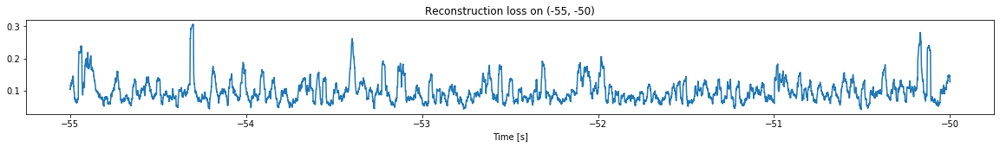

<--------
Entering sections:  (-50, -45)
-------->
Training for section:  (-55, -50)
Finished training, mean of the log(loss) is:  -1.7867294029511491
Triggering for section:  (-50, -45)
Using this mean for triggering: -1.7639825753751737


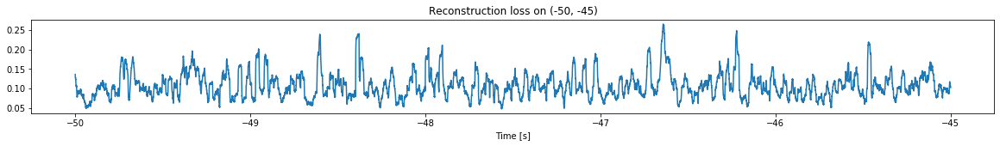

<--------
Entering sections:  (-45, -40)
-------->
Training for section:  (-50, -45)
Finished training, mean of the log(loss) is:  -1.8138393789806126
Triggering for section:  (-45, -40)
Using this mean for triggering: -1.7867294029511491


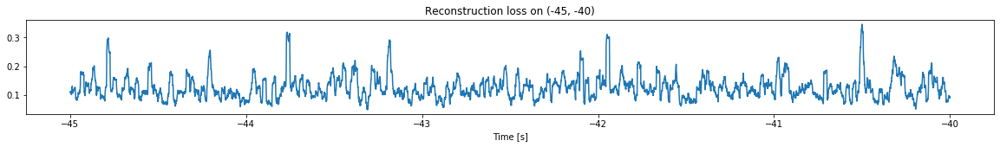

<--------
Entering sections:  (-40, -35)
-------->
Training for section:  (-45, -40)
Finished training, mean of the log(loss) is:  -1.7340078295102535
Triggering for section:  (-40, -35)
Using this mean for triggering: -1.8138393789806126


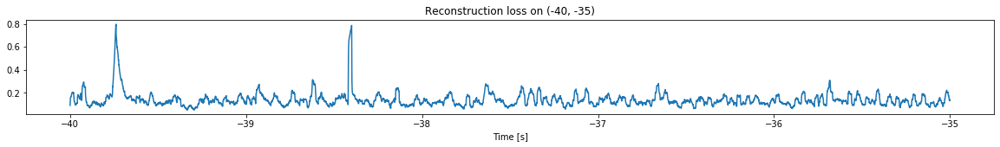

<--------
Entering sections:  (-35, -30)
-------->
Training for section:  (-40, -35)
Finished training, mean of the log(loss) is:  -1.7343407829644328
Triggering for section:  (-35, -30)
Using this mean for triggering: -1.7340078295102535


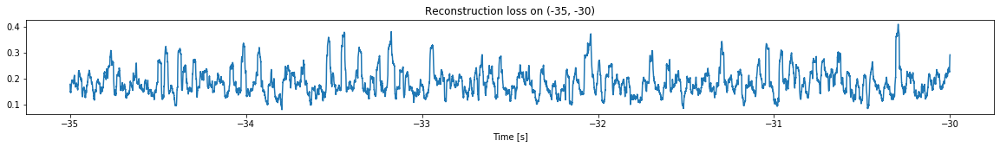

<--------
Entering sections:  (-30, -25)
-------->
Training for section:  (-35, -30)
Finished training, mean of the log(loss) is:  -1.7217677272524965
Triggering for section:  (-30, -25)
Using this mean for triggering: -1.7343407829644328


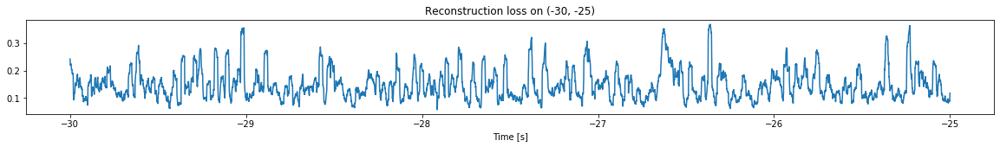

<--------
Entering sections:  (-25, -20)
-------->
Training for section:  (-30, -25)
Finished training, mean of the log(loss) is:  -1.730909656663894
Triggering for section:  (-25, -20)
Using this mean for triggering: -1.7217677272524965


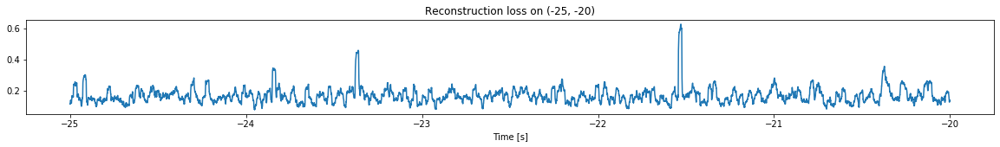

<--------
Entering sections:  (-20, -15)
-------->
Training for section:  (-25, -20)
Finished training, mean of the log(loss) is:  -1.7187362744087782
Triggering for section:  (-20, -15)
Using this mean for triggering: -1.730909656663894


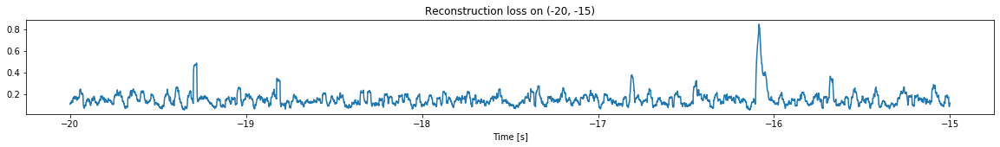

<--------
Entering sections:  (-15, -10)
-------->
Training for section:  (-20, -15)
Finished training, mean of the log(loss) is:  -1.7629454728161993
Triggering for section:  (-15, -10)
Using this mean for triggering: -1.7187362744087782


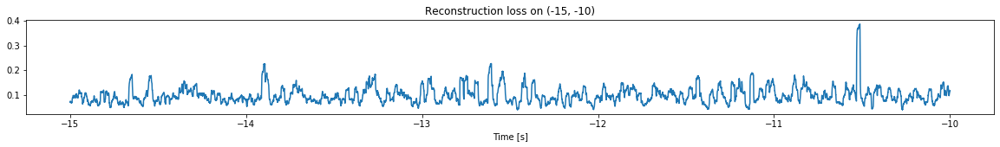

<--------
Entering sections:  (-10, -5)
-------->
Training for section:  (-15, -10)
Finished training, mean of the log(loss) is:  -1.7920672867011858
Triggering for section:  (-10, -5)
Using this mean for triggering: -1.7629454728161993


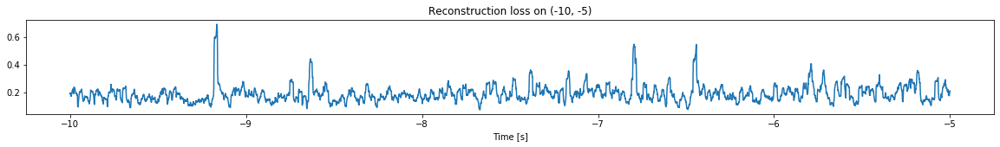

<--------
Entering sections:  (-5, 0)
-------->
Training for section:  (-10, -5)
Finished training, mean of the log(loss) is:  -1.6929172150182223
Triggering for section:  (-5, 0)
Using this mean for triggering: -1.7920672867011858


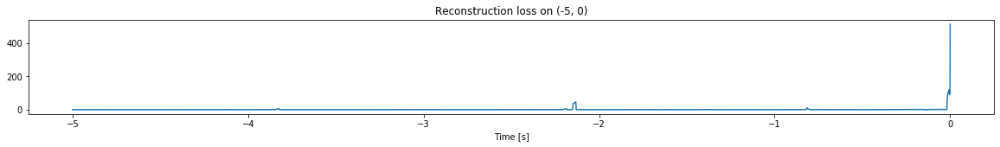

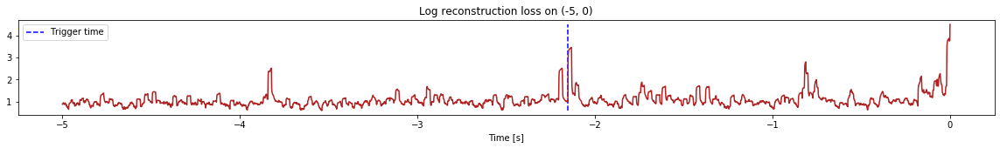

Triggered at:  -2.15129


-2.15129

In [3]:
simulation("./data/Ramp4/", 5, (-300,0))

Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
All data's shape:  (2997500, 12)
Flushing input history
Number of sections: 60
Entering sections:  (-300, -295)
-------->
Entering sections:  (-295, -290)
-------->
Training for section:  (None, -295)
Finished training, mean of the log(loss) is:  -1.582227044877481
<--------
Entering sections:  (-290, -285)
-------->
Training for section:  (-295, -290)
Finished training, mean of the log(loss) is:  -1.6341579749445425
Triggering for section:  (-290, -285)
Using this mean for triggering: -1.582227044877481


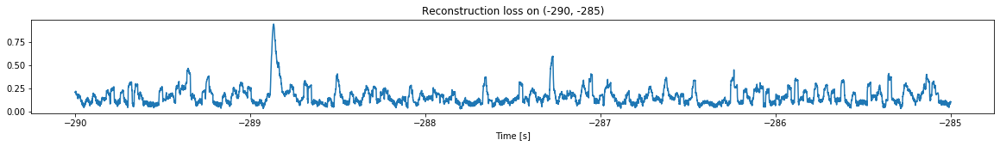

<--------
Entering sections:  (-285, -280)
-------->
Training for section:  (-290, -285)
Finished training, mean of the log(loss) is:  -1.6327441049444795
Triggering for section:  (-285, -280)
Using this mean for triggering: -1.6341579749445425


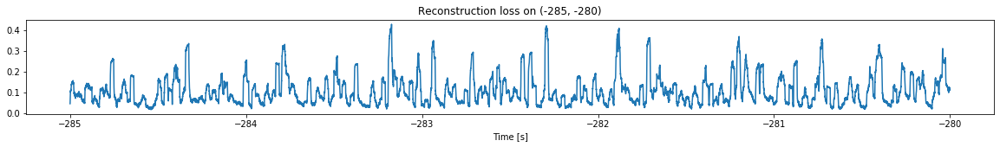

<--------
Entering sections:  (-280, -275)
-------->
Training for section:  (-285, -280)
Finished training, mean of the log(loss) is:  -1.689202151674452
Triggering for section:  (-280, -275)
Using this mean for triggering: -1.6327441049444795


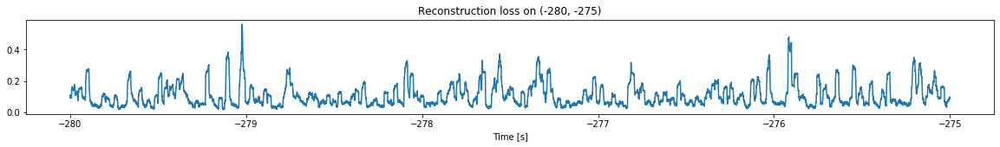

<--------
Entering sections:  (-275, -270)
-------->
Training for section:  (-280, -275)
Finished training, mean of the log(loss) is:  -1.7324815400747928
Triggering for section:  (-275, -270)
Using this mean for triggering: -1.689202151674452


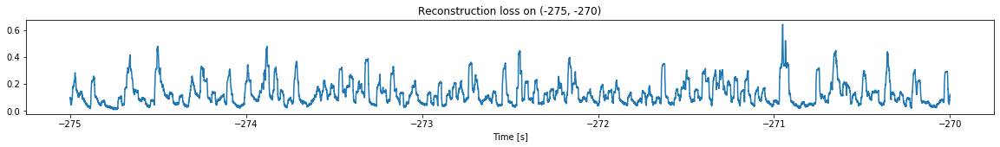

<--------
Entering sections:  (-270, -265)
-------->
Training for section:  (-275, -270)
Finished training, mean of the log(loss) is:  -1.5811711879158188
Triggering for section:  (-270, -265)
Using this mean for triggering: -1.7324815400747928


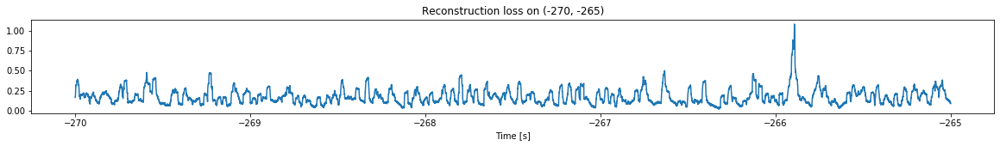

<--------
Entering sections:  (-265, -260)
-------->
Training for section:  (-270, -265)
Finished training, mean of the log(loss) is:  -1.5227876020618183
Triggering for section:  (-265, -260)
Using this mean for triggering: -1.5811711879158188


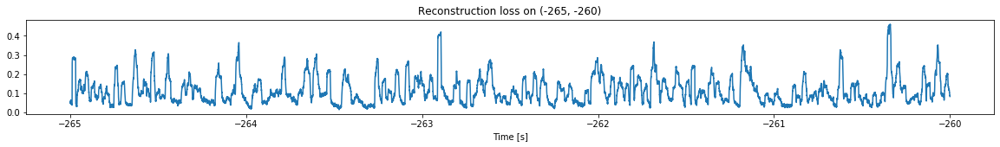

<--------
Entering sections:  (-260, -255)
-------->
Training for section:  (-265, -260)
Finished training, mean of the log(loss) is:  -1.6148562192667386
Triggering for section:  (-260, -255)
Using this mean for triggering: -1.5227876020618183


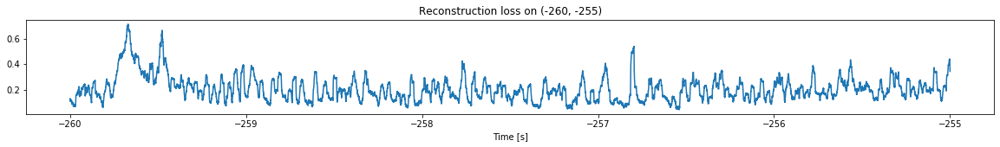

<--------
Entering sections:  (-255, -250)
-------->
Training for section:  (-260, -255)
Finished training, mean of the log(loss) is:  -1.5656406150041122
Triggering for section:  (-255, -250)
Using this mean for triggering: -1.6148562192667386


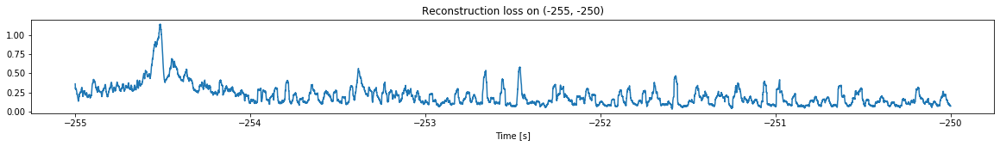

<--------
Entering sections:  (-250, -245)
-------->
Training for section:  (-255, -250)
Finished training, mean of the log(loss) is:  -1.5718264338617254
Triggering for section:  (-250, -245)
Using this mean for triggering: -1.5656406150041122


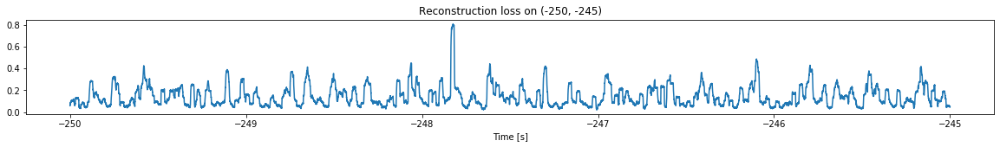

<--------
Entering sections:  (-245, -240)
-------->
Training for section:  (-250, -245)
Finished training, mean of the log(loss) is:  -1.5957480801886996
Triggering for section:  (-245, -240)
Using this mean for triggering: -1.5718264338617254


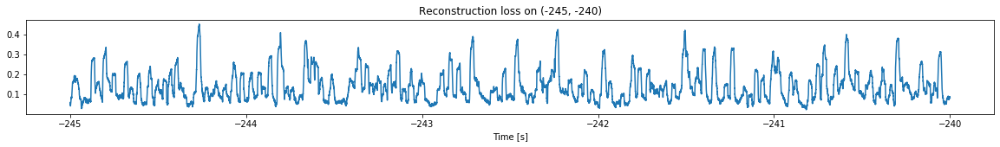

<--------
Entering sections:  (-240, -235)
-------->
Training for section:  (-245, -240)
Finished training, mean of the log(loss) is:  -1.6612277923306125
Triggering for section:  (-240, -235)
Using this mean for triggering: -1.5957480801886996


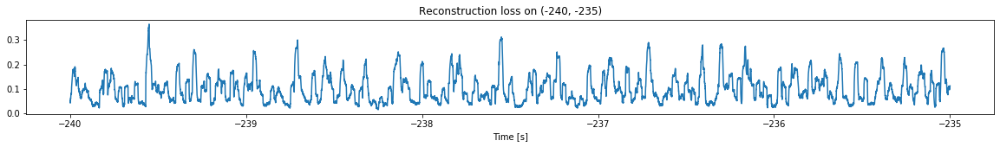

<--------
Entering sections:  (-235, -230)
-------->
Training for section:  (-240, -235)
Finished training, mean of the log(loss) is:  -1.6225951385686033
Triggering for section:  (-235, -230)
Using this mean for triggering: -1.6612277923306125


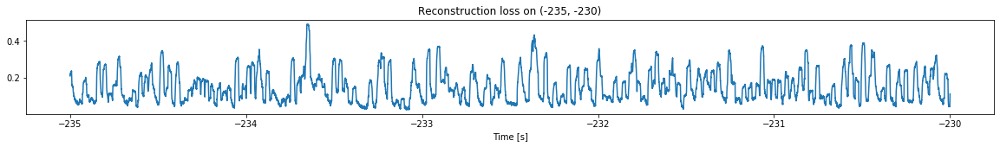

<--------
Entering sections:  (-230, -225)
-------->
Training for section:  (-235, -230)
Finished training, mean of the log(loss) is:  -1.7645266051492972
Triggering for section:  (-230, -225)
Using this mean for triggering: -1.6225951385686033


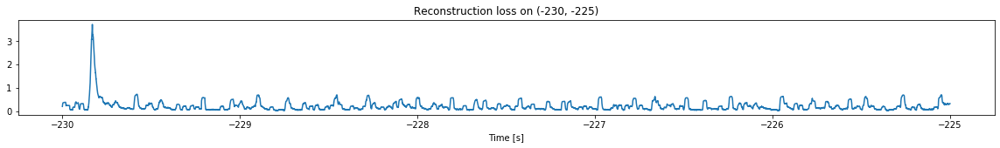

<--------
Entering sections:  (-225, -220)
-------->
Training for section:  (-230, -225)
Finished training, mean of the log(loss) is:  -1.7104861109264236
Triggering for section:  (-225, -220)
Using this mean for triggering: -1.7645266051492972


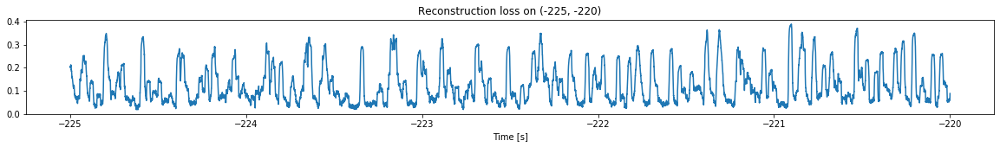

<--------
Entering sections:  (-220, -215)
-------->
Training for section:  (-225, -220)
Finished training, mean of the log(loss) is:  -1.7532216185940785
Triggering for section:  (-220, -215)
Using this mean for triggering: -1.7104861109264236


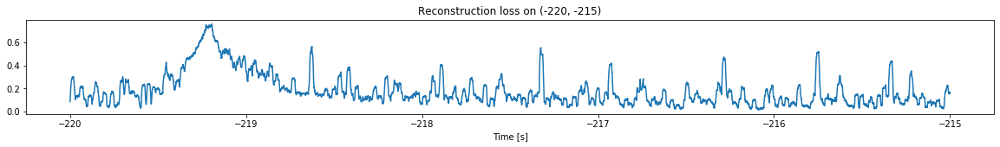

<--------
Entering sections:  (-215, -210)
-------->
Training for section:  (-220, -215)
Finished training, mean of the log(loss) is:  -1.7074650610450524
Triggering for section:  (-215, -210)
Using this mean for triggering: -1.7532216185940785


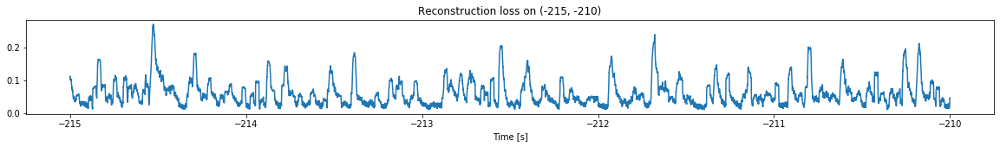

<--------
Entering sections:  (-210, -205)
-------->
Training for section:  (-215, -210)
Finished training, mean of the log(loss) is:  -1.8284662436655021
Triggering for section:  (-210, -205)
Using this mean for triggering: -1.7074650610450524


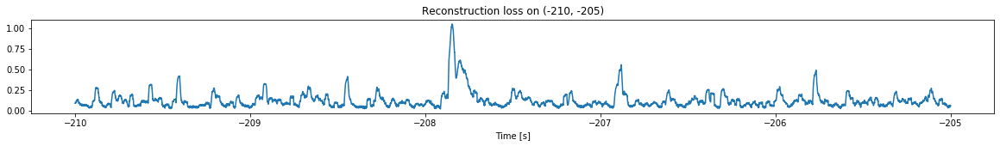

<--------
Entering sections:  (-205, -200)
-------->
Training for section:  (-210, -205)
Finished training, mean of the log(loss) is:  -1.8783234525839716
Triggering for section:  (-205, -200)
Using this mean for triggering: -1.8284662436655021


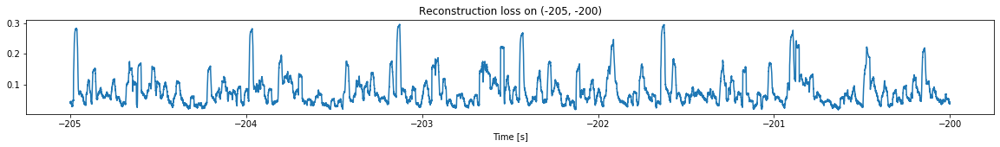

<--------
Entering sections:  (-200, -195)
-------->
Training for section:  (-205, -200)
Finished training, mean of the log(loss) is:  -2.047031358447303
Triggering for section:  (-200, -195)
Using this mean for triggering: -1.8783234525839716


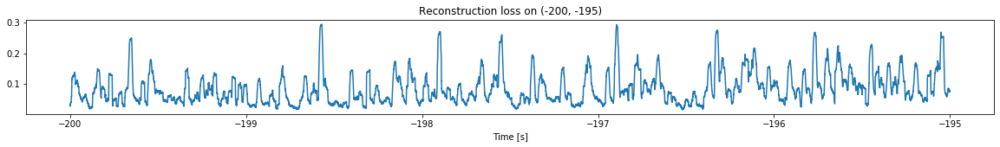

<--------
Entering sections:  (-195, -190)
-------->
Training for section:  (-200, -195)
Finished training, mean of the log(loss) is:  -1.9423280495476385
Triggering for section:  (-195, -190)
Using this mean for triggering: -2.047031358447303


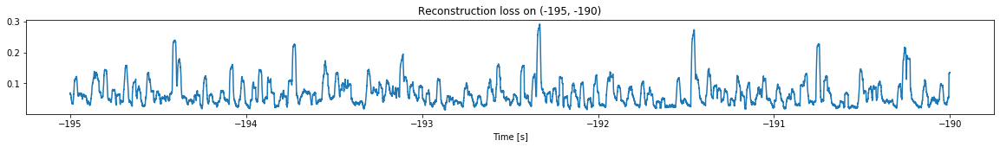

<--------
Entering sections:  (-190, -185)
-------->
Training for section:  (-195, -190)
Finished training, mean of the log(loss) is:  -1.9677293250996073
Triggering for section:  (-190, -185)
Using this mean for triggering: -1.9423280495476385


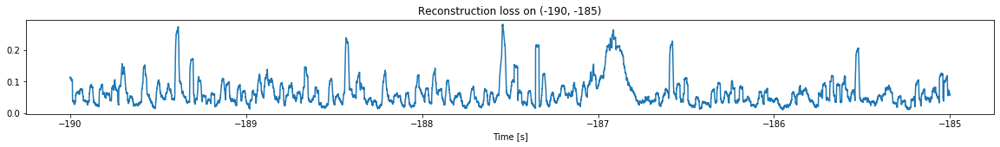

<--------
Entering sections:  (-185, -180)
-------->
Training for section:  (-190, -185)
Finished training, mean of the log(loss) is:  -1.8770579364301998
Triggering for section:  (-185, -180)
Using this mean for triggering: -1.9677293250996073


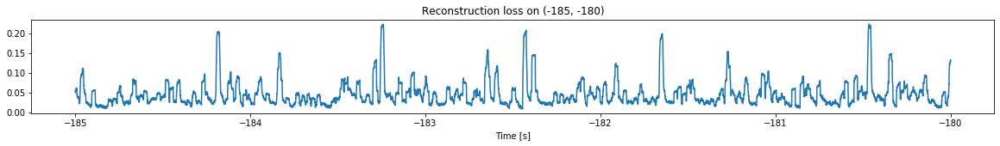

<--------
Entering sections:  (-180, -175)
-------->
Training for section:  (-185, -180)
Finished training, mean of the log(loss) is:  -2.0242430581430146
Triggering for section:  (-180, -175)
Using this mean for triggering: -1.8770579364301998


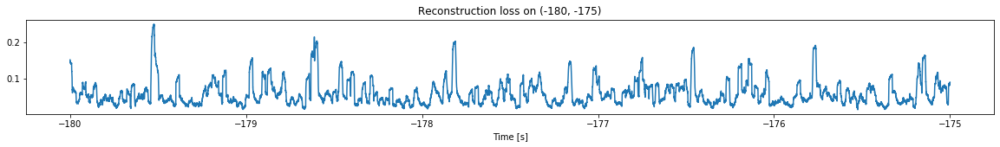

<--------
Entering sections:  (-175, -170)
-------->
Training for section:  (-180, -175)
Finished training, mean of the log(loss) is:  -2.0138733684167915
Triggering for section:  (-175, -170)
Using this mean for triggering: -2.0242430581430146


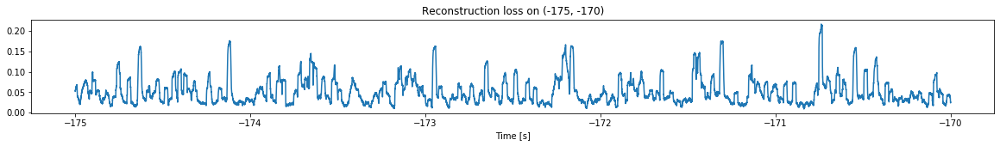

<--------
Entering sections:  (-170, -165)
-------->
Training for section:  (-175, -170)
Finished training, mean of the log(loss) is:  -2.028690093361554
Triggering for section:  (-170, -165)
Using this mean for triggering: -2.0138733684167915


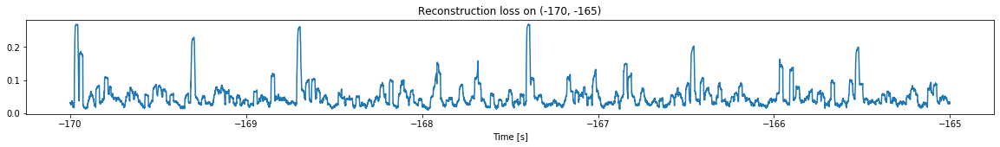

<--------
Entering sections:  (-165, -160)
-------->
Training for section:  (-170, -165)
Finished training, mean of the log(loss) is:  -2.0095401156305326
Triggering for section:  (-165, -160)
Using this mean for triggering: -2.028690093361554


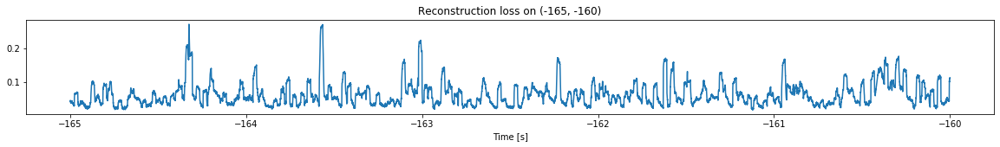

<--------
Entering sections:  (-160, -155)
-------->
Training for section:  (-165, -160)
Finished training, mean of the log(loss) is:  -1.9299959515153458
Triggering for section:  (-160, -155)
Using this mean for triggering: -2.0095401156305326


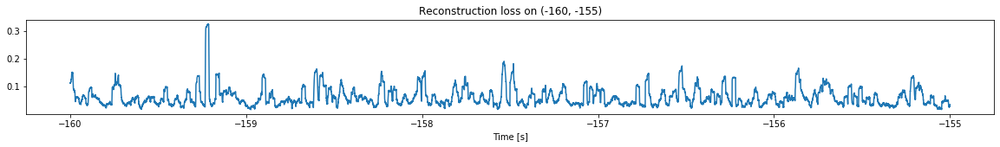

<--------
Entering sections:  (-155, -150)
-------->
Training for section:  (-160, -155)
Finished training, mean of the log(loss) is:  -1.984895493424162
Triggering for section:  (-155, -150)
Using this mean for triggering: -1.9299959515153458


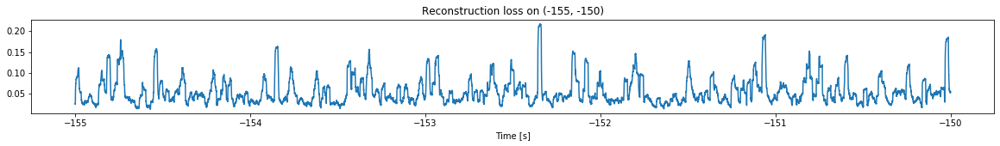

<--------
Entering sections:  (-150, -145)
-------->
Training for section:  (-155, -150)
Finished training, mean of the log(loss) is:  -2.029471177473487
Triggering for section:  (-150, -145)
Using this mean for triggering: -1.984895493424162


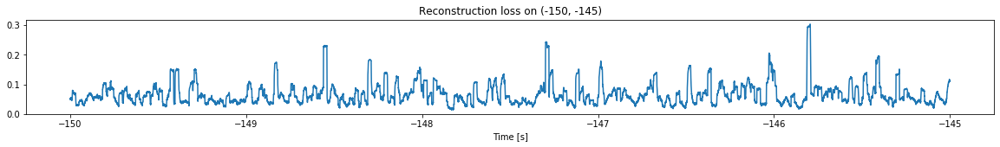

<--------
Entering sections:  (-145, -140)
-------->
Training for section:  (-150, -145)
Finished training, mean of the log(loss) is:  -1.9305197931139513
Triggering for section:  (-145, -140)
Using this mean for triggering: -2.029471177473487


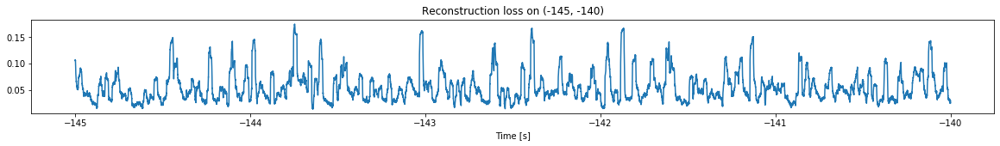

<--------
Entering sections:  (-140, -135)
-------->
Training for section:  (-145, -140)
Finished training, mean of the log(loss) is:  -2.015012872299316
Triggering for section:  (-140, -135)
Using this mean for triggering: -1.9305197931139513


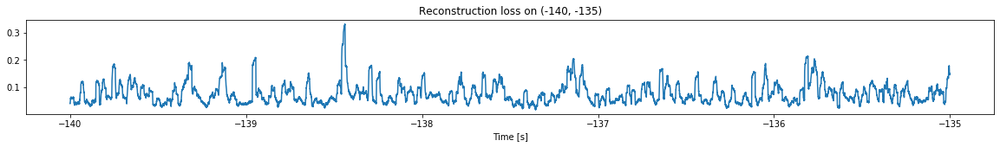

<--------
Entering sections:  (-135, -130)
-------->
Training for section:  (-140, -135)
Finished training, mean of the log(loss) is:  -2.0861126768868443
Triggering for section:  (-135, -130)
Using this mean for triggering: -2.015012872299316


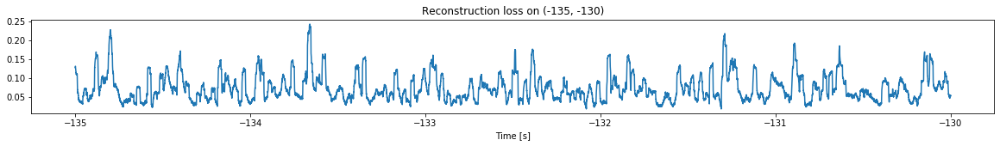

<--------
Entering sections:  (-130, -125)
-------->
Training for section:  (-135, -130)
Finished training, mean of the log(loss) is:  -1.9836976305244414
Triggering for section:  (-130, -125)
Using this mean for triggering: -2.0861126768868443


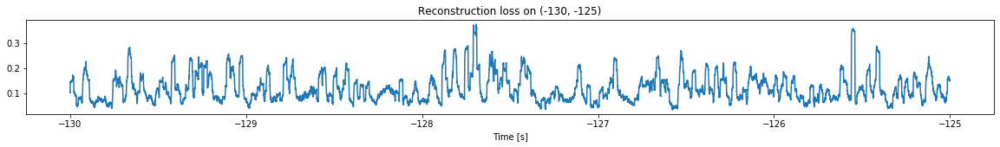

<--------
Entering sections:  (-125, -120)
-------->
Training for section:  (-130, -125)
Finished training, mean of the log(loss) is:  -1.966384911575052
Triggering for section:  (-125, -120)
Using this mean for triggering: -1.9836976305244414


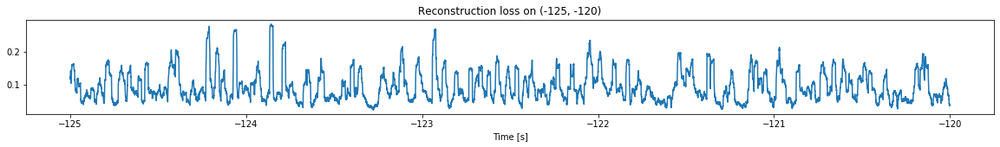

<--------
Entering sections:  (-120, -115)
-------->
Training for section:  (-125, -120)
Finished training, mean of the log(loss) is:  -1.80425600870727
Triggering for section:  (-120, -115)
Using this mean for triggering: -1.966384911575052


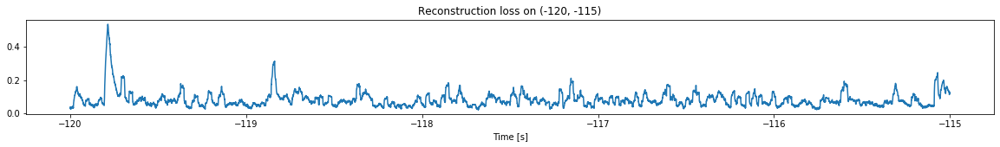

<--------
Entering sections:  (-115, -110)
-------->
Training for section:  (-120, -115)
Finished training, mean of the log(loss) is:  -1.9258660583988296
Triggering for section:  (-115, -110)
Using this mean for triggering: -1.80425600870727


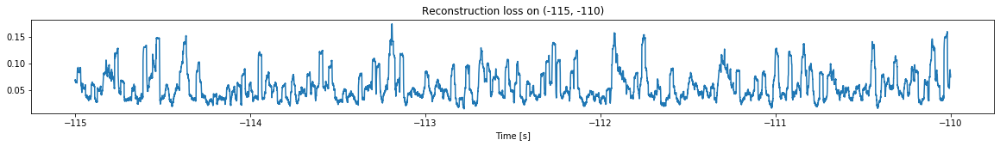

<--------
Entering sections:  (-110, -105)
-------->
Training for section:  (-115, -110)
Finished training, mean of the log(loss) is:  -2.0001896065523255
Triggering for section:  (-110, -105)
Using this mean for triggering: -1.9258660583988296


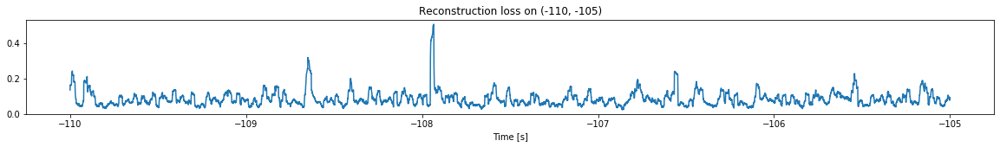

<--------
Entering sections:  (-105, -100)
-------->
Training for section:  (-110, -105)
Finished training, mean of the log(loss) is:  -1.9594457414875261
Triggering for section:  (-105, -100)
Using this mean for triggering: -2.0001896065523255


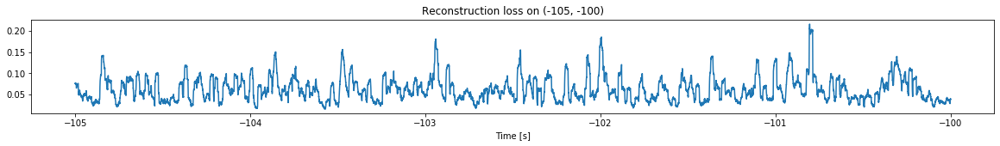

<--------
Entering sections:  (-100, -95)
-------->
Training for section:  (-105, -100)
Finished training, mean of the log(loss) is:  -2.018538869514121
Triggering for section:  (-100, -95)
Using this mean for triggering: -1.9594457414875261


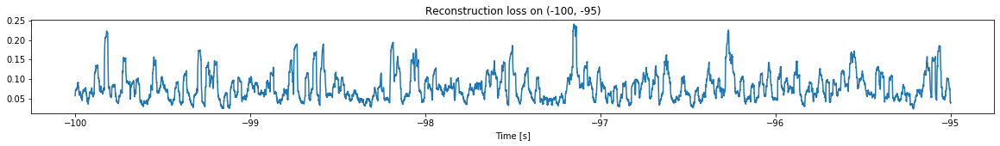

<--------
Entering sections:  (-95, -90)
-------->
Training for section:  (-100, -95)
Finished training, mean of the log(loss) is:  -1.9504717344088478
Triggering for section:  (-95, -90)
Using this mean for triggering: -2.018538869514121


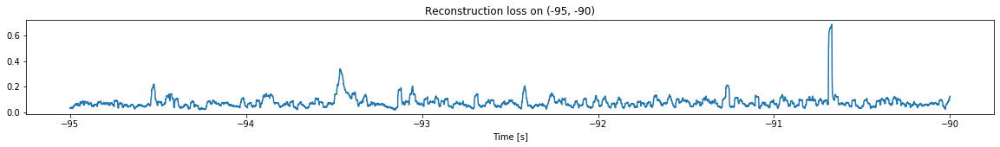

<--------
Entering sections:  (-90, -85)
-------->
Training for section:  (-95, -90)
Finished training, mean of the log(loss) is:  -1.8715136658230165
Triggering for section:  (-90, -85)
Using this mean for triggering: -1.9504717344088478


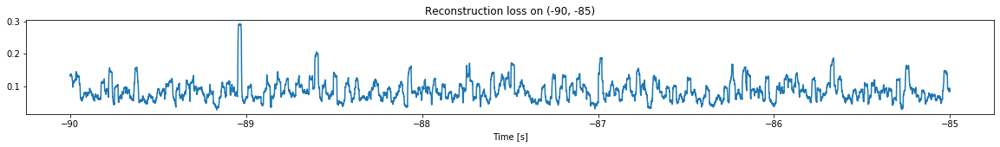

<--------
Entering sections:  (-85, -80)
-------->
Training for section:  (-90, -85)
Finished training, mean of the log(loss) is:  -1.914407508467515
Triggering for section:  (-85, -80)
Using this mean for triggering: -1.8715136658230165


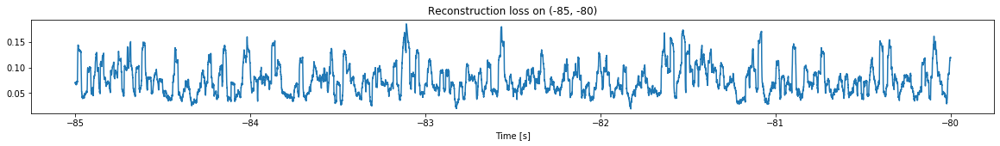

<--------
Entering sections:  (-80, -75)
-------->
Training for section:  (-85, -80)
Finished training, mean of the log(loss) is:  -1.9182997625464917
Triggering for section:  (-80, -75)
Using this mean for triggering: -1.914407508467515


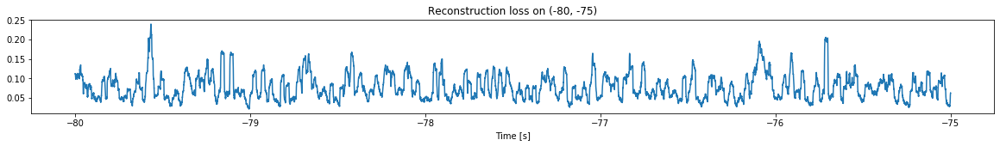

<--------
Entering sections:  (-75, -70)
-------->
Training for section:  (-80, -75)
Finished training, mean of the log(loss) is:  -1.9787760568963157
Triggering for section:  (-75, -70)
Using this mean for triggering: -1.9182997625464917


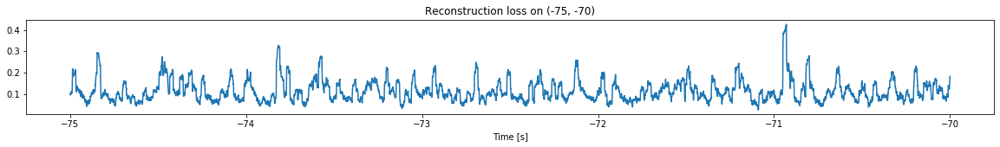

<--------
Entering sections:  (-70, -65)
-------->
Training for section:  (-75, -70)
Finished training, mean of the log(loss) is:  -1.8769789261182266
Triggering for section:  (-70, -65)
Using this mean for triggering: -1.9787760568963157


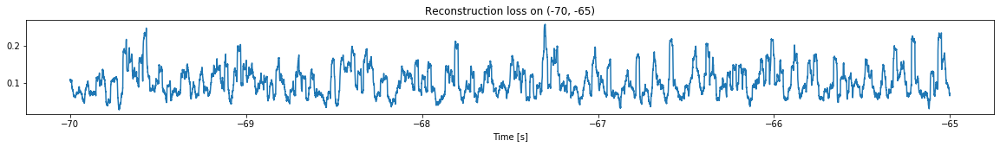

<--------
Entering sections:  (-65, -60)
-------->
Training for section:  (-70, -65)
Finished training, mean of the log(loss) is:  -1.8412920731223776
Triggering for section:  (-65, -60)
Using this mean for triggering: -1.8769789261182266


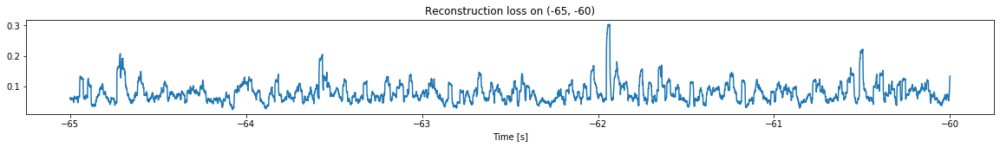

<--------
Entering sections:  (-60, -55)
-------->
Training for section:  (-65, -60)
Finished training, mean of the log(loss) is:  -1.8889996223580963
Triggering for section:  (-60, -55)
Using this mean for triggering: -1.8412920731223776


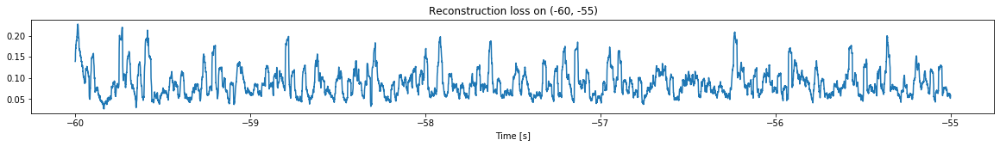

<--------
Entering sections:  (-55, -50)
-------->
Training for section:  (-60, -55)
Finished training, mean of the log(loss) is:  -1.9011829790060233
Triggering for section:  (-55, -50)
Using this mean for triggering: -1.8889996223580963


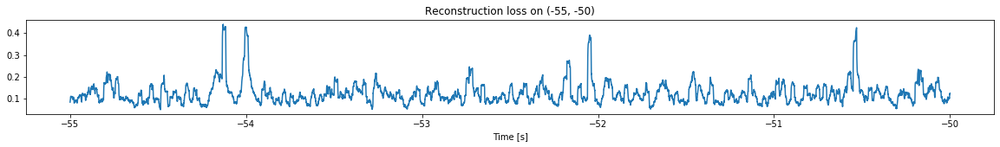

<--------
Entering sections:  (-50, -45)
-------->
Training for section:  (-55, -50)
Finished training, mean of the log(loss) is:  -1.8623423438860587
Triggering for section:  (-50, -45)
Using this mean for triggering: -1.9011829790060233


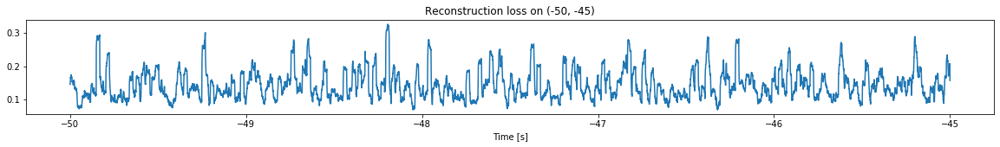

<--------
Entering sections:  (-45, -40)
-------->
Training for section:  (-50, -45)
Finished training, mean of the log(loss) is:  -1.767465477303133
Triggering for section:  (-45, -40)
Using this mean for triggering: -1.8623423438860587


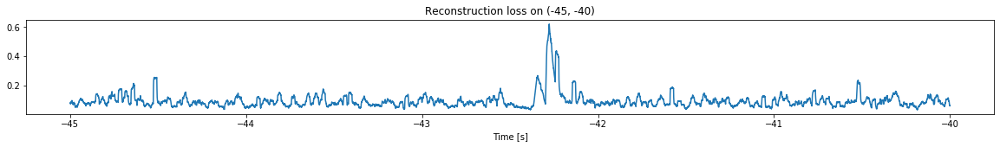

<--------
Entering sections:  (-40, -35)
-------->
Training for section:  (-45, -40)
Finished training, mean of the log(loss) is:  -1.8664003733417127
Triggering for section:  (-40, -35)
Using this mean for triggering: -1.767465477303133


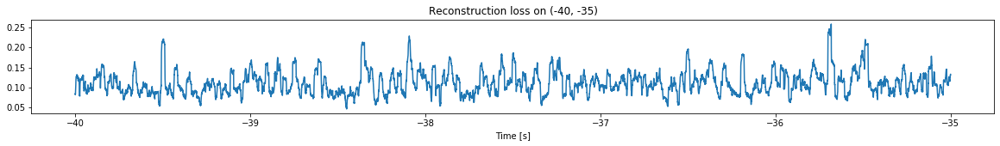

<--------
Entering sections:  (-35, -30)
-------->
Training for section:  (-40, -35)
Finished training, mean of the log(loss) is:  -1.8037804105657633
Triggering for section:  (-35, -30)
Using this mean for triggering: -1.8664003733417127


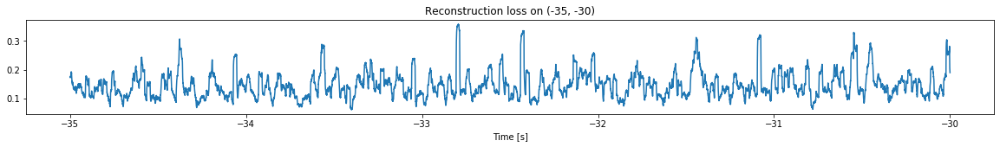

<--------
Entering sections:  (-30, -25)
-------->
Training for section:  (-35, -30)
Finished training, mean of the log(loss) is:  -1.8569008917281313
Triggering for section:  (-30, -25)
Using this mean for triggering: -1.8037804105657633


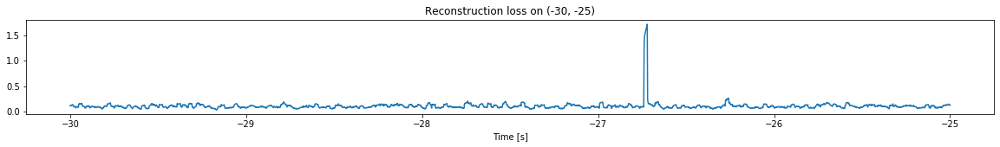

<--------
Entering sections:  (-25, -20)
-------->
Training for section:  (-30, -25)
Finished training, mean of the log(loss) is:  -1.8785366715382357
Triggering for section:  (-25, -20)
Using this mean for triggering: -1.8569008917281313


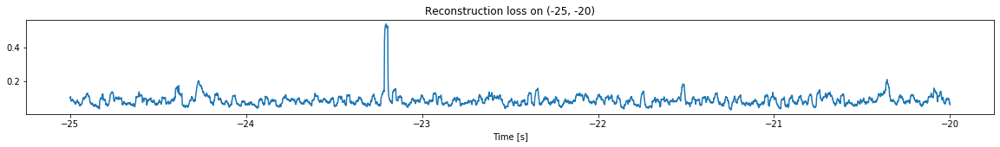

<--------
Entering sections:  (-20, -15)
-------->
Training for section:  (-25, -20)
Finished training, mean of the log(loss) is:  -1.782051866002969
Triggering for section:  (-20, -15)
Using this mean for triggering: -1.8785366715382357


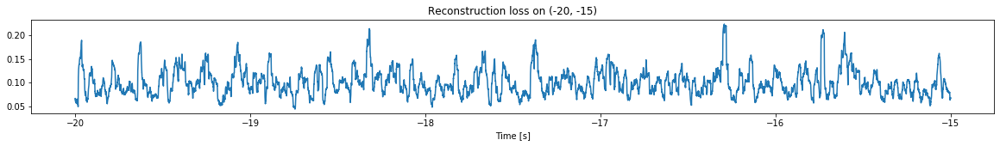

<--------
Entering sections:  (-15, -10)
-------->
Training for section:  (-20, -15)
Finished training, mean of the log(loss) is:  -1.8229887846827313
Triggering for section:  (-15, -10)
Using this mean for triggering: -1.782051866002969


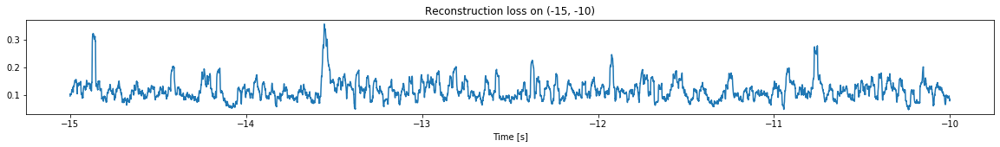

<--------
Entering sections:  (-10, -5)
-------->
Training for section:  (-15, -10)
Finished training, mean of the log(loss) is:  -1.8851787406890774
Triggering for section:  (-10, -5)
Using this mean for triggering: -1.8229887846827313


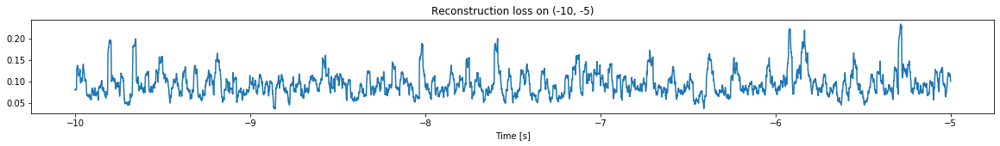

<--------
Entering sections:  (-5, 0)
-------->
Training for section:  (-10, -5)
Finished training, mean of the log(loss) is:  -1.8277139014440587
Triggering for section:  (-5, 0)
Using this mean for triggering: -1.8851787406890774


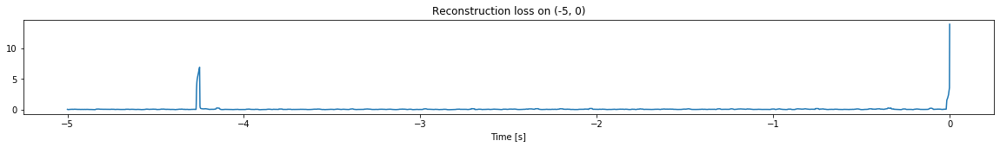

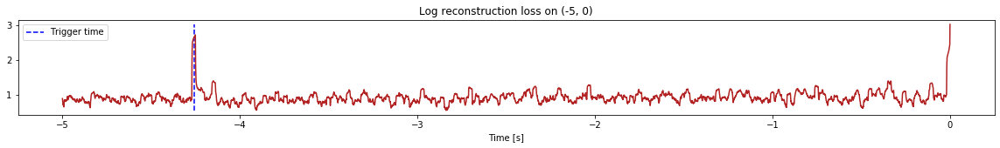

Triggered at:  -4.25869


-4.25869

In [4]:
simulation("./data/Ramp5/", 5, (-300,0))

Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
All data's shape:  (2997500, 12)
Flushing input history
Number of sections: 60
Entering sections:  (-300, -295)
-------->
Entering sections:  (-295, -290)
-------->
Training for section:  (None, -295)
Finished training, mean of the log(loss) is:  -1.3720628789642237
<--------
Entering sections:  (-290, -285)
-------->
Training for section:  (-295, -290)
Finished training, mean of the log(loss) is:  -1.563360399328646
Triggering for section:  (-290, -285)
Using this mean for triggering: -1.3720628789642237


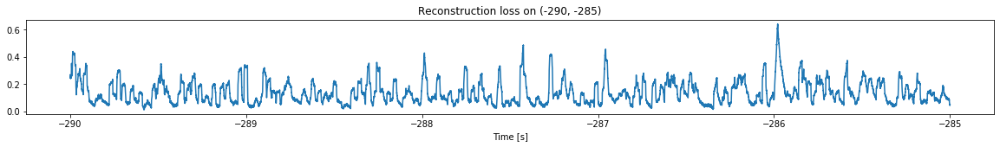

<--------
Entering sections:  (-285, -280)
-------->
Training for section:  (-290, -285)
Finished training, mean of the log(loss) is:  -1.5175396673558823
Triggering for section:  (-285, -280)
Using this mean for triggering: -1.563360399328646


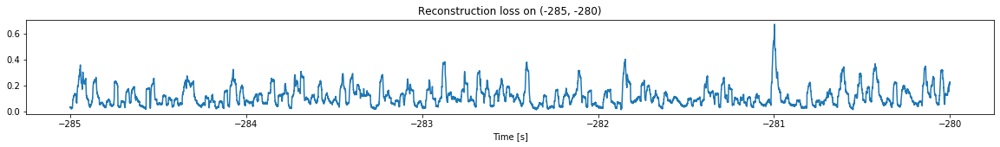

<--------
Entering sections:  (-280, -275)
-------->
Training for section:  (-285, -280)
Finished training, mean of the log(loss) is:  -1.6147106800745799
Triggering for section:  (-280, -275)
Using this mean for triggering: -1.5175396673558823


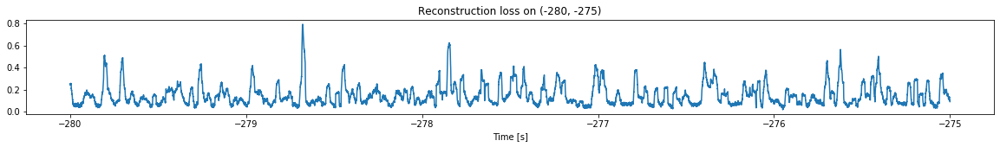

<--------
Entering sections:  (-275, -270)
-------->
Training for section:  (-280, -275)
Finished training, mean of the log(loss) is:  -1.618507389922815
Triggering for section:  (-275, -270)
Using this mean for triggering: -1.6147106800745799


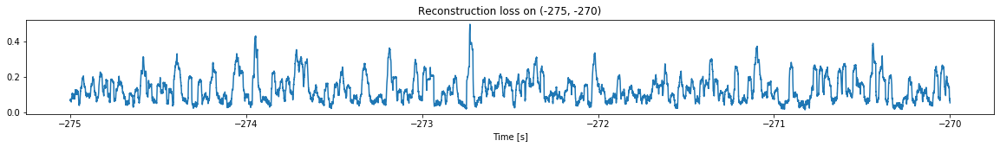

<--------
Entering sections:  (-270, -265)
-------->
Training for section:  (-275, -270)
Finished training, mean of the log(loss) is:  -1.6082857160392432
Triggering for section:  (-270, -265)
Using this mean for triggering: -1.618507389922815


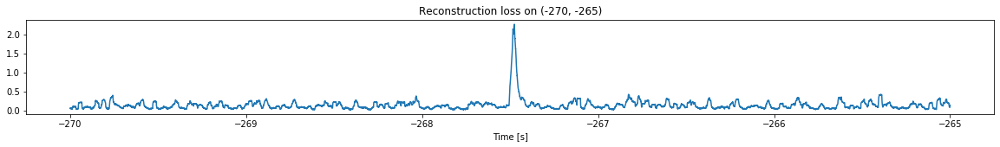

<--------
Entering sections:  (-265, -260)
-------->
Training for section:  (-270, -265)
Finished training, mean of the log(loss) is:  -1.669329017876717
Triggering for section:  (-265, -260)
Using this mean for triggering: -1.6082857160392432


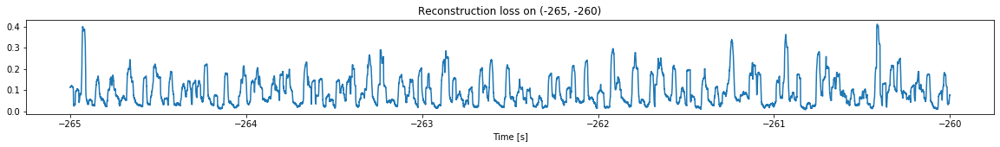

<--------
Entering sections:  (-260, -255)
-------->
Training for section:  (-265, -260)
Finished training, mean of the log(loss) is:  -1.7115148088592127
Triggering for section:  (-260, -255)
Using this mean for triggering: -1.669329017876717


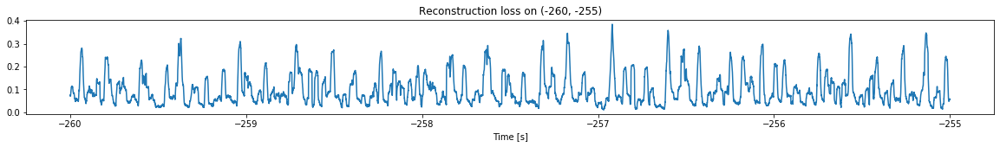

<--------
Entering sections:  (-255, -250)
-------->
Training for section:  (-260, -255)
Finished training, mean of the log(loss) is:  -1.7419460929950232
Triggering for section:  (-255, -250)
Using this mean for triggering: -1.7115148088592127


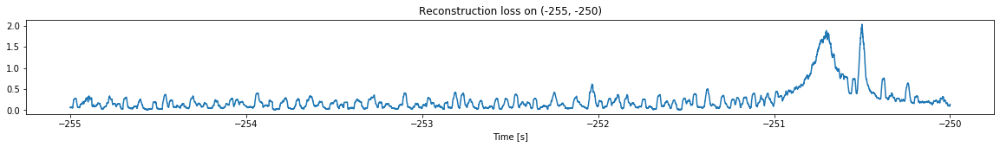

<--------
Entering sections:  (-250, -245)
-------->
Training for section:  (-255, -250)
Finished training, mean of the log(loss) is:  -1.7063764295260224
Triggering for section:  (-250, -245)
Using this mean for triggering: -1.7419460929950232


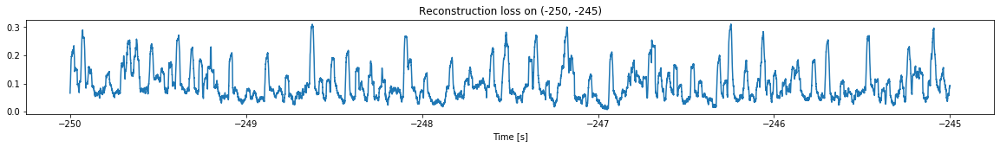

<--------
Entering sections:  (-245, -240)
-------->
Training for section:  (-250, -245)
Finished training, mean of the log(loss) is:  -1.9036090379281272
Triggering for section:  (-245, -240)
Using this mean for triggering: -1.7063764295260224


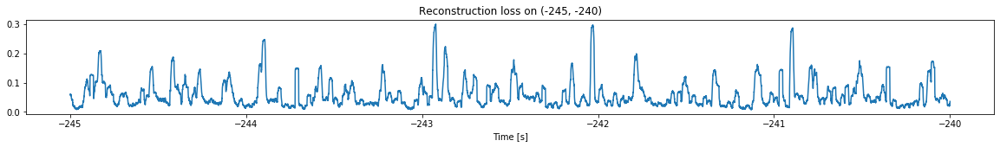

<--------
Entering sections:  (-240, -235)
-------->
Training for section:  (-245, -240)
Finished training, mean of the log(loss) is:  -1.9789582035734679
Triggering for section:  (-240, -235)
Using this mean for triggering: -1.9036090379281272


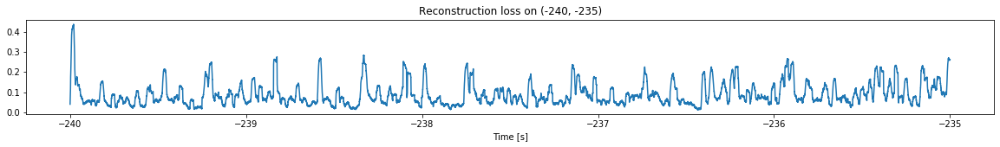

<--------
Entering sections:  (-235, -230)
-------->
Training for section:  (-240, -235)
Finished training, mean of the log(loss) is:  -2.0083887767706496
Triggering for section:  (-235, -230)
Using this mean for triggering: -1.9789582035734679


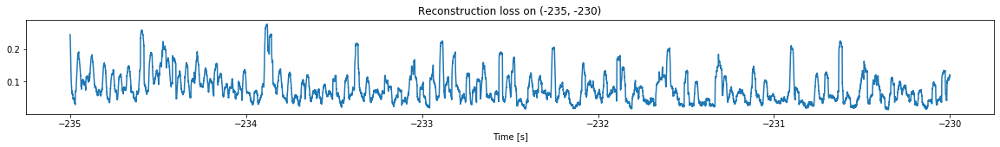

<--------
Entering sections:  (-230, -225)
-------->
Training for section:  (-235, -230)
Finished training, mean of the log(loss) is:  -1.9216930089933681
Triggering for section:  (-230, -225)
Using this mean for triggering: -2.0083887767706496


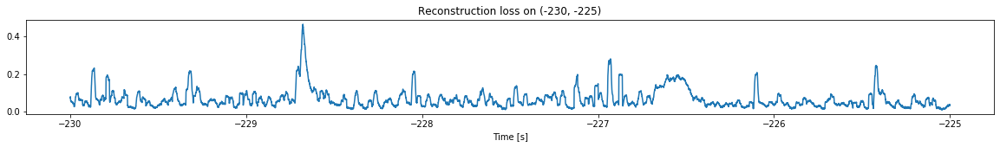

<--------
Entering sections:  (-225, -220)
-------->
Training for section:  (-230, -225)
Finished training, mean of the log(loss) is:  -1.9209406770880375
Triggering for section:  (-225, -220)
Using this mean for triggering: -1.9216930089933681


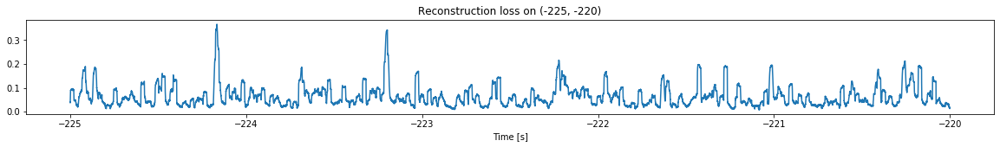

<--------
Entering sections:  (-220, -215)
-------->
Training for section:  (-225, -220)
Finished training, mean of the log(loss) is:  -1.9993350188493506
Triggering for section:  (-220, -215)
Using this mean for triggering: -1.9209406770880375


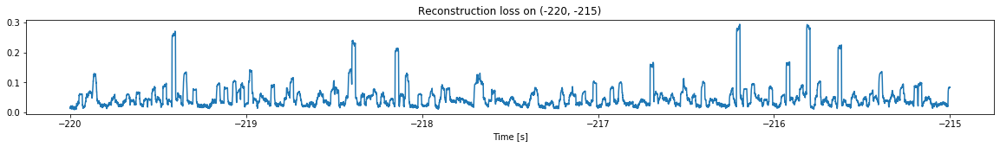

<--------
Entering sections:  (-215, -210)
-------->
Training for section:  (-220, -215)
Finished training, mean of the log(loss) is:  -2.075873829831296
Triggering for section:  (-215, -210)
Using this mean for triggering: -1.9993350188493506


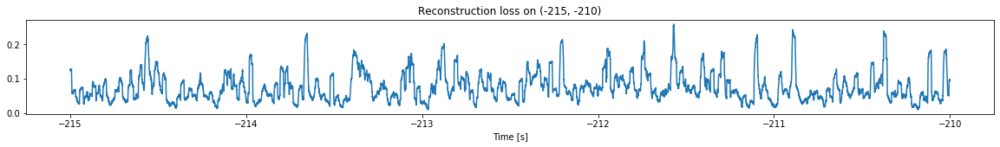

<--------
Entering sections:  (-210, -205)
-------->
Training for section:  (-215, -210)
Finished training, mean of the log(loss) is:  -2.034691177949805
Triggering for section:  (-210, -205)
Using this mean for triggering: -2.075873829831296


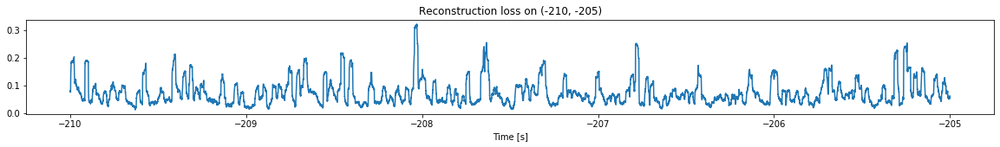

<--------
Entering sections:  (-205, -200)
-------->
Training for section:  (-210, -205)
Finished training, mean of the log(loss) is:  -1.9776533443930098
Triggering for section:  (-205, -200)
Using this mean for triggering: -2.034691177949805


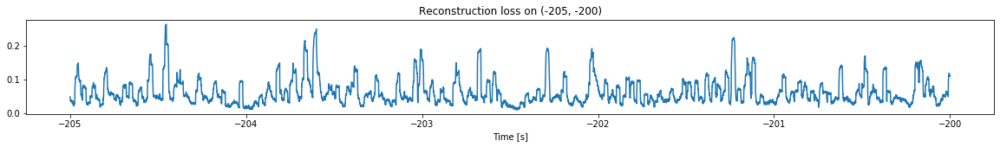

<--------
Entering sections:  (-200, -195)
-------->
Training for section:  (-205, -200)
Finished training, mean of the log(loss) is:  -2.058326073797149
Triggering for section:  (-200, -195)
Using this mean for triggering: -1.9776533443930098


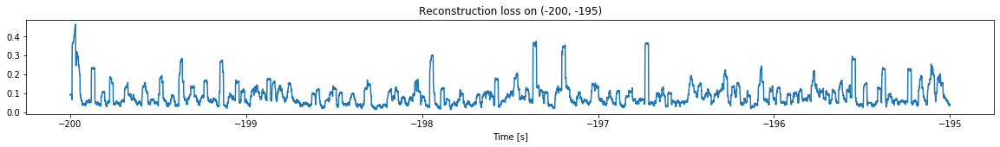

<--------
Entering sections:  (-195, -190)
-------->
Training for section:  (-200, -195)
Finished training, mean of the log(loss) is:  -2.037226291453893
Triggering for section:  (-195, -190)
Using this mean for triggering: -2.058326073797149


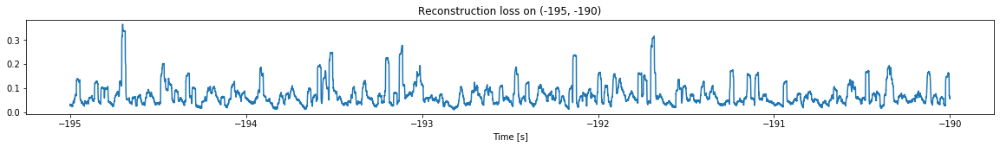

<--------
Entering sections:  (-190, -185)
-------->
Training for section:  (-195, -190)
Finished training, mean of the log(loss) is:  -2.0154597049665837
Triggering for section:  (-190, -185)
Using this mean for triggering: -2.037226291453893


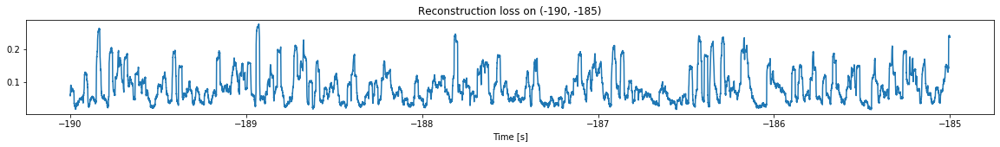

<--------
Entering sections:  (-185, -180)
-------->
Training for section:  (-190, -185)
Finished training, mean of the log(loss) is:  -2.0553583572046787
Triggering for section:  (-185, -180)
Using this mean for triggering: -2.0154597049665837


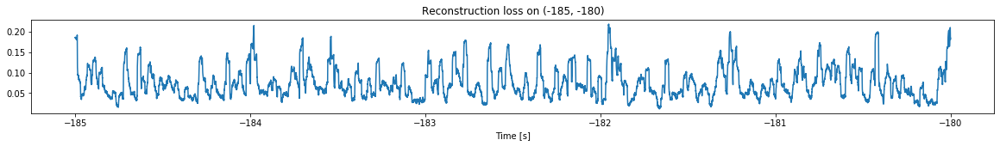

<--------
Entering sections:  (-180, -175)
-------->
Training for section:  (-185, -180)
Finished training, mean of the log(loss) is:  -2.0331951716672836
Triggering for section:  (-180, -175)
Using this mean for triggering: -2.0553583572046787


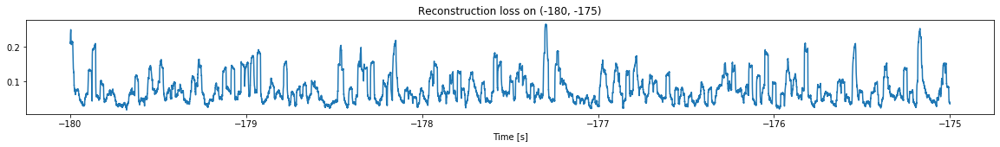

<--------
Entering sections:  (-175, -170)
-------->
Training for section:  (-180, -175)
Finished training, mean of the log(loss) is:  -1.9989887485507511
Triggering for section:  (-175, -170)
Using this mean for triggering: -2.0331951716672836


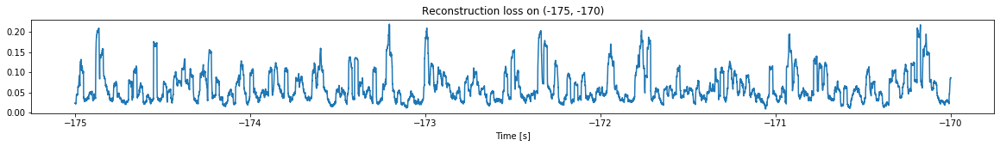

<--------
Entering sections:  (-170, -165)
-------->
Training for section:  (-175, -170)
Finished training, mean of the log(loss) is:  -2.0278076414389092
Triggering for section:  (-170, -165)
Using this mean for triggering: -1.9989887485507511


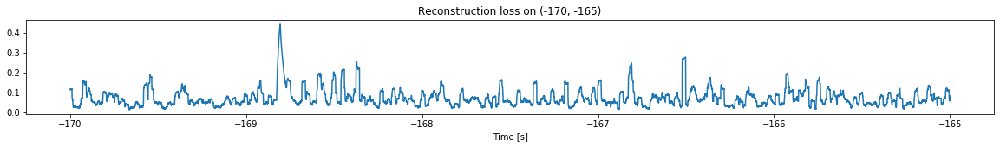

<--------
Entering sections:  (-165, -160)
-------->
Training for section:  (-170, -165)
Finished training, mean of the log(loss) is:  -2.0201575522024617
Triggering for section:  (-165, -160)
Using this mean for triggering: -2.0278076414389092


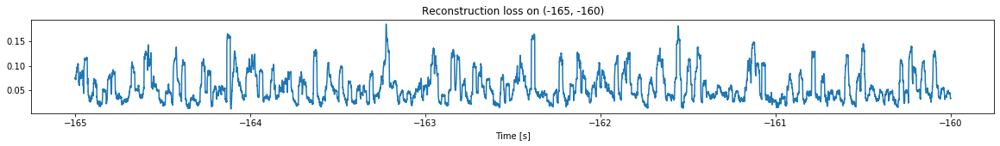

<--------
Entering sections:  (-160, -155)
-------->
Training for section:  (-165, -160)
Finished training, mean of the log(loss) is:  -1.9765078313622433
Triggering for section:  (-160, -155)
Using this mean for triggering: -2.0201575522024617


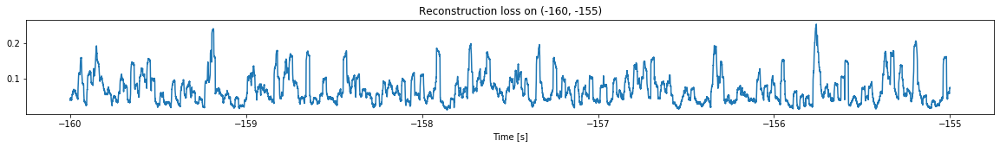

<--------
Entering sections:  (-155, -150)
-------->
Training for section:  (-160, -155)
Finished training, mean of the log(loss) is:  -2.0536383990280487
Triggering for section:  (-155, -150)
Using this mean for triggering: -1.9765078313622433


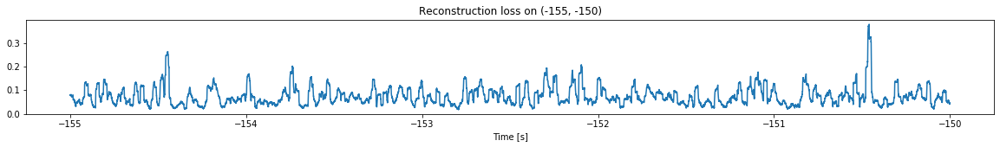

<--------
Entering sections:  (-150, -145)
-------->
Training for section:  (-155, -150)
Finished training, mean of the log(loss) is:  -2.0093165427961828
Triggering for section:  (-150, -145)
Using this mean for triggering: -2.0536383990280487


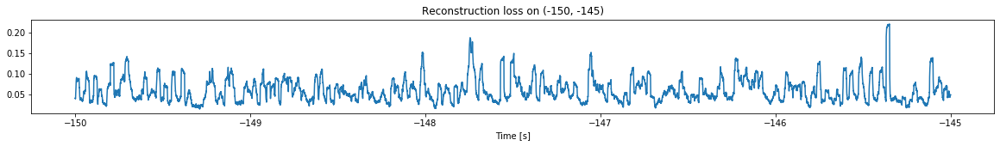

<--------
Entering sections:  (-145, -140)
-------->
Training for section:  (-150, -145)
Finished training, mean of the log(loss) is:  -1.9297081159063607
Triggering for section:  (-145, -140)
Using this mean for triggering: -2.0093165427961828


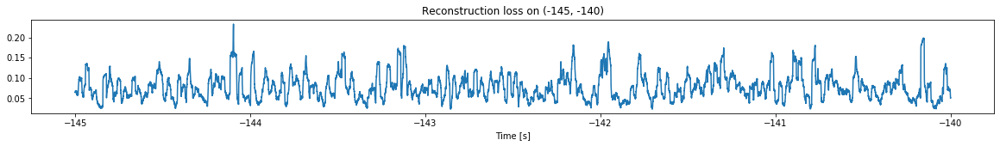

<--------
Entering sections:  (-140, -135)
-------->
Training for section:  (-145, -140)
Finished training, mean of the log(loss) is:  -1.9069050395887976
Triggering for section:  (-140, -135)
Using this mean for triggering: -1.9297081159063607


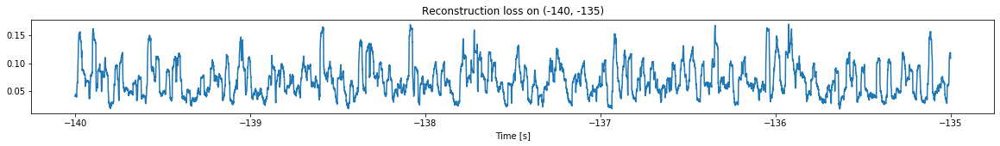

<--------
Entering sections:  (-135, -130)
-------->
Training for section:  (-140, -135)
Finished training, mean of the log(loss) is:  -1.882020269699107
Triggering for section:  (-135, -130)
Using this mean for triggering: -1.9069050395887976


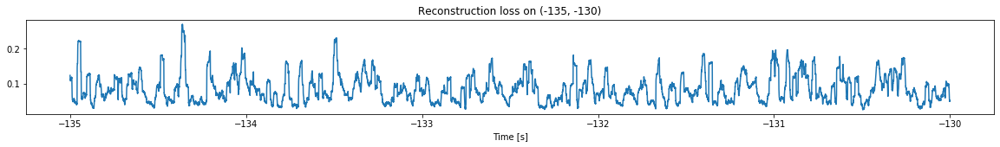

<--------
Entering sections:  (-130, -125)
-------->
Training for section:  (-135, -130)
Finished training, mean of the log(loss) is:  -1.8457053241056145
Triggering for section:  (-130, -125)
Using this mean for triggering: -1.882020269699107


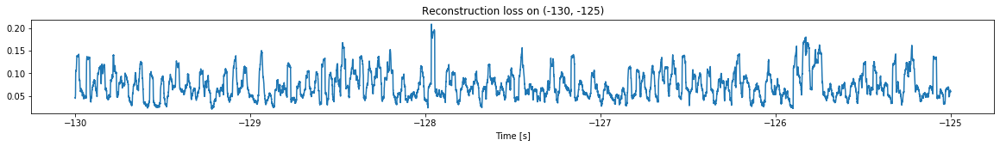

<--------
Entering sections:  (-125, -120)
-------->
Training for section:  (-130, -125)
Finished training, mean of the log(loss) is:  -1.8849114789210577
Triggering for section:  (-125, -120)
Using this mean for triggering: -1.8457053241056145


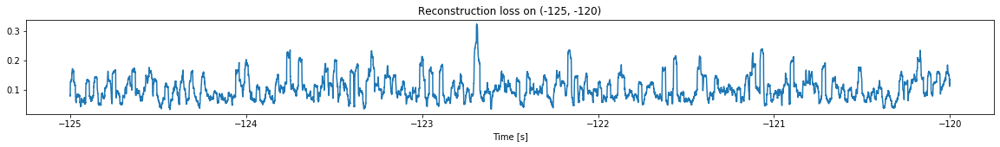

<--------
Entering sections:  (-120, -115)
-------->
Training for section:  (-125, -120)
Finished training, mean of the log(loss) is:  -1.8621874453927907
Triggering for section:  (-120, -115)
Using this mean for triggering: -1.8849114789210577


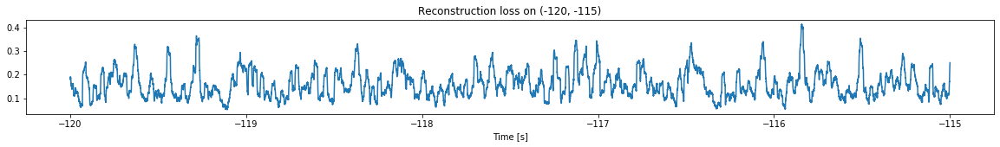

<--------
Entering sections:  (-115, -110)
-------->
Training for section:  (-120, -115)
Finished training, mean of the log(loss) is:  -1.9124060662442148
Triggering for section:  (-115, -110)
Using this mean for triggering: -1.8621874453927907


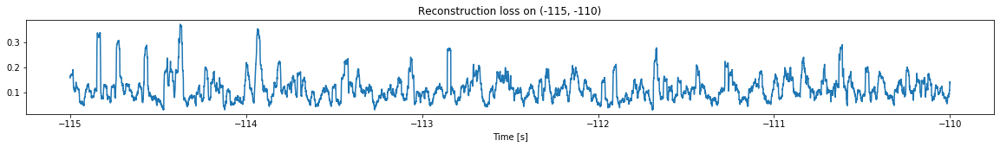

<--------
Entering sections:  (-110, -105)
-------->
Training for section:  (-115, -110)
Finished training, mean of the log(loss) is:  -1.7834879347739627
Triggering for section:  (-110, -105)
Using this mean for triggering: -1.9124060662442148


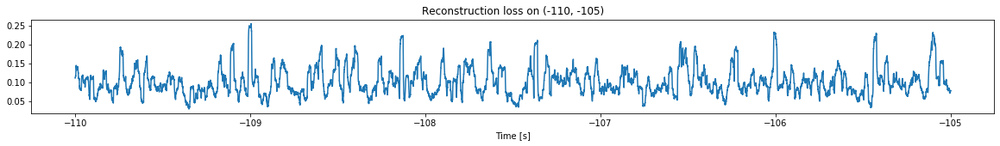

<--------
Entering sections:  (-105, -100)
-------->
Training for section:  (-110, -105)
Finished training, mean of the log(loss) is:  -1.7295034136770298
Triggering for section:  (-105, -100)
Using this mean for triggering: -1.7834879347739627


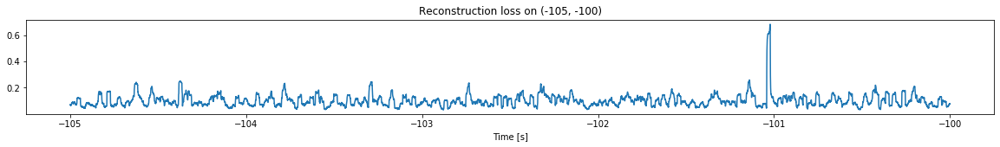

<--------
Entering sections:  (-100, -95)
-------->
Training for section:  (-105, -100)
Finished training, mean of the log(loss) is:  -1.8382615090642358
Triggering for section:  (-100, -95)
Using this mean for triggering: -1.7295034136770298


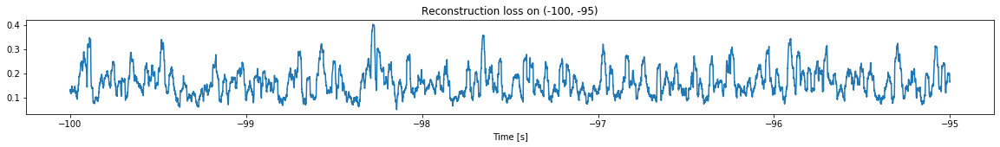

<--------
Entering sections:  (-95, -90)
-------->
Training for section:  (-100, -95)
Finished training, mean of the log(loss) is:  -1.8913944127369966
Triggering for section:  (-95, -90)
Using this mean for triggering: -1.8382615090642358


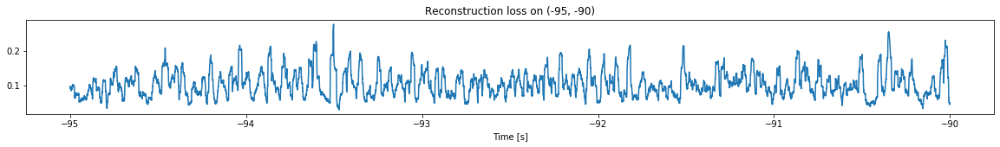

<--------
Entering sections:  (-90, -85)
-------->
Training for section:  (-95, -90)
Finished training, mean of the log(loss) is:  -1.8583934720124655
Triggering for section:  (-90, -85)
Using this mean for triggering: -1.8913944127369966


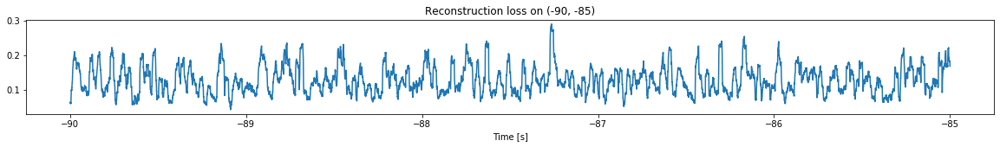

<--------
Entering sections:  (-85, -80)
-------->
Training for section:  (-90, -85)
Finished training, mean of the log(loss) is:  -1.7957252598923104
Triggering for section:  (-85, -80)
Using this mean for triggering: -1.8583934720124655


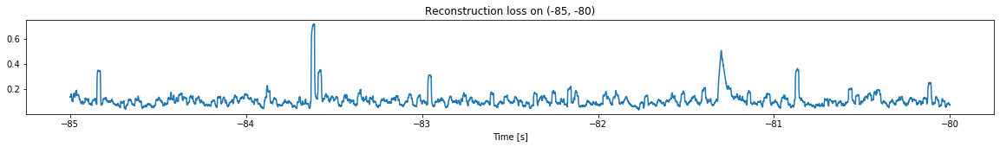

<--------
Entering sections:  (-80, -75)
-------->
Training for section:  (-85, -80)
Finished training, mean of the log(loss) is:  -1.8068996913034474
Triggering for section:  (-80, -75)
Using this mean for triggering: -1.7957252598923104


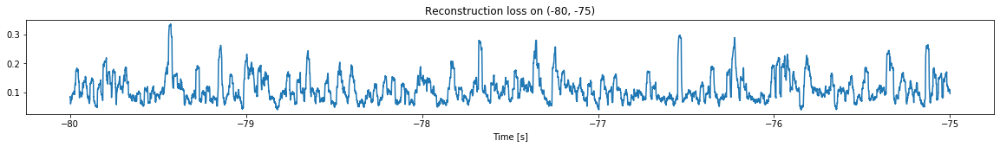

<--------
Entering sections:  (-75, -70)
-------->
Training for section:  (-80, -75)
Finished training, mean of the log(loss) is:  -1.87091373410553
Triggering for section:  (-75, -70)
Using this mean for triggering: -1.8068996913034474


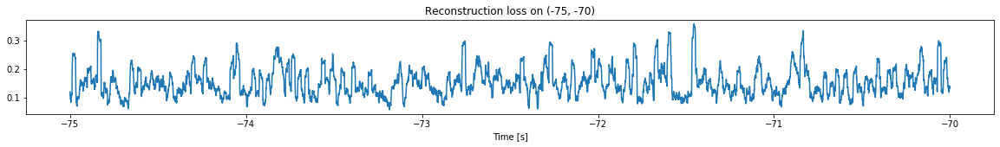

<--------
Entering sections:  (-70, -65)
-------->
Training for section:  (-75, -70)
Finished training, mean of the log(loss) is:  -1.862015147101944
Triggering for section:  (-70, -65)
Using this mean for triggering: -1.87091373410553


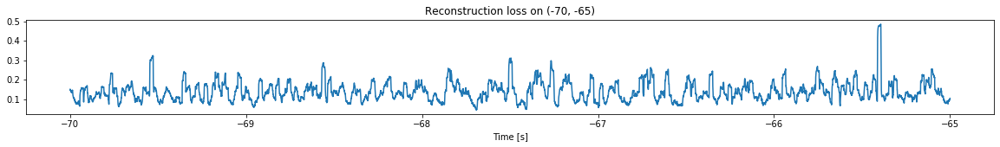

<--------
Entering sections:  (-65, -60)
-------->
Training for section:  (-70, -65)
Finished training, mean of the log(loss) is:  -1.8379615249195538
Triggering for section:  (-65, -60)
Using this mean for triggering: -1.862015147101944


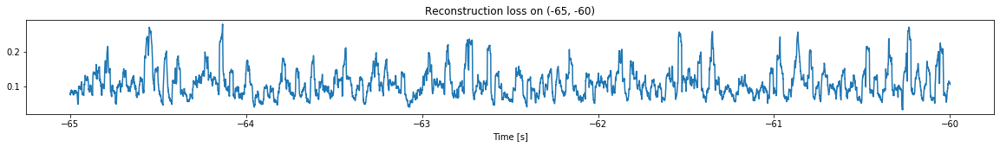

<--------
Entering sections:  (-60, -55)
-------->
Training for section:  (-65, -60)
Finished training, mean of the log(loss) is:  -1.8417422322538388
Triggering for section:  (-60, -55)
Using this mean for triggering: -1.8379615249195538


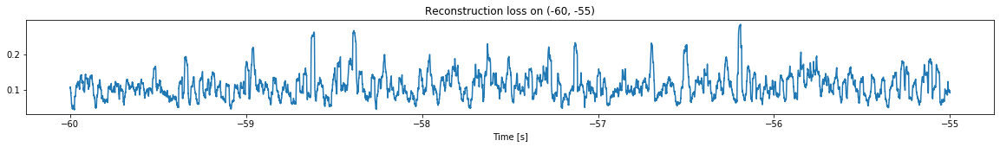

<--------
Entering sections:  (-55, -50)
-------->
Training for section:  (-60, -55)
Finished training, mean of the log(loss) is:  -1.684943027748939
Triggering for section:  (-55, -50)
Using this mean for triggering: -1.8417422322538388


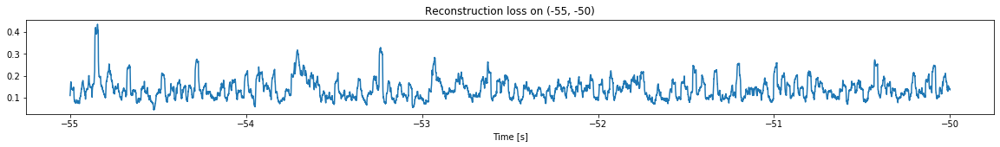

<--------
Entering sections:  (-50, -45)
-------->
Training for section:  (-55, -50)
Finished training, mean of the log(loss) is:  -1.7473910524012493
Triggering for section:  (-50, -45)
Using this mean for triggering: -1.684943027748939


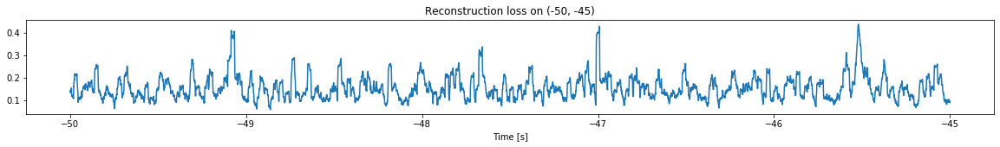

<--------
Entering sections:  (-45, -40)
-------->
Training for section:  (-50, -45)
Finished training, mean of the log(loss) is:  -1.6989876414919949
Triggering for section:  (-45, -40)
Using this mean for triggering: -1.7473910524012493


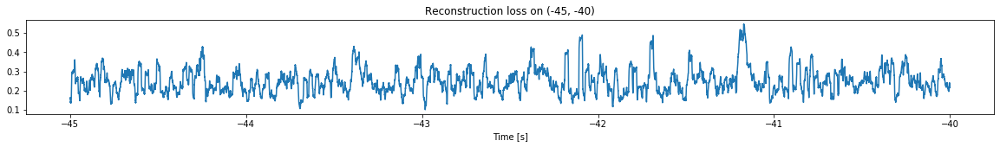

<--------
Entering sections:  (-40, -35)
-------->
Training for section:  (-45, -40)
Finished training, mean of the log(loss) is:  -1.7422783960978325
Triggering for section:  (-40, -35)
Using this mean for triggering: -1.6989876414919949


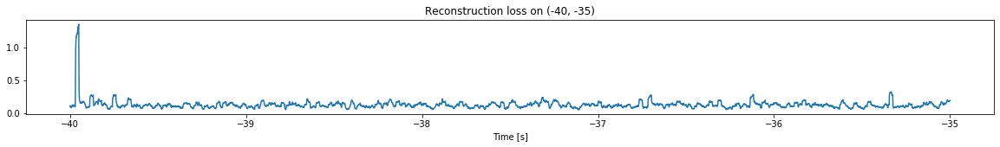

<--------
Entering sections:  (-35, -30)
-------->
Training for section:  (-40, -35)
Finished training, mean of the log(loss) is:  -1.7062432706881574
Triggering for section:  (-35, -30)
Using this mean for triggering: -1.7422783960978325


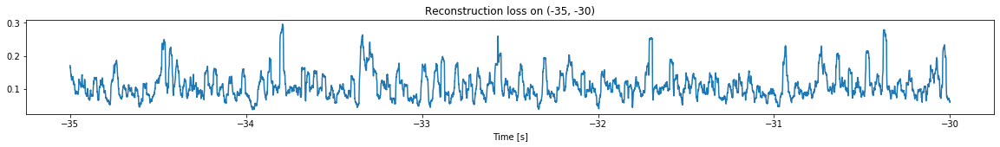

<--------
Entering sections:  (-30, -25)
-------->
Training for section:  (-35, -30)
Finished training, mean of the log(loss) is:  -1.7994386048440227
Triggering for section:  (-30, -25)
Using this mean for triggering: -1.7062432706881574


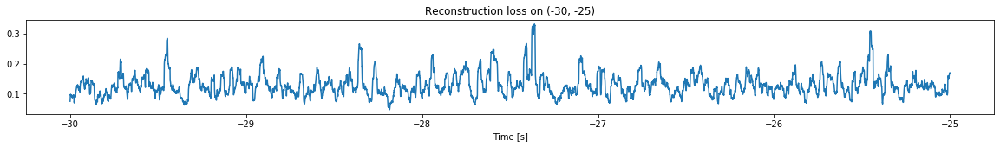

<--------
Entering sections:  (-25, -20)
-------->
Training for section:  (-30, -25)
Finished training, mean of the log(loss) is:  -1.750132976967265
Triggering for section:  (-25, -20)
Using this mean for triggering: -1.7994386048440227


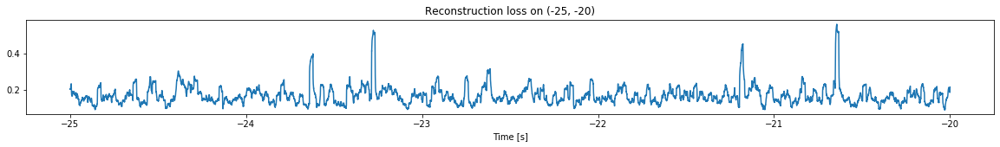

<--------
Entering sections:  (-20, -15)
-------->
Training for section:  (-25, -20)
Finished training, mean of the log(loss) is:  -1.7497618700635051
Triggering for section:  (-20, -15)
Using this mean for triggering: -1.750132976967265


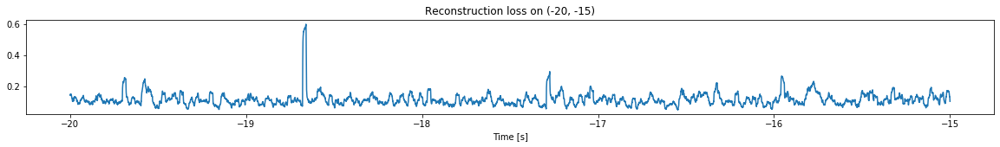

<--------
Entering sections:  (-15, -10)
-------->
Training for section:  (-20, -15)
Finished training, mean of the log(loss) is:  -1.8020017913608755
Triggering for section:  (-15, -10)
Using this mean for triggering: -1.7497618700635051


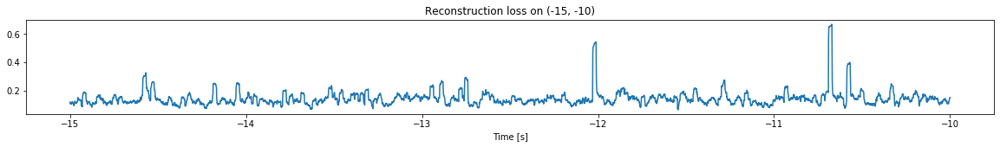

<--------
Entering sections:  (-10, -5)
-------->
Training for section:  (-15, -10)
Finished training, mean of the log(loss) is:  -1.887468378998257
Triggering for section:  (-10, -5)
Using this mean for triggering: -1.8020017913608755


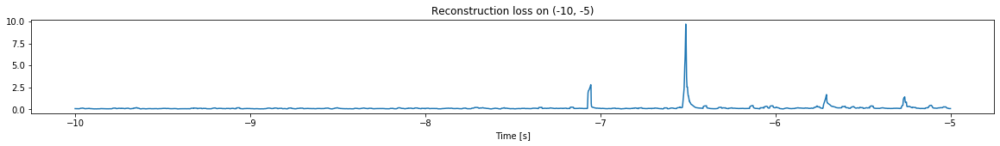

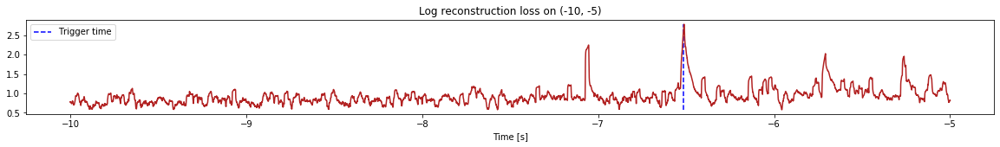

Triggered at:  -6.5141897


-6.5141897

In [5]:
simulation("./data/Ramp12d/", 5, (-300,0))

Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
All data's shape:  (2997500, 12)
Flushing input history
Number of sections: 60
Entering sections:  (-300, -295)
-------->
Entering sections:  (-295, -290)
-------->
Training for section:  (None, -295)
Finished training, mean of the log(loss) is:  -1.4341033600395043
<--------
Entering sections:  (-290, -285)
-------->
Training for section:  (-295, -290)
Finished training, mean of the log(loss) is:  -1.607976594738497
Triggering for section:  (-290, -285)
Using this mean for triggering: -1.4341033600395043


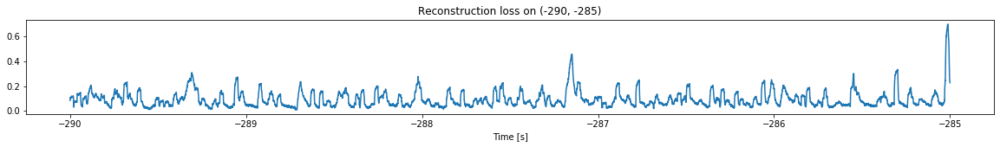

<--------
Entering sections:  (-285, -280)
-------->
Training for section:  (-290, -285)
Finished training, mean of the log(loss) is:  -1.6843775190324417
Triggering for section:  (-285, -280)
Using this mean for triggering: -1.607976594738497


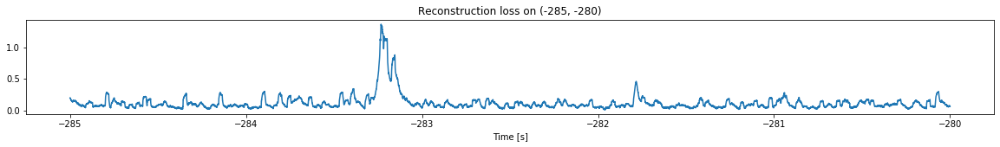

<--------
Entering sections:  (-280, -275)
-------->
Training for section:  (-285, -280)
Finished training, mean of the log(loss) is:  -1.7067912293050918
Triggering for section:  (-280, -275)
Using this mean for triggering: -1.6843775190324417


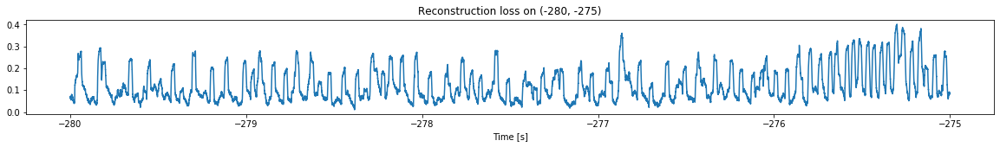

<--------
Entering sections:  (-275, -270)
-------->
Training for section:  (-280, -275)
Finished training, mean of the log(loss) is:  -1.7614609503415735
Triggering for section:  (-275, -270)
Using this mean for triggering: -1.7067912293050918


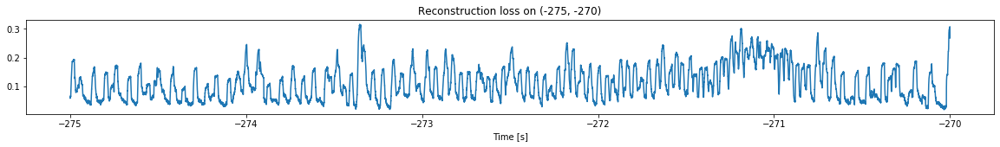

<--------
Entering sections:  (-270, -265)
-------->
Training for section:  (-275, -270)
Finished training, mean of the log(loss) is:  -1.725935123813268
Triggering for section:  (-270, -265)
Using this mean for triggering: -1.7614609503415735


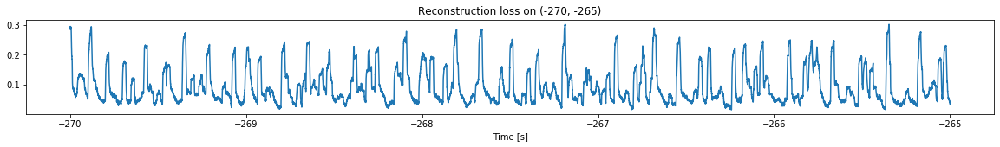

<--------
Entering sections:  (-265, -260)
-------->
Training for section:  (-270, -265)
Finished training, mean of the log(loss) is:  -1.7375350406073924
Triggering for section:  (-265, -260)
Using this mean for triggering: -1.725935123813268


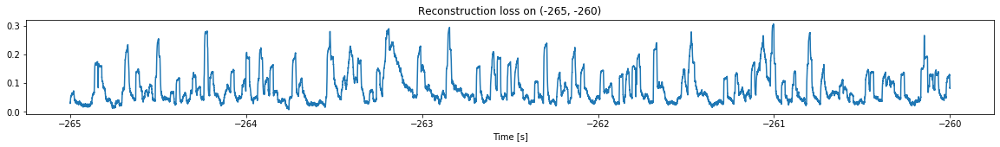

<--------
Entering sections:  (-260, -255)
-------->
Training for section:  (-265, -260)
Finished training, mean of the log(loss) is:  -1.8040092795509808
Triggering for section:  (-260, -255)
Using this mean for triggering: -1.7375350406073924


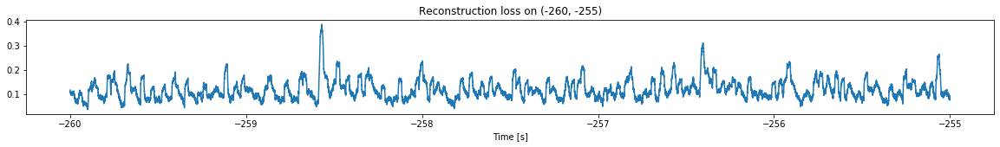

<--------
Entering sections:  (-255, -250)
-------->
Training for section:  (-260, -255)
Finished training, mean of the log(loss) is:  -1.9286551497416342
Triggering for section:  (-255, -250)
Using this mean for triggering: -1.8040092795509808


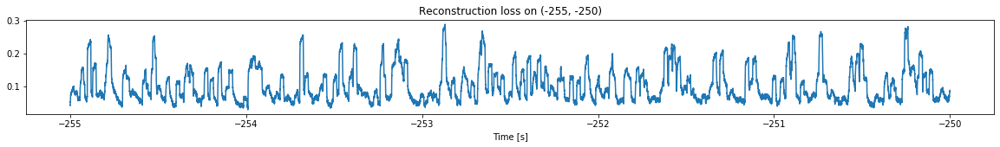

<--------
Entering sections:  (-250, -245)
-------->
Training for section:  (-255, -250)
Finished training, mean of the log(loss) is:  -1.821807770325501
Triggering for section:  (-250, -245)
Using this mean for triggering: -1.9286551497416342


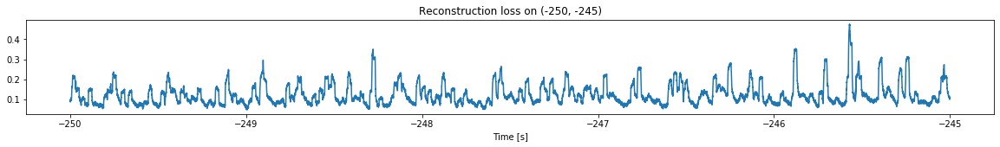

<--------
Entering sections:  (-245, -240)
-------->
Training for section:  (-250, -245)
Finished training, mean of the log(loss) is:  -1.8046040197475974
Triggering for section:  (-245, -240)
Using this mean for triggering: -1.821807770325501


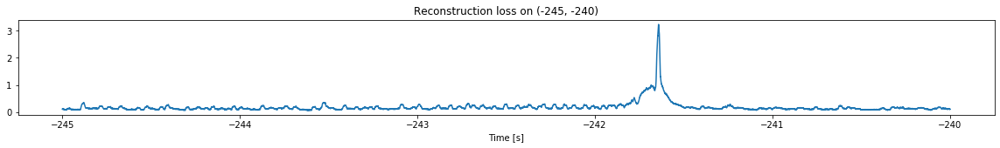

<--------
Entering sections:  (-240, -235)
-------->
Training for section:  (-245, -240)
Finished training, mean of the log(loss) is:  -1.8359345637329758
Triggering for section:  (-240, -235)
Using this mean for triggering: -1.8046040197475974


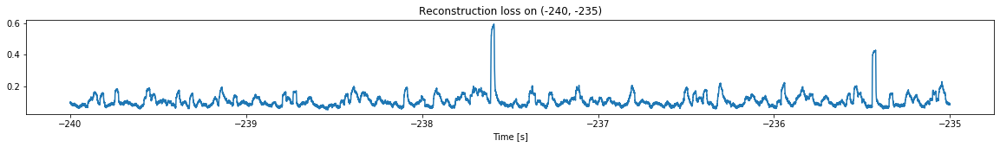

<--------
Entering sections:  (-235, -230)
-------->
Training for section:  (-240, -235)
Finished training, mean of the log(loss) is:  -1.9444970502612076
Triggering for section:  (-235, -230)
Using this mean for triggering: -1.8359345637329758


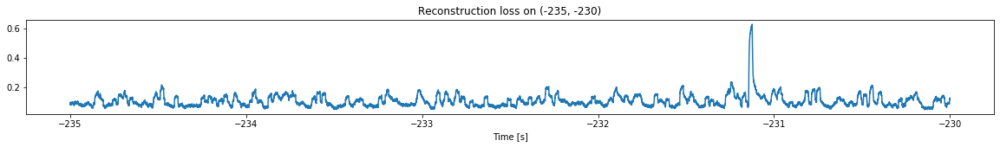

<--------
Entering sections:  (-230, -225)
-------->
Training for section:  (-235, -230)
Finished training, mean of the log(loss) is:  -1.8639942710322295
Triggering for section:  (-230, -225)
Using this mean for triggering: -1.9444970502612076


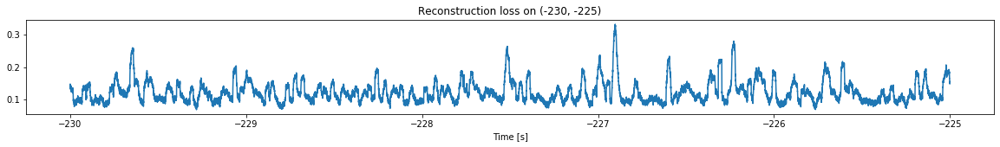

<--------
Entering sections:  (-225, -220)
-------->
Training for section:  (-230, -225)
Finished training, mean of the log(loss) is:  -2.0300803841391577
Triggering for section:  (-225, -220)
Using this mean for triggering: -1.8639942710322295


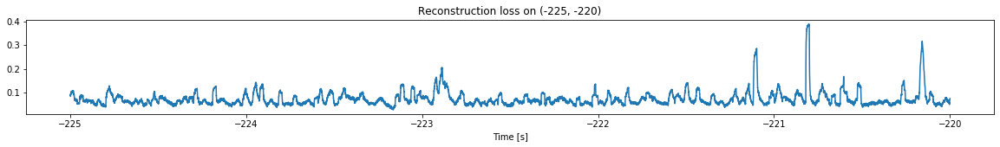

<--------
Entering sections:  (-220, -215)
-------->
Training for section:  (-225, -220)
Finished training, mean of the log(loss) is:  -1.997909973045316
Triggering for section:  (-220, -215)
Using this mean for triggering: -2.0300803841391577


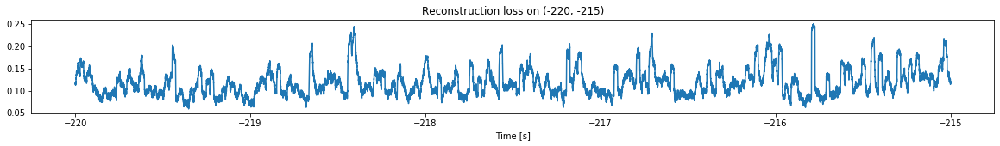

<--------
Entering sections:  (-215, -210)
-------->
Training for section:  (-220, -215)
Finished training, mean of the log(loss) is:  -1.9249109323807923
Triggering for section:  (-215, -210)
Using this mean for triggering: -1.997909973045316


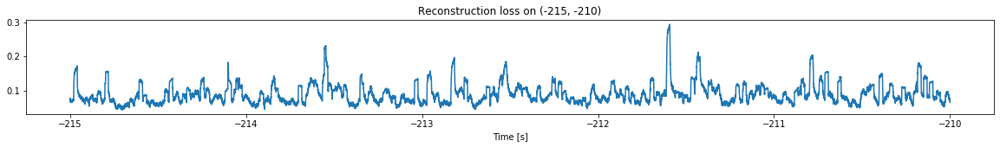

<--------
Entering sections:  (-210, -205)
-------->
Training for section:  (-215, -210)
Finished training, mean of the log(loss) is:  -1.9707000454396515
Triggering for section:  (-210, -205)
Using this mean for triggering: -1.9249109323807923


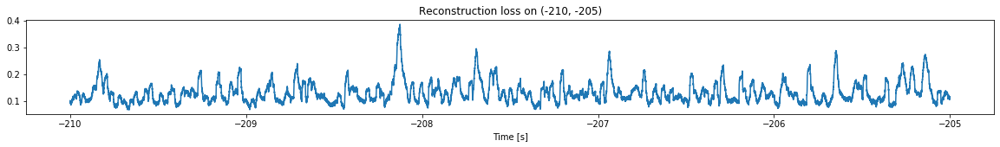

<--------
Entering sections:  (-205, -200)
-------->
Training for section:  (-210, -205)
Finished training, mean of the log(loss) is:  -1.8698172808974114
Triggering for section:  (-205, -200)
Using this mean for triggering: -1.9707000454396515


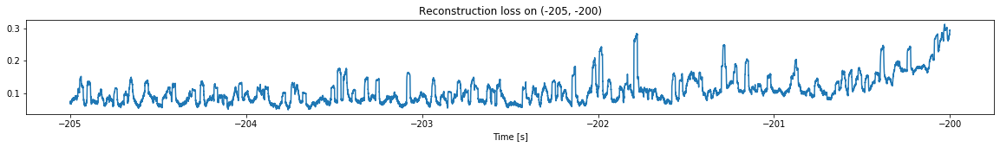

<--------
Entering sections:  (-200, -195)
-------->
Training for section:  (-205, -200)
Finished training, mean of the log(loss) is:  -1.7115318841546832
Triggering for section:  (-200, -195)
Using this mean for triggering: -1.8698172808974114


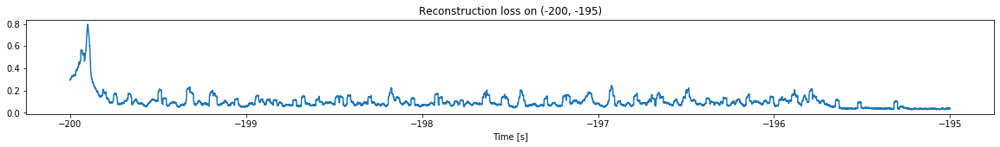

<--------
Entering sections:  (-195, -190)
-------->
Training for section:  (-200, -195)
Finished training, mean of the log(loss) is:  -1.7187627456462784
Triggering for section:  (-195, -190)
Using this mean for triggering: -1.7115318841546832


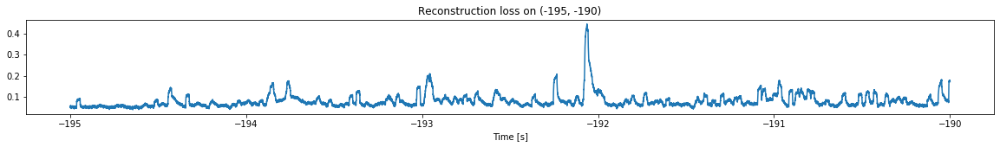

<--------
Entering sections:  (-190, -185)
-------->
Training for section:  (-195, -190)
Finished training, mean of the log(loss) is:  -1.9755887429699825
Triggering for section:  (-190, -185)
Using this mean for triggering: -1.7187627456462784


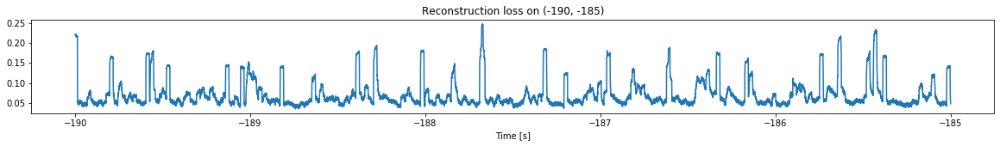

<--------
Entering sections:  (-185, -180)
-------->
Training for section:  (-190, -185)
Finished training, mean of the log(loss) is:  -1.9602279956087176
Triggering for section:  (-185, -180)
Using this mean for triggering: -1.9755887429699825


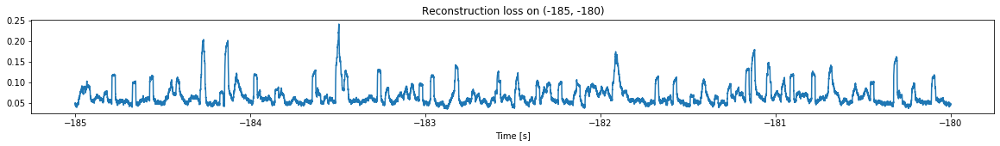

<--------
Entering sections:  (-180, -175)
-------->
Training for section:  (-185, -180)
Finished training, mean of the log(loss) is:  -2.00199665118475
Triggering for section:  (-180, -175)
Using this mean for triggering: -1.9602279956087176


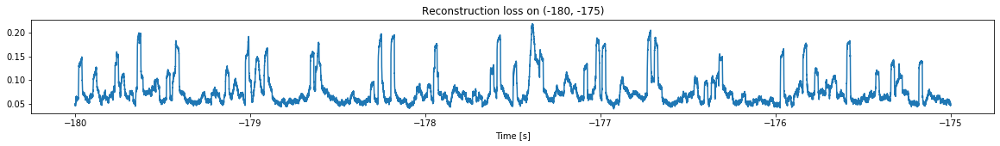

<--------
Entering sections:  (-175, -170)
-------->
Training for section:  (-180, -175)
Finished training, mean of the log(loss) is:  -2.0758067790558847
Triggering for section:  (-175, -170)
Using this mean for triggering: -2.00199665118475


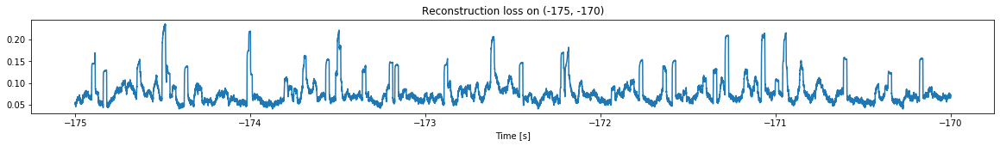

<--------
Entering sections:  (-170, -165)
-------->
Training for section:  (-175, -170)
Finished training, mean of the log(loss) is:  -2.024903883620716
Triggering for section:  (-170, -165)
Using this mean for triggering: -2.0758067790558847


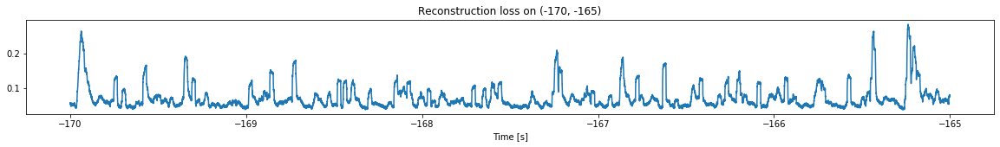

<--------
Entering sections:  (-165, -160)
-------->
Training for section:  (-170, -165)
Finished training, mean of the log(loss) is:  -2.051285087623468
Triggering for section:  (-165, -160)
Using this mean for triggering: -2.024903883620716


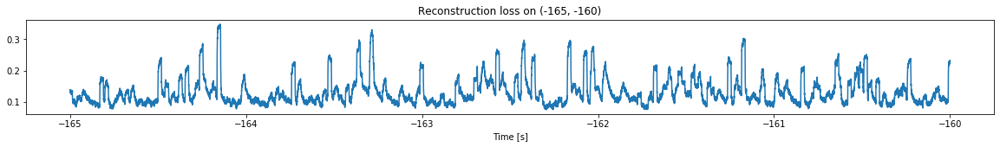

<--------
Entering sections:  (-160, -155)
-------->
Training for section:  (-165, -160)
Finished training, mean of the log(loss) is:  -2.0583201704042673
Triggering for section:  (-160, -155)
Using this mean for triggering: -2.051285087623468


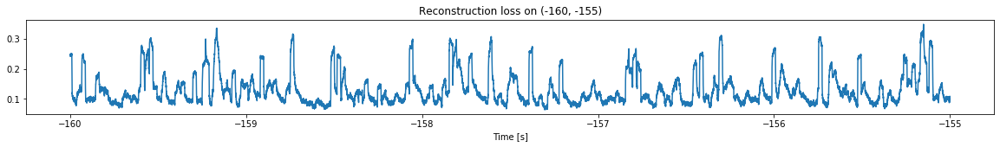

<--------
Entering sections:  (-155, -150)
-------->
Training for section:  (-160, -155)
Finished training, mean of the log(loss) is:  -1.9673418780951266
Triggering for section:  (-155, -150)
Using this mean for triggering: -2.0583201704042673


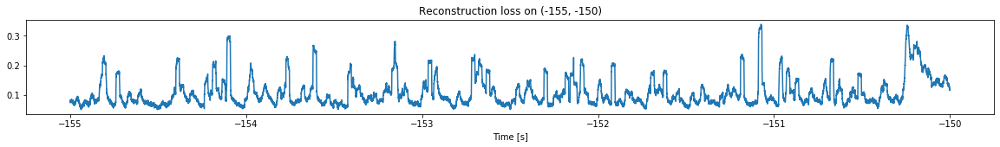

<--------
Entering sections:  (-150, -145)
-------->
Training for section:  (-155, -150)
Finished training, mean of the log(loss) is:  -2.0575937067514474
Triggering for section:  (-150, -145)
Using this mean for triggering: -1.9673418780951266


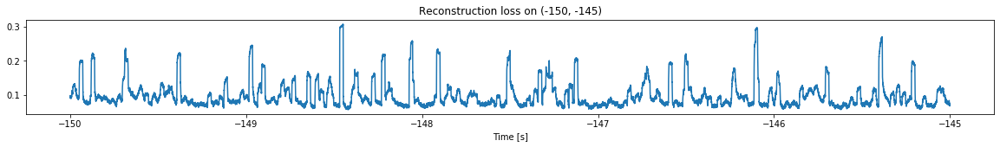

<--------
Entering sections:  (-145, -140)
-------->
Training for section:  (-150, -145)
Finished training, mean of the log(loss) is:  -2.0293557214578017
Triggering for section:  (-145, -140)
Using this mean for triggering: -2.0575937067514474


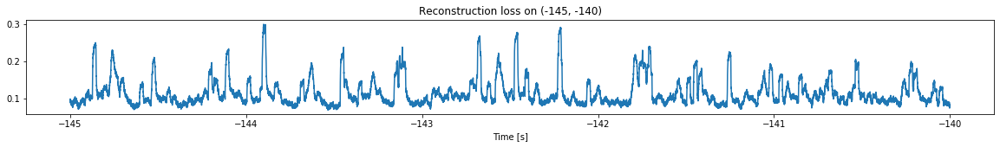

<--------
Entering sections:  (-140, -135)
-------->
Training for section:  (-145, -140)
Finished training, mean of the log(loss) is:  -1.965100862574368
Triggering for section:  (-140, -135)
Using this mean for triggering: -2.0293557214578017


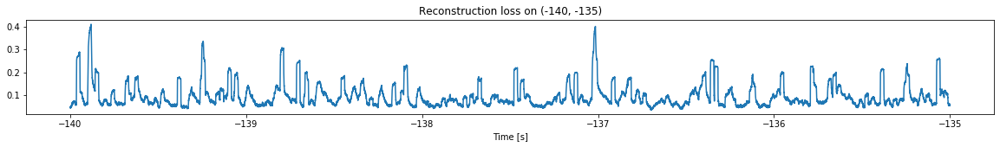

<--------
Entering sections:  (-135, -130)
-------->
Training for section:  (-140, -135)
Finished training, mean of the log(loss) is:  -1.9671720752626978
Triggering for section:  (-135, -130)
Using this mean for triggering: -1.965100862574368


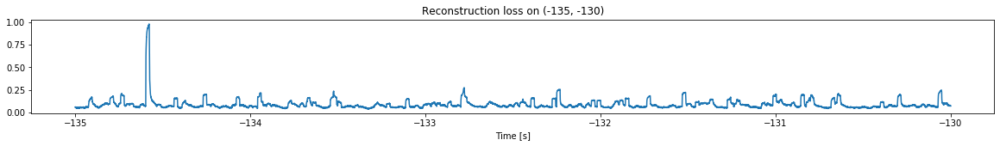

<--------
Entering sections:  (-130, -125)
-------->
Training for section:  (-135, -130)
Finished training, mean of the log(loss) is:  -1.9734484204211507
Triggering for section:  (-130, -125)
Using this mean for triggering: -1.9671720752626978


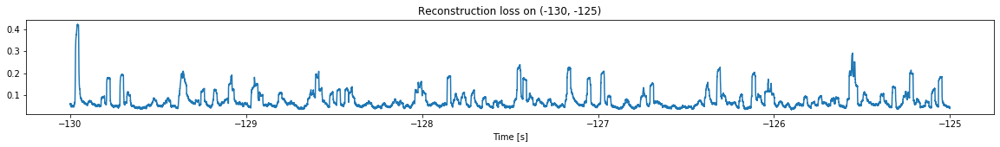

<--------
Entering sections:  (-125, -120)
-------->
Training for section:  (-130, -125)
Finished training, mean of the log(loss) is:  -2.121270844625577
Triggering for section:  (-125, -120)
Using this mean for triggering: -1.9734484204211507


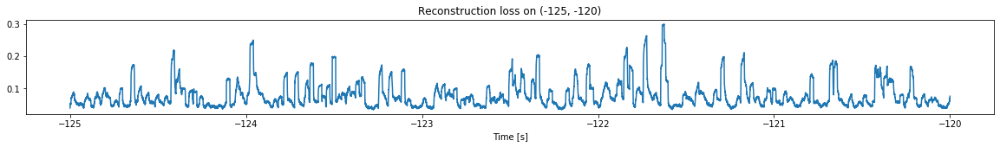

<--------
Entering sections:  (-120, -115)
-------->
Training for section:  (-125, -120)
Finished training, mean of the log(loss) is:  -2.0197451957202435
Triggering for section:  (-120, -115)
Using this mean for triggering: -2.121270844625577


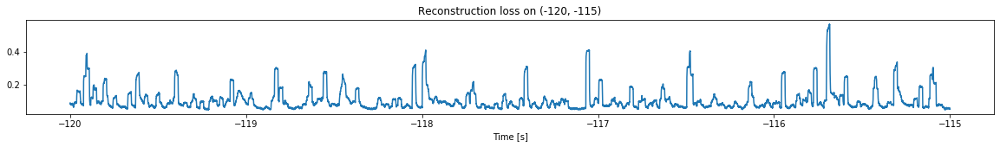

<--------
Entering sections:  (-115, -110)
-------->
Training for section:  (-120, -115)
Finished training, mean of the log(loss) is:  -2.0237460170079267
Triggering for section:  (-115, -110)
Using this mean for triggering: -2.0197451957202435


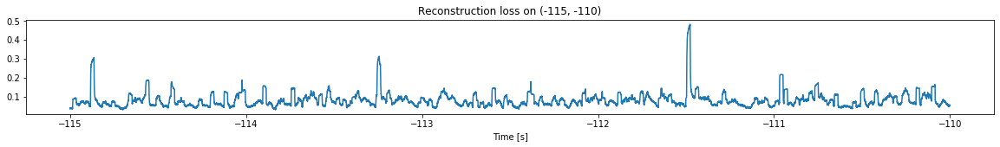

<--------
Entering sections:  (-110, -105)
-------->
Training for section:  (-115, -110)
Finished training, mean of the log(loss) is:  -1.9657041431771631
Triggering for section:  (-110, -105)
Using this mean for triggering: -2.0237460170079267


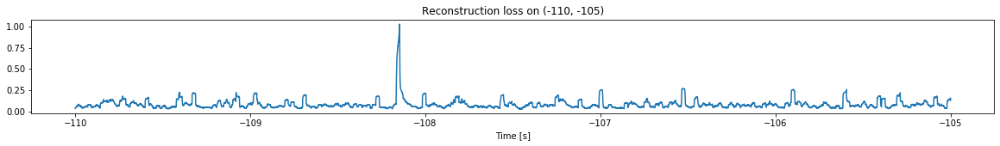

<--------
Entering sections:  (-105, -100)
-------->
Training for section:  (-110, -105)
Finished training, mean of the log(loss) is:  -1.8902191665103656
Triggering for section:  (-105, -100)
Using this mean for triggering: -1.9657041431771631


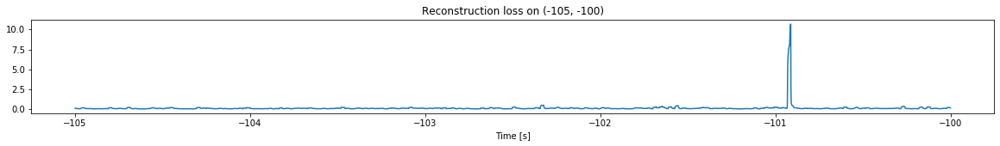

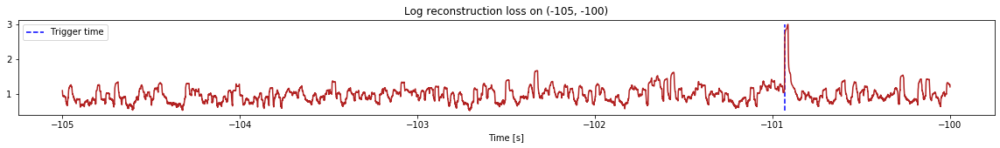

Triggered at:  -100.929985


-100.929985

In [6]:
simulation("./data/Ramp19/", 5, (-300,0))

Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
All data's shape:  (2997500, 12)
Flushing input history
Number of sections: 60
Entering sections:  (-300, -295)
-------->
Entering sections:  (-295, -290)
-------->
Training for section:  (None, -295)
Finished training, mean of the log(loss) is:  -1.5674670260057433
<--------
Entering sections:  (-290, -285)
-------->
Training for section:  (-295, -290)
Finished training, mean of the log(loss) is:  -1.6575007436591265
Triggering for section:  (-290, -285)
Using this mean for triggering: -1.5674670260057433


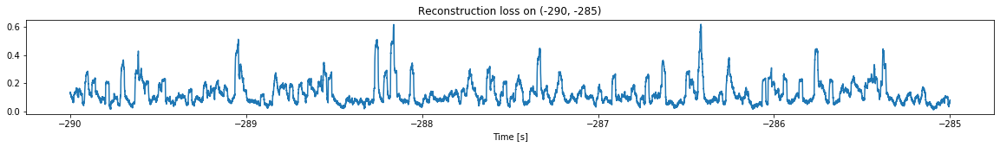

<--------
Entering sections:  (-285, -280)
-------->
Training for section:  (-290, -285)
Finished training, mean of the log(loss) is:  -1.6172246174062739
Triggering for section:  (-285, -280)
Using this mean for triggering: -1.6575007436591265


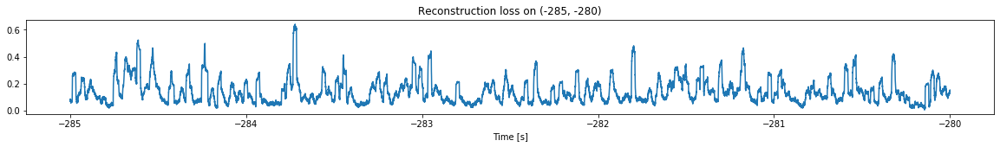

<--------
Entering sections:  (-280, -275)
-------->
Training for section:  (-285, -280)
Finished training, mean of the log(loss) is:  -1.6057511540133769
Triggering for section:  (-280, -275)
Using this mean for triggering: -1.6172246174062739


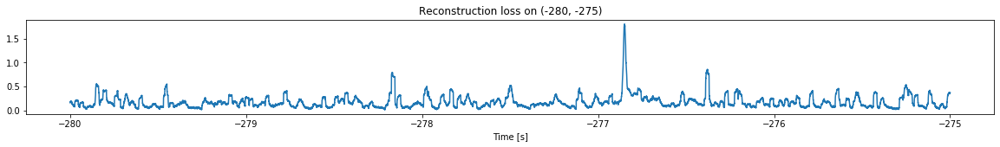

<--------
Entering sections:  (-275, -270)
-------->
Training for section:  (-280, -275)
Finished training, mean of the log(loss) is:  -1.7178900458200583
Triggering for section:  (-275, -270)
Using this mean for triggering: -1.6057511540133769


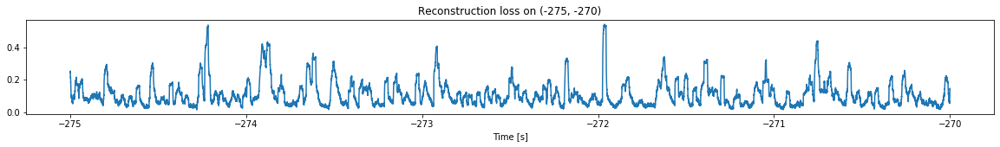

<--------
Entering sections:  (-270, -265)
-------->
Training for section:  (-275, -270)
Finished training, mean of the log(loss) is:  -1.6969155467255743
Triggering for section:  (-270, -265)
Using this mean for triggering: -1.7178900458200583


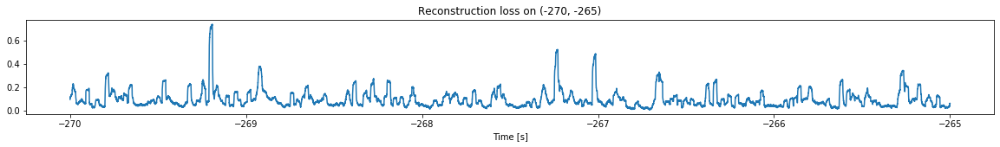

<--------
Entering sections:  (-265, -260)
-------->
Training for section:  (-270, -265)
Finished training, mean of the log(loss) is:  -1.7444952021939995
Triggering for section:  (-265, -260)
Using this mean for triggering: -1.6969155467255743


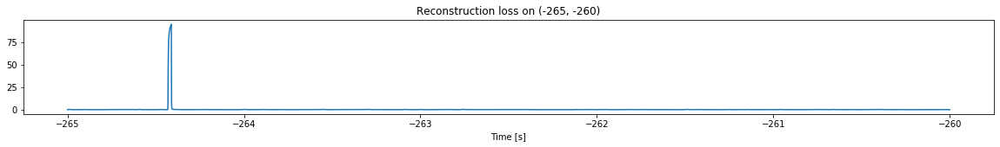

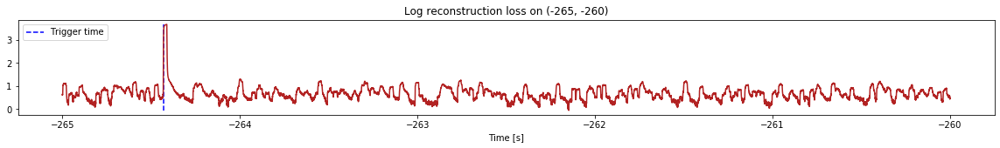

Triggered at:  -264.4308


-264.4308

In [7]:
simulation("./data/Ramp20/", 5, (-300,0))

Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
All data's shape:  (2997500, 12)
Flushing input history
Number of sections: 60
Entering sections:  (-300, -295)
-------->
Entering sections:  (-295, -290)
-------->
Training for section:  (None, -295)
Finished training, mean of the log(loss) is:  -1.58524730593273
<--------
Entering sections:  (-290, -285)
-------->
Training for section:  (-295, -290)
Finished training, mean of the log(loss) is:  -1.5975490770406302
Triggering for section:  (-290, -285)
Using this mean for triggering: -1.58524730593273


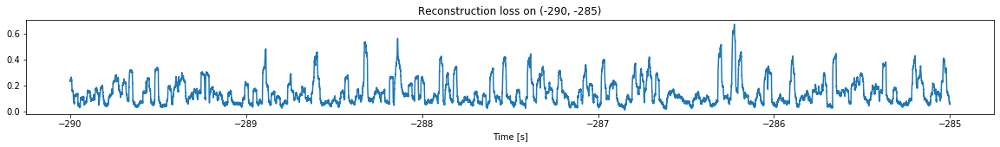

<--------
Entering sections:  (-285, -280)
-------->
Training for section:  (-290, -285)
Finished training, mean of the log(loss) is:  -1.5608859011672953
Triggering for section:  (-285, -280)
Using this mean for triggering: -1.5975490770406302


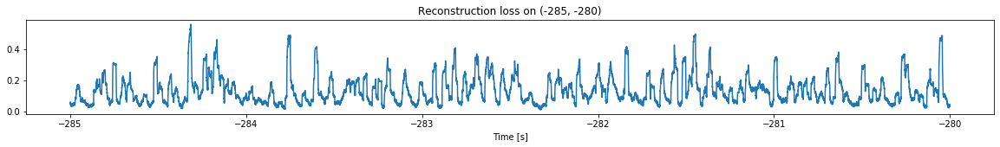

<--------
Entering sections:  (-280, -275)
-------->
Training for section:  (-285, -280)
Finished training, mean of the log(loss) is:  -1.5853530624635193
Triggering for section:  (-280, -275)
Using this mean for triggering: -1.5608859011672953


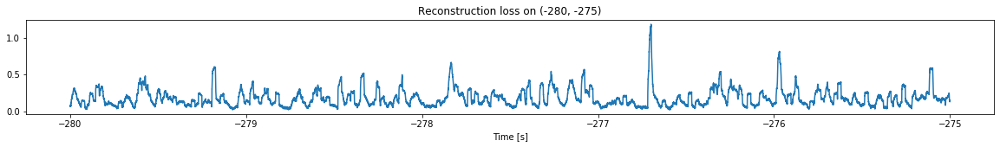

<--------
Entering sections:  (-275, -270)
-------->
Training for section:  (-280, -275)
Finished training, mean of the log(loss) is:  -1.5319694132473223
Triggering for section:  (-275, -270)
Using this mean for triggering: -1.5853530624635193


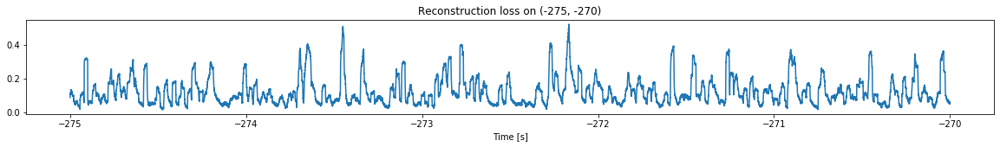

<--------
Entering sections:  (-270, -265)
-------->
Training for section:  (-275, -270)
Finished training, mean of the log(loss) is:  -1.4109351208374916
Triggering for section:  (-270, -265)
Using this mean for triggering: -1.5319694132473223


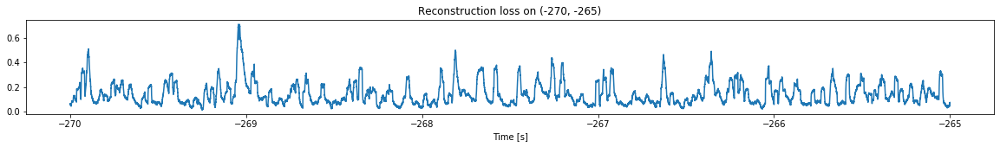

<--------
Entering sections:  (-265, -260)
-------->
Training for section:  (-270, -265)
Finished training, mean of the log(loss) is:  -1.4941982138245946
Triggering for section:  (-265, -260)
Using this mean for triggering: -1.4109351208374916


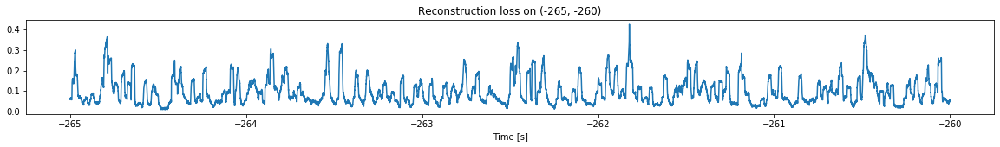

<--------
Entering sections:  (-260, -255)
-------->
Training for section:  (-265, -260)
Finished training, mean of the log(loss) is:  -1.6845800521394718
Triggering for section:  (-260, -255)
Using this mean for triggering: -1.4941982138245946


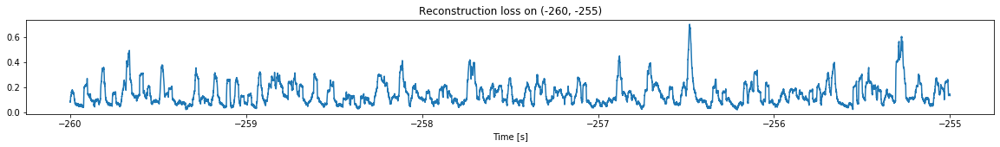

<--------
Entering sections:  (-255, -250)
-------->
Training for section:  (-260, -255)
Finished training, mean of the log(loss) is:  -1.6383819644277886
Triggering for section:  (-255, -250)
Using this mean for triggering: -1.6845800521394718


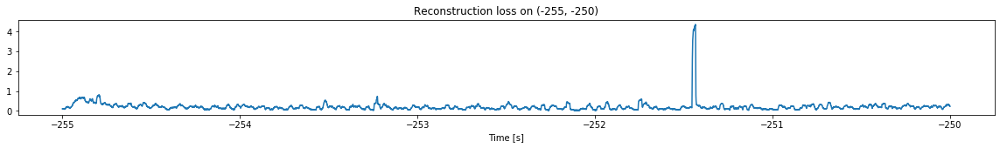

<--------
Entering sections:  (-250, -245)
-------->
Training for section:  (-255, -250)
Finished training, mean of the log(loss) is:  -1.7105824558763219
Triggering for section:  (-250, -245)
Using this mean for triggering: -1.6383819644277886


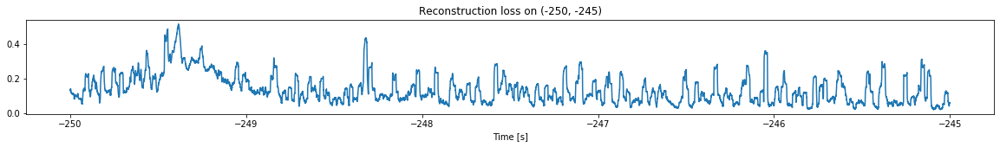

<--------
Entering sections:  (-245, -240)
-------->
Training for section:  (-250, -245)
Finished training, mean of the log(loss) is:  -1.4896485901522316
Triggering for section:  (-245, -240)
Using this mean for triggering: -1.7105824558763219


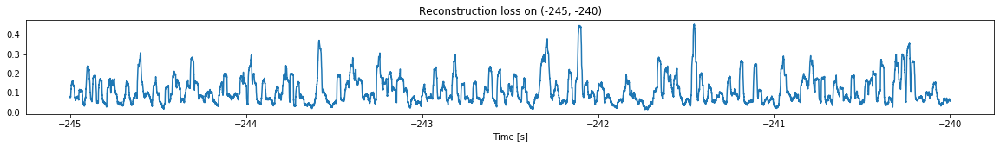

<--------
Entering sections:  (-240, -235)
-------->
Training for section:  (-245, -240)
Finished training, mean of the log(loss) is:  -1.7308257056709087
Triggering for section:  (-240, -235)
Using this mean for triggering: -1.4896485901522316


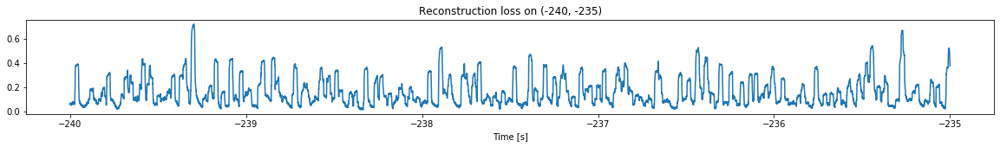

<--------
Entering sections:  (-235, -230)
-------->
Training for section:  (-240, -235)
Finished training, mean of the log(loss) is:  -1.7919669034575878
Triggering for section:  (-235, -230)
Using this mean for triggering: -1.7308257056709087


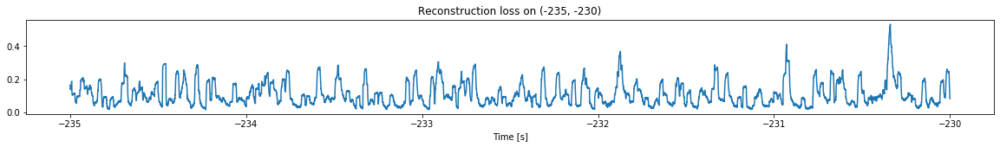

<--------
Entering sections:  (-230, -225)
-------->
Training for section:  (-235, -230)
Finished training, mean of the log(loss) is:  -1.8107738402361109
Triggering for section:  (-230, -225)
Using this mean for triggering: -1.7919669034575878


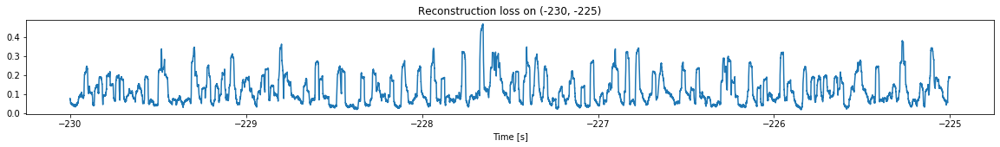

<--------
Entering sections:  (-225, -220)
-------->
Training for section:  (-230, -225)
Finished training, mean of the log(loss) is:  -1.7425099167498361
Triggering for section:  (-225, -220)
Using this mean for triggering: -1.8107738402361109


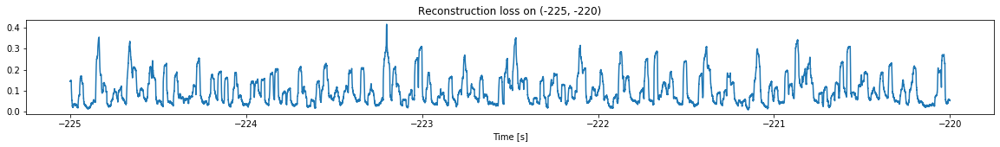

<--------
Entering sections:  (-220, -215)
-------->
Training for section:  (-225, -220)
Finished training, mean of the log(loss) is:  -1.7681783624862981
Triggering for section:  (-220, -215)
Using this mean for triggering: -1.7425099167498361


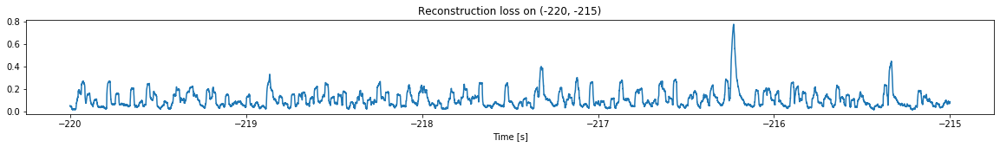

<--------
Entering sections:  (-215, -210)
-------->
Training for section:  (-220, -215)
Finished training, mean of the log(loss) is:  -1.7718911841246667
Triggering for section:  (-215, -210)
Using this mean for triggering: -1.7681783624862981


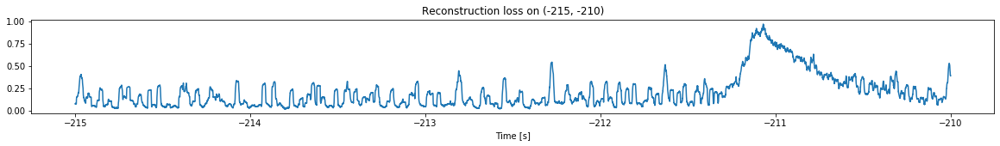

<--------
Entering sections:  (-210, -205)
-------->
Training for section:  (-215, -210)
Finished training, mean of the log(loss) is:  -1.631097554666702
Triggering for section:  (-210, -205)
Using this mean for triggering: -1.7718911841246667


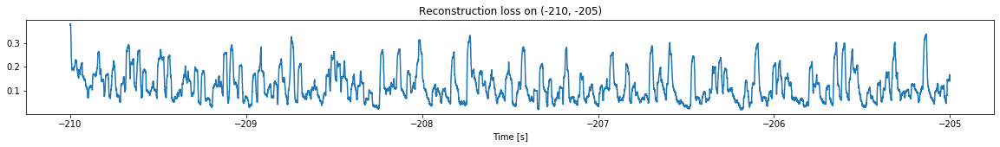

<--------
Entering sections:  (-205, -200)
-------->
Training for section:  (-210, -205)
Finished training, mean of the log(loss) is:  -1.708490144907447
Triggering for section:  (-205, -200)
Using this mean for triggering: -1.631097554666702


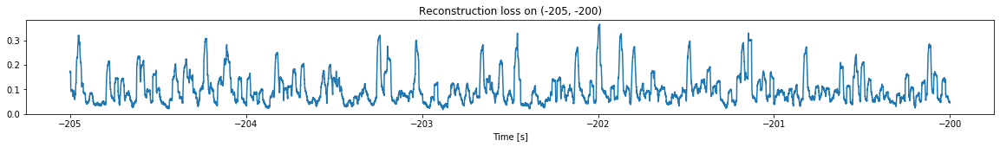

<--------
Entering sections:  (-200, -195)
-------->
Training for section:  (-205, -200)
Finished training, mean of the log(loss) is:  -1.8043593021049344
Triggering for section:  (-200, -195)
Using this mean for triggering: -1.708490144907447


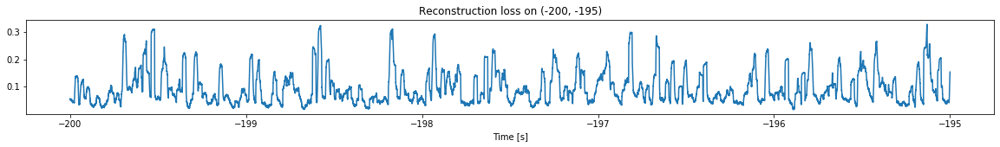

<--------
Entering sections:  (-195, -190)
-------->
Training for section:  (-200, -195)
Finished training, mean of the log(loss) is:  -1.7485727175435577
Triggering for section:  (-195, -190)
Using this mean for triggering: -1.8043593021049344


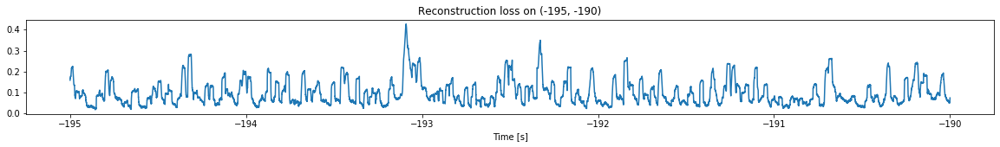

<--------
Entering sections:  (-190, -185)
-------->
Training for section:  (-195, -190)
Finished training, mean of the log(loss) is:  -1.7809804424104558
Triggering for section:  (-190, -185)
Using this mean for triggering: -1.7485727175435577


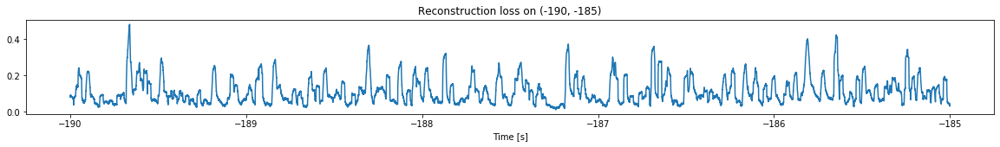

<--------
Entering sections:  (-185, -180)
-------->
Training for section:  (-190, -185)
Finished training, mean of the log(loss) is:  -1.7787001998630092
Triggering for section:  (-185, -180)
Using this mean for triggering: -1.7809804424104558


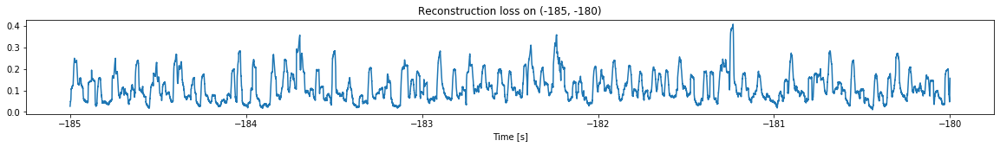

<--------
Entering sections:  (-180, -175)
-------->
Training for section:  (-185, -180)
Finished training, mean of the log(loss) is:  -1.7368899346689015
Triggering for section:  (-180, -175)
Using this mean for triggering: -1.7787001998630092


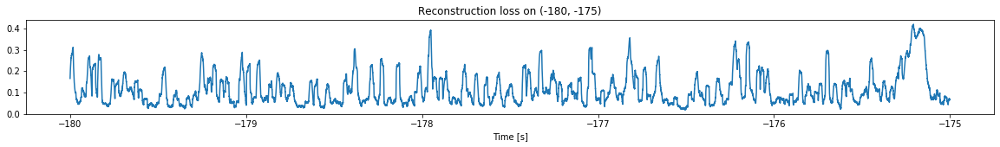

<--------
Entering sections:  (-175, -170)
-------->
Training for section:  (-180, -175)
Finished training, mean of the log(loss) is:  -1.708346828392601
Triggering for section:  (-175, -170)
Using this mean for triggering: -1.7368899346689015


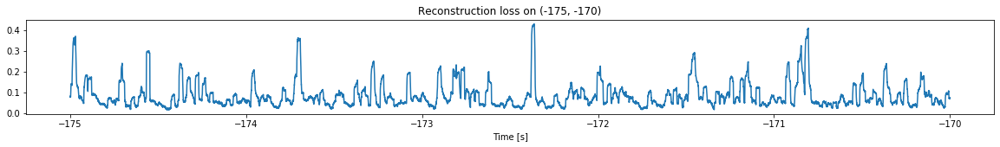

<--------
Entering sections:  (-170, -165)
-------->
Training for section:  (-175, -170)
Finished training, mean of the log(loss) is:  -1.7982432860470274
Triggering for section:  (-170, -165)
Using this mean for triggering: -1.708346828392601


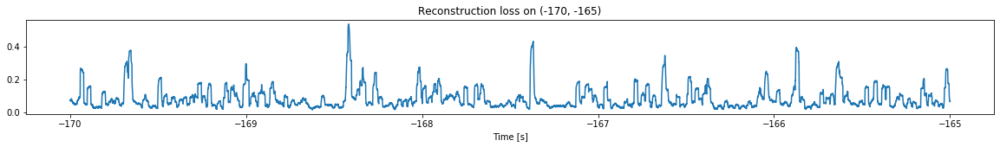

<--------
Entering sections:  (-165, -160)
-------->
Training for section:  (-170, -165)
Finished training, mean of the log(loss) is:  -1.8367558897851755
Triggering for section:  (-165, -160)
Using this mean for triggering: -1.7982432860470274


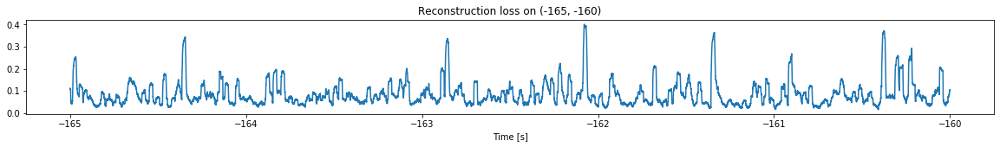

<--------
Entering sections:  (-160, -155)
-------->
Training for section:  (-165, -160)
Finished training, mean of the log(loss) is:  -1.9242620797150738
Triggering for section:  (-160, -155)
Using this mean for triggering: -1.8367558897851755


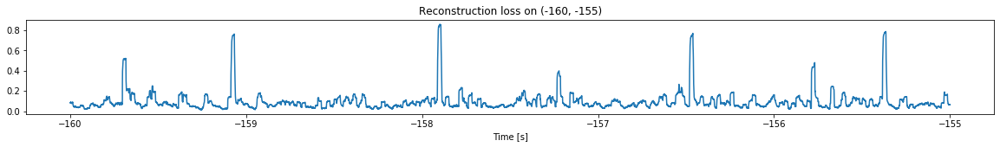

<--------
Entering sections:  (-155, -150)
-------->
Training for section:  (-160, -155)
Finished training, mean of the log(loss) is:  -1.8933729050168995
Triggering for section:  (-155, -150)
Using this mean for triggering: -1.9242620797150738


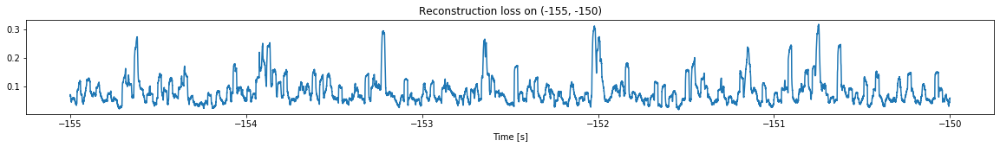

<--------
Entering sections:  (-150, -145)
-------->
Training for section:  (-155, -150)
Finished training, mean of the log(loss) is:  -1.8627238626154679
Triggering for section:  (-150, -145)
Using this mean for triggering: -1.8933729050168995


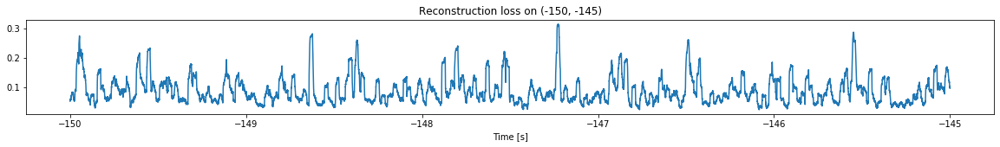

<--------
Entering sections:  (-145, -140)
-------->
Training for section:  (-150, -145)
Finished training, mean of the log(loss) is:  -1.785438629329719
Triggering for section:  (-145, -140)
Using this mean for triggering: -1.8627238626154679


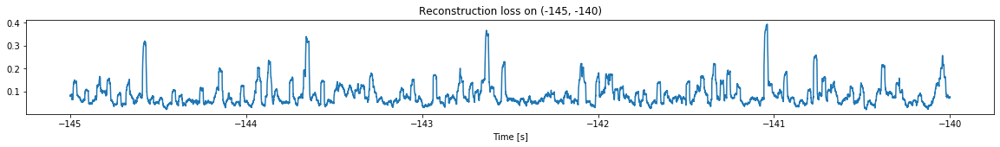

<--------
Entering sections:  (-140, -135)
-------->
Training for section:  (-145, -140)
Finished training, mean of the log(loss) is:  -1.83618861399035
Triggering for section:  (-140, -135)
Using this mean for triggering: -1.785438629329719


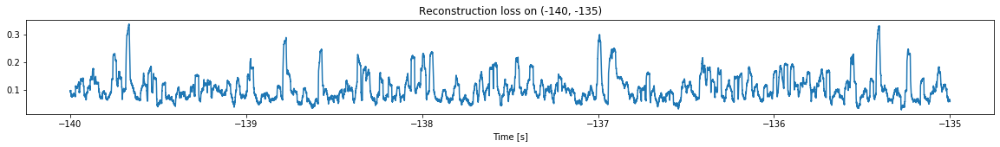

<--------
Entering sections:  (-135, -130)
-------->
Training for section:  (-140, -135)
Finished training, mean of the log(loss) is:  -1.7964640311278797
Triggering for section:  (-135, -130)
Using this mean for triggering: -1.83618861399035


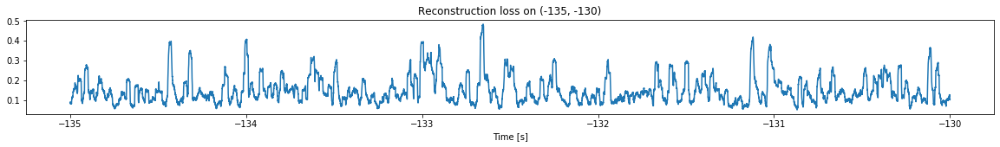

<--------
Entering sections:  (-130, -125)
-------->
Training for section:  (-135, -130)
Finished training, mean of the log(loss) is:  -1.7539004949272243
Triggering for section:  (-130, -125)
Using this mean for triggering: -1.7964640311278797


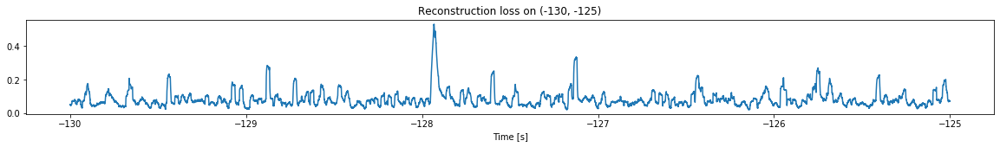

<--------
Entering sections:  (-125, -120)
-------->
Training for section:  (-130, -125)
Finished training, mean of the log(loss) is:  -1.7424576204345668
Triggering for section:  (-125, -120)
Using this mean for triggering: -1.7539004949272243


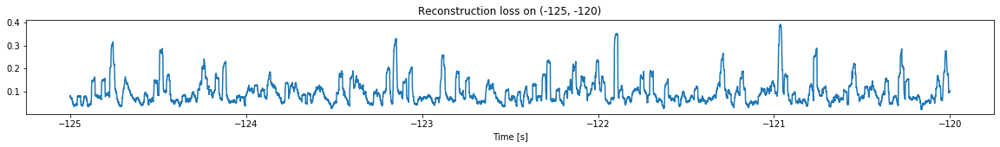

<--------
Entering sections:  (-120, -115)
-------->
Training for section:  (-125, -120)
Finished training, mean of the log(loss) is:  -1.7747114813623797
Triggering for section:  (-120, -115)
Using this mean for triggering: -1.7424576204345668


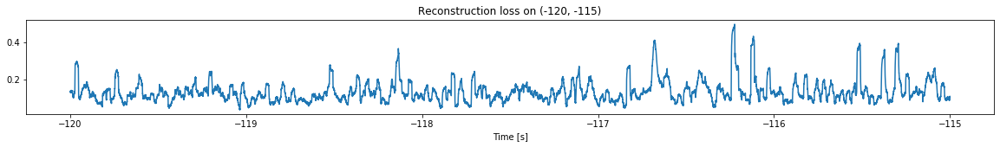

<--------
Entering sections:  (-115, -110)
-------->
Training for section:  (-120, -115)
Finished training, mean of the log(loss) is:  -1.8445235847548807
Triggering for section:  (-115, -110)
Using this mean for triggering: -1.7747114813623797


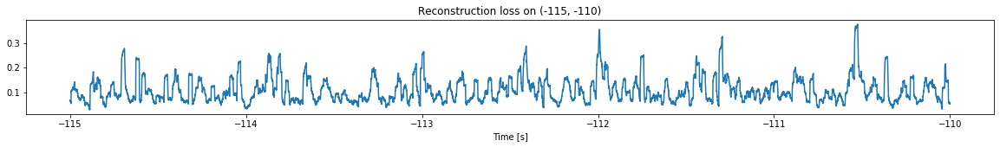

<--------
Entering sections:  (-110, -105)
-------->
Training for section:  (-115, -110)
Finished training, mean of the log(loss) is:  -1.8208290180031494
Triggering for section:  (-110, -105)
Using this mean for triggering: -1.8445235847548807


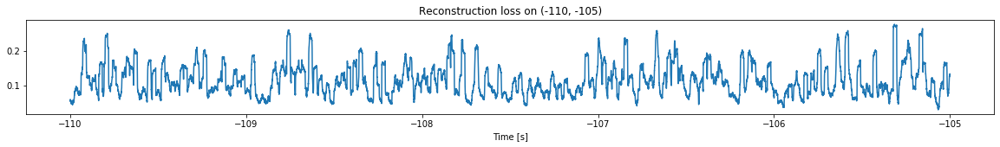

<--------
Entering sections:  (-105, -100)
-------->
Training for section:  (-110, -105)
Finished training, mean of the log(loss) is:  -1.748849528240919
Triggering for section:  (-105, -100)
Using this mean for triggering: -1.8208290180031494


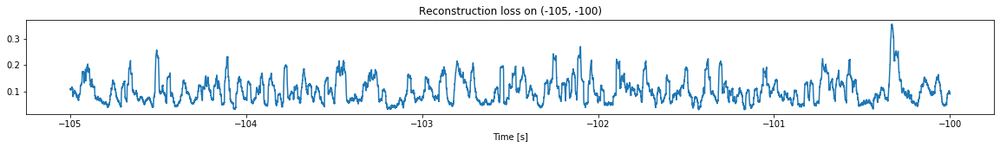

<--------
Entering sections:  (-100, -95)
-------->
Training for section:  (-105, -100)
Finished training, mean of the log(loss) is:  -1.8634486238535544
Triggering for section:  (-100, -95)
Using this mean for triggering: -1.748849528240919


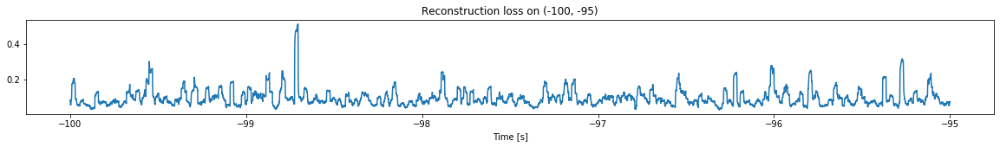

<--------
Entering sections:  (-95, -90)
-------->
Training for section:  (-100, -95)
Finished training, mean of the log(loss) is:  -1.7821669552509827
Triggering for section:  (-95, -90)
Using this mean for triggering: -1.8634486238535544


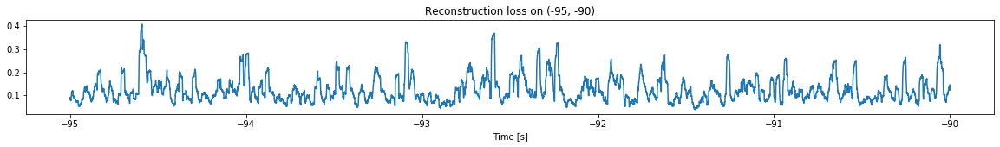

<--------
Entering sections:  (-90, -85)
-------->
Training for section:  (-95, -90)
Finished training, mean of the log(loss) is:  -1.7783757353080483
Triggering for section:  (-90, -85)
Using this mean for triggering: -1.7821669552509827


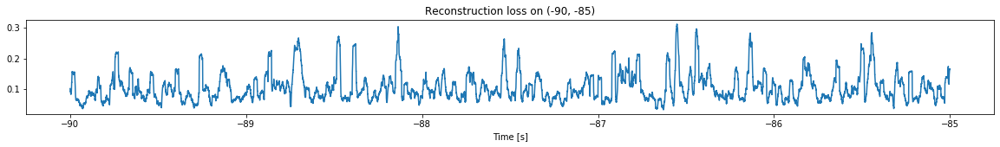

<--------
Entering sections:  (-85, -80)
-------->
Training for section:  (-90, -85)
Finished training, mean of the log(loss) is:  -1.7248554731060048
Triggering for section:  (-85, -80)
Using this mean for triggering: -1.7783757353080483


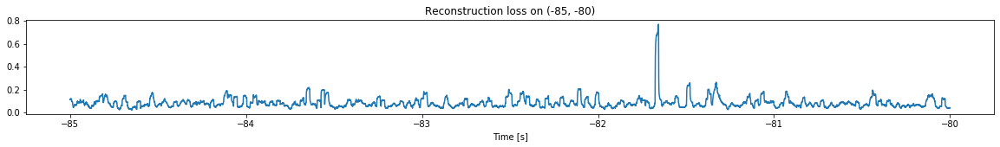

<--------
Entering sections:  (-80, -75)
-------->
Training for section:  (-85, -80)
Finished training, mean of the log(loss) is:  -1.7217286840428252
Triggering for section:  (-80, -75)
Using this mean for triggering: -1.7248554731060048


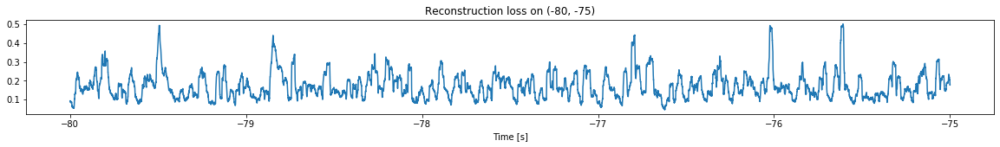

<--------
Entering sections:  (-75, -70)
-------->
Training for section:  (-80, -75)
Finished training, mean of the log(loss) is:  -1.7180017672606431
Triggering for section:  (-75, -70)
Using this mean for triggering: -1.7217286840428252


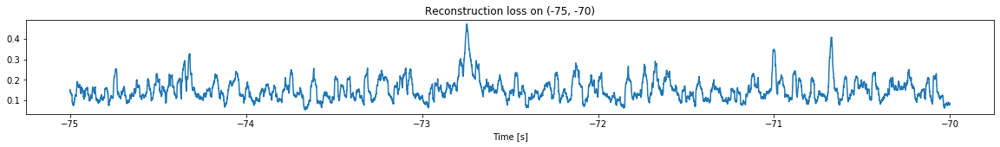

<--------
Entering sections:  (-70, -65)
-------->
Training for section:  (-75, -70)
Finished training, mean of the log(loss) is:  -1.7761219826964365
Triggering for section:  (-70, -65)
Using this mean for triggering: -1.7180017672606431


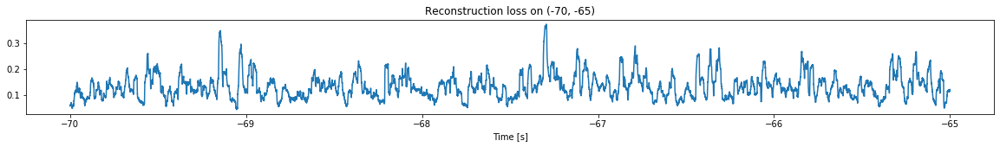

<--------
Entering sections:  (-65, -60)
-------->
Training for section:  (-70, -65)
Finished training, mean of the log(loss) is:  -1.7776985706680697
Triggering for section:  (-65, -60)
Using this mean for triggering: -1.7761219826964365


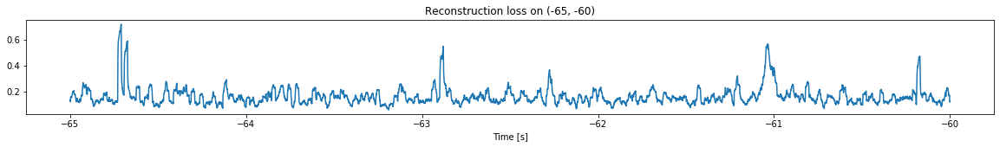

<--------
Entering sections:  (-60, -55)
-------->
Training for section:  (-65, -60)
Finished training, mean of the log(loss) is:  -1.7593928578072942
Triggering for section:  (-60, -55)
Using this mean for triggering: -1.7776985706680697


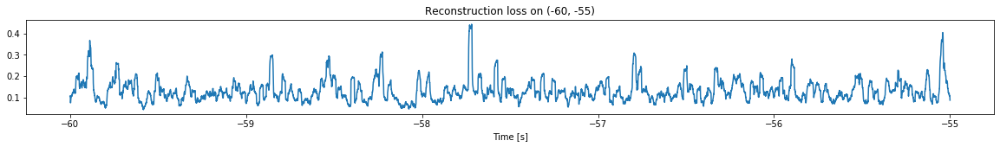

<--------
Entering sections:  (-55, -50)
-------->
Training for section:  (-60, -55)
Finished training, mean of the log(loss) is:  -1.689464867928336
Triggering for section:  (-55, -50)
Using this mean for triggering: -1.7593928578072942


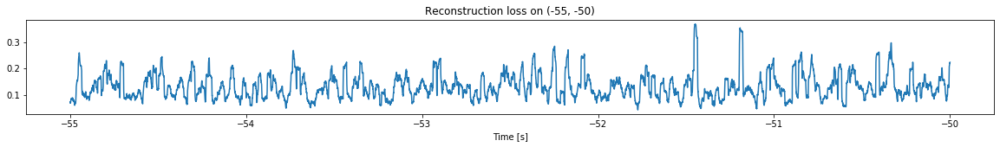

<--------
Entering sections:  (-50, -45)
-------->
Training for section:  (-55, -50)
Finished training, mean of the log(loss) is:  -1.717287467125065
Triggering for section:  (-50, -45)
Using this mean for triggering: -1.689464867928336


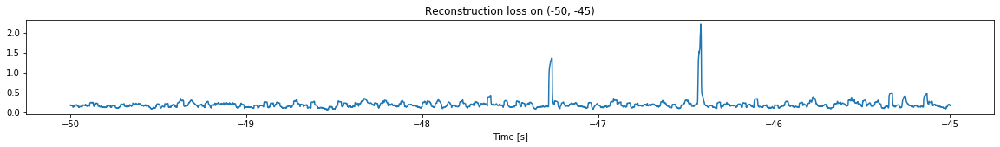

<--------
Entering sections:  (-45, -40)
-------->
Training for section:  (-50, -45)
Finished training, mean of the log(loss) is:  -1.7233101549996603
Triggering for section:  (-45, -40)
Using this mean for triggering: -1.717287467125065


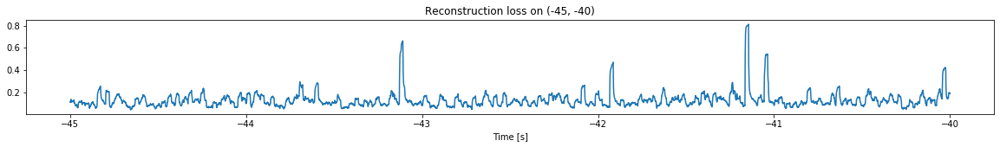

<--------
Entering sections:  (-40, -35)
-------->
Training for section:  (-45, -40)
Finished training, mean of the log(loss) is:  -1.7139294380616903
Triggering for section:  (-40, -35)
Using this mean for triggering: -1.7233101549996603


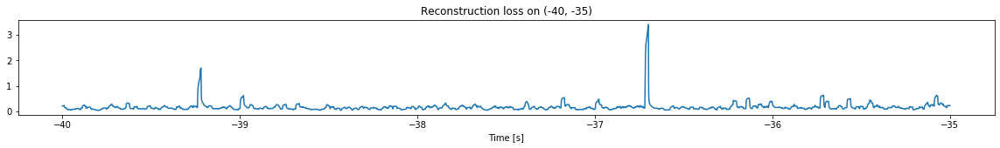

<--------
Entering sections:  (-35, -30)
-------->
Training for section:  (-40, -35)
Finished training, mean of the log(loss) is:  -1.7830896059100336
Triggering for section:  (-35, -30)
Using this mean for triggering: -1.7139294380616903


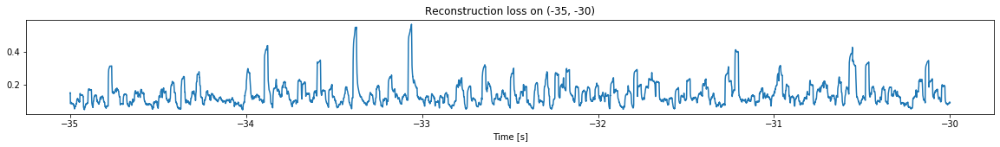

<--------
Entering sections:  (-30, -25)
-------->
Training for section:  (-35, -30)
Finished training, mean of the log(loss) is:  -1.764883776371359
Triggering for section:  (-30, -25)
Using this mean for triggering: -1.7830896059100336


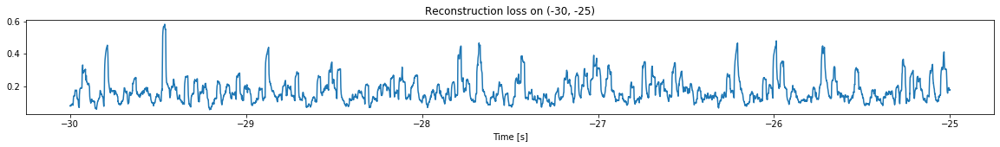

<--------
Entering sections:  (-25, -20)
-------->
Training for section:  (-30, -25)
Finished training, mean of the log(loss) is:  -1.777478505251084
Triggering for section:  (-25, -20)
Using this mean for triggering: -1.764883776371359


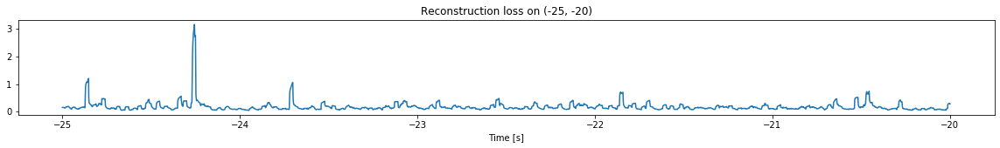

<--------
Entering sections:  (-20, -15)
-------->
Training for section:  (-25, -20)
Finished training, mean of the log(loss) is:  -1.872527755558564
Triggering for section:  (-20, -15)
Using this mean for triggering: -1.777478505251084


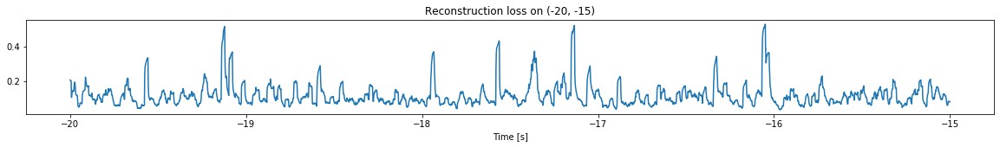

<--------
Entering sections:  (-15, -10)
-------->
Training for section:  (-20, -15)
Finished training, mean of the log(loss) is:  -1.8843759277149654
Triggering for section:  (-15, -10)
Using this mean for triggering: -1.872527755558564


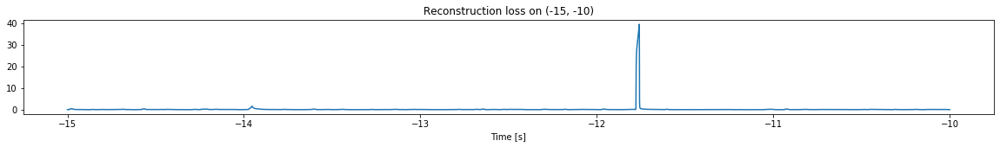

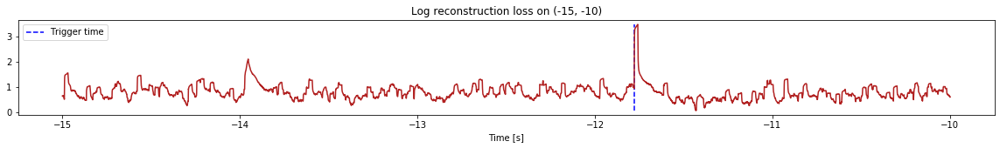

Triggered at:  -11.77769


-11.77769

In [8]:
simulation("./data/Ramp21/", 5, (-300,0))

Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
All data's shape:  (2997500, 12)
Flushing input history
Number of sections: 60
Entering sections:  (-300, -295)
-------->
Entering sections:  (-295, -290)
-------->
Training for section:  (None, -295)
Finished training, mean of the log(loss) is:  -1.4688068284155529
<--------
Entering sections:  (-290, -285)
-------->
Training for section:  (-295, -290)
Finished training, mean of the log(loss) is:  -1.6010105952795324
Triggering for section:  (-290, -285)
Using this mean for triggering: -1.4688068284155529


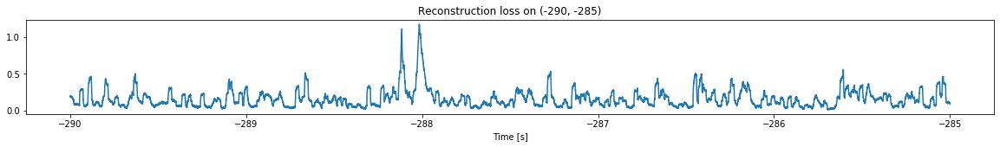

<--------
Entering sections:  (-285, -280)
-------->
Training for section:  (-290, -285)
Finished training, mean of the log(loss) is:  -1.6471919908495156
Triggering for section:  (-285, -280)
Using this mean for triggering: -1.6010105952795324


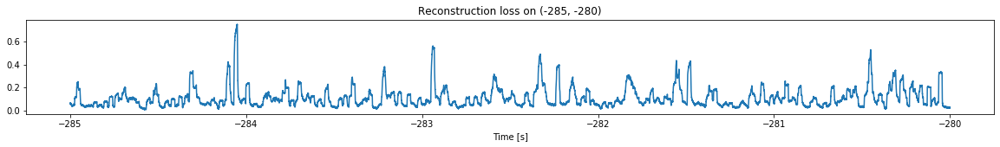

<--------
Entering sections:  (-280, -275)
-------->
Training for section:  (-285, -280)
Finished training, mean of the log(loss) is:  -1.657917720840111
Triggering for section:  (-280, -275)
Using this mean for triggering: -1.6471919908495156


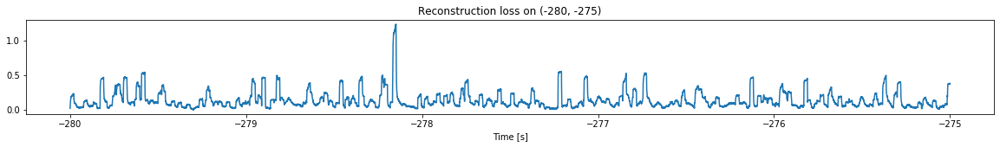

<--------
Entering sections:  (-275, -270)
-------->
Training for section:  (-280, -275)
Finished training, mean of the log(loss) is:  -1.715163830209859
Triggering for section:  (-275, -270)
Using this mean for triggering: -1.657917720840111


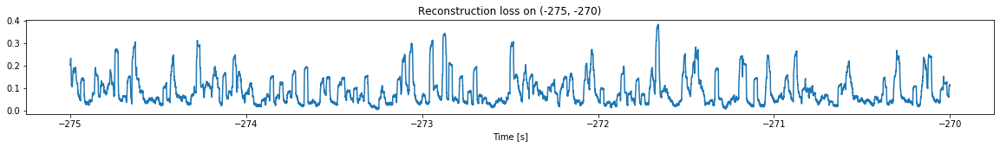

<--------
Entering sections:  (-270, -265)
-------->
Training for section:  (-275, -270)
Finished training, mean of the log(loss) is:  -1.7536574728179313
Triggering for section:  (-270, -265)
Using this mean for triggering: -1.715163830209859


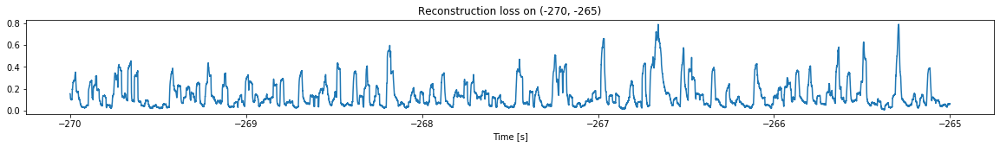

<--------
Entering sections:  (-265, -260)
-------->
Training for section:  (-270, -265)
Finished training, mean of the log(loss) is:  -1.6723435055177773
Triggering for section:  (-265, -260)
Using this mean for triggering: -1.7536574728179313


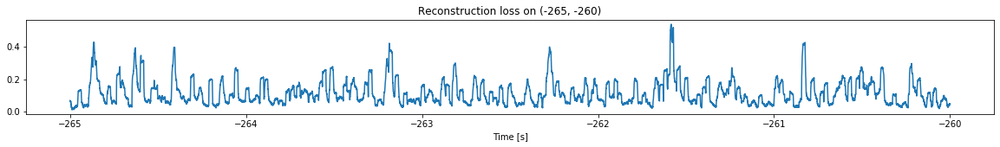

<--------
Entering sections:  (-260, -255)
-------->
Training for section:  (-265, -260)
Finished training, mean of the log(loss) is:  -1.714710961577858
Triggering for section:  (-260, -255)
Using this mean for triggering: -1.6723435055177773


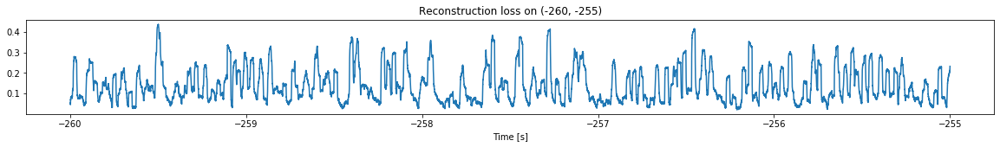

<--------
Entering sections:  (-255, -250)
-------->
Training for section:  (-260, -255)
Finished training, mean of the log(loss) is:  -1.798336944488522
Triggering for section:  (-255, -250)
Using this mean for triggering: -1.714710961577858


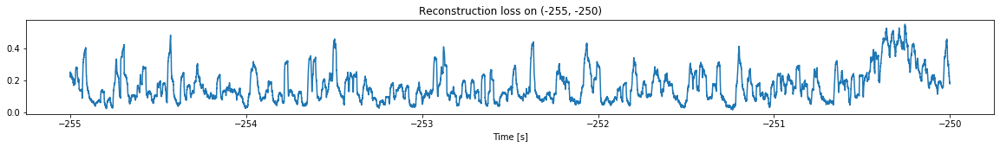

<--------
Entering sections:  (-250, -245)
-------->
Training for section:  (-255, -250)
Finished training, mean of the log(loss) is:  -1.7499369537433136
Triggering for section:  (-250, -245)
Using this mean for triggering: -1.798336944488522


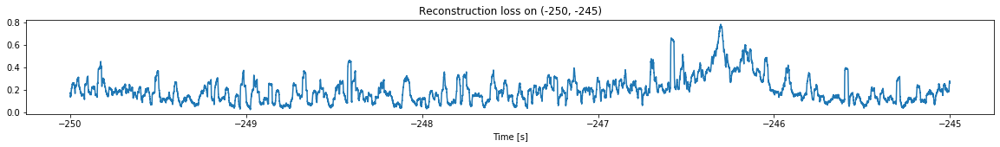

<--------
Entering sections:  (-245, -240)
-------->
Training for section:  (-250, -245)
Finished training, mean of the log(loss) is:  -1.64541150003889
Triggering for section:  (-245, -240)
Using this mean for triggering: -1.7499369537433136


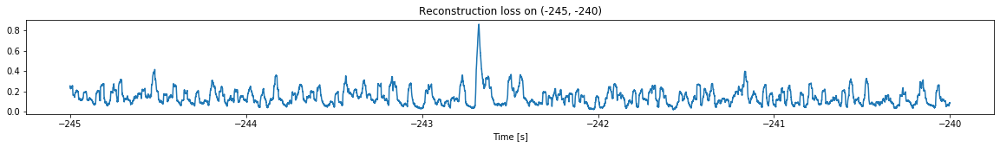

<--------
Entering sections:  (-240, -235)
-------->
Training for section:  (-245, -240)
Finished training, mean of the log(loss) is:  -1.7258741659452217
Triggering for section:  (-240, -235)
Using this mean for triggering: -1.64541150003889


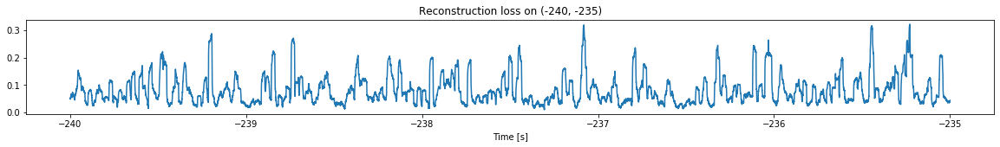

<--------
Entering sections:  (-235, -230)
-------->
Training for section:  (-240, -235)
Finished training, mean of the log(loss) is:  -1.8169669320568191
Triggering for section:  (-235, -230)
Using this mean for triggering: -1.7258741659452217


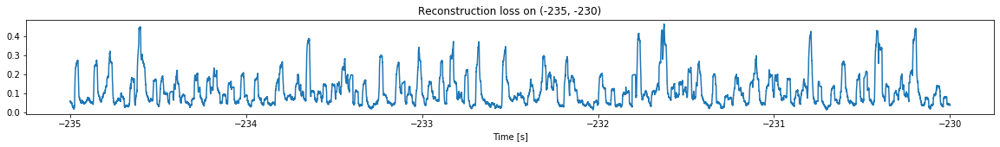

<--------
Entering sections:  (-230, -225)
-------->
Training for section:  (-235, -230)
Finished training, mean of the log(loss) is:  -1.7433325867498066
Triggering for section:  (-230, -225)
Using this mean for triggering: -1.8169669320568191


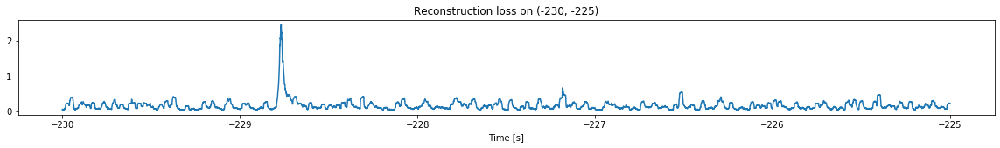

<--------
Entering sections:  (-225, -220)
-------->
Training for section:  (-230, -225)
Finished training, mean of the log(loss) is:  -1.7750130915292388
Triggering for section:  (-225, -220)
Using this mean for triggering: -1.7433325867498066


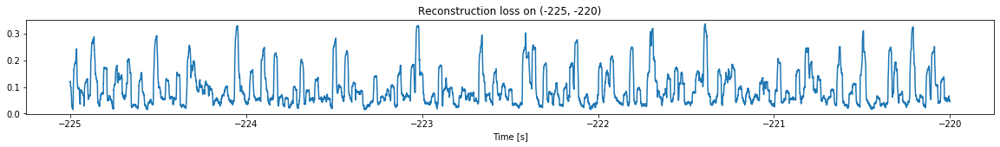

<--------
Entering sections:  (-220, -215)
-------->
Training for section:  (-225, -220)
Finished training, mean of the log(loss) is:  -1.796385405507671
Triggering for section:  (-220, -215)
Using this mean for triggering: -1.7750130915292388


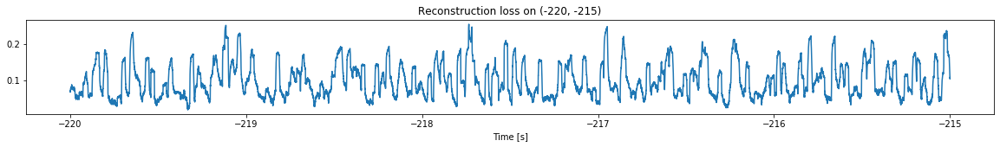

<--------
Entering sections:  (-215, -210)
-------->
Training for section:  (-220, -215)
Finished training, mean of the log(loss) is:  -1.7420055356309214
Triggering for section:  (-215, -210)
Using this mean for triggering: -1.796385405507671


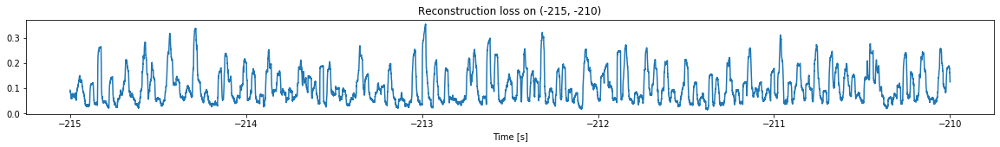

<--------
Entering sections:  (-210, -205)
-------->
Training for section:  (-215, -210)
Finished training, mean of the log(loss) is:  -1.6979330603384817
Triggering for section:  (-210, -205)
Using this mean for triggering: -1.7420055356309214


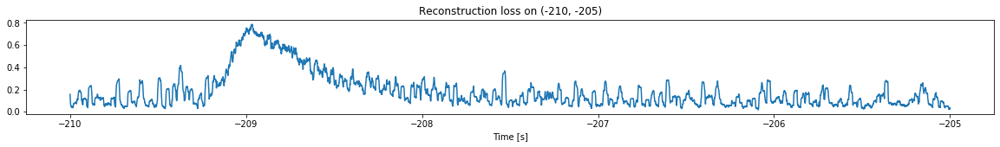

<--------
Entering sections:  (-205, -200)
-------->
Training for section:  (-210, -205)
Finished training, mean of the log(loss) is:  -1.577458799526307
Triggering for section:  (-205, -200)
Using this mean for triggering: -1.6979330603384817


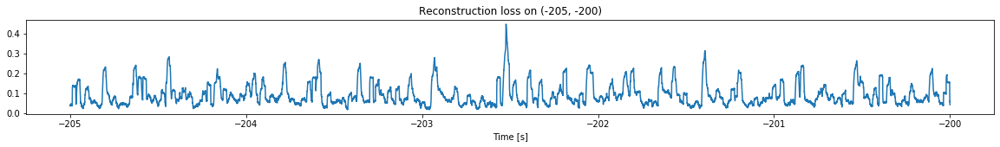

<--------
Entering sections:  (-200, -195)
-------->
Training for section:  (-205, -200)
Finished training, mean of the log(loss) is:  -1.6446235692390265
Triggering for section:  (-200, -195)
Using this mean for triggering: -1.577458799526307


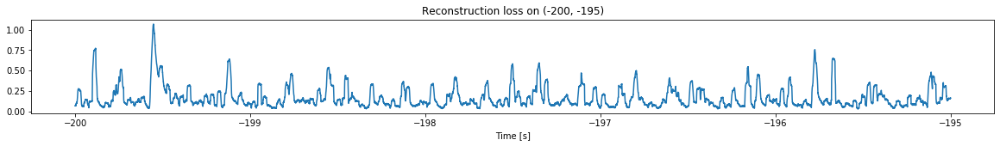

<--------
Entering sections:  (-195, -190)
-------->
Training for section:  (-200, -195)
Finished training, mean of the log(loss) is:  -1.8034055744614186
Triggering for section:  (-195, -190)
Using this mean for triggering: -1.6446235692390265


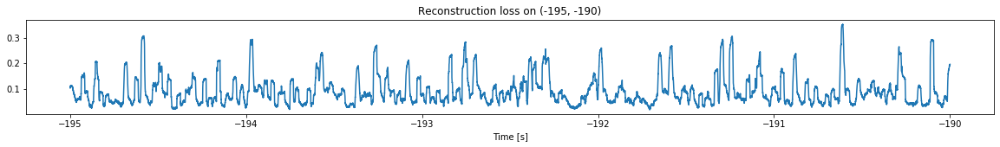

<--------
Entering sections:  (-190, -185)
-------->
Training for section:  (-195, -190)
Finished training, mean of the log(loss) is:  -1.8669757646920886
Triggering for section:  (-190, -185)
Using this mean for triggering: -1.8034055744614186


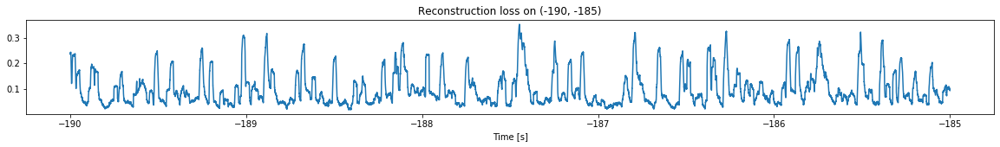

<--------
Entering sections:  (-185, -180)
-------->
Training for section:  (-190, -185)
Finished training, mean of the log(loss) is:  -1.8897414467858762
Triggering for section:  (-185, -180)
Using this mean for triggering: -1.8669757646920886


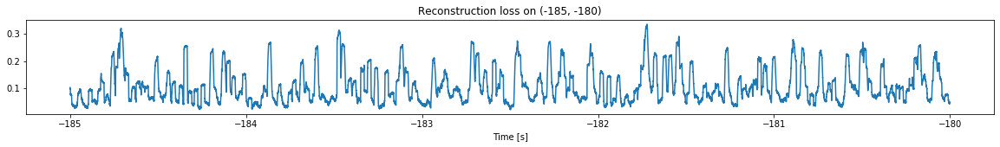

<--------
Entering sections:  (-180, -175)
-------->
Training for section:  (-185, -180)
Finished training, mean of the log(loss) is:  -1.8627995997958562
Triggering for section:  (-180, -175)
Using this mean for triggering: -1.8897414467858762


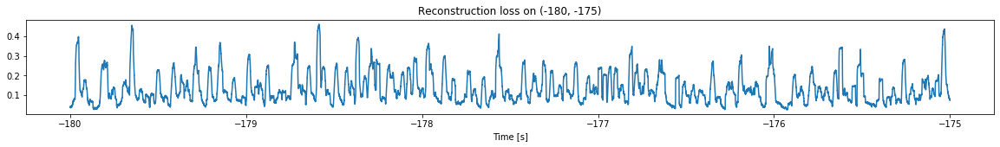

<--------
Entering sections:  (-175, -170)
-------->
Training for section:  (-180, -175)
Finished training, mean of the log(loss) is:  -1.849611247594981
Triggering for section:  (-175, -170)
Using this mean for triggering: -1.8627995997958562


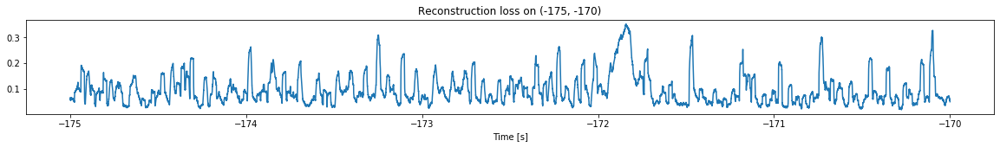

<--------
Entering sections:  (-170, -165)
-------->
Training for section:  (-175, -170)
Finished training, mean of the log(loss) is:  -1.7644270772779511
Triggering for section:  (-170, -165)
Using this mean for triggering: -1.849611247594981


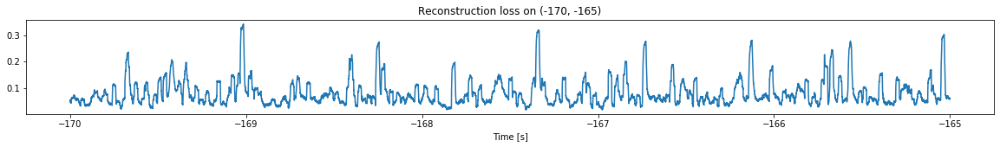

<--------
Entering sections:  (-165, -160)
-------->
Training for section:  (-170, -165)
Finished training, mean of the log(loss) is:  -1.8276442072989127
Triggering for section:  (-165, -160)
Using this mean for triggering: -1.7644270772779511


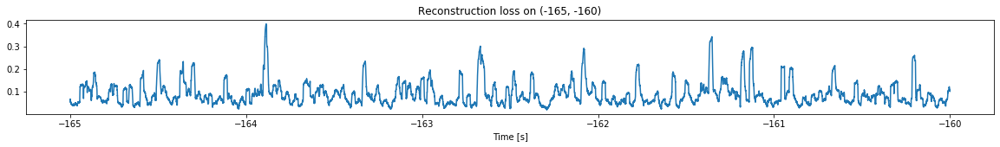

<--------
Entering sections:  (-160, -155)
-------->
Training for section:  (-165, -160)
Finished training, mean of the log(loss) is:  -1.8117819481403776
Triggering for section:  (-160, -155)
Using this mean for triggering: -1.8276442072989127


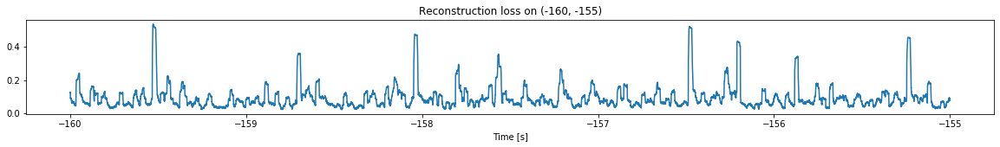

<--------
Entering sections:  (-155, -150)
-------->
Training for section:  (-160, -155)
Finished training, mean of the log(loss) is:  -1.788986917332041
Triggering for section:  (-155, -150)
Using this mean for triggering: -1.8117819481403776


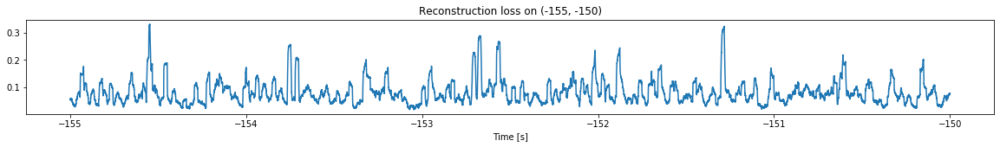

<--------
Entering sections:  (-150, -145)
-------->
Training for section:  (-155, -150)
Finished training, mean of the log(loss) is:  -1.8402151402790654
Triggering for section:  (-150, -145)
Using this mean for triggering: -1.788986917332041


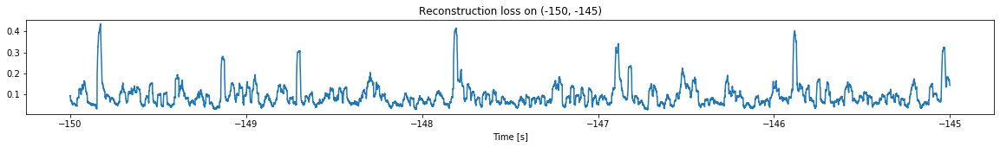

<--------
Entering sections:  (-145, -140)
-------->
Training for section:  (-150, -145)
Finished training, mean of the log(loss) is:  -1.82930902878819
Triggering for section:  (-145, -140)
Using this mean for triggering: -1.8402151402790654


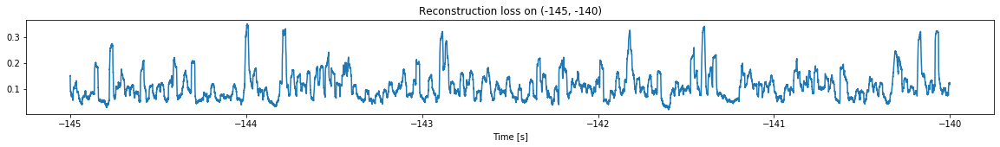

<--------
Entering sections:  (-140, -135)
-------->
Training for section:  (-145, -140)
Finished training, mean of the log(loss) is:  -1.8065384595865077
Triggering for section:  (-140, -135)
Using this mean for triggering: -1.82930902878819


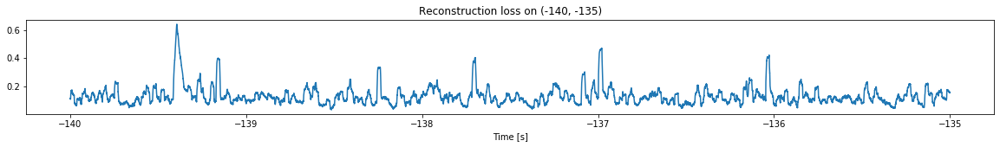

<--------
Entering sections:  (-135, -130)
-------->
Training for section:  (-140, -135)
Finished training, mean of the log(loss) is:  -1.8390179945596903
Triggering for section:  (-135, -130)
Using this mean for triggering: -1.8065384595865077


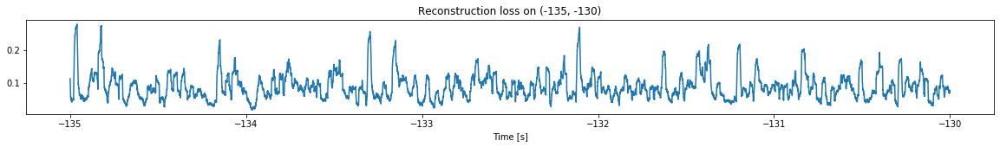

<--------
Entering sections:  (-130, -125)
-------->
Training for section:  (-135, -130)
Finished training, mean of the log(loss) is:  -1.8205718555181614
Triggering for section:  (-130, -125)
Using this mean for triggering: -1.8390179945596903


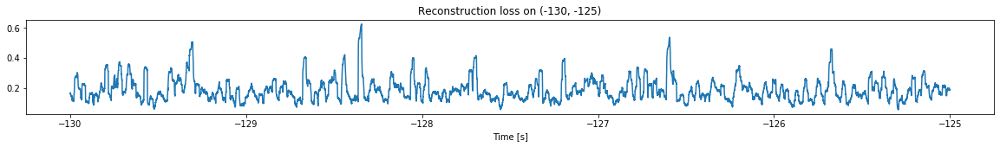

<--------
Entering sections:  (-125, -120)
-------->
Training for section:  (-130, -125)
Finished training, mean of the log(loss) is:  -1.7834493580128272
Triggering for section:  (-125, -120)
Using this mean for triggering: -1.8205718555181614


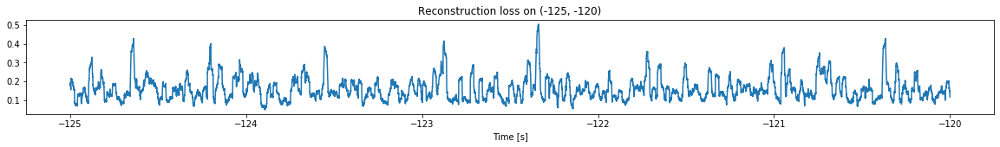

<--------
Entering sections:  (-120, -115)
-------->
Training for section:  (-125, -120)
Finished training, mean of the log(loss) is:  -1.8275013841014043
Triggering for section:  (-120, -115)
Using this mean for triggering: -1.7834493580128272


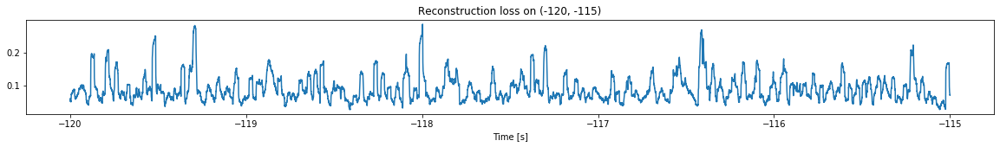

<--------
Entering sections:  (-115, -110)
-------->
Training for section:  (-120, -115)
Finished training, mean of the log(loss) is:  -1.7277288500820474
Triggering for section:  (-115, -110)
Using this mean for triggering: -1.8275013841014043


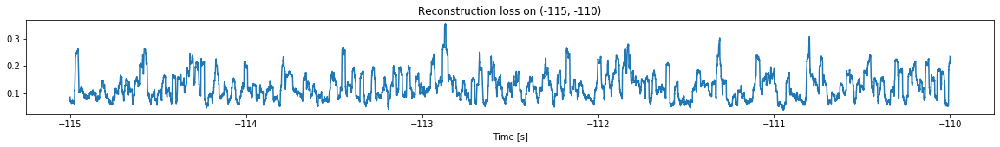

<--------
Entering sections:  (-110, -105)
-------->
Training for section:  (-115, -110)
Finished training, mean of the log(loss) is:  -1.6040400817240112
Triggering for section:  (-110, -105)
Using this mean for triggering: -1.7277288500820474


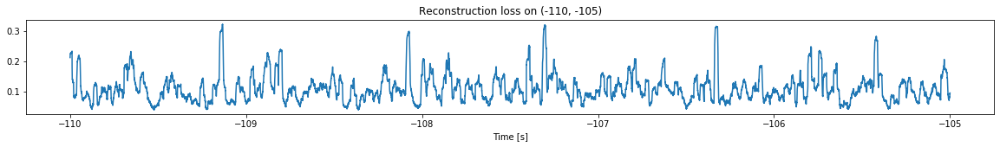

<--------
Entering sections:  (-105, -100)
-------->
Training for section:  (-110, -105)
Finished training, mean of the log(loss) is:  -1.73177402579713
Triggering for section:  (-105, -100)
Using this mean for triggering: -1.6040400817240112


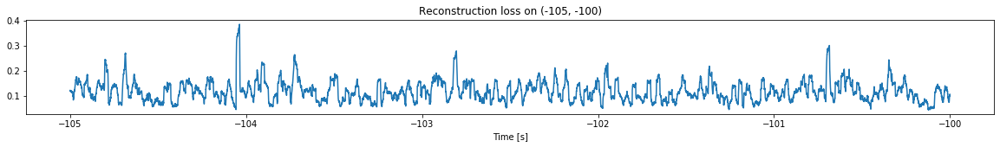

<--------
Entering sections:  (-100, -95)
-------->
Training for section:  (-105, -100)
Finished training, mean of the log(loss) is:  -1.7325385595206813
Triggering for section:  (-100, -95)
Using this mean for triggering: -1.73177402579713


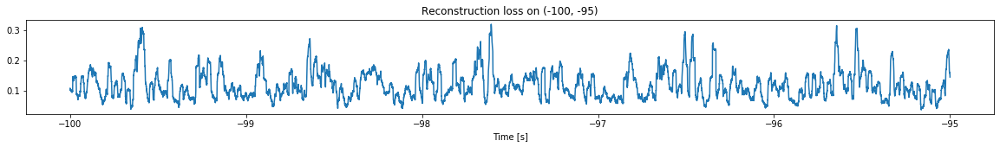

<--------
Entering sections:  (-95, -90)
-------->
Training for section:  (-100, -95)
Finished training, mean of the log(loss) is:  -1.842302783939787
Triggering for section:  (-95, -90)
Using this mean for triggering: -1.7325385595206813


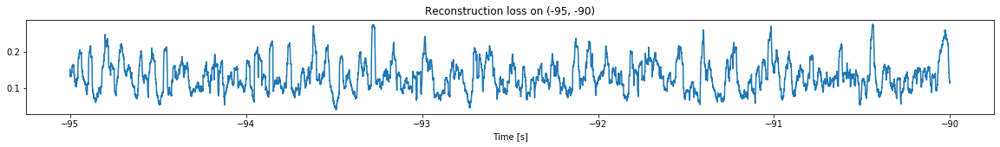

<--------
Entering sections:  (-90, -85)
-------->
Training for section:  (-95, -90)
Finished training, mean of the log(loss) is:  -1.8143685060326429
Triggering for section:  (-90, -85)
Using this mean for triggering: -1.842302783939787


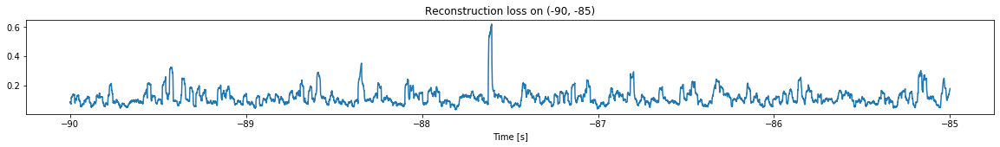

<--------
Entering sections:  (-85, -80)
-------->
Training for section:  (-90, -85)
Finished training, mean of the log(loss) is:  -1.7022277473674021
Triggering for section:  (-85, -80)
Using this mean for triggering: -1.8143685060326429


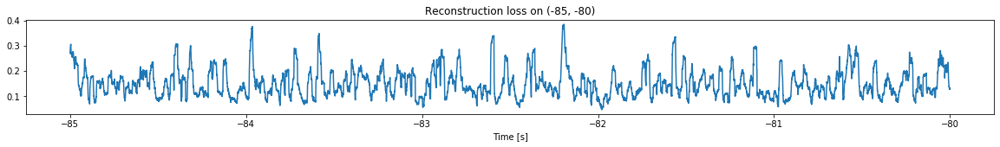

<--------
Entering sections:  (-80, -75)
-------->
Training for section:  (-85, -80)
Finished training, mean of the log(loss) is:  -1.712314883495368
Triggering for section:  (-80, -75)
Using this mean for triggering: -1.7022277473674021


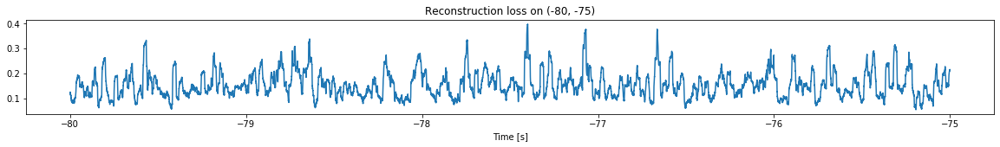

<--------
Entering sections:  (-75, -70)
-------->
Training for section:  (-80, -75)
Finished training, mean of the log(loss) is:  -1.7117928897277679
Triggering for section:  (-75, -70)
Using this mean for triggering: -1.712314883495368


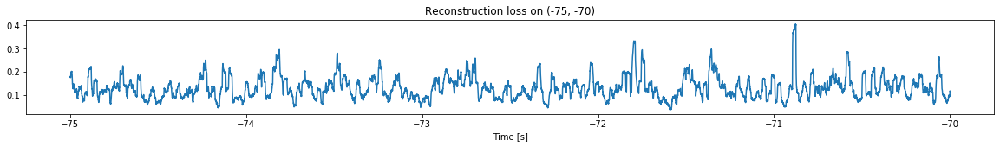

<--------
Entering sections:  (-70, -65)
-------->
Training for section:  (-75, -70)
Finished training, mean of the log(loss) is:  -1.598006944911192
Triggering for section:  (-70, -65)
Using this mean for triggering: -1.7117928897277679


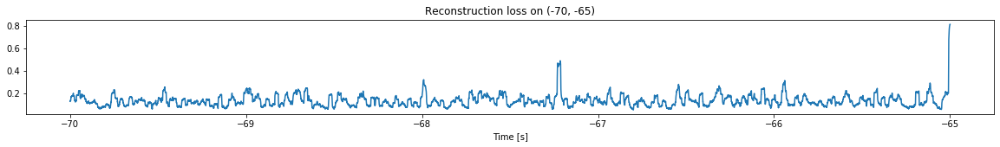

<--------
Entering sections:  (-65, -60)
-------->
Training for section:  (-70, -65)
Finished training, mean of the log(loss) is:  -1.694930736482629
Triggering for section:  (-65, -60)
Using this mean for triggering: -1.598006944911192


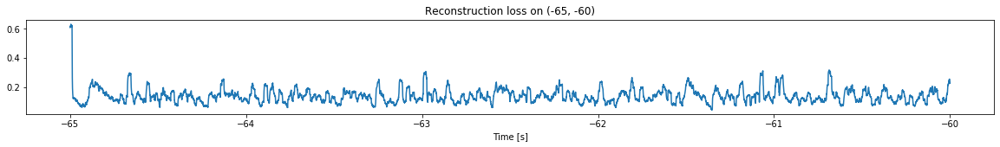

<--------
Entering sections:  (-60, -55)
-------->
Training for section:  (-65, -60)
Finished training, mean of the log(loss) is:  -1.665417159502728
Triggering for section:  (-60, -55)
Using this mean for triggering: -1.694930736482629


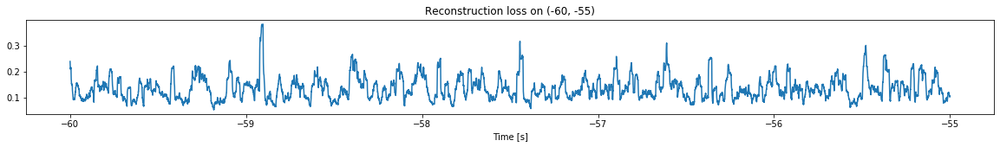

<--------
Entering sections:  (-55, -50)
-------->
Training for section:  (-60, -55)
Finished training, mean of the log(loss) is:  -1.6755916918612463
Triggering for section:  (-55, -50)
Using this mean for triggering: -1.665417159502728


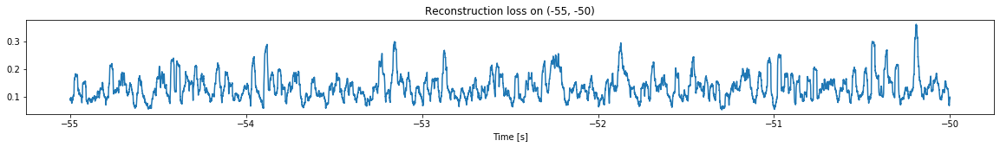

<--------
Entering sections:  (-50, -45)
-------->
Training for section:  (-55, -50)
Finished training, mean of the log(loss) is:  -1.7011954063394898
Triggering for section:  (-50, -45)
Using this mean for triggering: -1.6755916918612463


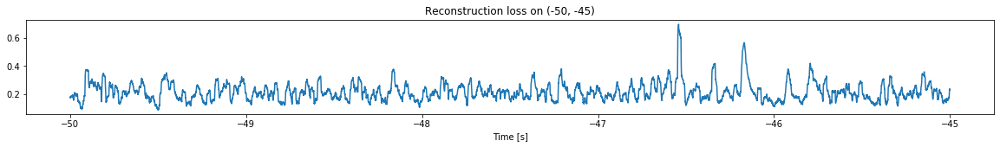

<--------
Entering sections:  (-45, -40)
-------->
Training for section:  (-50, -45)
Finished training, mean of the log(loss) is:  -1.6630148918780567
Triggering for section:  (-45, -40)
Using this mean for triggering: -1.7011954063394898


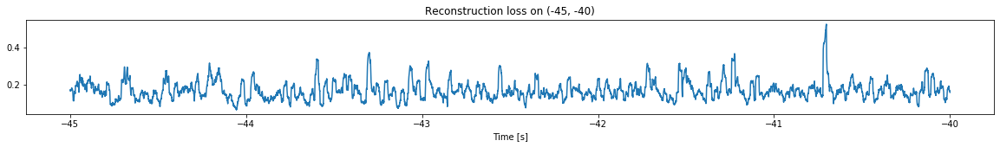

<--------
Entering sections:  (-40, -35)
-------->
Training for section:  (-45, -40)
Finished training, mean of the log(loss) is:  -1.6990313059020714
Triggering for section:  (-40, -35)
Using this mean for triggering: -1.6630148918780567


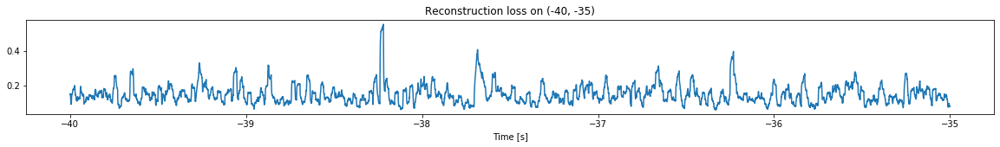

<--------
Entering sections:  (-35, -30)
-------->
Training for section:  (-40, -35)
Finished training, mean of the log(loss) is:  -1.6548218962833485
Triggering for section:  (-35, -30)
Using this mean for triggering: -1.6990313059020714


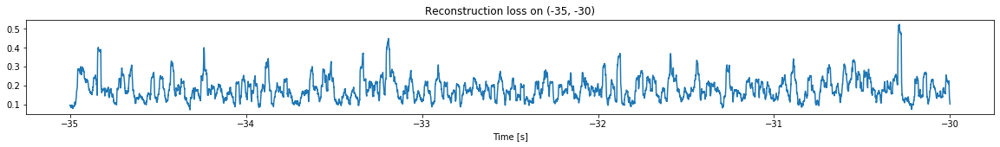

<--------
Entering sections:  (-30, -25)
-------->
Training for section:  (-35, -30)
Finished training, mean of the log(loss) is:  -1.6394009342127958
Triggering for section:  (-30, -25)
Using this mean for triggering: -1.6548218962833485


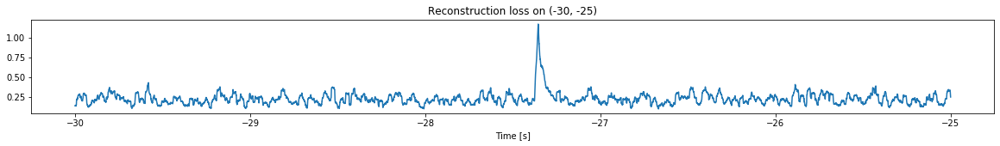

<--------
Entering sections:  (-25, -20)
-------->
Training for section:  (-30, -25)
Finished training, mean of the log(loss) is:  -1.6858444063087716
Triggering for section:  (-25, -20)
Using this mean for triggering: -1.6394009342127958


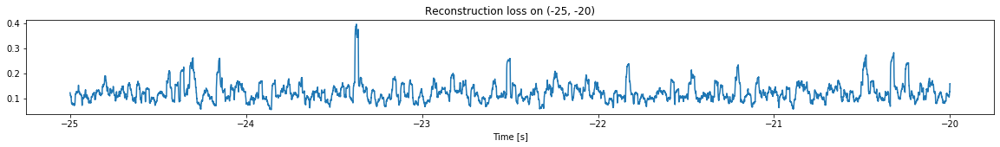

<--------
Entering sections:  (-20, -15)
-------->
Training for section:  (-25, -20)
Finished training, mean of the log(loss) is:  -1.7011486805973437
Triggering for section:  (-20, -15)
Using this mean for triggering: -1.6858444063087716


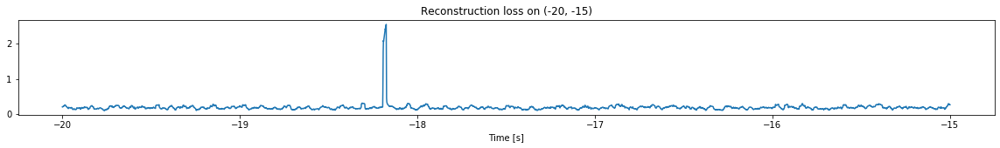

<--------
Entering sections:  (-15, -10)
-------->
Training for section:  (-20, -15)
Finished training, mean of the log(loss) is:  -1.6889947272994106
Triggering for section:  (-15, -10)
Using this mean for triggering: -1.7011486805973437


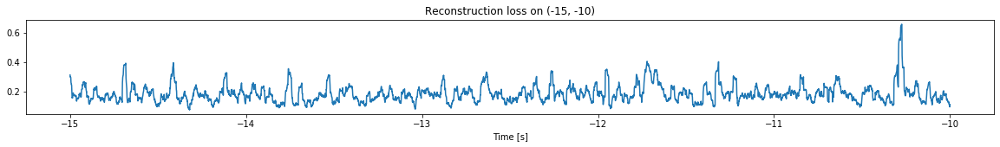

<--------
Entering sections:  (-10, -5)
-------->
Training for section:  (-15, -10)
Finished training, mean of the log(loss) is:  -1.756043637608542
Triggering for section:  (-10, -5)
Using this mean for triggering: -1.6889947272994106


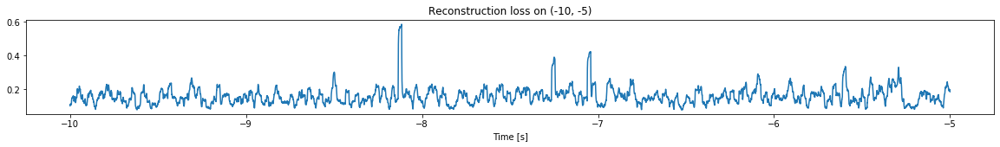

<--------
Entering sections:  (-5, 0)
-------->
Training for section:  (-10, -5)
Finished training, mean of the log(loss) is:  -1.7475793168134932
Triggering for section:  (-5, 0)
Using this mean for triggering: -1.756043637608542


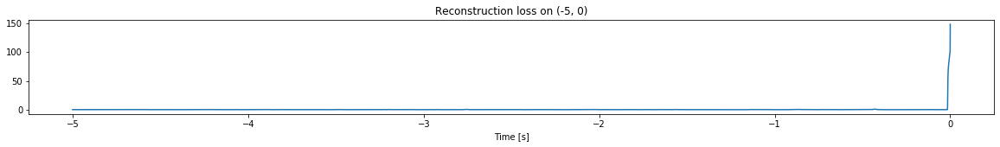

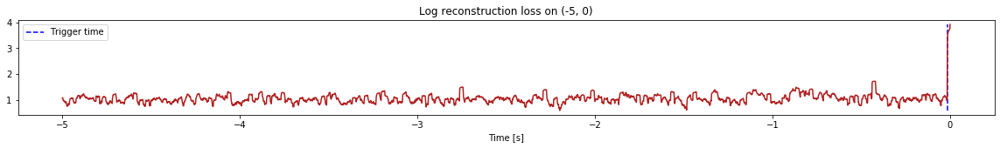

Triggered at:  -0.01519


-0.01519

In [9]:
simulation("./data/Ramp22/", 5, (-300,0))

Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
All data's shape:  (497500, 12)
Flushing input history
Number of sections: 10
Entering sections:  (-50, -45)
-------->
Entering sections:  (-45, -40)
-------->
Training for section:  (None, -45)
Finished training, mean of the log(loss) is:  -1.6322523554975927
<--------
Entering sections:  (-40, -35)
-------->
Training for section:  (-45, -40)
Finished training, mean of the log(loss) is:  -1.7832248057674944
Triggering for section:  (-40, -35)
Using this mean for triggering: -1.6322523554975927


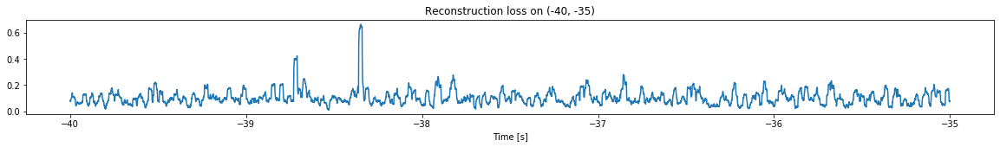

<--------
Entering sections:  (-35, -30)
-------->
Training for section:  (-40, -35)
Finished training, mean of the log(loss) is:  -1.7877054310572011
Triggering for section:  (-35, -30)
Using this mean for triggering: -1.7832248057674944


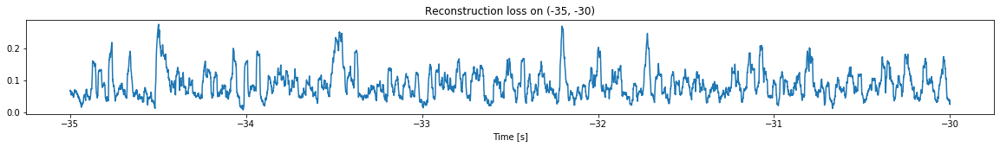

<--------
Entering sections:  (-30, -25)
-------->
Training for section:  (-35, -30)
Finished training, mean of the log(loss) is:  -1.8349181907940662
Triggering for section:  (-30, -25)
Using this mean for triggering: -1.7877054310572011


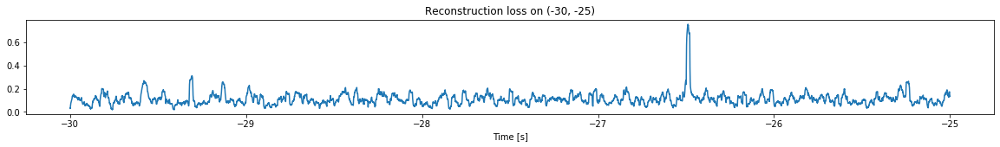

<--------
Entering sections:  (-25, -20)
-------->
Training for section:  (-30, -25)
Finished training, mean of the log(loss) is:  -1.7406954934202266
Triggering for section:  (-25, -20)
Using this mean for triggering: -1.8349181907940662


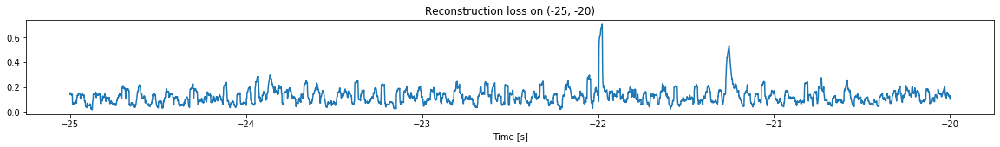

<--------
Entering sections:  (-20, -15)
-------->
Training for section:  (-25, -20)
Finished training, mean of the log(loss) is:  -1.8129129325349753
Triggering for section:  (-20, -15)
Using this mean for triggering: -1.7406954934202266


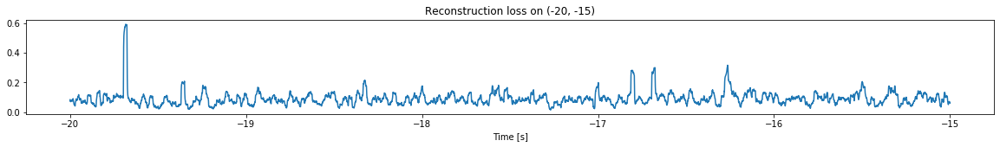

<--------
Entering sections:  (-15, -10)
-------->
Training for section:  (-20, -15)
Finished training, mean of the log(loss) is:  -1.7493963832532415
Triggering for section:  (-15, -10)
Using this mean for triggering: -1.8129129325349753


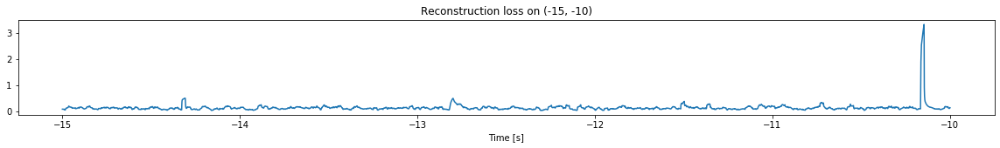

<--------
Entering sections:  (-10, -5)
-------->
Training for section:  (-15, -10)
Finished training, mean of the log(loss) is:  -1.783225954331714
Triggering for section:  (-10, -5)
Using this mean for triggering: -1.7493963832532415


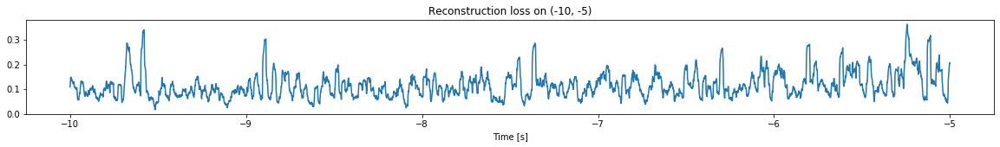

<--------
Entering sections:  (-5, 0)
-------->
Training for section:  (-10, -5)
Finished training, mean of the log(loss) is:  -1.8079547914146434
Triggering for section:  (-5, 0)
Using this mean for triggering: -1.783225954331714


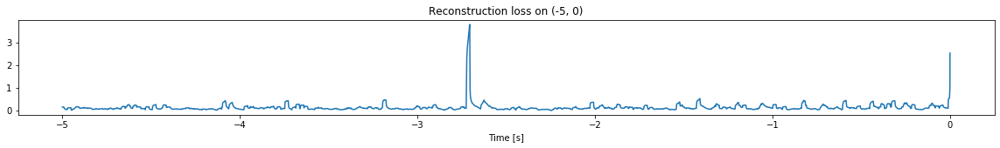

<--------


In [10]:
simulation("./data/Ramp23/", 5, (-50,0))

Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
All data's shape:  (2997500, 12)
Flushing input history
Number of sections: 60
Entering sections:  (-300, -295)
-------->
Entering sections:  (-295, -290)
-------->
Training for section:  (None, -295)
Finished training, mean of the log(loss) is:  -1.627386116900317
<--------
Entering sections:  (-290, -285)
-------->
Training for section:  (-295, -290)
Finished training, mean of the log(loss) is:  -1.585772805816251
Triggering for section:  (-290, -285)
Using this mean for triggering: -1.627386116900317


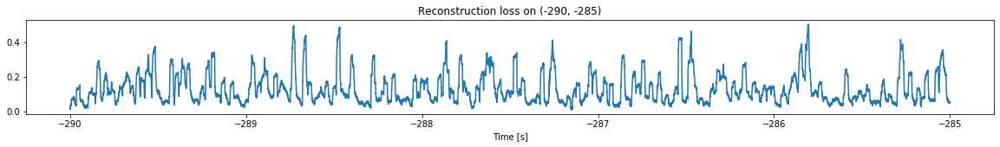

<--------
Entering sections:  (-285, -280)
-------->
Training for section:  (-290, -285)
Finished training, mean of the log(loss) is:  -1.6120206812053246
Triggering for section:  (-285, -280)
Using this mean for triggering: -1.585772805816251


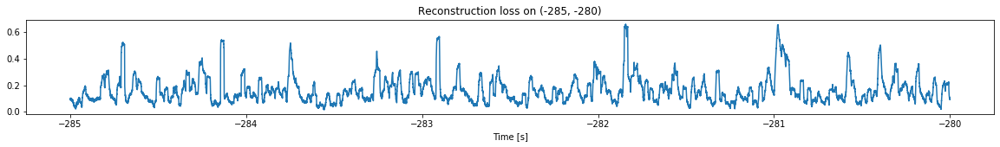

<--------
Entering sections:  (-280, -275)
-------->
Training for section:  (-285, -280)
Finished training, mean of the log(loss) is:  -1.6728789343328192
Triggering for section:  (-280, -275)
Using this mean for triggering: -1.6120206812053246


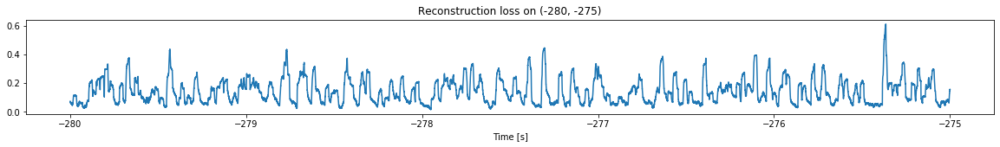

<--------
Entering sections:  (-275, -270)
-------->
Training for section:  (-280, -275)
Finished training, mean of the log(loss) is:  -1.5987365639361657
Triggering for section:  (-275, -270)
Using this mean for triggering: -1.6728789343328192


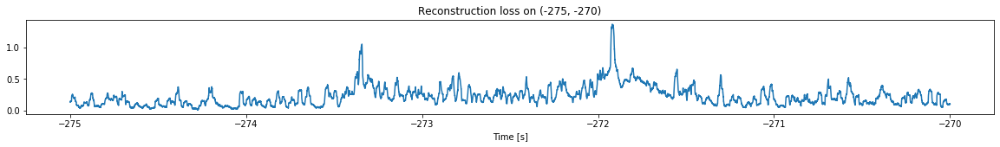

<--------
Entering sections:  (-270, -265)
-------->
Training for section:  (-275, -270)
Finished training, mean of the log(loss) is:  -1.4863120879584772
Triggering for section:  (-270, -265)
Using this mean for triggering: -1.5987365639361657


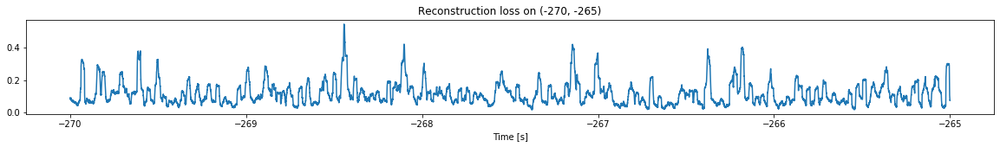

<--------
Entering sections:  (-265, -260)
-------->
Training for section:  (-270, -265)
Finished training, mean of the log(loss) is:  -1.5770908848061826
Triggering for section:  (-265, -260)
Using this mean for triggering: -1.4863120879584772


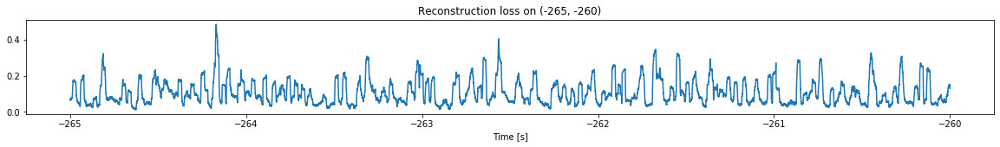

<--------
Entering sections:  (-260, -255)
-------->
Training for section:  (-265, -260)
Finished training, mean of the log(loss) is:  -1.7612096224948675
Triggering for section:  (-260, -255)
Using this mean for triggering: -1.5770908848061826


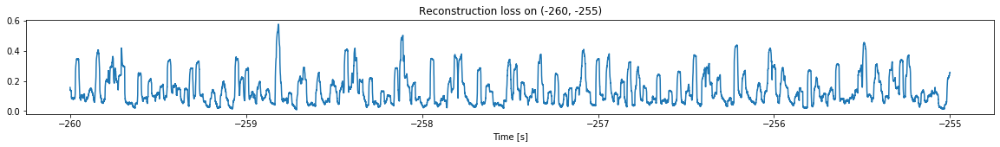

<--------
Entering sections:  (-255, -250)
-------->
Training for section:  (-260, -255)
Finished training, mean of the log(loss) is:  -1.6261046899975646
Triggering for section:  (-255, -250)
Using this mean for triggering: -1.7612096224948675


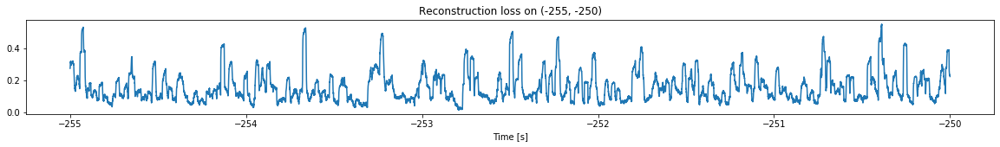

<--------
Entering sections:  (-250, -245)
-------->
Training for section:  (-255, -250)
Finished training, mean of the log(loss) is:  -1.7031556266230614
Triggering for section:  (-250, -245)
Using this mean for triggering: -1.6261046899975646


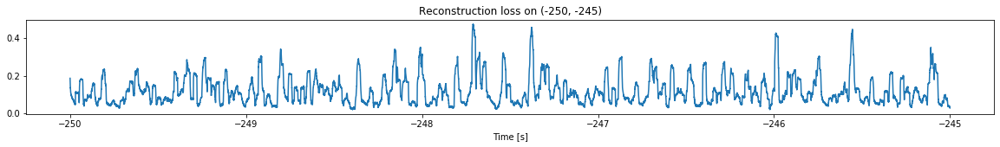

<--------
Entering sections:  (-245, -240)
-------->
Training for section:  (-250, -245)
Finished training, mean of the log(loss) is:  -1.5899606851939787
Triggering for section:  (-245, -240)
Using this mean for triggering: -1.7031556266230614


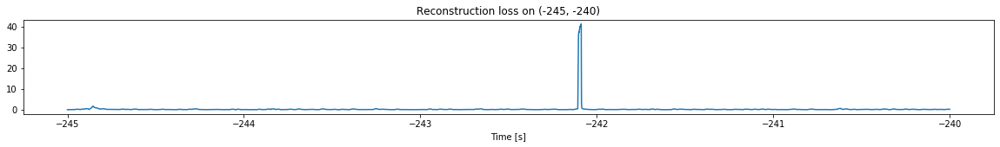

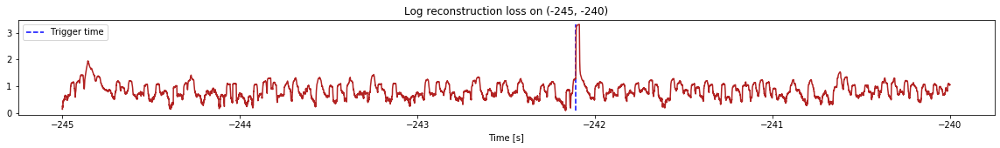

Triggered at:  -242.10667


-242.10667

In [11]:
simulation("./data/Ramp24/", 5, (-300,0))

Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
All data's shape:  (2997500, 12)
Flushing input history
Number of sections: 60
Entering sections:  (-300, -295)
-------->
Entering sections:  (-295, -290)
-------->
Training for section:  (None, -295)
Finished training, mean of the log(loss) is:  -1.714395964276266
<--------
Entering sections:  (-290, -285)
-------->
Training for section:  (-295, -290)
Finished training, mean of the log(loss) is:  -1.4865621089646341
Triggering for section:  (-290, -285)
Using this mean for triggering: -1.714395964276266


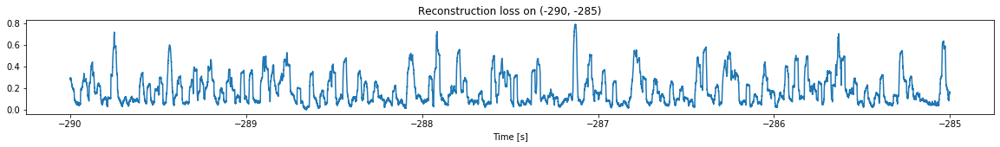

<--------
Entering sections:  (-285, -280)
-------->
Training for section:  (-290, -285)
Finished training, mean of the log(loss) is:  -1.5913266146330503
Triggering for section:  (-285, -280)
Using this mean for triggering: -1.4865621089646341


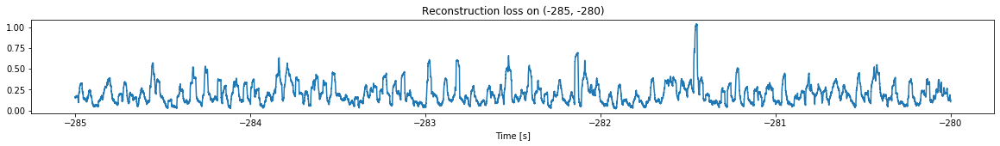

<--------
Entering sections:  (-280, -275)
-------->
Training for section:  (-285, -280)
Finished training, mean of the log(loss) is:  -1.565525832686822
Triggering for section:  (-280, -275)
Using this mean for triggering: -1.5913266146330503


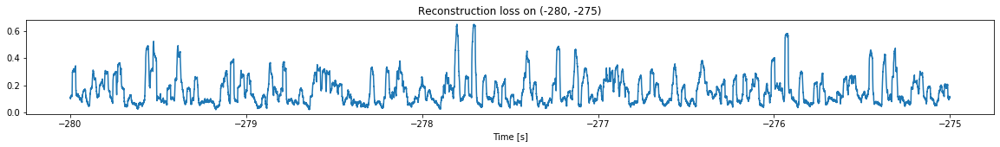

<--------
Entering sections:  (-275, -270)
-------->
Training for section:  (-280, -275)
Finished training, mean of the log(loss) is:  -1.6035247072701608
Triggering for section:  (-275, -270)
Using this mean for triggering: -1.565525832686822


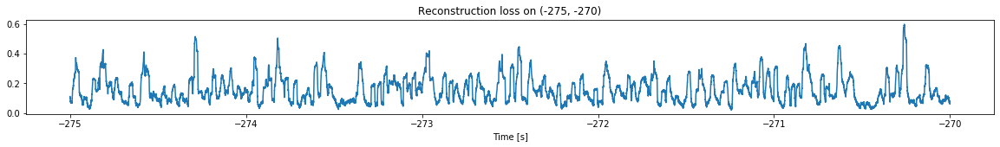

<--------
Entering sections:  (-270, -265)
-------->
Training for section:  (-275, -270)
Finished training, mean of the log(loss) is:  -1.598801878623003
Triggering for section:  (-270, -265)
Using this mean for triggering: -1.6035247072701608


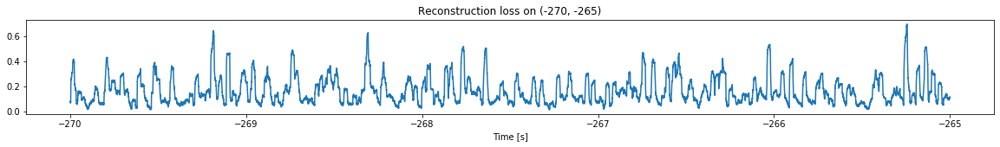

<--------
Entering sections:  (-265, -260)
-------->
Training for section:  (-270, -265)
Finished training, mean of the log(loss) is:  -1.4747307007715065
Triggering for section:  (-265, -260)
Using this mean for triggering: -1.598801878623003


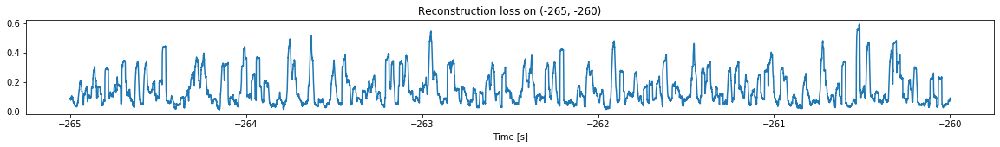

<--------
Entering sections:  (-260, -255)
-------->
Training for section:  (-265, -260)
Finished training, mean of the log(loss) is:  -1.5697635703893873
Triggering for section:  (-260, -255)
Using this mean for triggering: -1.4747307007715065


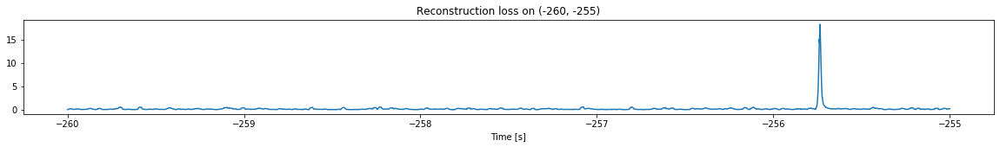

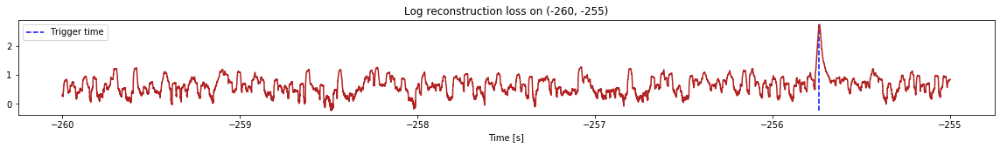

Triggered at:  -255.73927


-255.73927

In [12]:
simulation("./data/Ramp25/", 5, (-300,0))

Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
All data's shape:  (2997500, 12)
Flushing input history
Number of sections: 60
Entering sections:  (-300, -295)
-------->
Entering sections:  (-295, -290)
-------->
Training for section:  (None, -295)
Finished training, mean of the log(loss) is:  -1.4997145395345095
<--------
Entering sections:  (-290, -285)
-------->
Training for section:  (-295, -290)
Finished training, mean of the log(loss) is:  -1.559760830892055
Triggering for section:  (-290, -285)
Using this mean for triggering: -1.4997145395345095


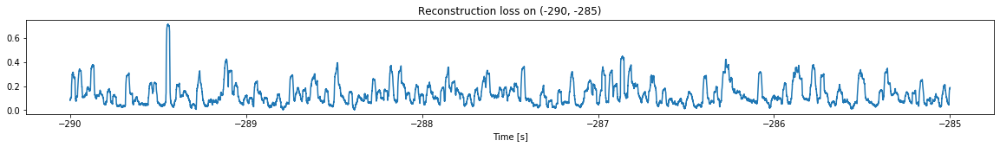

<--------
Entering sections:  (-285, -280)
-------->
Training for section:  (-290, -285)
Finished training, mean of the log(loss) is:  -1.7181366420189044
Triggering for section:  (-285, -280)
Using this mean for triggering: -1.559760830892055


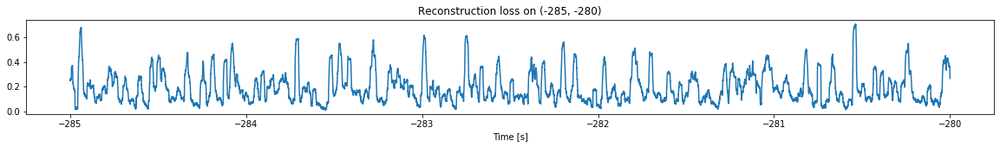

<--------
Entering sections:  (-280, -275)
-------->
Training for section:  (-285, -280)
Finished training, mean of the log(loss) is:  -1.6622439412056487
Triggering for section:  (-280, -275)
Using this mean for triggering: -1.7181366420189044


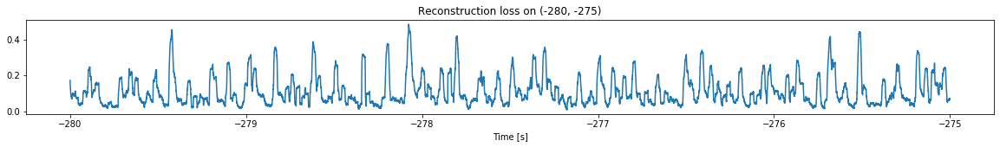

<--------
Entering sections:  (-275, -270)
-------->
Training for section:  (-280, -275)
Finished training, mean of the log(loss) is:  -1.7243319006318636
Triggering for section:  (-275, -270)
Using this mean for triggering: -1.6622439412056487


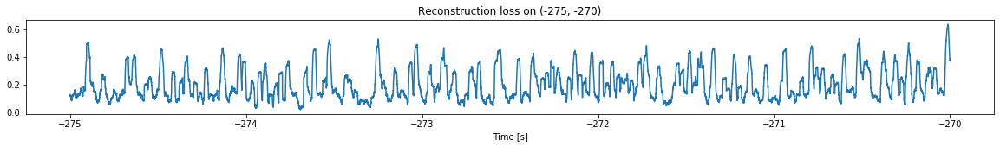

<--------
Entering sections:  (-270, -265)
-------->
Training for section:  (-275, -270)
Finished training, mean of the log(loss) is:  -1.726320348280402
Triggering for section:  (-270, -265)
Using this mean for triggering: -1.7243319006318636


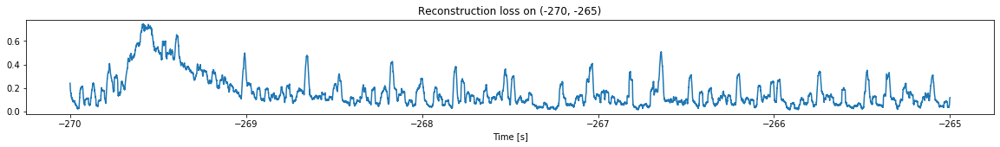

<--------
Entering sections:  (-265, -260)
-------->
Training for section:  (-270, -265)
Finished training, mean of the log(loss) is:  -1.6090852402617268
Triggering for section:  (-265, -260)
Using this mean for triggering: -1.726320348280402


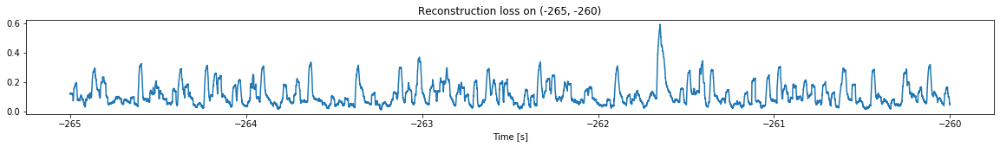

<--------
Entering sections:  (-260, -255)
-------->
Training for section:  (-265, -260)
Finished training, mean of the log(loss) is:  -1.7886938099775298
Triggering for section:  (-260, -255)
Using this mean for triggering: -1.6090852402617268


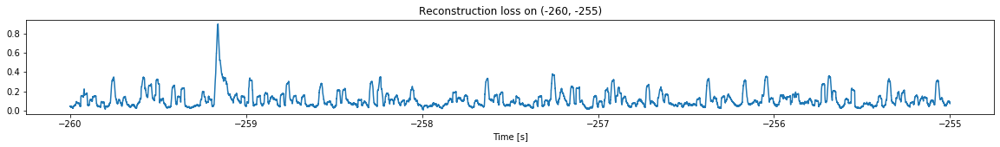

<--------
Entering sections:  (-255, -250)
-------->
Training for section:  (-260, -255)
Finished training, mean of the log(loss) is:  -1.7833755906457798
Triggering for section:  (-255, -250)
Using this mean for triggering: -1.7886938099775298


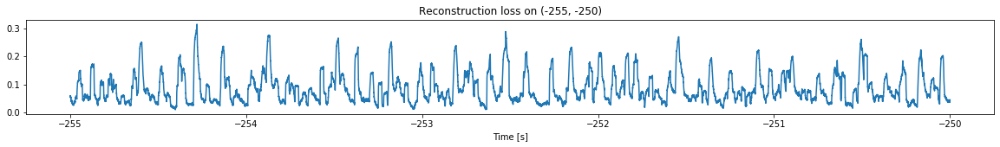

<--------
Entering sections:  (-250, -245)
-------->
Training for section:  (-255, -250)
Finished training, mean of the log(loss) is:  -1.8080403920537358
Triggering for section:  (-250, -245)
Using this mean for triggering: -1.7833755906457798


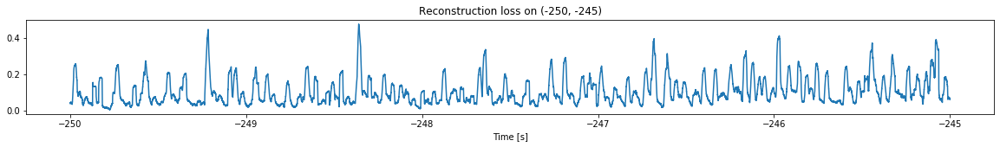

<--------
Entering sections:  (-245, -240)
-------->
Training for section:  (-250, -245)
Finished training, mean of the log(loss) is:  -1.7711806828391805
Triggering for section:  (-245, -240)
Using this mean for triggering: -1.8080403920537358


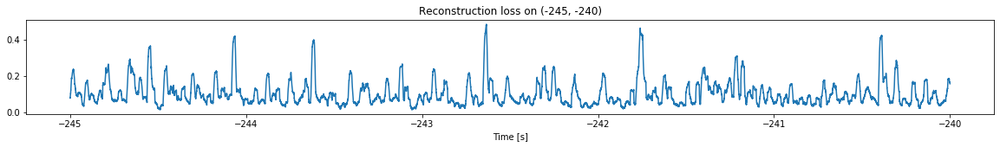

<--------
Entering sections:  (-240, -235)
-------->
Training for section:  (-245, -240)
Finished training, mean of the log(loss) is:  -1.817893572699298
Triggering for section:  (-240, -235)
Using this mean for triggering: -1.7711806828391805


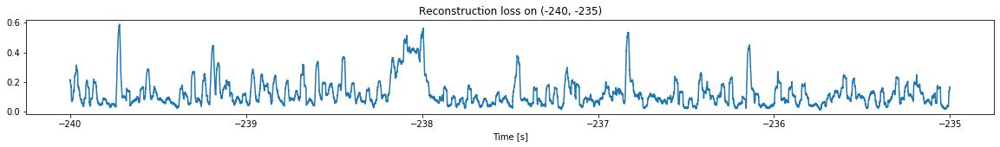

<--------
Entering sections:  (-235, -230)
-------->
Training for section:  (-240, -235)
Finished training, mean of the log(loss) is:  -1.8131973726438289
Triggering for section:  (-235, -230)
Using this mean for triggering: -1.817893572699298


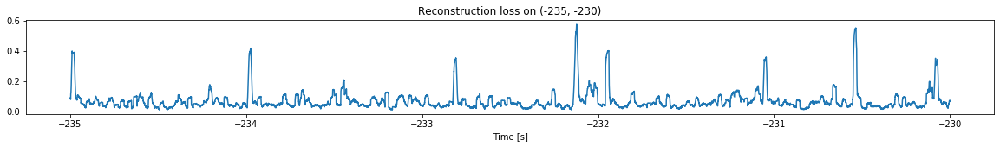

<--------
Entering sections:  (-230, -225)
-------->
Training for section:  (-235, -230)
Finished training, mean of the log(loss) is:  -1.8159039855284418
Triggering for section:  (-230, -225)
Using this mean for triggering: -1.8131973726438289


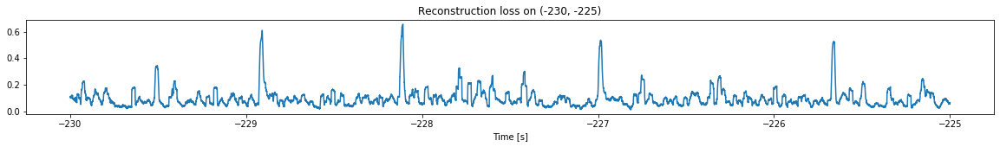

<--------
Entering sections:  (-225, -220)
-------->
Training for section:  (-230, -225)
Finished training, mean of the log(loss) is:  -1.8549576798373586
Triggering for section:  (-225, -220)
Using this mean for triggering: -1.8159039855284418


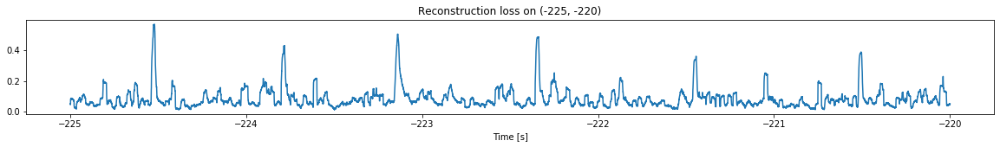

<--------
Entering sections:  (-220, -215)
-------->
Training for section:  (-225, -220)
Finished training, mean of the log(loss) is:  -1.841502926381617
Triggering for section:  (-220, -215)
Using this mean for triggering: -1.8549576798373586


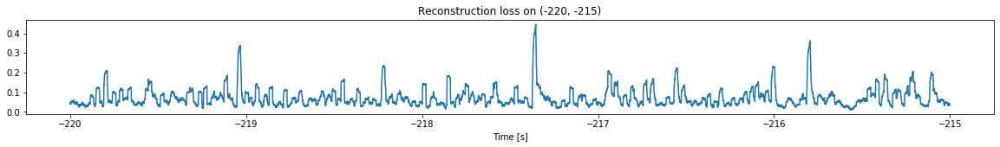

<--------
Entering sections:  (-215, -210)
-------->
Training for section:  (-220, -215)
Finished training, mean of the log(loss) is:  -1.8771495505052451
Triggering for section:  (-215, -210)
Using this mean for triggering: -1.841502926381617


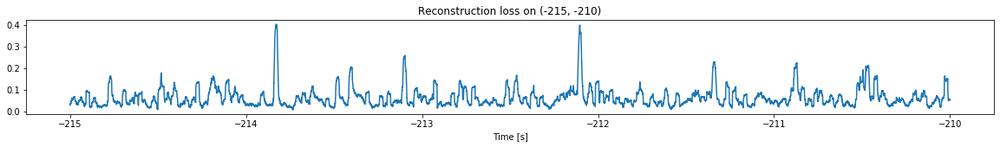

<--------
Entering sections:  (-210, -205)
-------->
Training for section:  (-215, -210)
Finished training, mean of the log(loss) is:  -1.9867420560606694
Triggering for section:  (-210, -205)
Using this mean for triggering: -1.8771495505052451


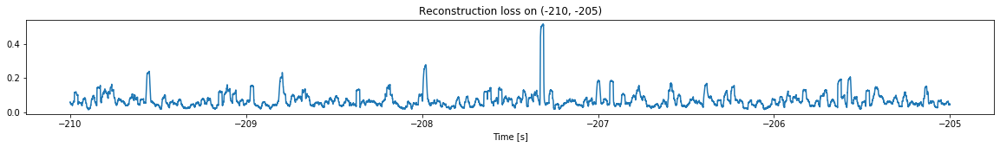

<--------
Entering sections:  (-205, -200)
-------->
Training for section:  (-210, -205)
Finished training, mean of the log(loss) is:  -1.909658616216654
Triggering for section:  (-205, -200)
Using this mean for triggering: -1.9867420560606694


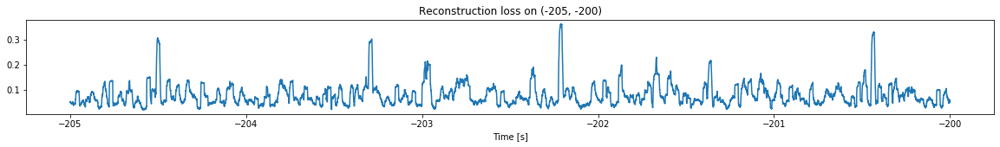

<--------
Entering sections:  (-200, -195)
-------->
Training for section:  (-205, -200)
Finished training, mean of the log(loss) is:  -1.9093031942761443
Triggering for section:  (-200, -195)
Using this mean for triggering: -1.909658616216654


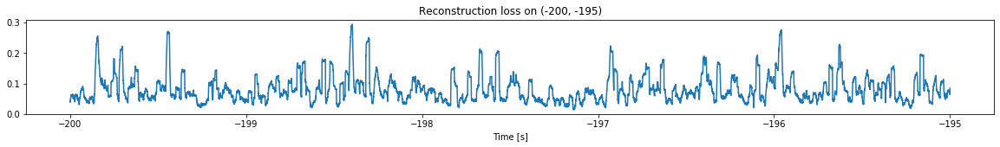

<--------
Entering sections:  (-195, -190)
-------->
Training for section:  (-200, -195)
Finished training, mean of the log(loss) is:  -1.9408394141732865
Triggering for section:  (-195, -190)
Using this mean for triggering: -1.9093031942761443


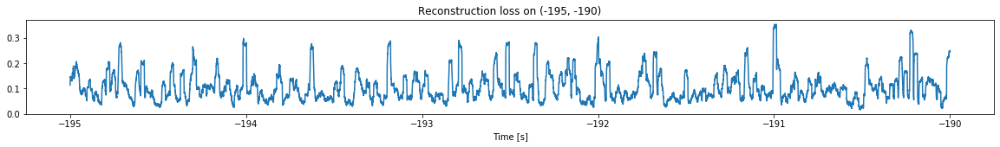

<--------
Entering sections:  (-190, -185)
-------->
Training for section:  (-195, -190)
Finished training, mean of the log(loss) is:  -1.9465678946846965
Triggering for section:  (-190, -185)
Using this mean for triggering: -1.9408394141732865


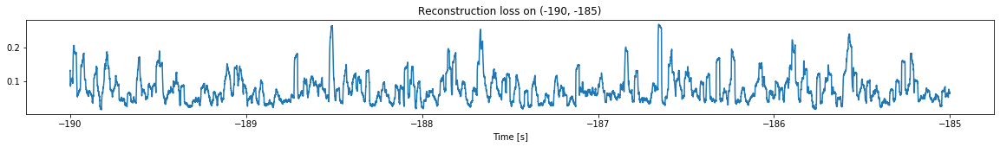

<--------
Entering sections:  (-185, -180)
-------->
Training for section:  (-190, -185)
Finished training, mean of the log(loss) is:  -1.813974790639877
Triggering for section:  (-185, -180)
Using this mean for triggering: -1.9465678946846965


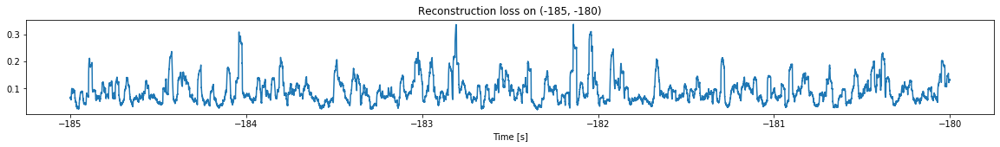

<--------
Entering sections:  (-180, -175)
-------->
Training for section:  (-185, -180)
Finished training, mean of the log(loss) is:  -1.8789328074178007
Triggering for section:  (-180, -175)
Using this mean for triggering: -1.813974790639877


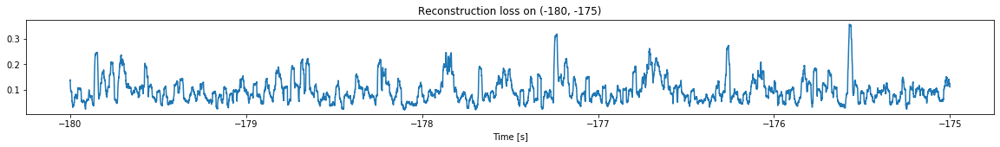

<--------
Entering sections:  (-175, -170)
-------->
Training for section:  (-180, -175)
Finished training, mean of the log(loss) is:  -1.8084701962437477
Triggering for section:  (-175, -170)
Using this mean for triggering: -1.8789328074178007


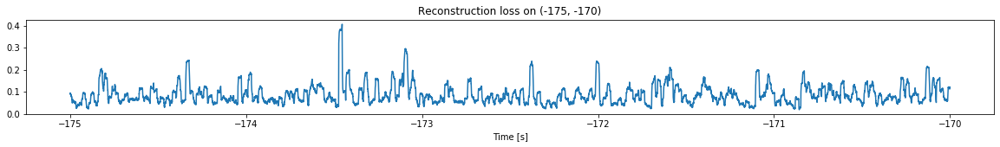

<--------
Entering sections:  (-170, -165)
-------->
Training for section:  (-175, -170)
Finished training, mean of the log(loss) is:  -1.850111571806492
Triggering for section:  (-170, -165)
Using this mean for triggering: -1.8084701962437477


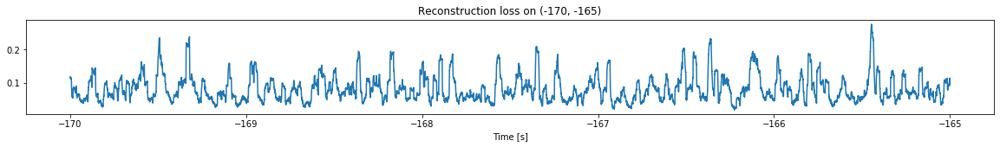

<--------
Entering sections:  (-165, -160)
-------->
Training for section:  (-170, -165)
Finished training, mean of the log(loss) is:  -1.8639092941688267
Triggering for section:  (-165, -160)
Using this mean for triggering: -1.850111571806492


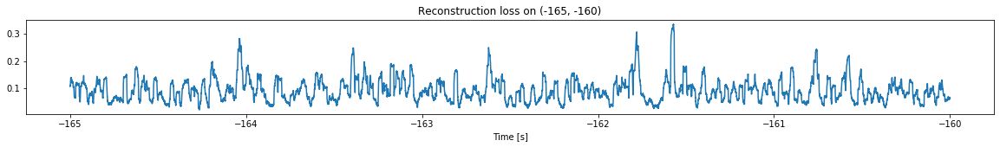

<--------
Entering sections:  (-160, -155)
-------->
Training for section:  (-165, -160)
Finished training, mean of the log(loss) is:  -1.8688850669421027
Triggering for section:  (-160, -155)
Using this mean for triggering: -1.8639092941688267


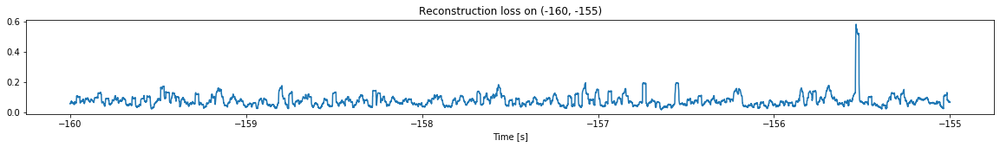

<--------
Entering sections:  (-155, -150)
-------->
Training for section:  (-160, -155)
Finished training, mean of the log(loss) is:  -1.800764866267675
Triggering for section:  (-155, -150)
Using this mean for triggering: -1.8688850669421027


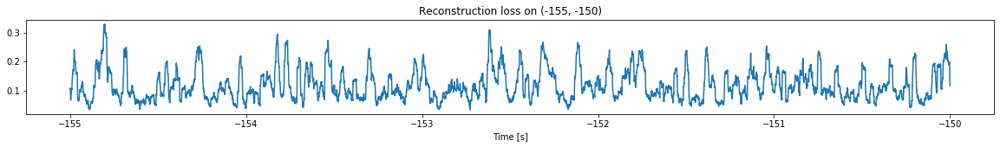

<--------
Entering sections:  (-150, -145)
-------->
Training for section:  (-155, -150)
Finished training, mean of the log(loss) is:  -1.8274403671575503
Triggering for section:  (-150, -145)
Using this mean for triggering: -1.800764866267675


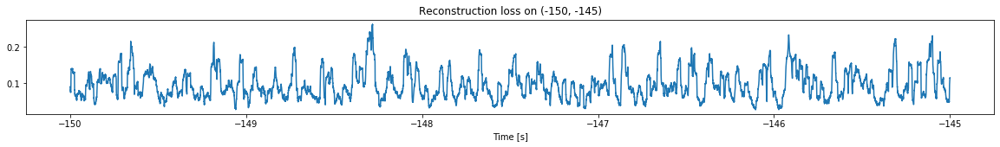

<--------
Entering sections:  (-145, -140)
-------->
Training for section:  (-150, -145)
Finished training, mean of the log(loss) is:  -1.833696205774276
Triggering for section:  (-145, -140)
Using this mean for triggering: -1.8274403671575503


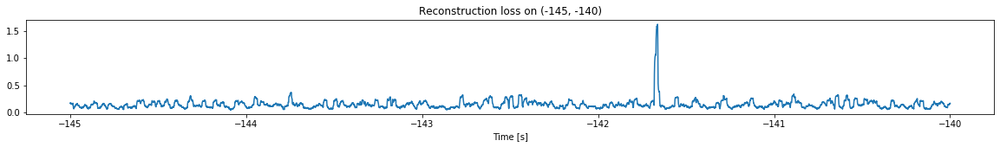

<--------
Entering sections:  (-140, -135)
-------->
Training for section:  (-145, -140)
Finished training, mean of the log(loss) is:  -1.8444563944218704
Triggering for section:  (-140, -135)
Using this mean for triggering: -1.833696205774276


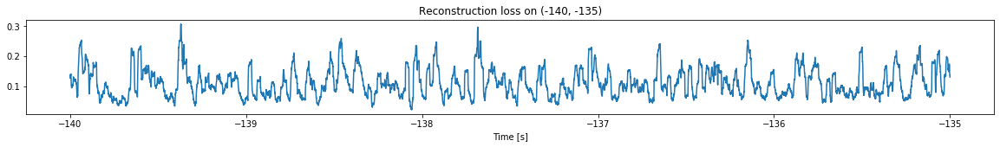

<--------
Entering sections:  (-135, -130)
-------->
Training for section:  (-140, -135)
Finished training, mean of the log(loss) is:  -1.8800082784183285
Triggering for section:  (-135, -130)
Using this mean for triggering: -1.8444563944218704


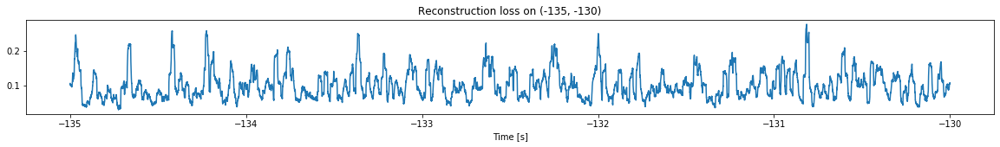

<--------
Entering sections:  (-130, -125)
-------->
Training for section:  (-135, -130)
Finished training, mean of the log(loss) is:  -1.8249383472635121
Triggering for section:  (-130, -125)
Using this mean for triggering: -1.8800082784183285


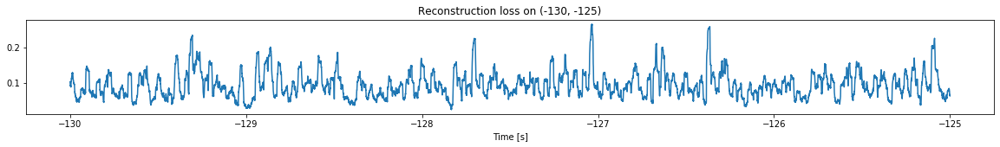

<--------
Entering sections:  (-125, -120)
-------->
Training for section:  (-130, -125)
Finished training, mean of the log(loss) is:  -1.7813986165057694
Triggering for section:  (-125, -120)
Using this mean for triggering: -1.8249383472635121


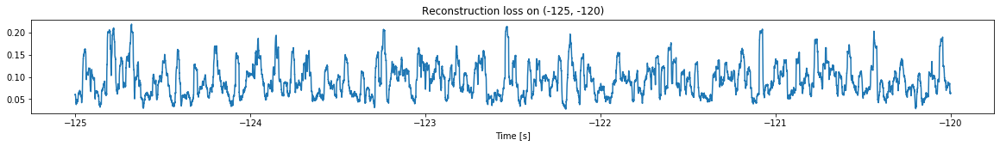

<--------
Entering sections:  (-120, -115)
-------->
Training for section:  (-125, -120)
Finished training, mean of the log(loss) is:  -1.7790436996057173
Triggering for section:  (-120, -115)
Using this mean for triggering: -1.7813986165057694


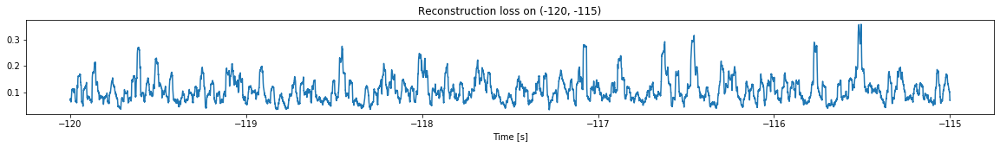

<--------
Entering sections:  (-115, -110)
-------->
Training for section:  (-120, -115)
Finished training, mean of the log(loss) is:  -1.7271730316667218
Triggering for section:  (-115, -110)
Using this mean for triggering: -1.7790436996057173


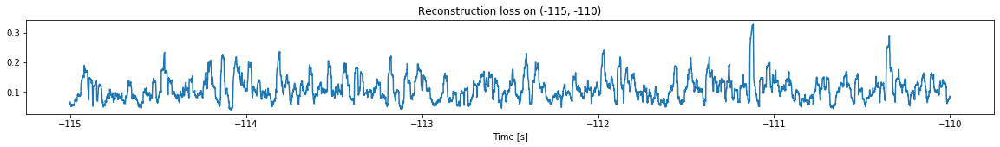

<--------
Entering sections:  (-110, -105)
-------->
Training for section:  (-115, -110)
Finished training, mean of the log(loss) is:  -1.7463618048314342
Triggering for section:  (-110, -105)
Using this mean for triggering: -1.7271730316667218


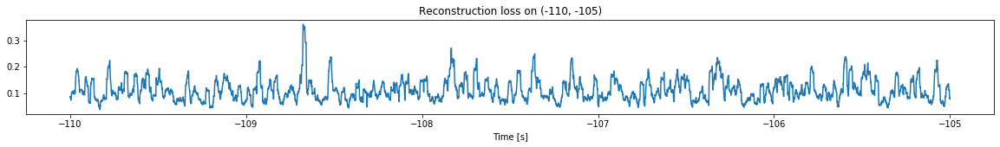

<--------
Entering sections:  (-105, -100)
-------->
Training for section:  (-110, -105)
Finished training, mean of the log(loss) is:  -1.8029175838898275
Triggering for section:  (-105, -100)
Using this mean for triggering: -1.7463618048314342


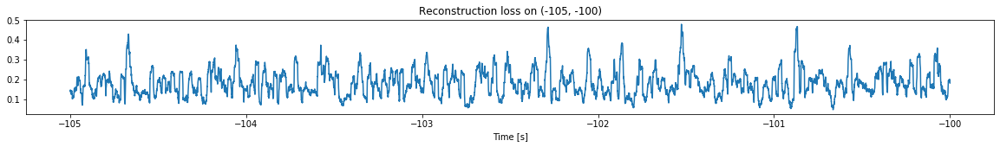

<--------
Entering sections:  (-100, -95)
-------->
Training for section:  (-105, -100)
Finished training, mean of the log(loss) is:  -1.7453682953776766
Triggering for section:  (-100, -95)
Using this mean for triggering: -1.8029175838898275


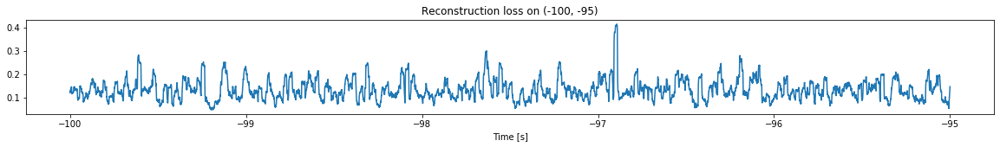

<--------
Entering sections:  (-95, -90)
-------->
Training for section:  (-100, -95)
Finished training, mean of the log(loss) is:  -1.730408030183403
Triggering for section:  (-95, -90)
Using this mean for triggering: -1.7453682953776766


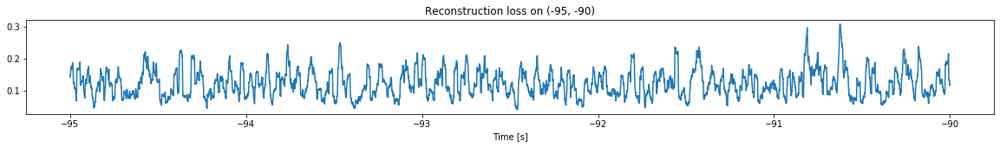

<--------
Entering sections:  (-90, -85)
-------->
Training for section:  (-95, -90)
Finished training, mean of the log(loss) is:  -1.7490110865030544
Triggering for section:  (-90, -85)
Using this mean for triggering: -1.730408030183403


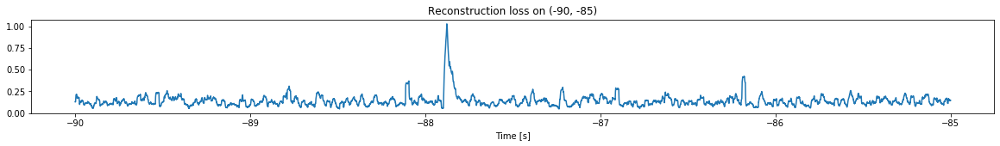

<--------
Entering sections:  (-85, -80)
-------->
Training for section:  (-90, -85)
Finished training, mean of the log(loss) is:  -1.76638378086407
Triggering for section:  (-85, -80)
Using this mean for triggering: -1.7490110865030544


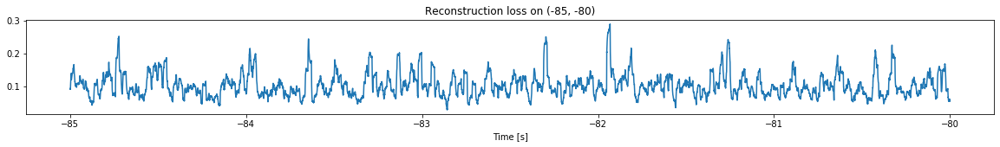

<--------
Entering sections:  (-80, -75)
-------->
Training for section:  (-85, -80)
Finished training, mean of the log(loss) is:  -1.7653107737846079
Triggering for section:  (-80, -75)
Using this mean for triggering: -1.76638378086407


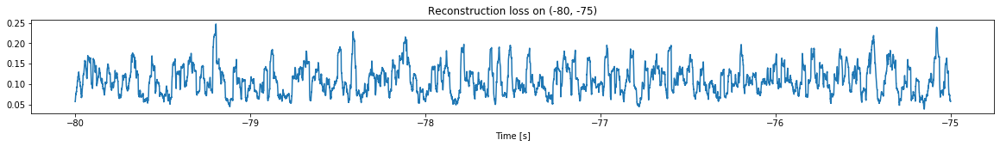

<--------
Entering sections:  (-75, -70)
-------->
Training for section:  (-80, -75)
Finished training, mean of the log(loss) is:  -1.8488713024506298
Triggering for section:  (-75, -70)
Using this mean for triggering: -1.7653107737846079


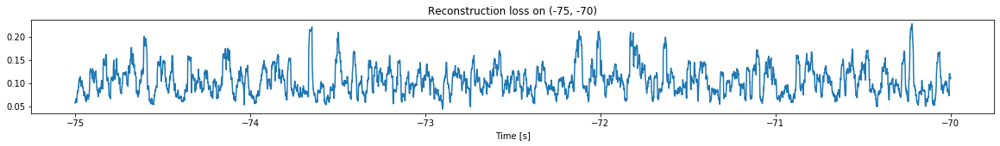

<--------
Entering sections:  (-70, -65)
-------->
Training for section:  (-75, -70)
Finished training, mean of the log(loss) is:  -1.6994908258693802
Triggering for section:  (-70, -65)
Using this mean for triggering: -1.8488713024506298


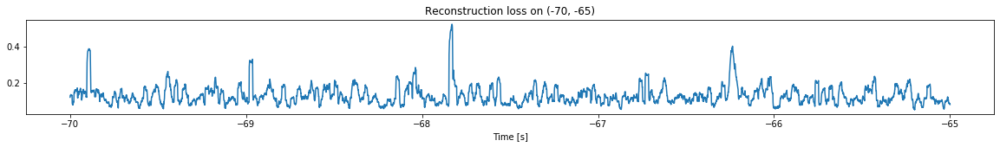

<--------
Entering sections:  (-65, -60)
-------->
Training for section:  (-70, -65)
Finished training, mean of the log(loss) is:  -1.7531106449423652
Triggering for section:  (-65, -60)
Using this mean for triggering: -1.6994908258693802


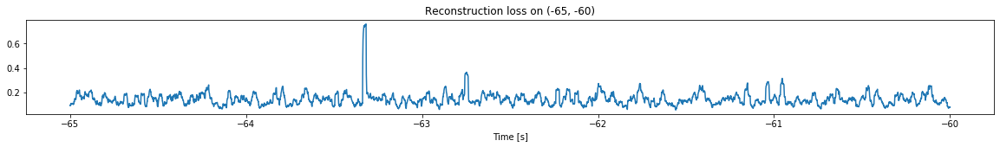

<--------
Entering sections:  (-60, -55)
-------->
Training for section:  (-65, -60)
Finished training, mean of the log(loss) is:  -1.7336797372330355
Triggering for section:  (-60, -55)
Using this mean for triggering: -1.7531106449423652


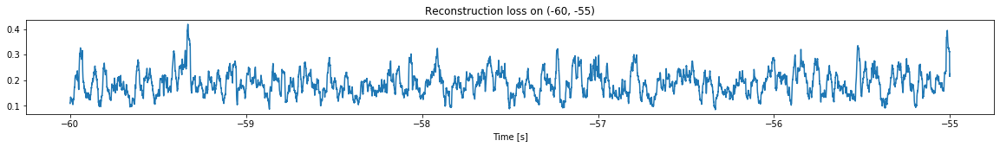

<--------
Entering sections:  (-55, -50)
-------->
Training for section:  (-60, -55)
Finished training, mean of the log(loss) is:  -1.7645839409355357
Triggering for section:  (-55, -50)
Using this mean for triggering: -1.7336797372330355


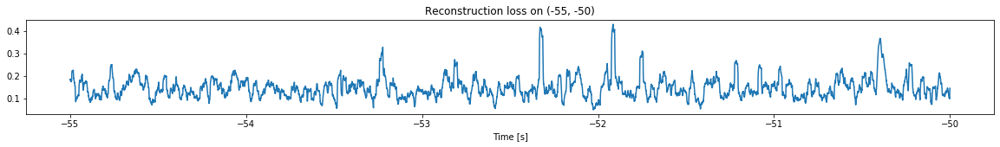

<--------
Entering sections:  (-50, -45)
-------->
Training for section:  (-55, -50)
Finished training, mean of the log(loss) is:  -1.794048048897753
Triggering for section:  (-50, -45)
Using this mean for triggering: -1.7645839409355357


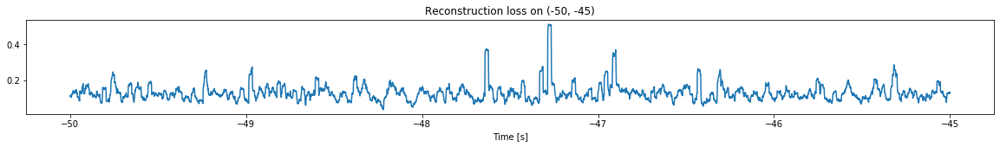

<--------
Entering sections:  (-45, -40)
-------->
Training for section:  (-50, -45)
Finished training, mean of the log(loss) is:  -1.7785655969417236
Triggering for section:  (-45, -40)
Using this mean for triggering: -1.794048048897753


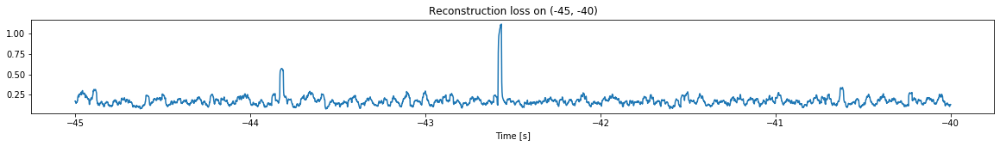

<--------
Entering sections:  (-40, -35)
-------->
Training for section:  (-45, -40)
Finished training, mean of the log(loss) is:  -1.7445150140162833
Triggering for section:  (-40, -35)
Using this mean for triggering: -1.7785655969417236


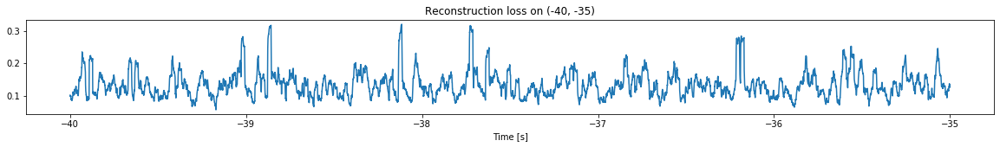

<--------
Entering sections:  (-35, -30)
-------->
Training for section:  (-40, -35)
Finished training, mean of the log(loss) is:  -1.7634961053937275
Triggering for section:  (-35, -30)
Using this mean for triggering: -1.7445150140162833


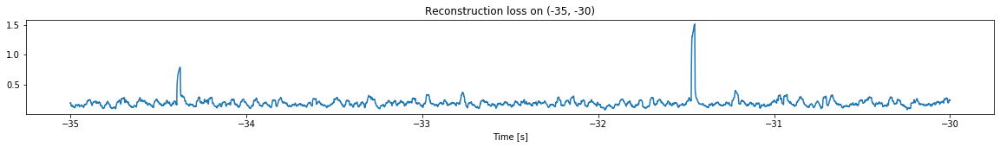

<--------
Entering sections:  (-30, -25)
-------->
Training for section:  (-35, -30)
Finished training, mean of the log(loss) is:  -1.7877431671171435
Triggering for section:  (-30, -25)
Using this mean for triggering: -1.7634961053937275


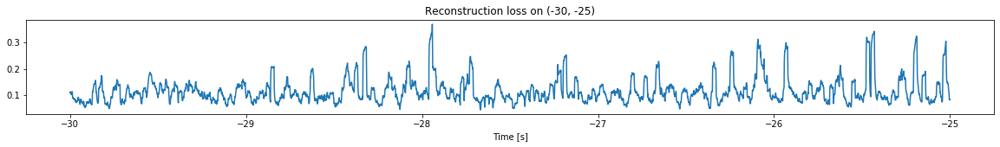

<--------
Entering sections:  (-25, -20)
-------->
Training for section:  (-30, -25)
Finished training, mean of the log(loss) is:  -1.789861710231151
Triggering for section:  (-25, -20)
Using this mean for triggering: -1.7877431671171435


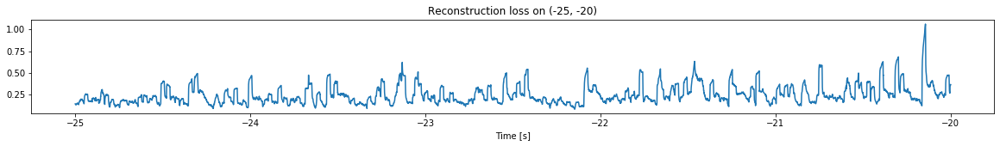

<--------
Entering sections:  (-20, -15)
-------->
Training for section:  (-25, -20)
Finished training, mean of the log(loss) is:  -1.7486540032900104
Triggering for section:  (-20, -15)
Using this mean for triggering: -1.789861710231151


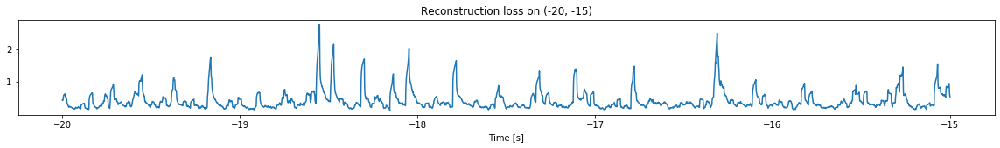

<--------
Entering sections:  (-15, -10)
-------->
Training for section:  (-20, -15)
Finished training, mean of the log(loss) is:  -1.7092444575805428
Triggering for section:  (-15, -10)
Using this mean for triggering: -1.7486540032900104


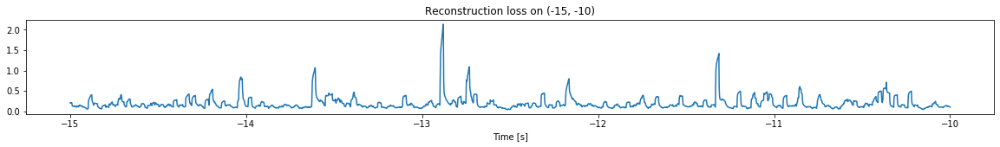

<--------
Entering sections:  (-10, -5)
-------->
Training for section:  (-15, -10)
Finished training, mean of the log(loss) is:  -1.7713451030173206
Triggering for section:  (-10, -5)
Using this mean for triggering: -1.7092444575805428


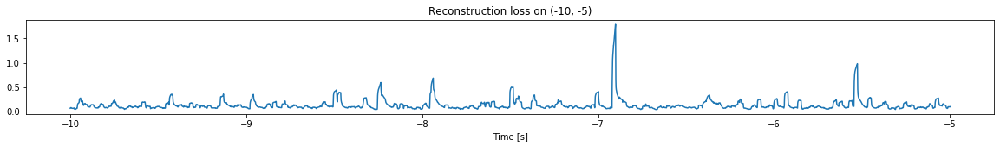

<--------
Entering sections:  (-5, 0)
-------->
Training for section:  (-10, -5)
Finished training, mean of the log(loss) is:  -1.870808699709086
Triggering for section:  (-5, 0)
Using this mean for triggering: -1.7713451030173206


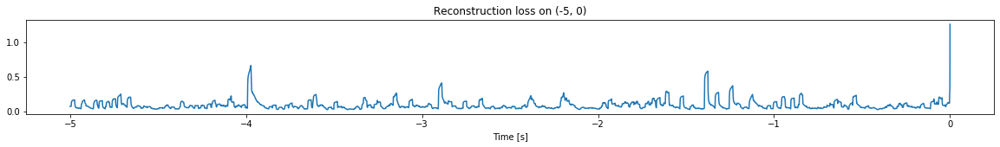

<--------


In [13]:
simulation("./data/Ramp26/", 5, (-300,0))

Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
All data's shape:  (2997500, 12)
Flushing input history
Number of sections: 60
Entering sections:  (-300, -295)
-------->
Entering sections:  (-295, -290)
-------->
Training for section:  (None, -295)
Finished training, mean of the log(loss) is:  -1.5355945653693157
<--------
Entering sections:  (-290, -285)
-------->
Training for section:  (-295, -290)
Finished training, mean of the log(loss) is:  -1.5910204945883186
Triggering for section:  (-290, -285)
Using this mean for triggering: -1.5355945653693157


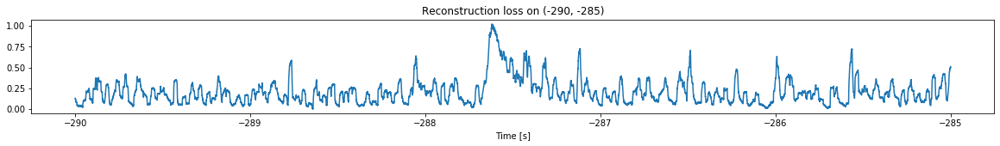

<--------
Entering sections:  (-285, -280)
-------->
Training for section:  (-290, -285)
Finished training, mean of the log(loss) is:  -1.535113379249222
Triggering for section:  (-285, -280)
Using this mean for triggering: -1.5910204945883186


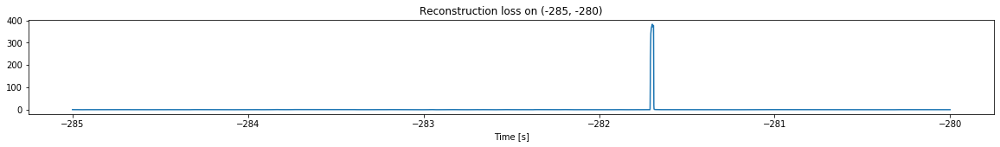

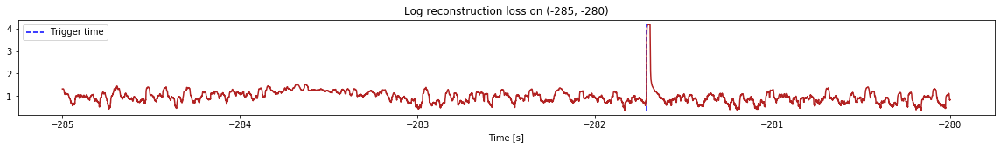

Triggered at:  -281.7092


-281.7092

In [14]:
simulation("./data/Ramp27/", 5, (-300,0))

Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
All data's shape:  (2997500, 12)
Flushing input history
Number of sections: 60
Entering sections:  (-300, -295)
-------->
Entering sections:  (-295, -290)
-------->
Training for section:  (None, -295)
Finished training, mean of the log(loss) is:  -1.7100277886115902
<--------
Entering sections:  (-290, -285)
-------->
Training for section:  (-295, -290)
Finished training, mean of the log(loss) is:  -1.7568773088455942
Triggering for section:  (-290, -285)
Using this mean for triggering: -1.7100277886115902


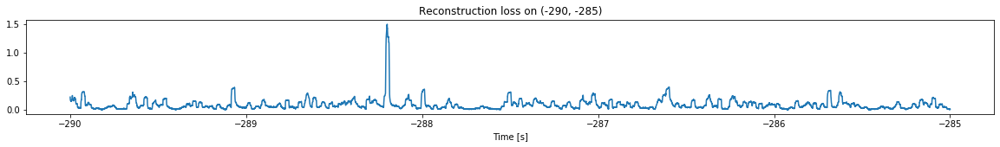

<--------
Entering sections:  (-285, -280)
-------->
Training for section:  (-290, -285)
Finished training, mean of the log(loss) is:  -1.8270911007165882
Triggering for section:  (-285, -280)
Using this mean for triggering: -1.7568773088455942


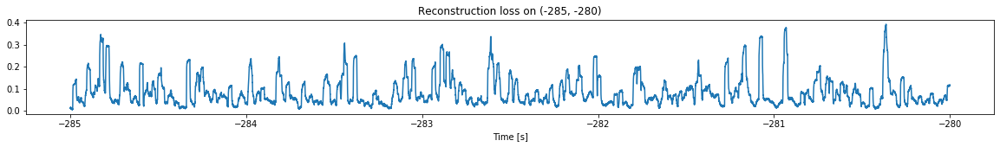

<--------
Entering sections:  (-280, -275)
-------->
Training for section:  (-285, -280)
Finished training, mean of the log(loss) is:  -1.750283562282871
Triggering for section:  (-280, -275)
Using this mean for triggering: -1.8270911007165882


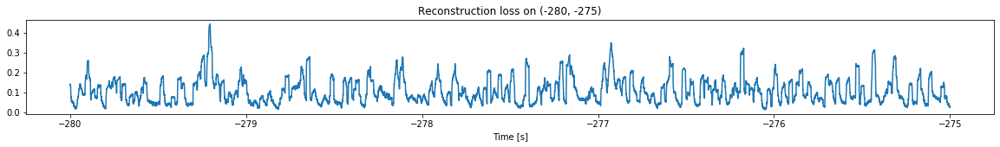

<--------
Entering sections:  (-275, -270)
-------->
Training for section:  (-280, -275)
Finished training, mean of the log(loss) is:  -1.8085352562280508
Triggering for section:  (-275, -270)
Using this mean for triggering: -1.750283562282871


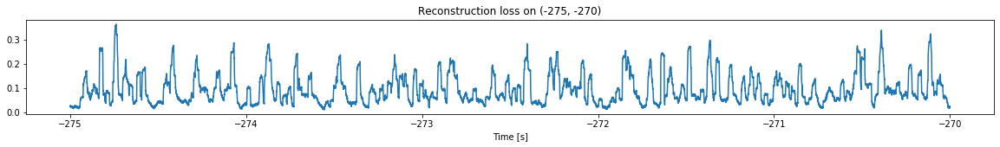

<--------
Entering sections:  (-270, -265)
-------->
Training for section:  (-275, -270)
Finished training, mean of the log(loss) is:  -1.817962074683568
Triggering for section:  (-270, -265)
Using this mean for triggering: -1.8085352562280508


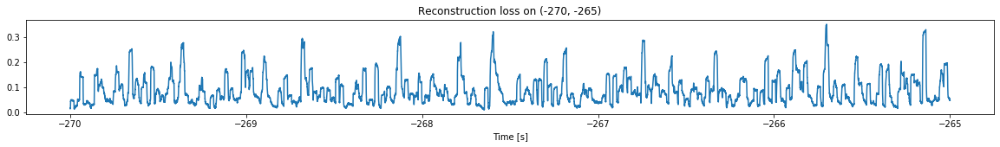

<--------
Entering sections:  (-265, -260)
-------->
Training for section:  (-270, -265)
Finished training, mean of the log(loss) is:  -1.7730672591054106
Triggering for section:  (-265, -260)
Using this mean for triggering: -1.817962074683568


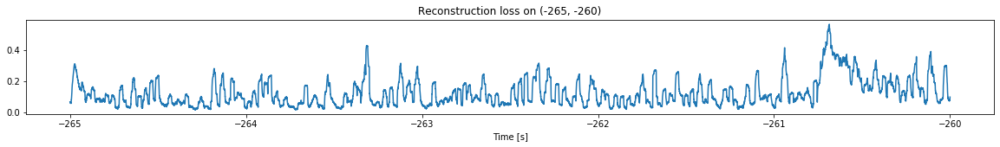

<--------
Entering sections:  (-260, -255)
-------->
Training for section:  (-265, -260)
Finished training, mean of the log(loss) is:  -1.8041140197519412
Triggering for section:  (-260, -255)
Using this mean for triggering: -1.7730672591054106


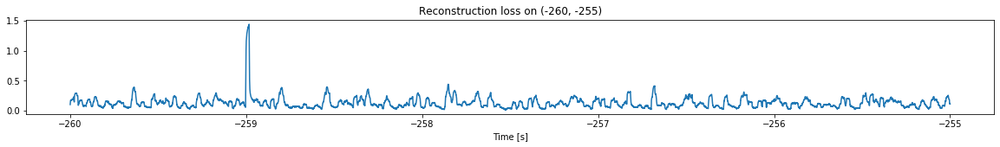

<--------
Entering sections:  (-255, -250)
-------->
Training for section:  (-260, -255)
Finished training, mean of the log(loss) is:  -1.8280288084538425
Triggering for section:  (-255, -250)
Using this mean for triggering: -1.8041140197519412


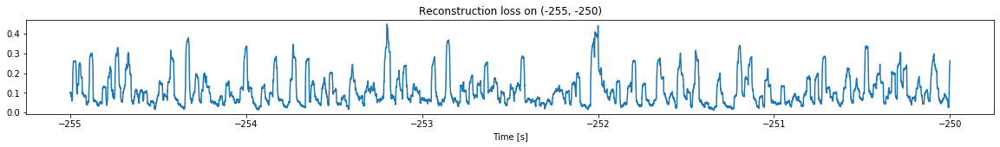

<--------
Entering sections:  (-250, -245)
-------->
Training for section:  (-255, -250)
Finished training, mean of the log(loss) is:  -1.8615035475440171
Triggering for section:  (-250, -245)
Using this mean for triggering: -1.8280288084538425


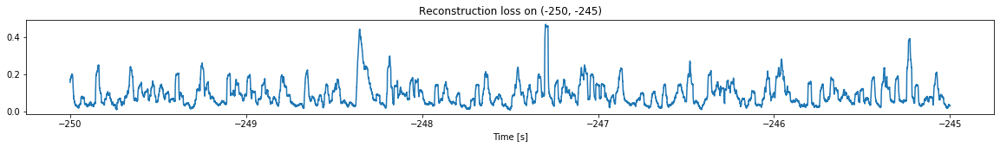

<--------
Entering sections:  (-245, -240)
-------->
Training for section:  (-250, -245)
Finished training, mean of the log(loss) is:  -1.7608969436840893
Triggering for section:  (-245, -240)
Using this mean for triggering: -1.8615035475440171


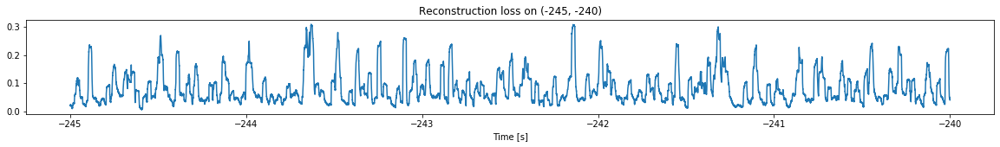

<--------
Entering sections:  (-240, -235)
-------->
Training for section:  (-245, -240)
Finished training, mean of the log(loss) is:  -1.7330009325284288
Triggering for section:  (-240, -235)
Using this mean for triggering: -1.7608969436840893


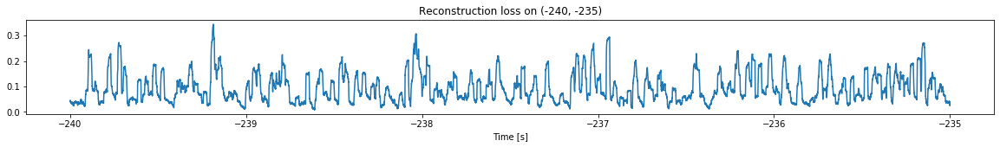

<--------
Entering sections:  (-235, -230)
-------->
Training for section:  (-240, -235)
Finished training, mean of the log(loss) is:  -1.743254445449249
Triggering for section:  (-235, -230)
Using this mean for triggering: -1.7330009325284288


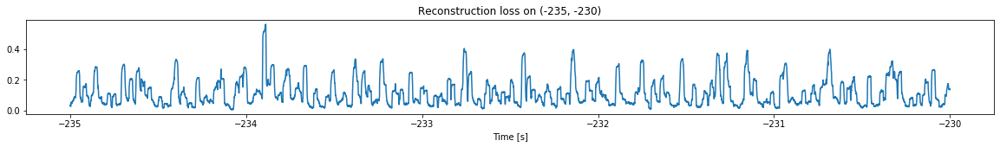

<--------
Entering sections:  (-230, -225)
-------->
Training for section:  (-235, -230)
Finished training, mean of the log(loss) is:  -1.7916392015674423
Triggering for section:  (-230, -225)
Using this mean for triggering: -1.743254445449249


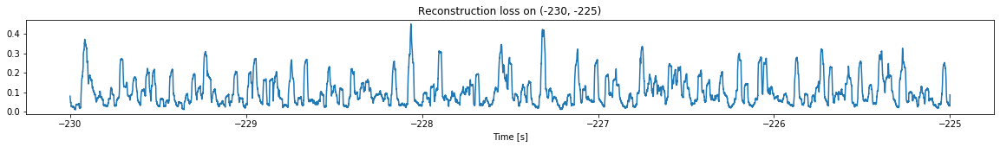

<--------
Entering sections:  (-225, -220)
-------->
Training for section:  (-230, -225)
Finished training, mean of the log(loss) is:  -1.5744753332476433
Triggering for section:  (-225, -220)
Using this mean for triggering: -1.7916392015674423


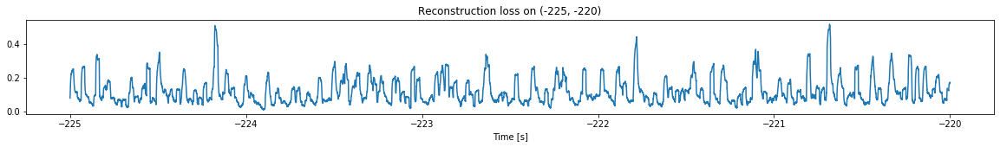

<--------
Entering sections:  (-220, -215)
-------->
Training for section:  (-225, -220)
Finished training, mean of the log(loss) is:  -1.6629765845123488
Triggering for section:  (-220, -215)
Using this mean for triggering: -1.5744753332476433


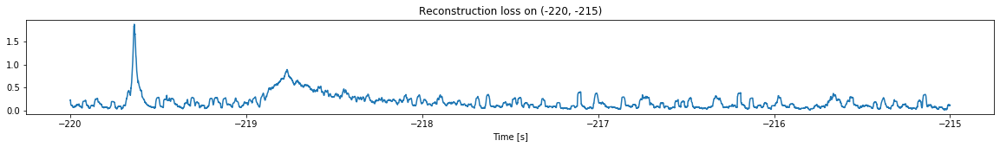

<--------
Entering sections:  (-215, -210)
-------->
Training for section:  (-220, -215)
Finished training, mean of the log(loss) is:  -1.7002041983680927
Triggering for section:  (-215, -210)
Using this mean for triggering: -1.6629765845123488


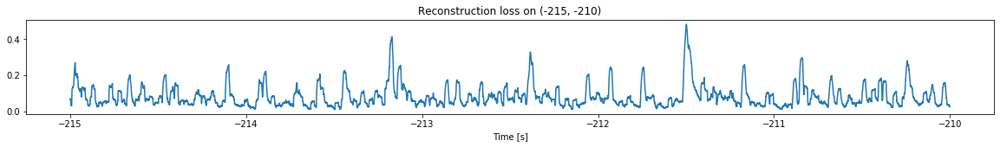

<--------
Entering sections:  (-210, -205)
-------->
Training for section:  (-215, -210)
Finished training, mean of the log(loss) is:  -1.857501059652761
Triggering for section:  (-210, -205)
Using this mean for triggering: -1.7002041983680927


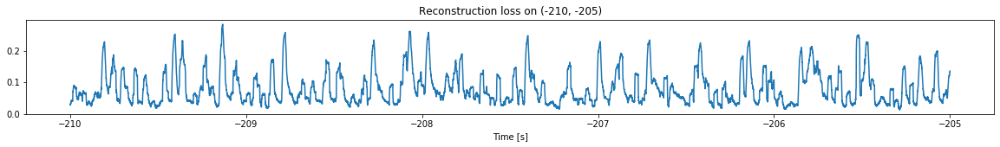

<--------
Entering sections:  (-205, -200)
-------->
Training for section:  (-210, -205)
Finished training, mean of the log(loss) is:  -1.8994924616557438
Triggering for section:  (-205, -200)
Using this mean for triggering: -1.857501059652761


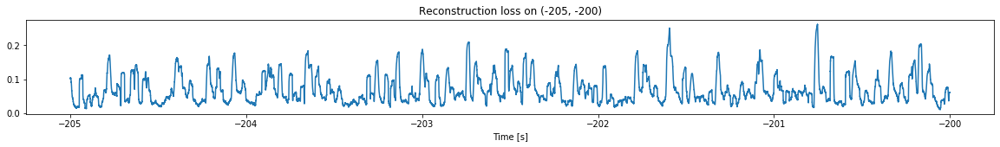

<--------
Entering sections:  (-200, -195)
-------->
Training for section:  (-205, -200)
Finished training, mean of the log(loss) is:  -1.8644764320375389
Triggering for section:  (-200, -195)
Using this mean for triggering: -1.8994924616557438


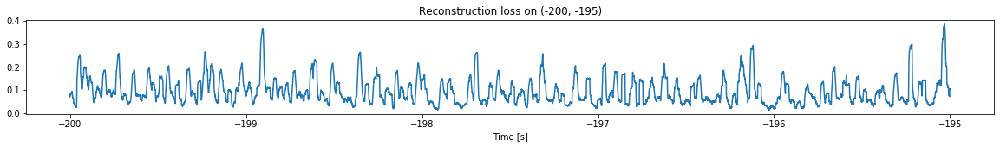

<--------
Entering sections:  (-195, -190)
-------->
Training for section:  (-200, -195)
Finished training, mean of the log(loss) is:  -1.8201001087613493
Triggering for section:  (-195, -190)
Using this mean for triggering: -1.8644764320375389


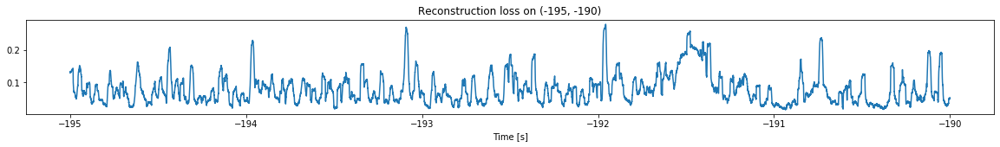

<--------
Entering sections:  (-190, -185)
-------->
Training for section:  (-195, -190)
Finished training, mean of the log(loss) is:  -1.831610493337358
Triggering for section:  (-190, -185)
Using this mean for triggering: -1.8201001087613493


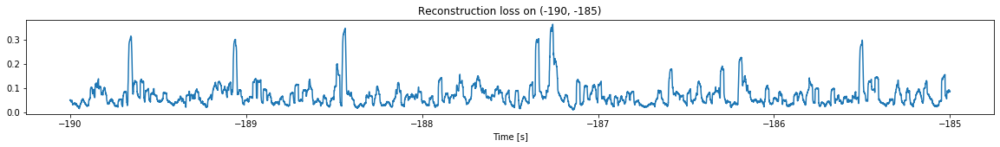

<--------
Entering sections:  (-185, -180)
-------->
Training for section:  (-190, -185)
Finished training, mean of the log(loss) is:  -1.9205071677035388
Triggering for section:  (-185, -180)
Using this mean for triggering: -1.831610493337358


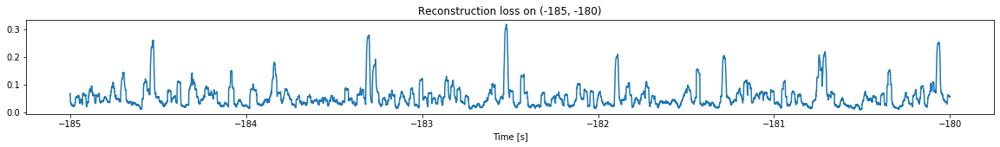

<--------
Entering sections:  (-180, -175)
-------->
Training for section:  (-185, -180)
Finished training, mean of the log(loss) is:  -1.8261095193314825
Triggering for section:  (-180, -175)
Using this mean for triggering: -1.9205071677035388


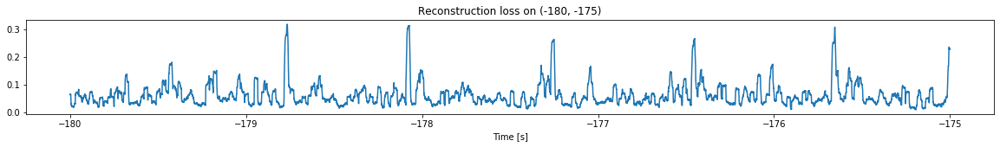

<--------
Entering sections:  (-175, -170)
-------->
Training for section:  (-180, -175)
Finished training, mean of the log(loss) is:  -1.8806405569632394
Triggering for section:  (-175, -170)
Using this mean for triggering: -1.8261095193314825


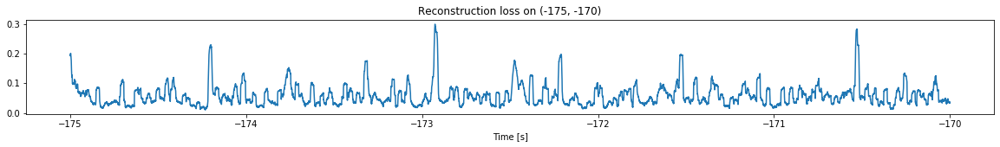

<--------
Entering sections:  (-170, -165)
-------->
Training for section:  (-175, -170)
Finished training, mean of the log(loss) is:  -1.9079179831760635
Triggering for section:  (-170, -165)
Using this mean for triggering: -1.8806405569632394


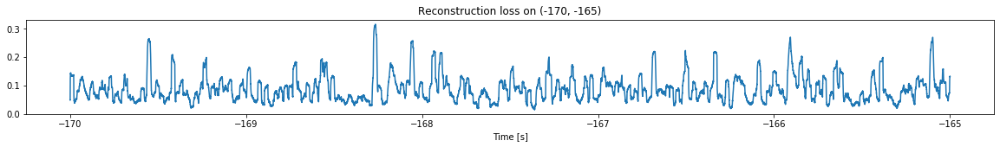

<--------
Entering sections:  (-165, -160)
-------->
Training for section:  (-170, -165)
Finished training, mean of the log(loss) is:  -1.954302450641443
Triggering for section:  (-165, -160)
Using this mean for triggering: -1.9079179831760635


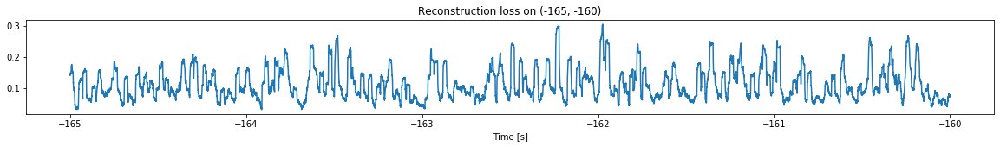

<--------
Entering sections:  (-160, -155)
-------->
Training for section:  (-165, -160)
Finished training, mean of the log(loss) is:  -1.8320323417708566
Triggering for section:  (-160, -155)
Using this mean for triggering: -1.954302450641443


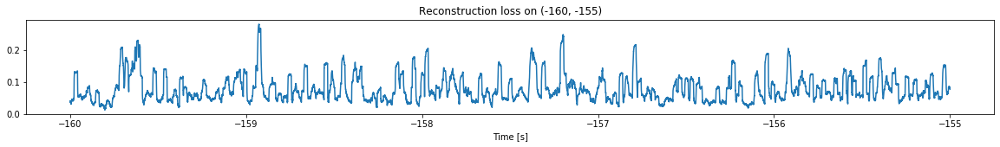

<--------
Entering sections:  (-155, -150)
-------->
Training for section:  (-160, -155)
Finished training, mean of the log(loss) is:  -1.952648046389388
Triggering for section:  (-155, -150)
Using this mean for triggering: -1.8320323417708566


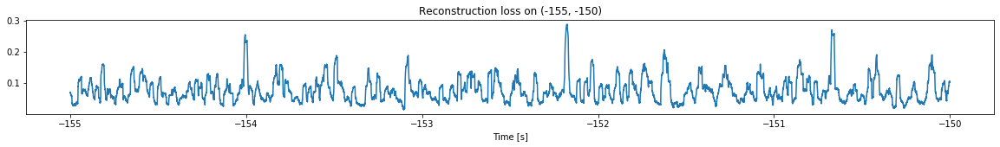

<--------
Entering sections:  (-150, -145)
-------->
Training for section:  (-155, -150)
Finished training, mean of the log(loss) is:  -1.9599434002808462
Triggering for section:  (-150, -145)
Using this mean for triggering: -1.952648046389388


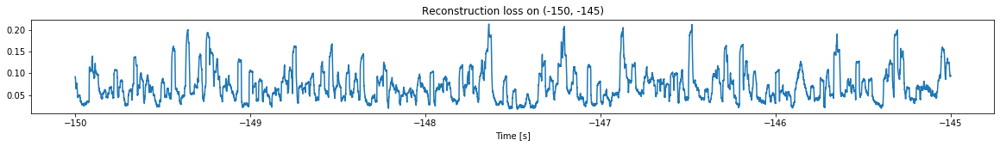

<--------
Entering sections:  (-145, -140)
-------->
Training for section:  (-150, -145)
Finished training, mean of the log(loss) is:  -1.9553940550306046
Triggering for section:  (-145, -140)
Using this mean for triggering: -1.9599434002808462


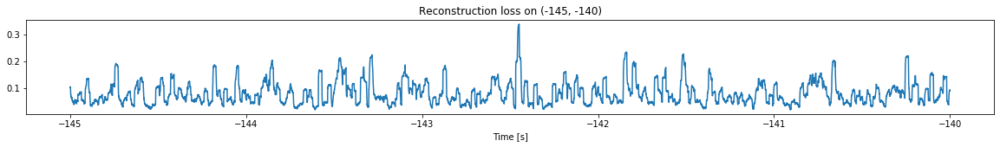

<--------
Entering sections:  (-140, -135)
-------->
Training for section:  (-145, -140)
Finished training, mean of the log(loss) is:  -1.9504526199270984
Triggering for section:  (-140, -135)
Using this mean for triggering: -1.9553940550306046


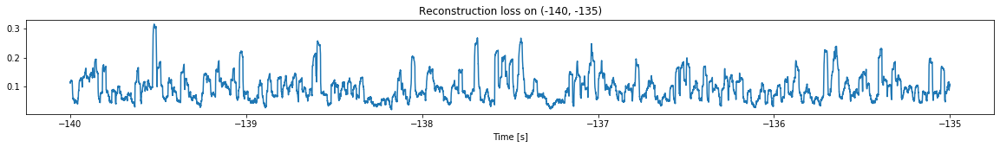

<--------
Entering sections:  (-135, -130)
-------->
Training for section:  (-140, -135)
Finished training, mean of the log(loss) is:  -1.8652911064882036
Triggering for section:  (-135, -130)
Using this mean for triggering: -1.9504526199270984


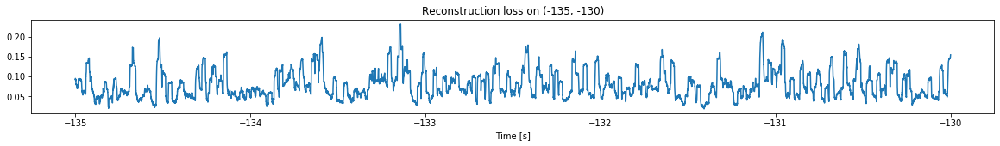

<--------
Entering sections:  (-130, -125)
-------->
Training for section:  (-135, -130)
Finished training, mean of the log(loss) is:  -1.9198227650707083
Triggering for section:  (-130, -125)
Using this mean for triggering: -1.8652911064882036


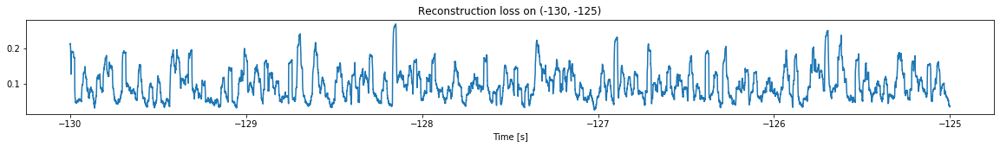

<--------
Entering sections:  (-125, -120)
-------->
Training for section:  (-130, -125)
Finished training, mean of the log(loss) is:  -1.9502268895207515
Triggering for section:  (-125, -120)
Using this mean for triggering: -1.9198227650707083


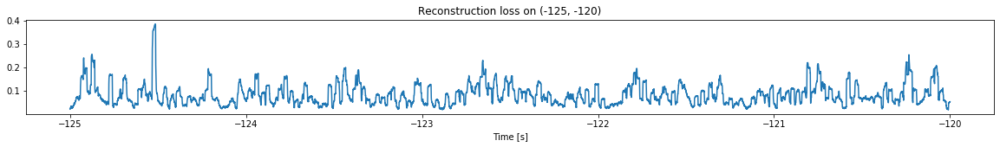

<--------
Entering sections:  (-120, -115)
-------->
Training for section:  (-125, -120)
Finished training, mean of the log(loss) is:  -1.8580744499061876
Triggering for section:  (-120, -115)
Using this mean for triggering: -1.9502268895207515


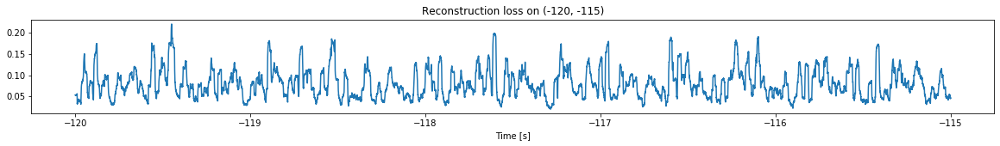

<--------
Entering sections:  (-115, -110)
-------->
Training for section:  (-120, -115)
Finished training, mean of the log(loss) is:  -1.819141550960449
Triggering for section:  (-115, -110)
Using this mean for triggering: -1.8580744499061876


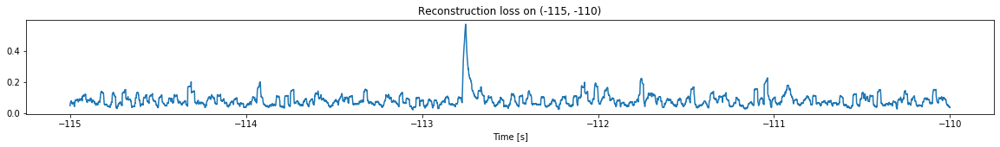

<--------
Entering sections:  (-110, -105)
-------->
Training for section:  (-115, -110)
Finished training, mean of the log(loss) is:  -1.8662135759733314
Triggering for section:  (-110, -105)
Using this mean for triggering: -1.819141550960449


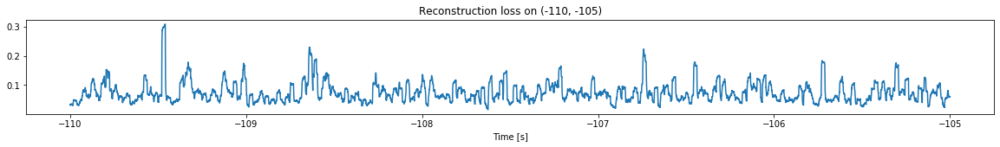

<--------
Entering sections:  (-105, -100)
-------->
Training for section:  (-110, -105)
Finished training, mean of the log(loss) is:  -1.9321936690741999
Triggering for section:  (-105, -100)
Using this mean for triggering: -1.8662135759733314


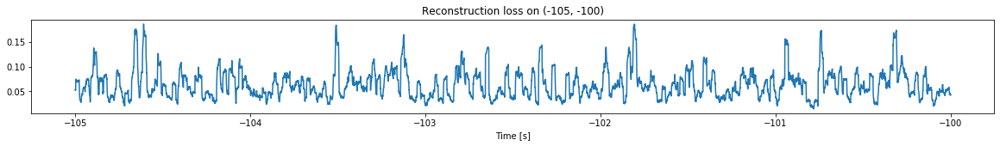

<--------
Entering sections:  (-100, -95)
-------->
Training for section:  (-105, -100)
Finished training, mean of the log(loss) is:  -1.9571999369339008
Triggering for section:  (-100, -95)
Using this mean for triggering: -1.9321936690741999


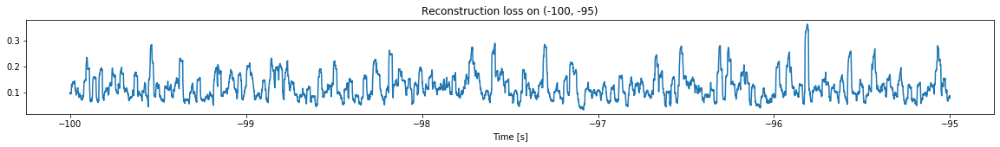

<--------
Entering sections:  (-95, -90)
-------->
Training for section:  (-100, -95)
Finished training, mean of the log(loss) is:  -1.7826112710265465
Triggering for section:  (-95, -90)
Using this mean for triggering: -1.9571999369339008


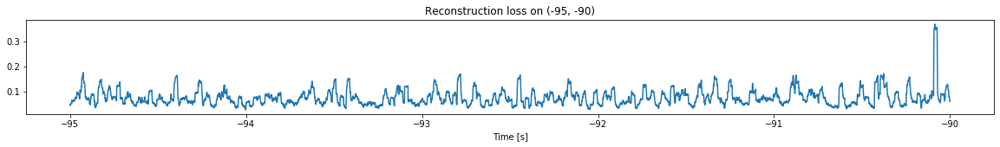

<--------
Entering sections:  (-90, -85)
-------->
Training for section:  (-95, -90)
Finished training, mean of the log(loss) is:  -1.847869603897234
Triggering for section:  (-90, -85)
Using this mean for triggering: -1.7826112710265465


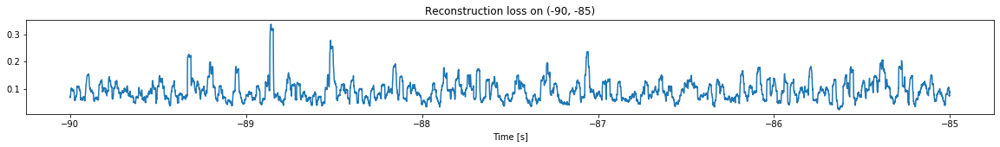

<--------
Entering sections:  (-85, -80)
-------->
Training for section:  (-90, -85)
Finished training, mean of the log(loss) is:  -1.829619389829689
Triggering for section:  (-85, -80)
Using this mean for triggering: -1.847869603897234


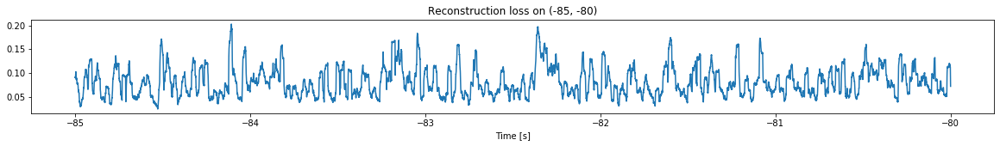

<--------
Entering sections:  (-80, -75)
-------->
Training for section:  (-85, -80)
Finished training, mean of the log(loss) is:  -1.8444315336606376
Triggering for section:  (-80, -75)
Using this mean for triggering: -1.829619389829689


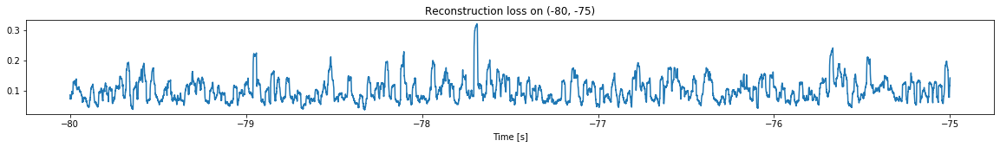

<--------
Entering sections:  (-75, -70)
-------->
Training for section:  (-80, -75)
Finished training, mean of the log(loss) is:  -1.7956296776799516
Triggering for section:  (-75, -70)
Using this mean for triggering: -1.8444315336606376


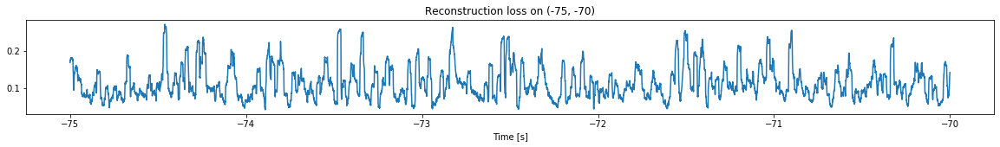

<--------
Entering sections:  (-70, -65)
-------->
Training for section:  (-75, -70)
Finished training, mean of the log(loss) is:  -1.885820899163658
Triggering for section:  (-70, -65)
Using this mean for triggering: -1.7956296776799516


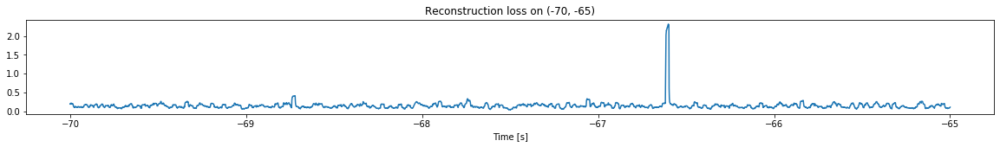

<--------
Entering sections:  (-65, -60)
-------->
Training for section:  (-70, -65)
Finished training, mean of the log(loss) is:  -1.9022876764125654
Triggering for section:  (-65, -60)
Using this mean for triggering: -1.885820899163658


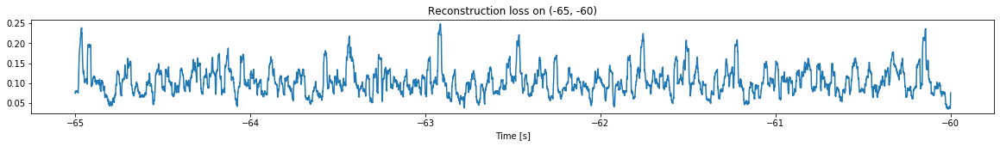

<--------
Entering sections:  (-60, -55)
-------->
Training for section:  (-65, -60)
Finished training, mean of the log(loss) is:  -1.9379591335435733
Triggering for section:  (-60, -55)
Using this mean for triggering: -1.9022876764125654


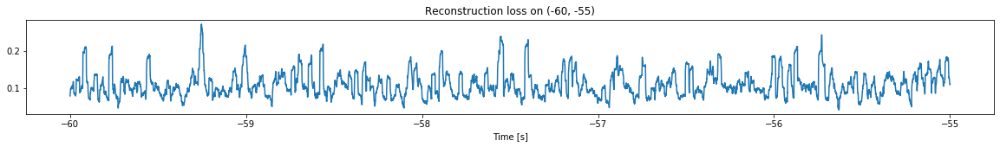

<--------
Entering sections:  (-55, -50)
-------->
Training for section:  (-60, -55)
Finished training, mean of the log(loss) is:  -1.8543018714770554
Triggering for section:  (-55, -50)
Using this mean for triggering: -1.9379591335435733


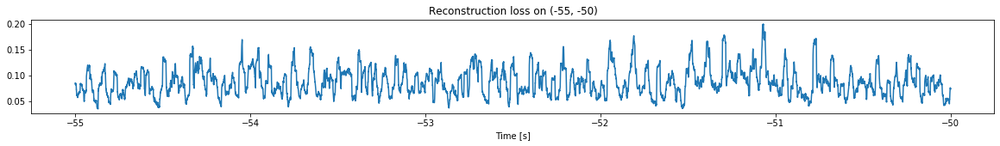

<--------
Entering sections:  (-50, -45)
-------->
Training for section:  (-55, -50)
Finished training, mean of the log(loss) is:  -1.8856822318048214
Triggering for section:  (-50, -45)
Using this mean for triggering: -1.8543018714770554


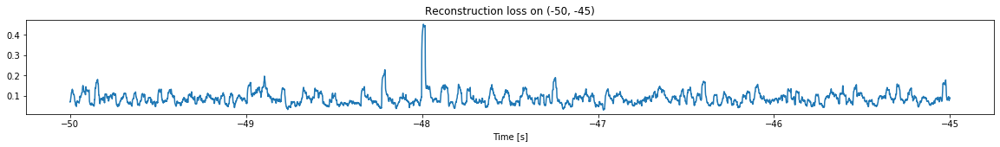

<--------
Entering sections:  (-45, -40)
-------->
Training for section:  (-50, -45)
Finished training, mean of the log(loss) is:  -1.8345418485729996
Triggering for section:  (-45, -40)
Using this mean for triggering: -1.8856822318048214


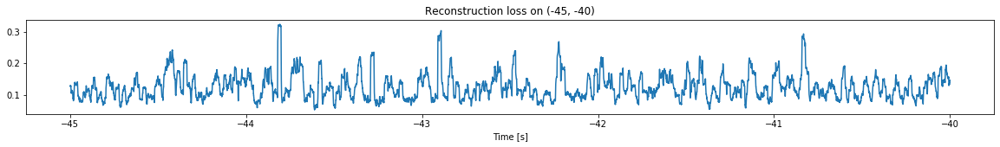

<--------
Entering sections:  (-40, -35)
-------->
Training for section:  (-45, -40)
Finished training, mean of the log(loss) is:  -1.789259403317096
Triggering for section:  (-40, -35)
Using this mean for triggering: -1.8345418485729996


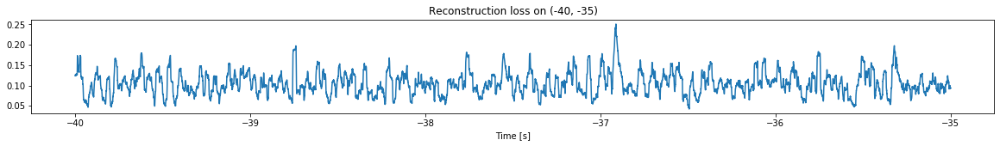

<--------
Entering sections:  (-35, -30)
-------->
Training for section:  (-40, -35)
Finished training, mean of the log(loss) is:  -1.828077985613831
Triggering for section:  (-35, -30)
Using this mean for triggering: -1.789259403317096


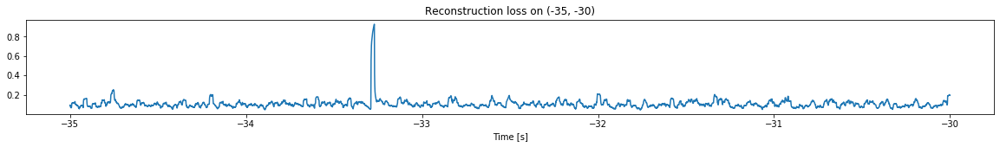

<--------
Entering sections:  (-30, -25)
-------->
Training for section:  (-35, -30)
Finished training, mean of the log(loss) is:  -1.8250866612931826
Triggering for section:  (-30, -25)
Using this mean for triggering: -1.828077985613831


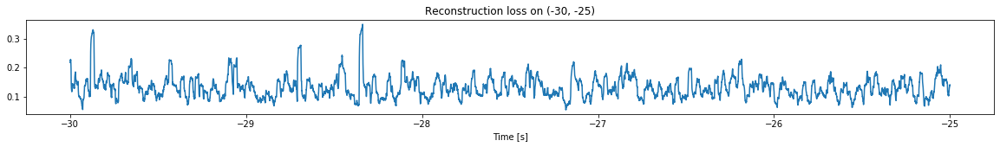

<--------
Entering sections:  (-25, -20)
-------->
Training for section:  (-30, -25)
Finished training, mean of the log(loss) is:  -1.8374968627666262
Triggering for section:  (-25, -20)
Using this mean for triggering: -1.8250866612931826


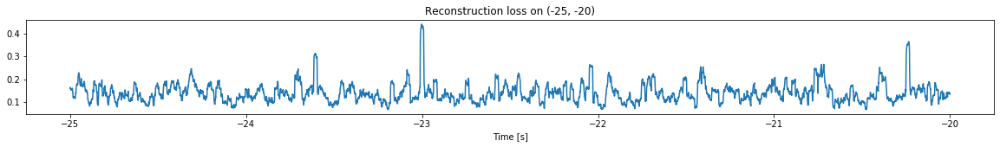

<--------
Entering sections:  (-20, -15)
-------->
Training for section:  (-25, -20)
Finished training, mean of the log(loss) is:  -1.8122063064088838
Triggering for section:  (-20, -15)
Using this mean for triggering: -1.8374968627666262


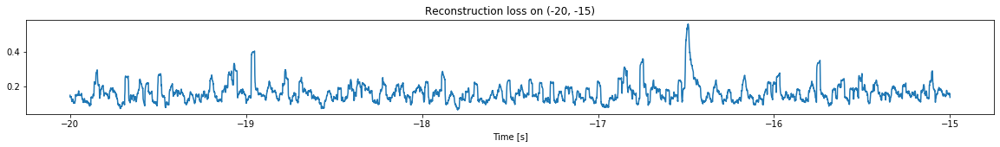

<--------
Entering sections:  (-15, -10)
-------->
Training for section:  (-20, -15)
Finished training, mean of the log(loss) is:  -1.7893861975770777
Triggering for section:  (-15, -10)
Using this mean for triggering: -1.8122063064088838


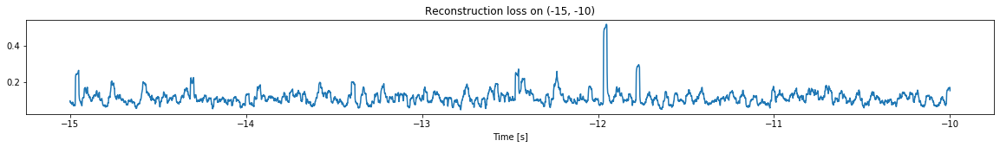

<--------
Entering sections:  (-10, -5)
-------->
Training for section:  (-15, -10)
Finished training, mean of the log(loss) is:  -1.8332637589796916
Triggering for section:  (-10, -5)
Using this mean for triggering: -1.7893861975770777


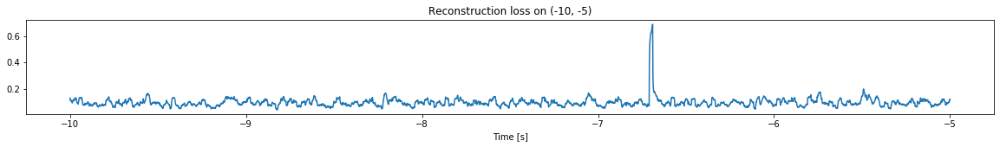

<--------
Entering sections:  (-5, 0)
-------->
Training for section:  (-10, -5)
Finished training, mean of the log(loss) is:  -1.831356795938285
Triggering for section:  (-5, 0)
Using this mean for triggering: -1.8332637589796916


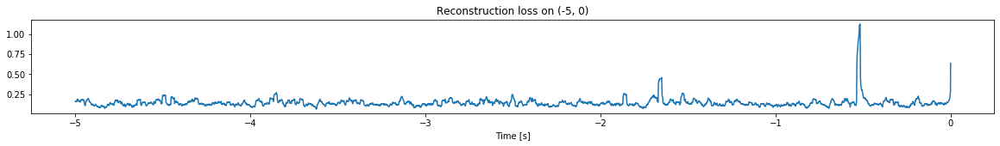

<--------


In [15]:
simulation("./data/Ramp28/", 5, (-300,0))

Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
All data's shape:  (2997500, 12)
Flushing input history
Number of sections: 60
Entering sections:  (-300, -295)
-------->
Entering sections:  (-295, -290)
-------->
Training for section:  (None, -295)
Finished training, mean of the log(loss) is:  -1.5212875490404603
<--------
Entering sections:  (-290, -285)
-------->
Training for section:  (-295, -290)
Finished training, mean of the log(loss) is:  -1.5225890589452686
Triggering for section:  (-290, -285)
Using this mean for triggering: -1.5212875490404603


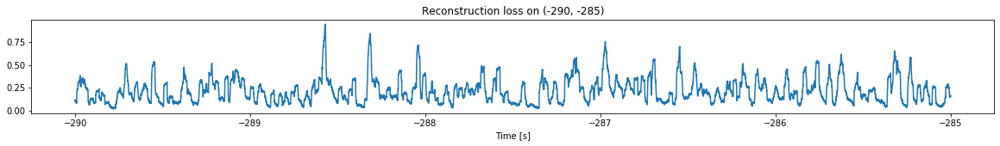

<--------
Entering sections:  (-285, -280)
-------->
Training for section:  (-290, -285)
Finished training, mean of the log(loss) is:  -1.4780038351987903
Triggering for section:  (-285, -280)
Using this mean for triggering: -1.5225890589452686


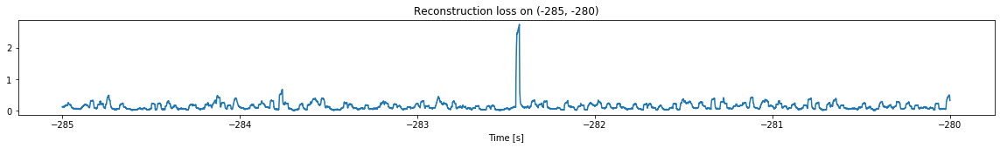

<--------
Entering sections:  (-280, -275)
-------->
Training for section:  (-285, -280)
Finished training, mean of the log(loss) is:  -1.6254026858304673
Triggering for section:  (-280, -275)
Using this mean for triggering: -1.4780038351987903


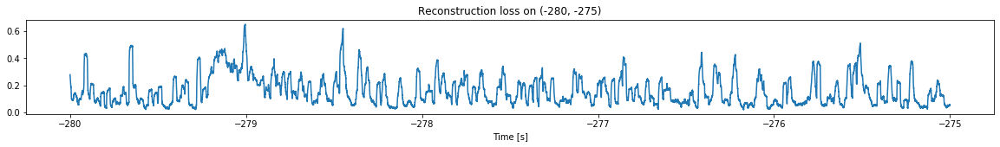

<--------
Entering sections:  (-275, -270)
-------->
Training for section:  (-280, -275)
Finished training, mean of the log(loss) is:  -1.6321508107262606
Triggering for section:  (-275, -270)
Using this mean for triggering: -1.6254026858304673


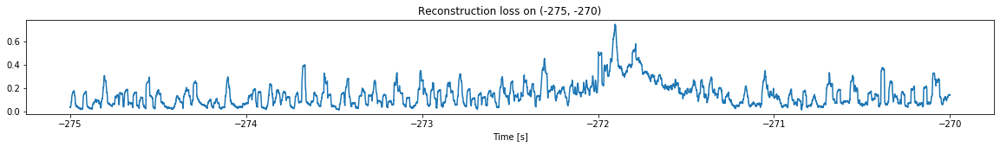

<--------
Entering sections:  (-270, -265)
-------->
Training for section:  (-275, -270)
Finished training, mean of the log(loss) is:  -1.6008329647176156
Triggering for section:  (-270, -265)
Using this mean for triggering: -1.6321508107262606


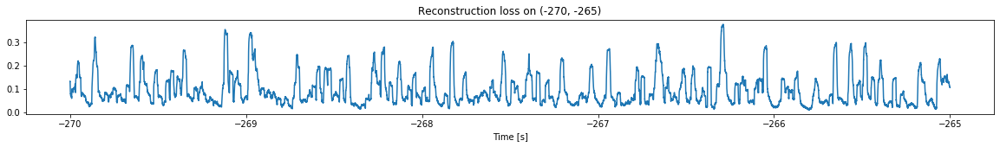

<--------
Entering sections:  (-265, -260)
-------->
Training for section:  (-270, -265)
Finished training, mean of the log(loss) is:  -1.7330374703628004
Triggering for section:  (-265, -260)
Using this mean for triggering: -1.6008329647176156


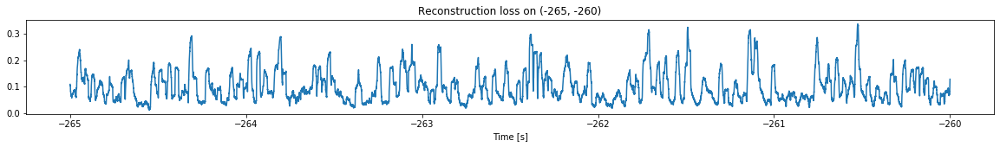

<--------
Entering sections:  (-260, -255)
-------->
Training for section:  (-265, -260)
Finished training, mean of the log(loss) is:  -1.754578426686483
Triggering for section:  (-260, -255)
Using this mean for triggering: -1.7330374703628004


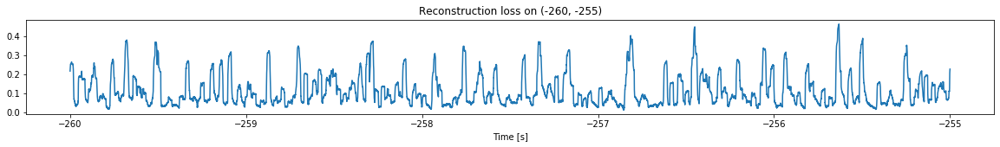

<--------
Entering sections:  (-255, -250)
-------->
Training for section:  (-260, -255)
Finished training, mean of the log(loss) is:  -1.7017523106226298
Triggering for section:  (-255, -250)
Using this mean for triggering: -1.754578426686483


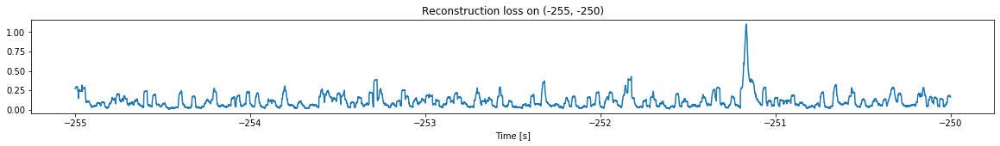

<--------
Entering sections:  (-250, -245)
-------->
Training for section:  (-255, -250)
Finished training, mean of the log(loss) is:  -1.6956879627397714
Triggering for section:  (-250, -245)
Using this mean for triggering: -1.7017523106226298


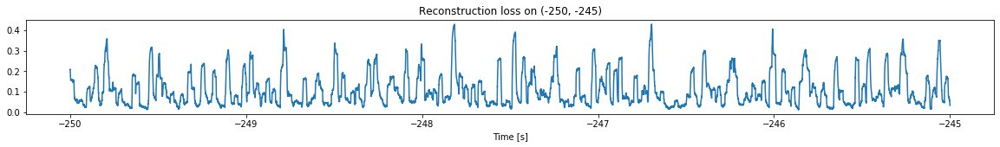

<--------
Entering sections:  (-245, -240)
-------->
Training for section:  (-250, -245)
Finished training, mean of the log(loss) is:  -1.7787211401196146
Triggering for section:  (-245, -240)
Using this mean for triggering: -1.6956879627397714


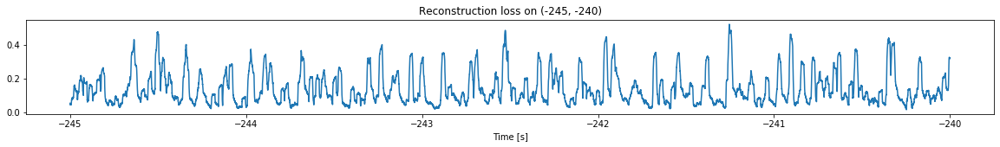

<--------
Entering sections:  (-240, -235)
-------->
Training for section:  (-245, -240)
Finished training, mean of the log(loss) is:  -1.7798931296104241
Triggering for section:  (-240, -235)
Using this mean for triggering: -1.7787211401196146


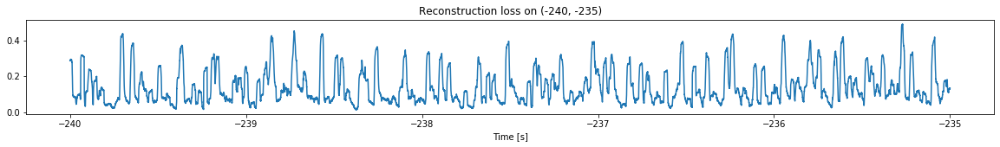

<--------
Entering sections:  (-235, -230)
-------->
Training for section:  (-240, -235)
Finished training, mean of the log(loss) is:  -1.7413312165789576
Triggering for section:  (-235, -230)
Using this mean for triggering: -1.7798931296104241


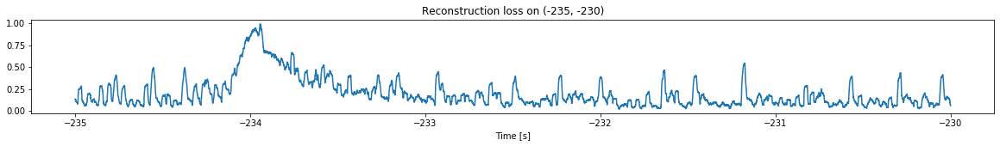

<--------
Entering sections:  (-230, -225)
-------->
Training for section:  (-235, -230)
Finished training, mean of the log(loss) is:  -1.7052675093802638
Triggering for section:  (-230, -225)
Using this mean for triggering: -1.7413312165789576


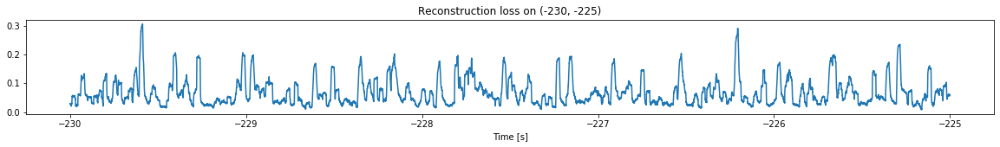

<--------
Entering sections:  (-225, -220)
-------->
Training for section:  (-230, -225)
Finished training, mean of the log(loss) is:  -1.773773643413128
Triggering for section:  (-225, -220)
Using this mean for triggering: -1.7052675093802638


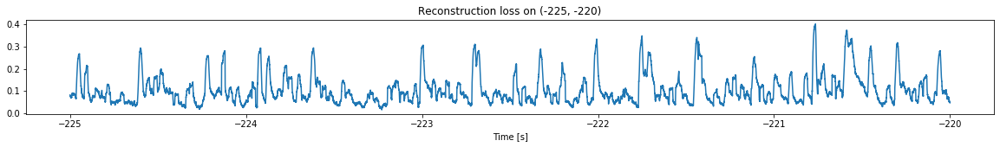

<--------
Entering sections:  (-220, -215)
-------->
Training for section:  (-225, -220)
Finished training, mean of the log(loss) is:  -1.8106209782536253
Triggering for section:  (-220, -215)
Using this mean for triggering: -1.773773643413128


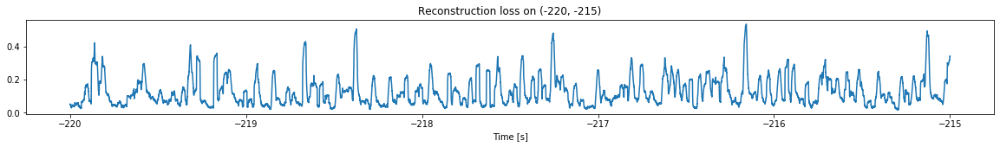

<--------
Entering sections:  (-215, -210)
-------->
Training for section:  (-220, -215)
Finished training, mean of the log(loss) is:  -1.774836332915239
Triggering for section:  (-215, -210)
Using this mean for triggering: -1.8106209782536253


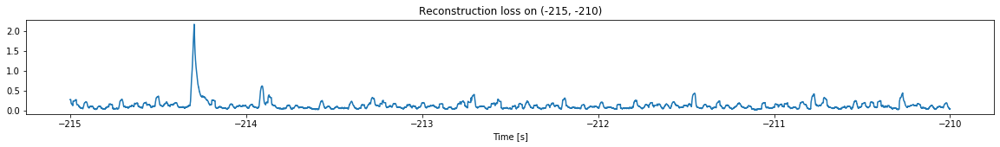

<--------
Entering sections:  (-210, -205)
-------->
Training for section:  (-215, -210)
Finished training, mean of the log(loss) is:  -1.9329442760450761
Triggering for section:  (-210, -205)
Using this mean for triggering: -1.774836332915239


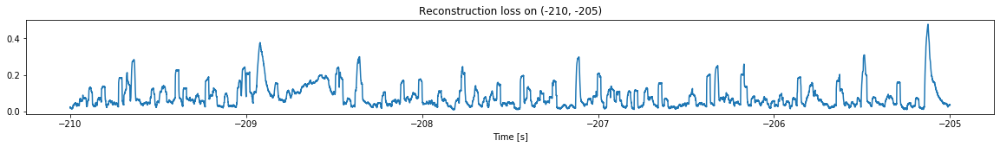

<--------
Entering sections:  (-205, -200)
-------->
Training for section:  (-210, -205)
Finished training, mean of the log(loss) is:  -1.9589837327683748
Triggering for section:  (-205, -200)
Using this mean for triggering: -1.9329442760450761


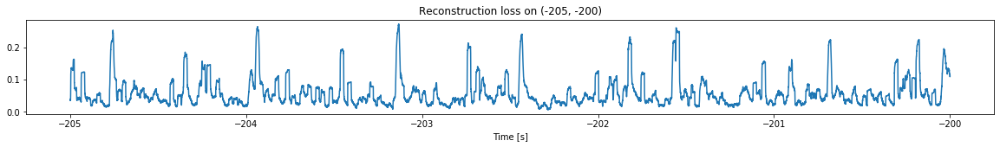

<--------
Entering sections:  (-200, -195)
-------->
Training for section:  (-205, -200)
Finished training, mean of the log(loss) is:  -1.978362185447843
Triggering for section:  (-200, -195)
Using this mean for triggering: -1.9589837327683748


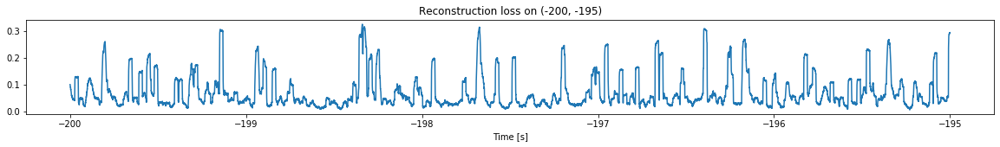

<--------
Entering sections:  (-195, -190)
-------->
Training for section:  (-200, -195)
Finished training, mean of the log(loss) is:  -1.9815199674172064
Triggering for section:  (-195, -190)
Using this mean for triggering: -1.978362185447843


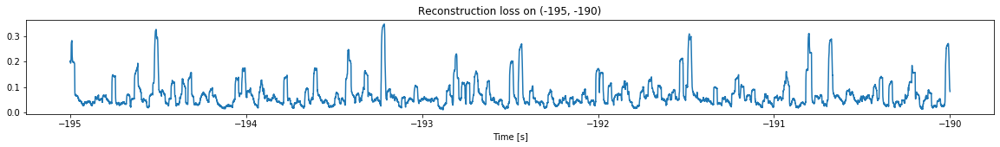

<--------
Entering sections:  (-190, -185)
-------->
Training for section:  (-195, -190)
Finished training, mean of the log(loss) is:  -2.1066523948166975
Triggering for section:  (-190, -185)
Using this mean for triggering: -1.9815199674172064


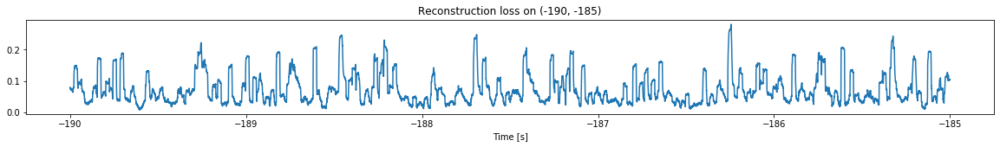

<--------
Entering sections:  (-185, -180)
-------->
Training for section:  (-190, -185)
Finished training, mean of the log(loss) is:  -2.0561527665234767
Triggering for section:  (-185, -180)
Using this mean for triggering: -2.1066523948166975


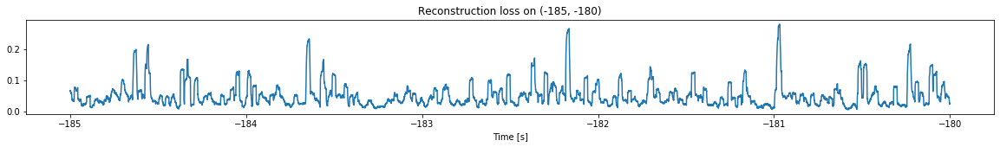

<--------
Entering sections:  (-180, -175)
-------->
Training for section:  (-185, -180)
Finished training, mean of the log(loss) is:  -1.9451682778671737
Triggering for section:  (-180, -175)
Using this mean for triggering: -2.0561527665234767


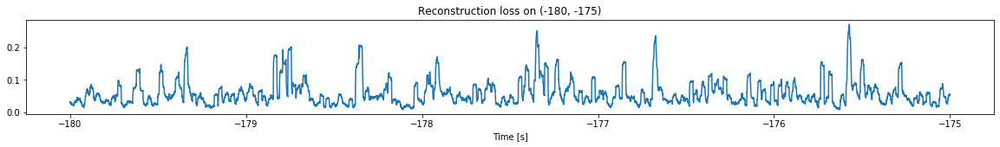

<--------
Entering sections:  (-175, -170)
-------->
Training for section:  (-180, -175)
Finished training, mean of the log(loss) is:  -1.9537597747139197
Triggering for section:  (-175, -170)
Using this mean for triggering: -1.9451682778671737


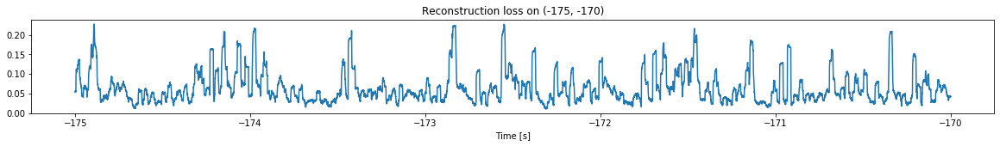

<--------
Entering sections:  (-170, -165)
-------->
Training for section:  (-175, -170)
Finished training, mean of the log(loss) is:  -2.0107208932694505
Triggering for section:  (-170, -165)
Using this mean for triggering: -1.9537597747139197


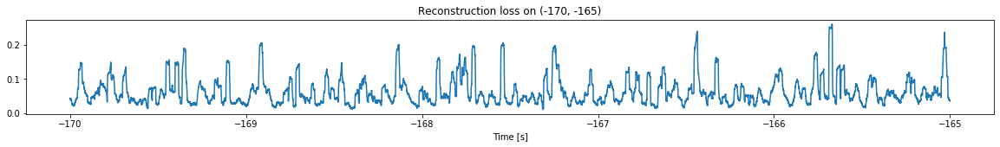

<--------
Entering sections:  (-165, -160)
-------->
Training for section:  (-170, -165)
Finished training, mean of the log(loss) is:  -2.031150160467224
Triggering for section:  (-165, -160)
Using this mean for triggering: -2.0107208932694505


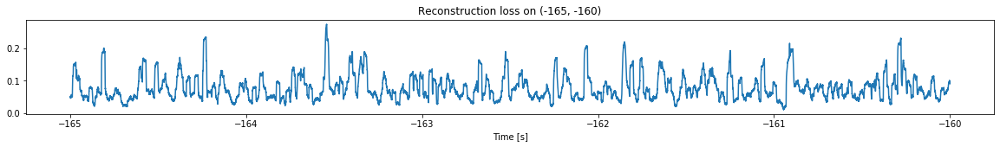

<--------
Entering sections:  (-160, -155)
-------->
Training for section:  (-165, -160)
Finished training, mean of the log(loss) is:  -2.057651983776502
Triggering for section:  (-160, -155)
Using this mean for triggering: -2.031150160467224


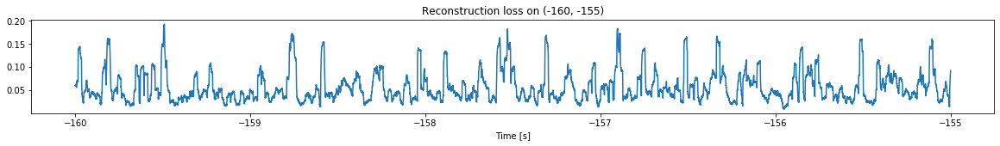

<--------
Entering sections:  (-155, -150)
-------->
Training for section:  (-160, -155)
Finished training, mean of the log(loss) is:  -2.045155349413749
Triggering for section:  (-155, -150)
Using this mean for triggering: -2.057651983776502


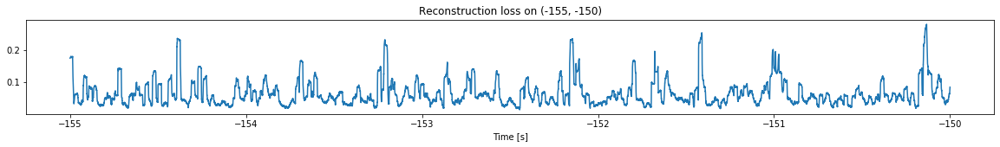

<--------
Entering sections:  (-150, -145)
-------->
Training for section:  (-155, -150)
Finished training, mean of the log(loss) is:  -1.9984176037619248
Triggering for section:  (-150, -145)
Using this mean for triggering: -2.045155349413749


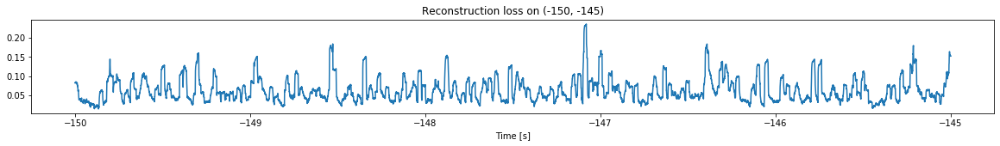

<--------
Entering sections:  (-145, -140)
-------->
Training for section:  (-150, -145)
Finished training, mean of the log(loss) is:  -2.0275908702731753
Triggering for section:  (-145, -140)
Using this mean for triggering: -1.9984176037619248


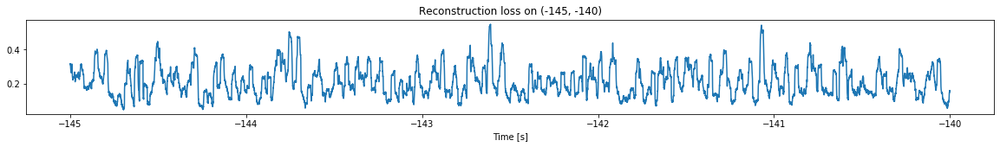

<--------
Entering sections:  (-140, -135)
-------->
Training for section:  (-145, -140)
Finished training, mean of the log(loss) is:  -1.9843673861897706
Triggering for section:  (-140, -135)
Using this mean for triggering: -2.0275908702731753


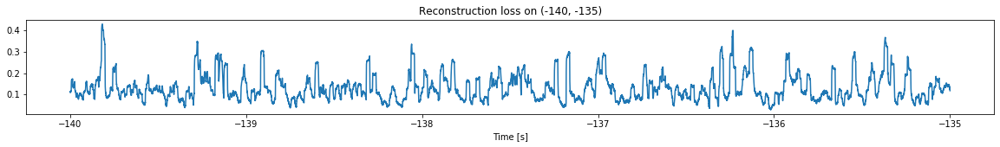

<--------
Entering sections:  (-135, -130)
-------->
Training for section:  (-140, -135)
Finished training, mean of the log(loss) is:  -1.8680647306863434
Triggering for section:  (-135, -130)
Using this mean for triggering: -1.9843673861897706


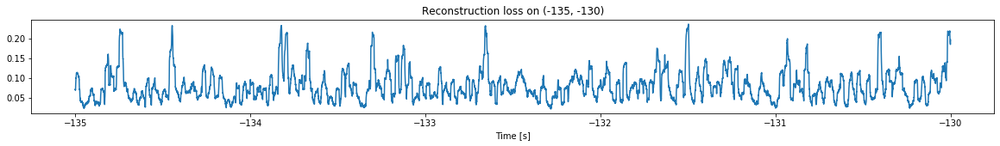

<--------
Entering sections:  (-130, -125)
-------->
Training for section:  (-135, -130)
Finished training, mean of the log(loss) is:  -1.9844355641233173
Triggering for section:  (-130, -125)
Using this mean for triggering: -1.8680647306863434


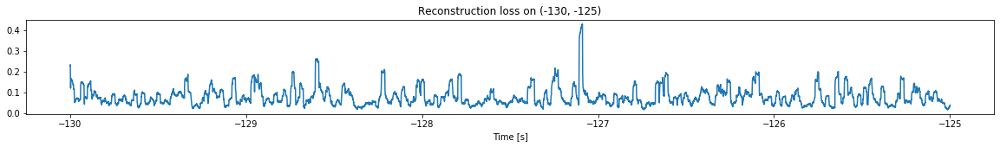

<--------
Entering sections:  (-125, -120)
-------->
Training for section:  (-130, -125)
Finished training, mean of the log(loss) is:  -1.9387710597900836
Triggering for section:  (-125, -120)
Using this mean for triggering: -1.9844355641233173


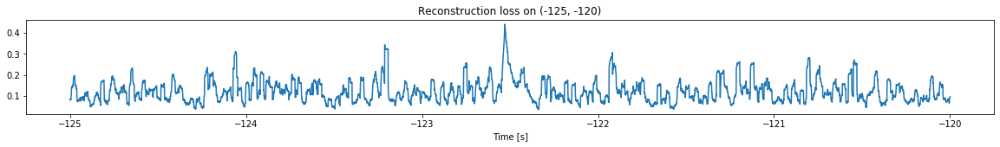

<--------
Entering sections:  (-120, -115)
-------->
Training for section:  (-125, -120)
Finished training, mean of the log(loss) is:  -1.9416029333736682
Triggering for section:  (-120, -115)
Using this mean for triggering: -1.9387710597900836


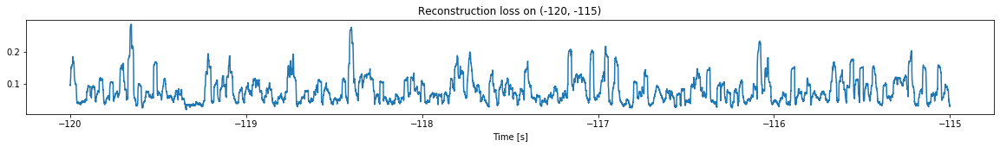

<--------
Entering sections:  (-115, -110)
-------->
Training for section:  (-120, -115)
Finished training, mean of the log(loss) is:  -1.9789886789842404
Triggering for section:  (-115, -110)
Using this mean for triggering: -1.9416029333736682


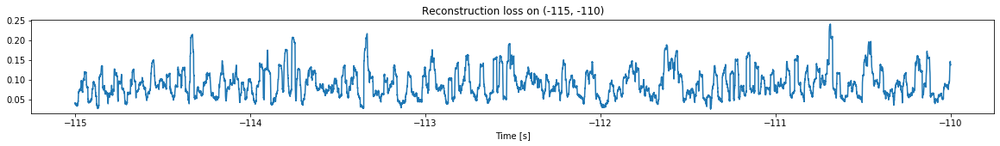

<--------
Entering sections:  (-110, -105)
-------->
Training for section:  (-115, -110)
Finished training, mean of the log(loss) is:  -1.8773325266818128
Triggering for section:  (-110, -105)
Using this mean for triggering: -1.9789886789842404


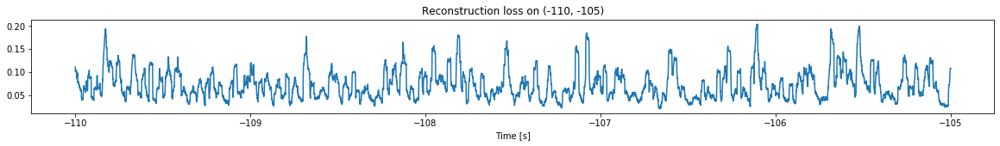

<--------
Entering sections:  (-105, -100)
-------->
Training for section:  (-110, -105)
Finished training, mean of the log(loss) is:  -1.9473661324159361
Triggering for section:  (-105, -100)
Using this mean for triggering: -1.8773325266818128


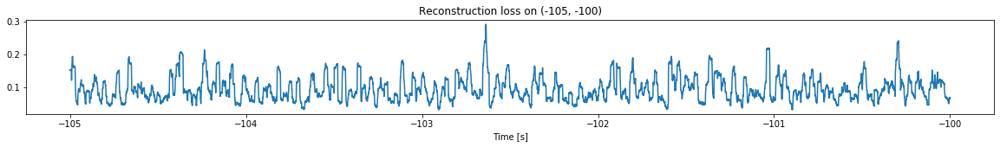

<--------
Entering sections:  (-100, -95)
-------->
Training for section:  (-105, -100)
Finished training, mean of the log(loss) is:  -1.8676889731420407
Triggering for section:  (-100, -95)
Using this mean for triggering: -1.9473661324159361


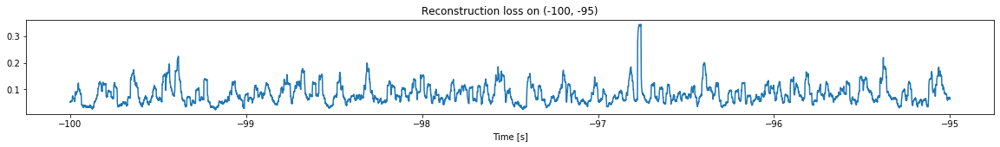

<--------
Entering sections:  (-95, -90)
-------->
Training for section:  (-100, -95)
Finished training, mean of the log(loss) is:  -1.8357787871998723
Triggering for section:  (-95, -90)
Using this mean for triggering: -1.8676889731420407


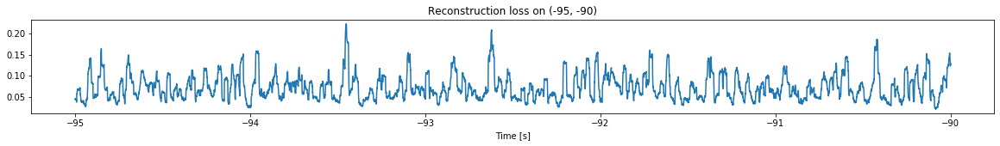

<--------
Entering sections:  (-90, -85)
-------->
Training for section:  (-95, -90)
Finished training, mean of the log(loss) is:  -1.836207138440911
Triggering for section:  (-90, -85)
Using this mean for triggering: -1.8357787871998723


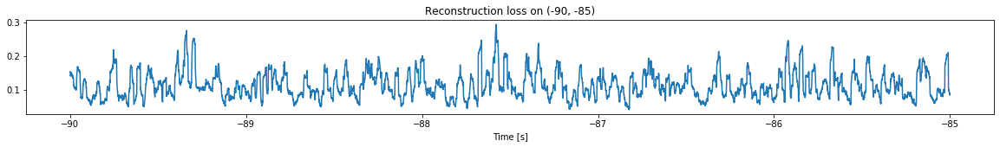

<--------
Entering sections:  (-85, -80)
-------->
Training for section:  (-90, -85)
Finished training, mean of the log(loss) is:  -1.7360983675492219
Triggering for section:  (-85, -80)
Using this mean for triggering: -1.836207138440911


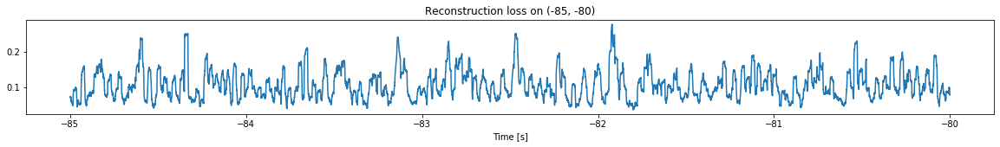

<--------
Entering sections:  (-80, -75)
-------->
Training for section:  (-85, -80)
Finished training, mean of the log(loss) is:  -1.839816486721599
Triggering for section:  (-80, -75)
Using this mean for triggering: -1.7360983675492219


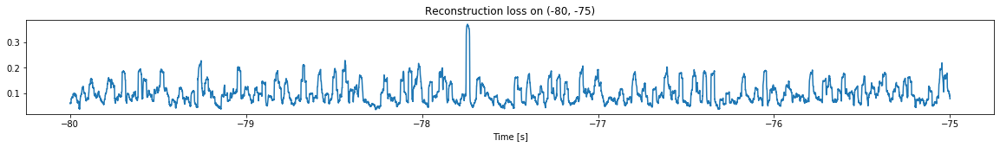

<--------
Entering sections:  (-75, -70)
-------->
Training for section:  (-80, -75)
Finished training, mean of the log(loss) is:  -1.8403604180032418
Triggering for section:  (-75, -70)
Using this mean for triggering: -1.839816486721599


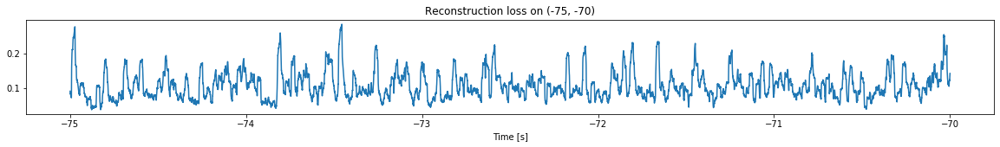

<--------
Entering sections:  (-70, -65)
-------->
Training for section:  (-75, -70)
Finished training, mean of the log(loss) is:  -1.8951730531643711
Triggering for section:  (-70, -65)
Using this mean for triggering: -1.8403604180032418


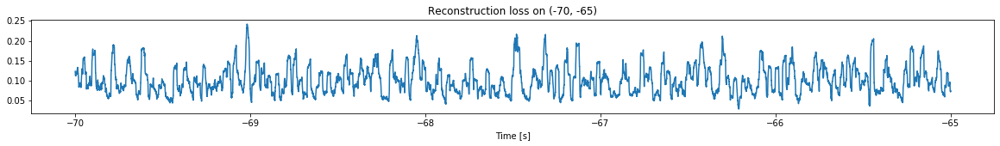

<--------
Entering sections:  (-65, -60)
-------->
Training for section:  (-70, -65)
Finished training, mean of the log(loss) is:  -1.8882028131777435
Triggering for section:  (-65, -60)
Using this mean for triggering: -1.8951730531643711


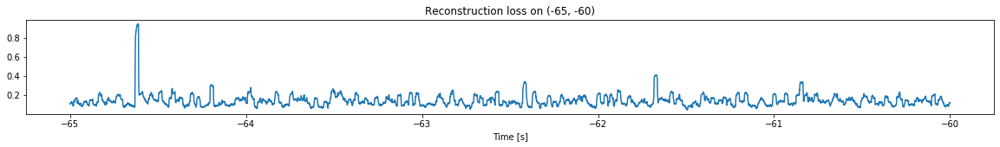

<--------
Entering sections:  (-60, -55)
-------->
Training for section:  (-65, -60)
Finished training, mean of the log(loss) is:  -1.8850136191610365
Triggering for section:  (-60, -55)
Using this mean for triggering: -1.8882028131777435


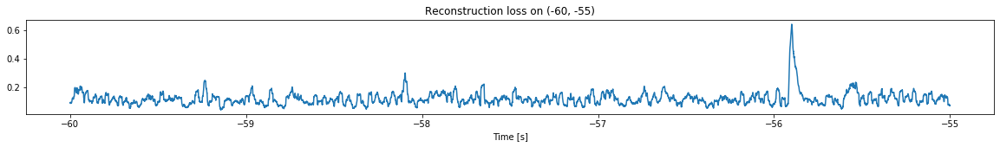

<--------
Entering sections:  (-55, -50)
-------->
Training for section:  (-60, -55)
Finished training, mean of the log(loss) is:  -1.8785892403656155
Triggering for section:  (-55, -50)
Using this mean for triggering: -1.8850136191610365


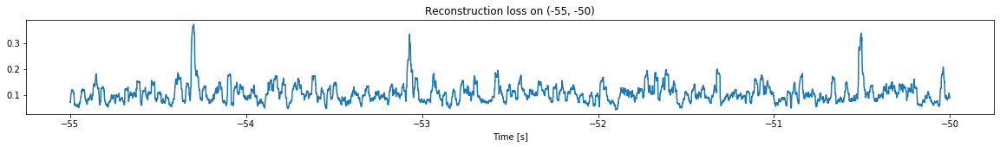

<--------
Entering sections:  (-50, -45)
-------->
Training for section:  (-55, -50)
Finished training, mean of the log(loss) is:  -1.9219400329444176
Triggering for section:  (-50, -45)
Using this mean for triggering: -1.8785892403656155


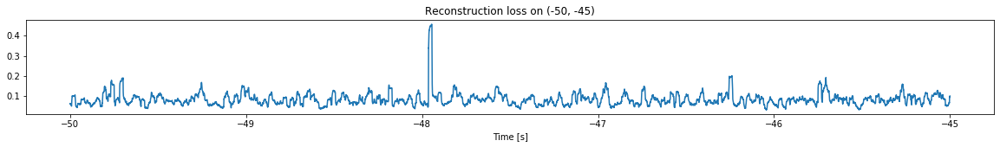

<--------
Entering sections:  (-45, -40)
-------->
Training for section:  (-50, -45)
Finished training, mean of the log(loss) is:  -1.830680395835509
Triggering for section:  (-45, -40)
Using this mean for triggering: -1.9219400329444176


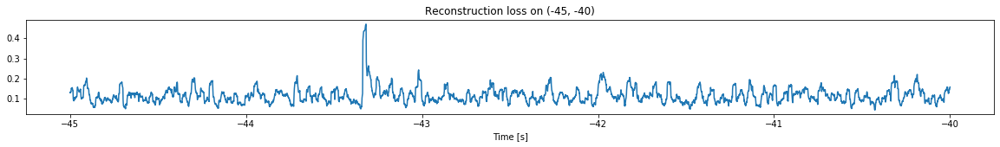

<--------
Entering sections:  (-40, -35)
-------->
Training for section:  (-45, -40)
Finished training, mean of the log(loss) is:  -1.8444835409582065
Triggering for section:  (-40, -35)
Using this mean for triggering: -1.830680395835509


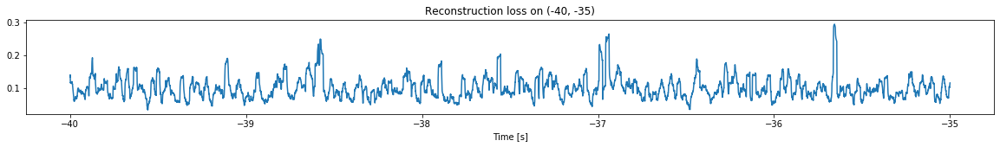

<--------
Entering sections:  (-35, -30)
-------->
Training for section:  (-40, -35)
Finished training, mean of the log(loss) is:  -1.8390231889120372
Triggering for section:  (-35, -30)
Using this mean for triggering: -1.8444835409582065


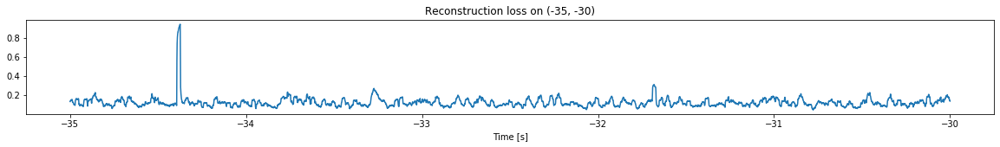

<--------
Entering sections:  (-30, -25)
-------->
Training for section:  (-35, -30)
Finished training, mean of the log(loss) is:  -1.8420676471212922
Triggering for section:  (-30, -25)
Using this mean for triggering: -1.8390231889120372


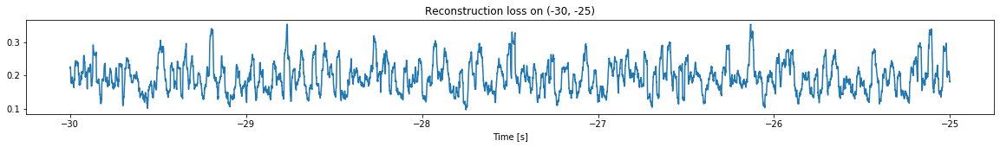

<--------
Entering sections:  (-25, -20)
-------->
Training for section:  (-30, -25)
Finished training, mean of the log(loss) is:  -1.7956990830048882
Triggering for section:  (-25, -20)
Using this mean for triggering: -1.8420676471212922


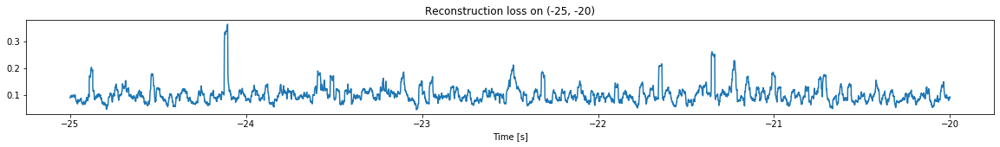

<--------
Entering sections:  (-20, -15)
-------->
Training for section:  (-25, -20)
Finished training, mean of the log(loss) is:  -1.7659973804011146
Triggering for section:  (-20, -15)
Using this mean for triggering: -1.7956990830048882


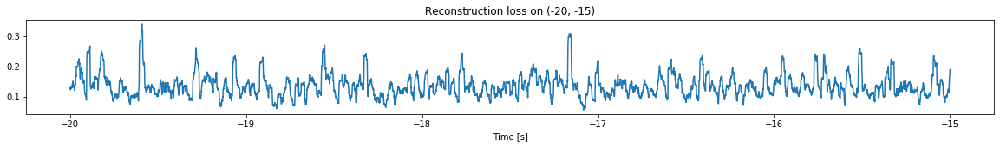

<--------
Entering sections:  (-15, -10)
-------->
Training for section:  (-20, -15)
Finished training, mean of the log(loss) is:  -1.7091461688036653
Triggering for section:  (-15, -10)
Using this mean for triggering: -1.7659973804011146


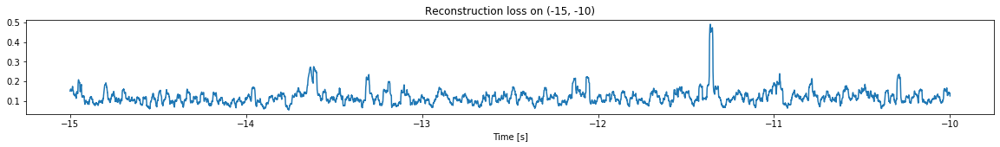

<--------
Entering sections:  (-10, -5)
-------->
Training for section:  (-15, -10)
Finished training, mean of the log(loss) is:  -1.8038499924399987
Triggering for section:  (-10, -5)
Using this mean for triggering: -1.7091461688036653


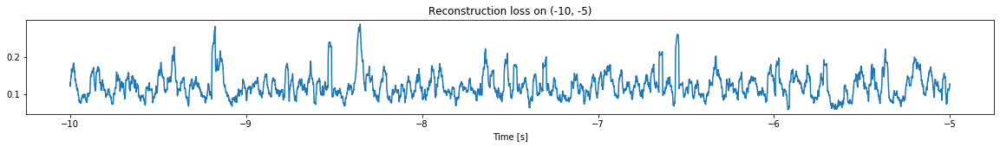

<--------
Entering sections:  (-5, 0)
-------->
Training for section:  (-10, -5)
Finished training, mean of the log(loss) is:  -1.835646328291275
Triggering for section:  (-5, 0)
Using this mean for triggering: -1.8038499924399987


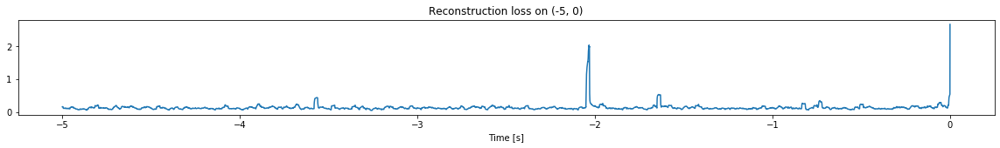

<--------


In [16]:
simulation("./data/Ramp29/", 5, (-300,0))

Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
Flushing input history
All data's shape:  (2997500, 12)
Flushing input history
Number of sections: 60
Entering sections:  (-300, -295)
-------->
Entering sections:  (-295, -290)
-------->
Training for section:  (None, -295)
Finished training, mean of the log(loss) is:  -1.6264652462812008
<--------
Entering sections:  (-290, -285)
-------->
Training for section:  (-295, -290)
Finished training, mean of the log(loss) is:  -1.67702442661199
Triggering for section:  (-290, -285)
Using this mean for triggering: -1.6264652462812008


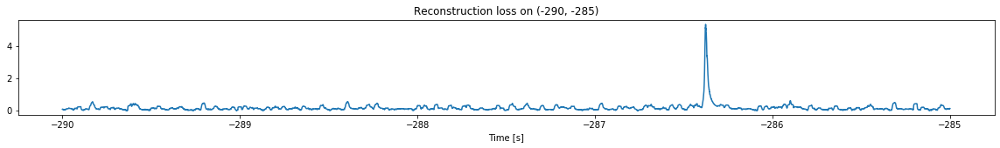

<--------
Entering sections:  (-285, -280)
-------->
Training for section:  (-290, -285)
Finished training, mean of the log(loss) is:  -1.7712776571415954
Triggering for section:  (-285, -280)
Using this mean for triggering: -1.67702442661199


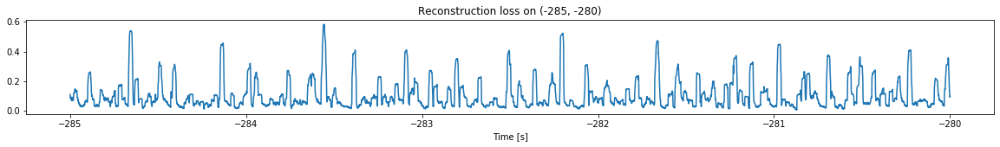

<--------
Entering sections:  (-280, -275)
-------->
Training for section:  (-285, -280)
Finished training, mean of the log(loss) is:  -1.8135910346002542
Triggering for section:  (-280, -275)
Using this mean for triggering: -1.7712776571415954


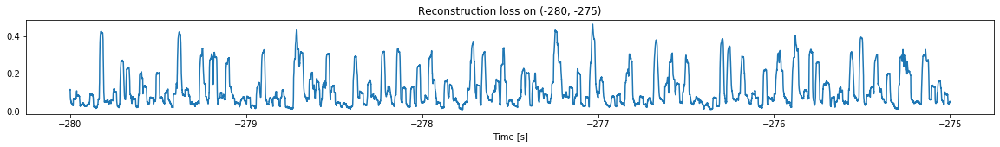

<--------
Entering sections:  (-275, -270)
-------->
Training for section:  (-280, -275)
Finished training, mean of the log(loss) is:  -1.8338939824006477
Triggering for section:  (-275, -270)
Using this mean for triggering: -1.8135910346002542


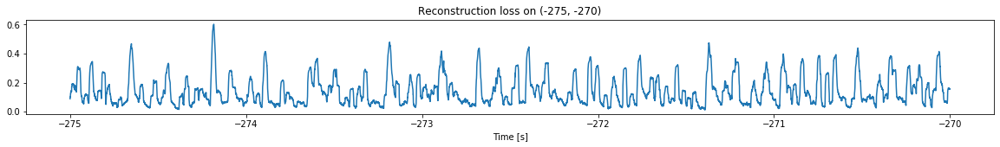

<--------
Entering sections:  (-270, -265)
-------->
Training for section:  (-275, -270)
Finished training, mean of the log(loss) is:  -1.691228637542551
Triggering for section:  (-270, -265)
Using this mean for triggering: -1.8338939824006477


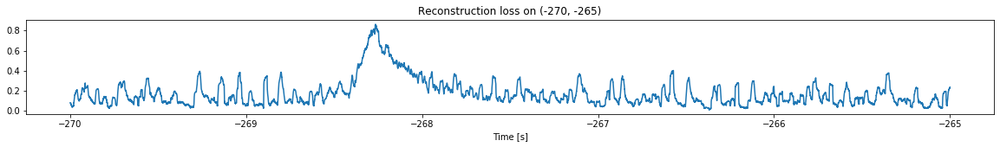

<--------
Entering sections:  (-265, -260)
-------->
Training for section:  (-270, -265)
Finished training, mean of the log(loss) is:  -1.5829516150628704
Triggering for section:  (-265, -260)
Using this mean for triggering: -1.691228637542551


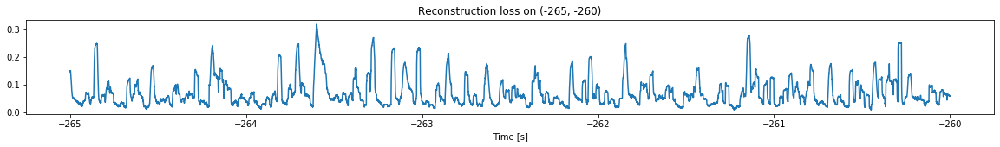

<--------
Entering sections:  (-260, -255)
-------->
Training for section:  (-265, -260)
Finished training, mean of the log(loss) is:  -1.7791873102566471
Triggering for section:  (-260, -255)
Using this mean for triggering: -1.5829516150628704


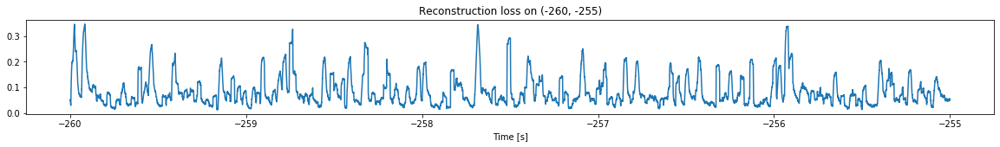

<--------
Entering sections:  (-255, -250)
-------->
Training for section:  (-260, -255)
Finished training, mean of the log(loss) is:  -1.8494943540050406
Triggering for section:  (-255, -250)
Using this mean for triggering: -1.7791873102566471


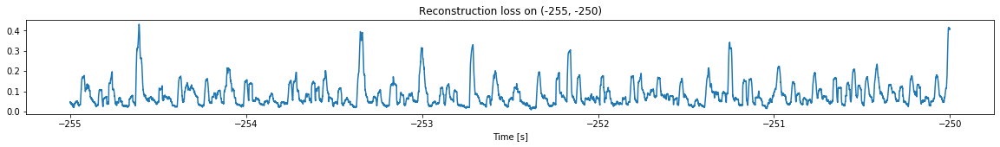

<--------
Entering sections:  (-250, -245)
-------->
Training for section:  (-255, -250)
Finished training, mean of the log(loss) is:  -1.8219682222043003
Triggering for section:  (-250, -245)
Using this mean for triggering: -1.8494943540050406


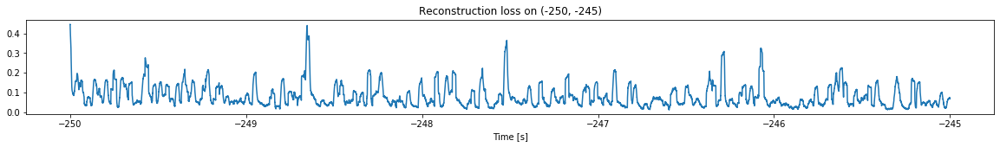

<--------
Entering sections:  (-245, -240)
-------->
Training for section:  (-250, -245)
Finished training, mean of the log(loss) is:  -1.8772700323693754
Triggering for section:  (-245, -240)
Using this mean for triggering: -1.8219682222043003


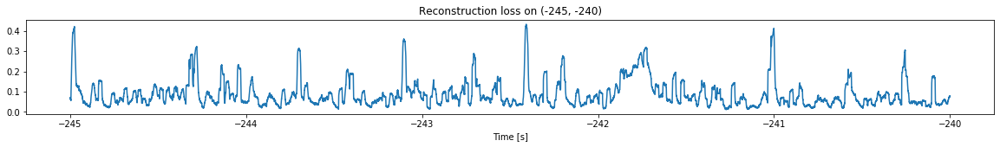

<--------
Entering sections:  (-240, -235)
-------->
Training for section:  (-245, -240)
Finished training, mean of the log(loss) is:  -1.8081400883970167
Triggering for section:  (-240, -235)
Using this mean for triggering: -1.8772700323693754


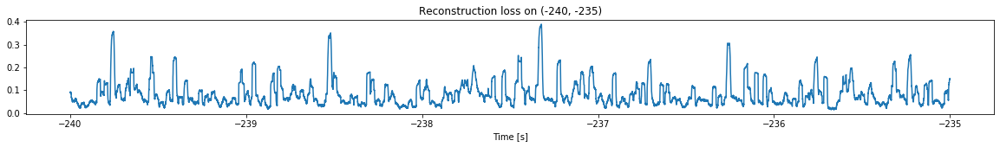

<--------
Entering sections:  (-235, -230)
-------->
Training for section:  (-240, -235)
Finished training, mean of the log(loss) is:  -1.8819912117164248
Triggering for section:  (-235, -230)
Using this mean for triggering: -1.8081400883970167


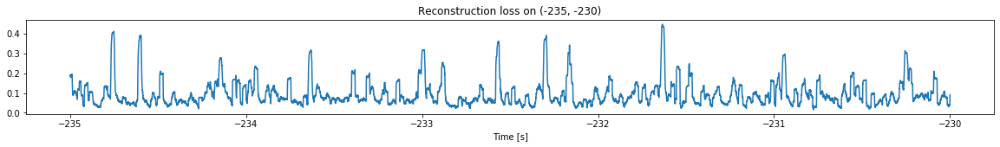

<--------
Entering sections:  (-230, -225)
-------->
Training for section:  (-235, -230)
Finished training, mean of the log(loss) is:  -1.9118282954205061
Triggering for section:  (-230, -225)
Using this mean for triggering: -1.8819912117164248


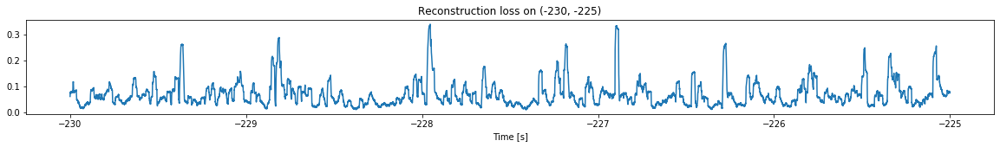

<--------
Entering sections:  (-225, -220)
-------->
Training for section:  (-230, -225)
Finished training, mean of the log(loss) is:  -1.9527261722614044
Triggering for section:  (-225, -220)
Using this mean for triggering: -1.9118282954205061


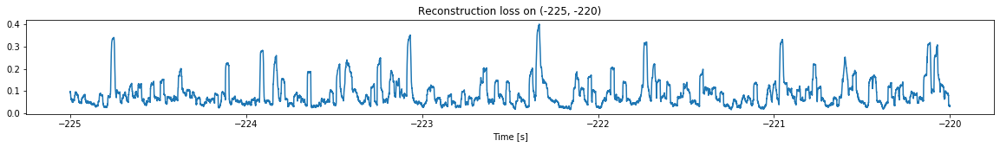

<--------
Entering sections:  (-220, -215)
-------->
Training for section:  (-225, -220)
Finished training, mean of the log(loss) is:  -1.8688104402245034
Triggering for section:  (-220, -215)
Using this mean for triggering: -1.9527261722614044


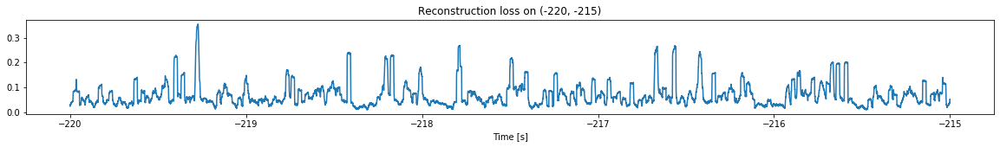

<--------
Entering sections:  (-215, -210)
-------->
Training for section:  (-220, -215)
Finished training, mean of the log(loss) is:  -1.8786527704553846
Triggering for section:  (-215, -210)
Using this mean for triggering: -1.8688104402245034


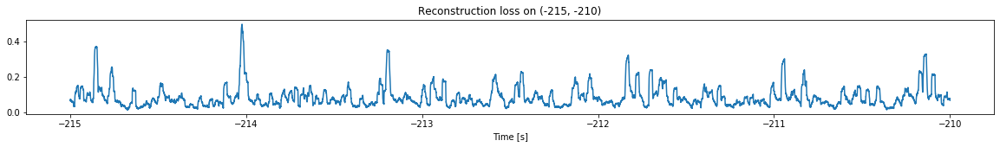

<--------
Entering sections:  (-210, -205)
-------->
Training for section:  (-215, -210)
Finished training, mean of the log(loss) is:  -1.8416533570897942
Triggering for section:  (-210, -205)
Using this mean for triggering: -1.8786527704553846


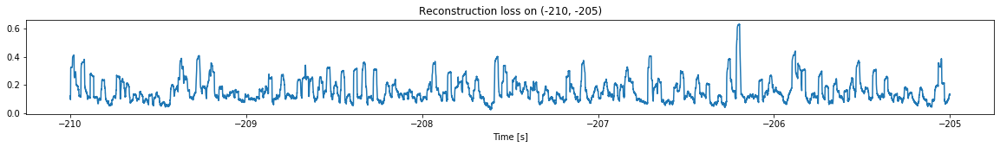

<--------
Entering sections:  (-205, -200)
-------->
Training for section:  (-210, -205)
Finished training, mean of the log(loss) is:  -1.9439880120713424
Triggering for section:  (-205, -200)
Using this mean for triggering: -1.8416533570897942


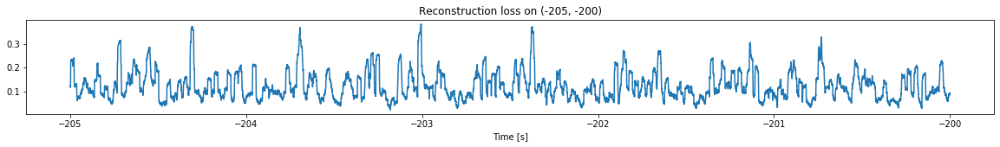

<--------
Entering sections:  (-200, -195)
-------->
Training for section:  (-205, -200)
Finished training, mean of the log(loss) is:  -1.9230277140667833
Triggering for section:  (-200, -195)
Using this mean for triggering: -1.9439880120713424


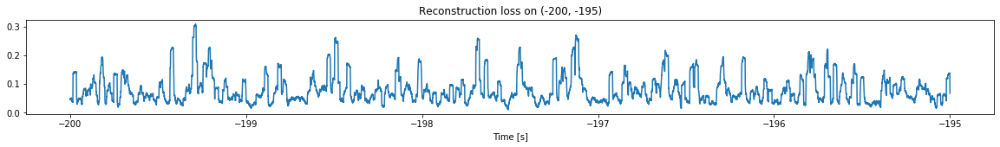

<--------
Entering sections:  (-195, -190)
-------->
Training for section:  (-200, -195)
Finished training, mean of the log(loss) is:  -1.9318727902983257
Triggering for section:  (-195, -190)
Using this mean for triggering: -1.9230277140667833


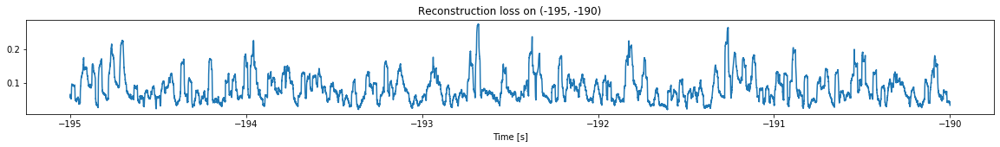

<--------
Entering sections:  (-190, -185)
-------->
Training for section:  (-195, -190)
Finished training, mean of the log(loss) is:  -1.8788669567514287
Triggering for section:  (-190, -185)
Using this mean for triggering: -1.9318727902983257


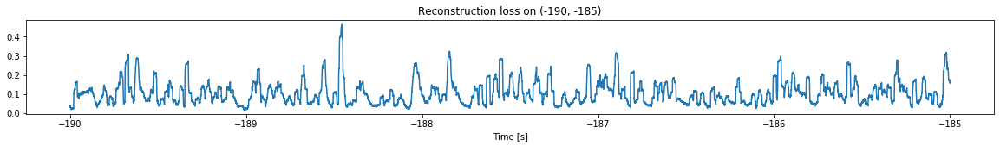

<--------
Entering sections:  (-185, -180)
-------->
Training for section:  (-190, -185)
Finished training, mean of the log(loss) is:  -1.881170211998826
Triggering for section:  (-185, -180)
Using this mean for triggering: -1.8788669567514287


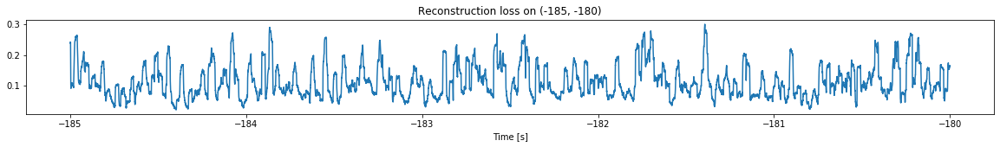

<--------
Entering sections:  (-180, -175)
-------->
Training for section:  (-185, -180)
Finished training, mean of the log(loss) is:  -1.8840511413299008
Triggering for section:  (-180, -175)
Using this mean for triggering: -1.881170211998826


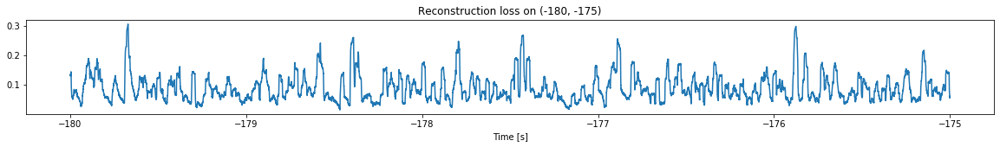

<--------
Entering sections:  (-175, -170)
-------->
Training for section:  (-180, -175)
Finished training, mean of the log(loss) is:  -1.8494987951757897
Triggering for section:  (-175, -170)
Using this mean for triggering: -1.8840511413299008


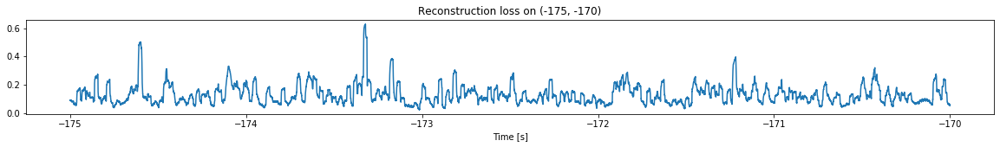

<--------
Entering sections:  (-170, -165)
-------->
Training for section:  (-175, -170)
Finished training, mean of the log(loss) is:  -1.9230764652069339
Triggering for section:  (-170, -165)
Using this mean for triggering: -1.8494987951757897


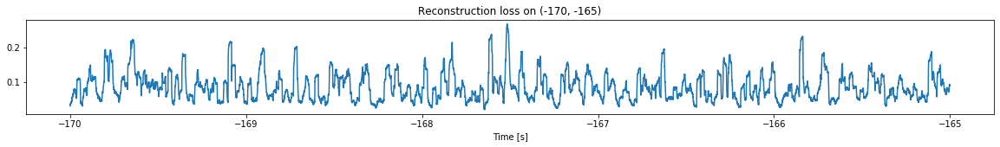

<--------
Entering sections:  (-165, -160)
-------->
Training for section:  (-170, -165)
Finished training, mean of the log(loss) is:  -1.9132891387021598
Triggering for section:  (-165, -160)
Using this mean for triggering: -1.9230764652069339


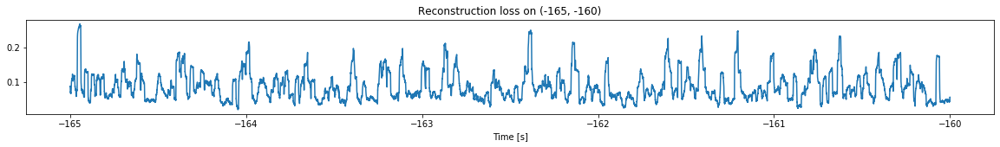

<--------
Entering sections:  (-160, -155)
-------->
Training for section:  (-165, -160)
Finished training, mean of the log(loss) is:  -1.8640561243918443
Triggering for section:  (-160, -155)
Using this mean for triggering: -1.9132891387021598


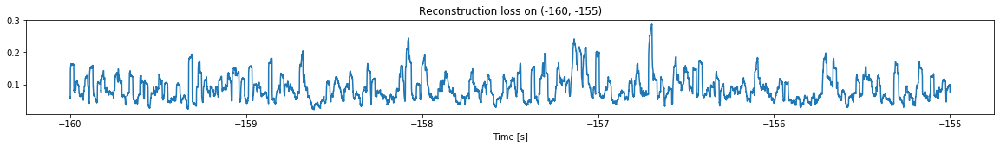

<--------
Entering sections:  (-155, -150)
-------->
Training for section:  (-160, -155)
Finished training, mean of the log(loss) is:  -1.816776707493437
Triggering for section:  (-155, -150)
Using this mean for triggering: -1.8640561243918443


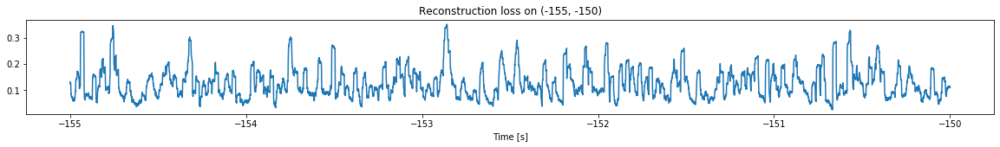

<--------
Entering sections:  (-150, -145)
-------->
Training for section:  (-155, -150)
Finished training, mean of the log(loss) is:  -1.627169633180026
Triggering for section:  (-150, -145)
Using this mean for triggering: -1.816776707493437


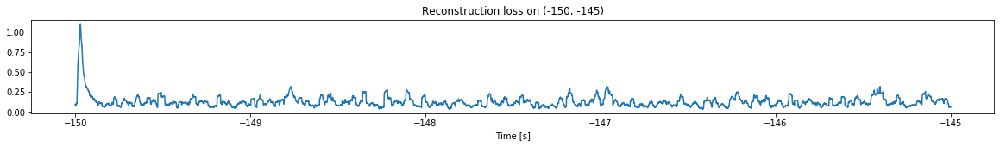

<--------
Entering sections:  (-145, -140)
-------->
Training for section:  (-150, -145)
Finished training, mean of the log(loss) is:  -1.7087663925708907
Triggering for section:  (-145, -140)
Using this mean for triggering: -1.627169633180026


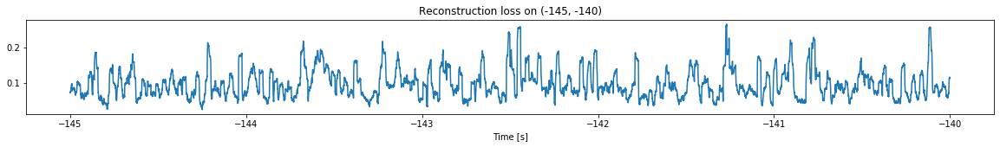

<--------
Entering sections:  (-140, -135)
-------->
Training for section:  (-145, -140)
Finished training, mean of the log(loss) is:  -1.8946788014220404
Triggering for section:  (-140, -135)
Using this mean for triggering: -1.7087663925708907


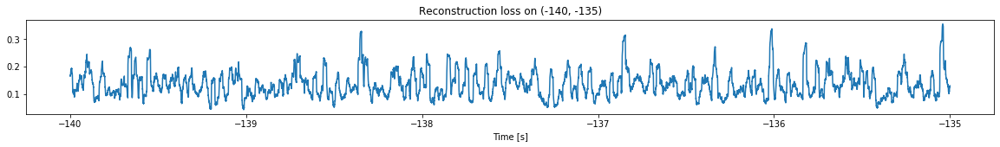

<--------
Entering sections:  (-135, -130)
-------->
Training for section:  (-140, -135)
Finished training, mean of the log(loss) is:  -1.7458779613961122
Triggering for section:  (-135, -130)
Using this mean for triggering: -1.8946788014220404


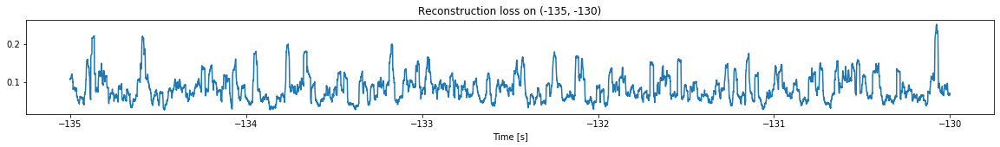

<--------
Entering sections:  (-130, -125)
-------->
Training for section:  (-135, -130)
Finished training, mean of the log(loss) is:  -1.8917311285250626
Triggering for section:  (-130, -125)
Using this mean for triggering: -1.7458779613961122


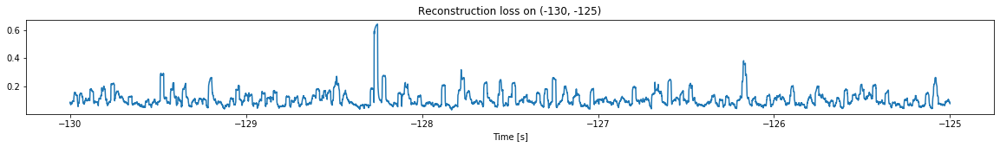

<--------
Entering sections:  (-125, -120)
-------->
Training for section:  (-130, -125)
Finished training, mean of the log(loss) is:  -1.9016467014544671
Triggering for section:  (-125, -120)
Using this mean for triggering: -1.8917311285250626


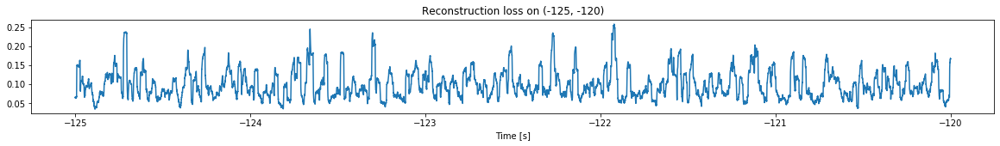

<--------
Entering sections:  (-120, -115)
-------->
Training for section:  (-125, -120)
Finished training, mean of the log(loss) is:  -1.8904025217012077
Triggering for section:  (-120, -115)
Using this mean for triggering: -1.9016467014544671


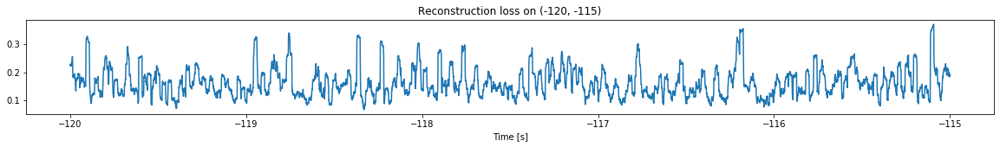

<--------
Entering sections:  (-115, -110)
-------->
Training for section:  (-120, -115)
Finished training, mean of the log(loss) is:  -1.8543084249018085
Triggering for section:  (-115, -110)
Using this mean for triggering: -1.8904025217012077


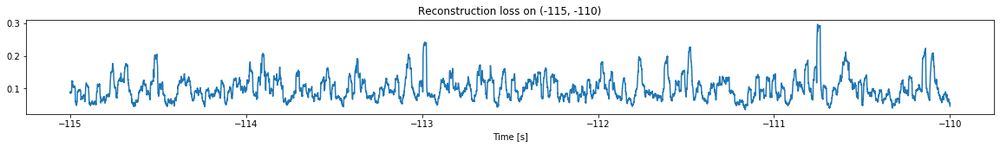

<--------
Entering sections:  (-110, -105)
-------->
Training for section:  (-115, -110)
Finished training, mean of the log(loss) is:  -1.8778570038428546
Triggering for section:  (-110, -105)
Using this mean for triggering: -1.8543084249018085


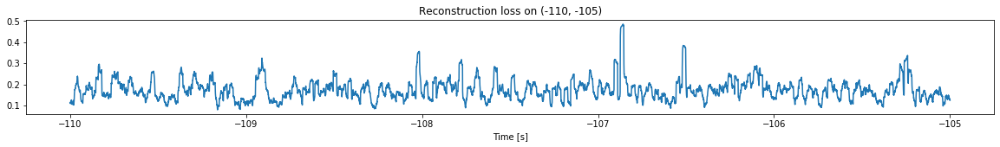

<--------
Entering sections:  (-105, -100)
-------->
Training for section:  (-110, -105)
Finished training, mean of the log(loss) is:  -1.9085711444176496
Triggering for section:  (-105, -100)
Using this mean for triggering: -1.8778570038428546


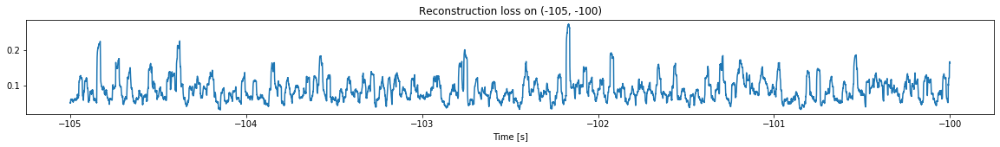

<--------
Entering sections:  (-100, -95)
-------->
Training for section:  (-105, -100)
Finished training, mean of the log(loss) is:  -1.8952997787670651
Triggering for section:  (-100, -95)
Using this mean for triggering: -1.9085711444176496


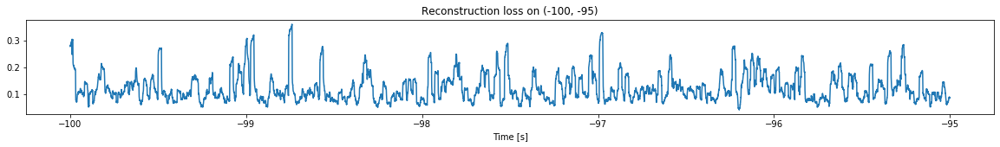

<--------
Entering sections:  (-95, -90)
-------->
Training for section:  (-100, -95)
Finished training, mean of the log(loss) is:  -1.818028847758514
Triggering for section:  (-95, -90)
Using this mean for triggering: -1.8952997787670651


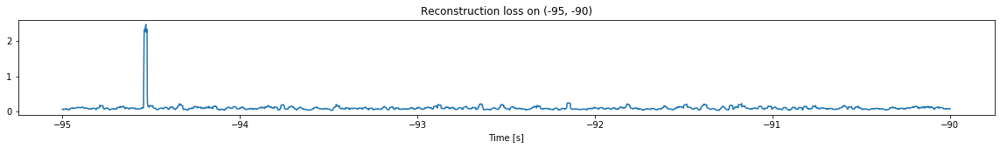

<--------
Entering sections:  (-90, -85)
-------->
Training for section:  (-95, -90)
Finished training, mean of the log(loss) is:  -1.747538373344415
Triggering for section:  (-90, -85)
Using this mean for triggering: -1.818028847758514


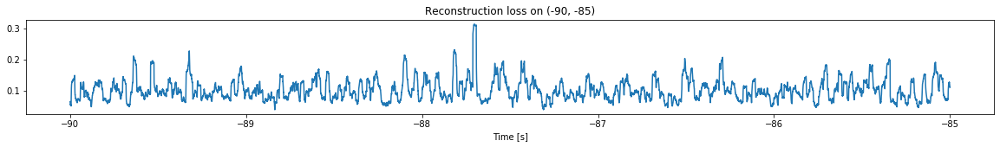

<--------
Entering sections:  (-85, -80)
-------->
Training for section:  (-90, -85)
Finished training, mean of the log(loss) is:  -1.8134482711480728
Triggering for section:  (-85, -80)
Using this mean for triggering: -1.747538373344415


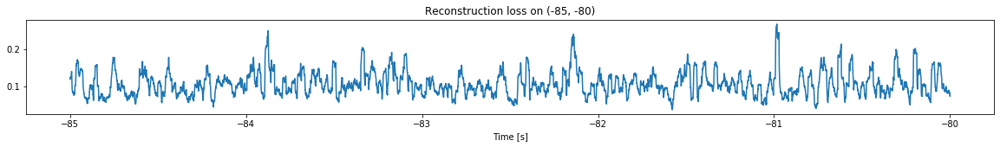

<--------
Entering sections:  (-80, -75)
-------->
Training for section:  (-85, -80)
Finished training, mean of the log(loss) is:  -1.8731376420838388
Triggering for section:  (-80, -75)
Using this mean for triggering: -1.8134482711480728


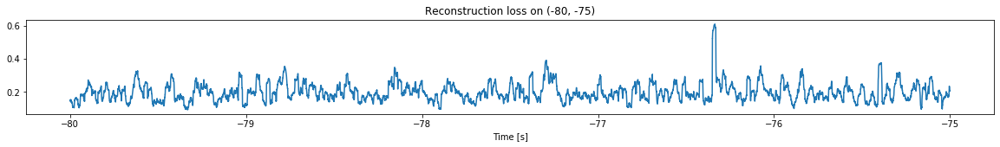

<--------
Entering sections:  (-75, -70)
-------->
Training for section:  (-80, -75)
Finished training, mean of the log(loss) is:  -1.697586652301878
Triggering for section:  (-75, -70)
Using this mean for triggering: -1.8731376420838388


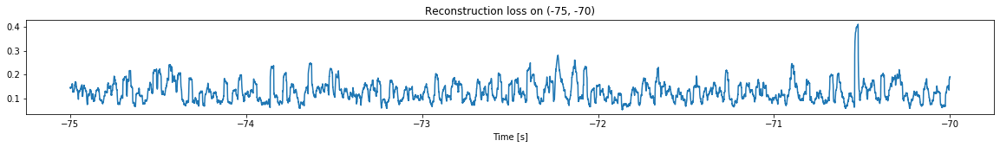

<--------
Entering sections:  (-70, -65)
-------->
Training for section:  (-75, -70)
Finished training, mean of the log(loss) is:  -1.66172273695057
Triggering for section:  (-70, -65)
Using this mean for triggering: -1.697586652301878


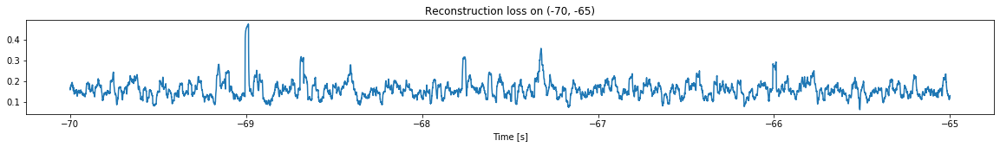

<--------
Entering sections:  (-65, -60)
-------->
Training for section:  (-70, -65)
Finished training, mean of the log(loss) is:  -1.6735655552472586
Triggering for section:  (-65, -60)
Using this mean for triggering: -1.66172273695057


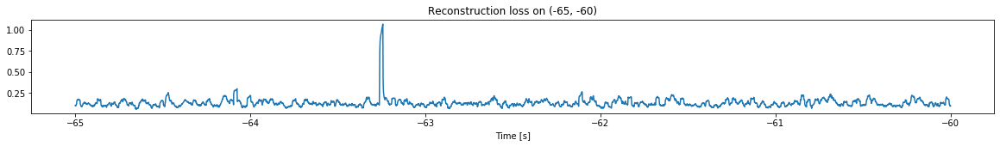

<--------
Entering sections:  (-60, -55)
-------->
Training for section:  (-65, -60)
Finished training, mean of the log(loss) is:  -1.6292547981380627
Triggering for section:  (-60, -55)
Using this mean for triggering: -1.6735655552472586


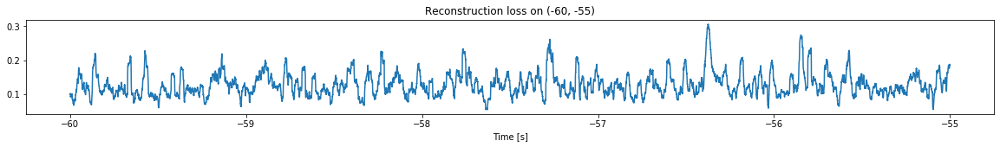

<--------
Entering sections:  (-55, -50)
-------->
Training for section:  (-60, -55)
Finished training, mean of the log(loss) is:  -1.7433350760896076
Triggering for section:  (-55, -50)
Using this mean for triggering: -1.6292547981380627


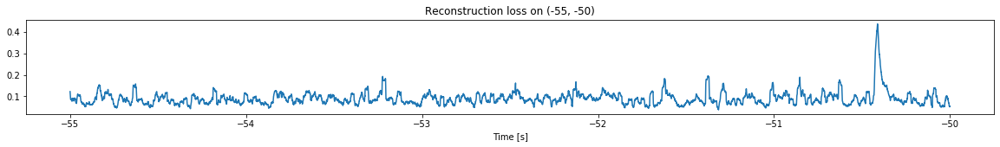

<--------
Entering sections:  (-50, -45)
-------->
Training for section:  (-55, -50)
Finished training, mean of the log(loss) is:  -1.7954485441150947
Triggering for section:  (-50, -45)
Using this mean for triggering: -1.7433350760896076


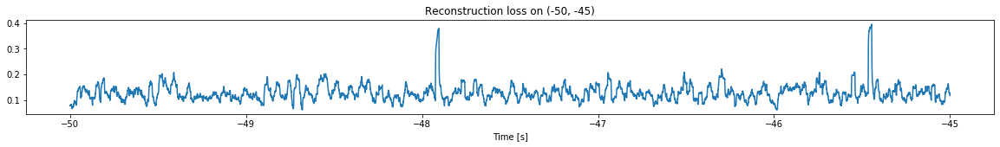

<--------
Entering sections:  (-45, -40)
-------->
Training for section:  (-50, -45)
Finished training, mean of the log(loss) is:  -1.8152520800069343
Triggering for section:  (-45, -40)
Using this mean for triggering: -1.7954485441150947


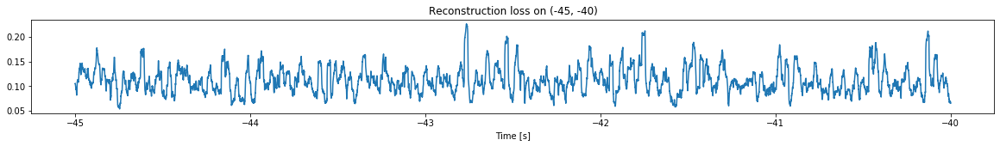

<--------
Entering sections:  (-40, -35)
-------->
Training for section:  (-45, -40)
Finished training, mean of the log(loss) is:  -1.8313367524657662
Triggering for section:  (-40, -35)
Using this mean for triggering: -1.8152520800069343


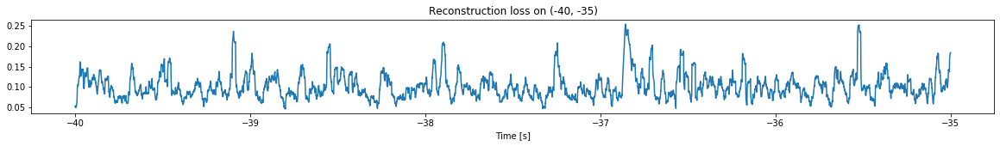

<--------
Entering sections:  (-35, -30)
-------->
Training for section:  (-40, -35)
Finished training, mean of the log(loss) is:  -1.732454024329006
Triggering for section:  (-35, -30)
Using this mean for triggering: -1.8313367524657662


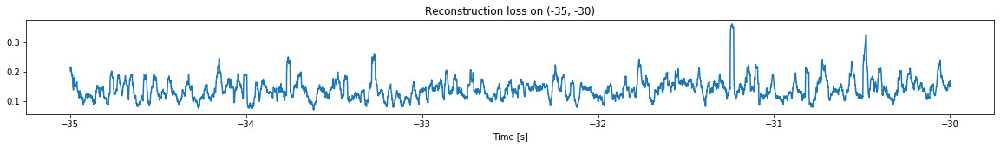

<--------
Entering sections:  (-30, -25)
-------->
Training for section:  (-35, -30)
Finished training, mean of the log(loss) is:  -1.6941117159447288
Triggering for section:  (-30, -25)
Using this mean for triggering: -1.732454024329006


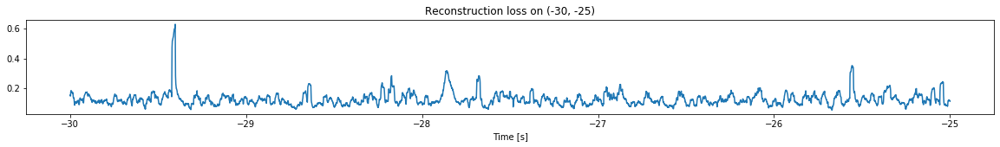

<--------
Entering sections:  (-25, -20)
-------->
Training for section:  (-30, -25)
Finished training, mean of the log(loss) is:  -1.6801911864041306
Triggering for section:  (-25, -20)
Using this mean for triggering: -1.6941117159447288


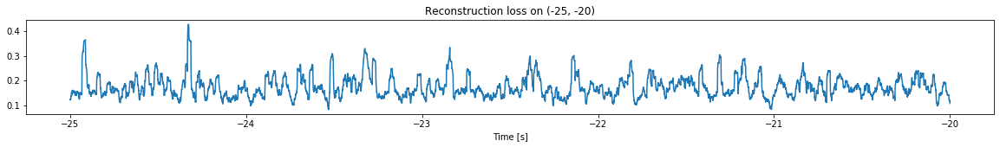

<--------
Entering sections:  (-20, -15)
-------->
Training for section:  (-25, -20)
Finished training, mean of the log(loss) is:  -1.7136797463196187
Triggering for section:  (-20, -15)
Using this mean for triggering: -1.6801911864041306


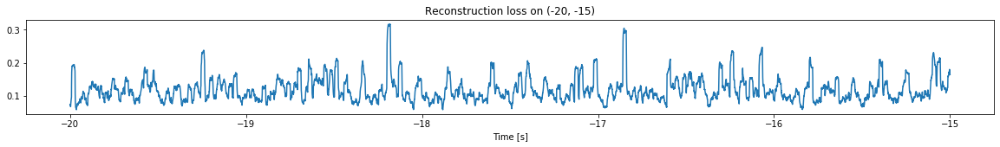

<--------
Entering sections:  (-15, -10)
-------->
Training for section:  (-20, -15)
Finished training, mean of the log(loss) is:  -1.7572315375894854
Triggering for section:  (-15, -10)
Using this mean for triggering: -1.7136797463196187


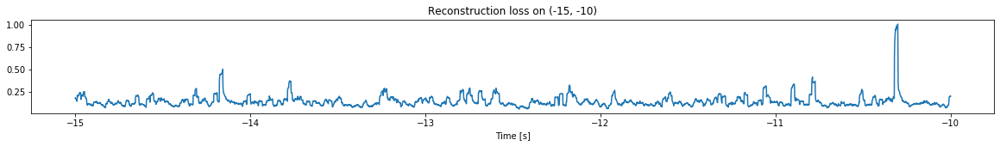

<--------
Entering sections:  (-10, -5)
-------->
Training for section:  (-15, -10)
Finished training, mean of the log(loss) is:  -1.760741104532532
Triggering for section:  (-10, -5)
Using this mean for triggering: -1.7572315375894854


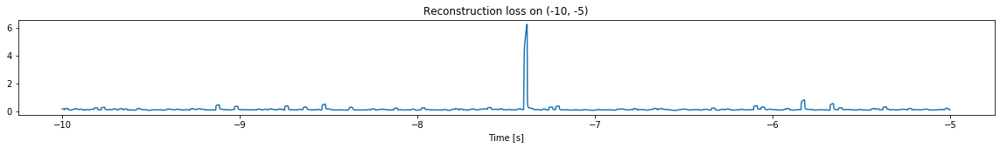

<--------
Entering sections:  (-5, 0)
-------->
Training for section:  (-10, -5)
Finished training, mean of the log(loss) is:  -1.9122743946947116
Triggering for section:  (-5, 0)
Using this mean for triggering: -1.760741104532532


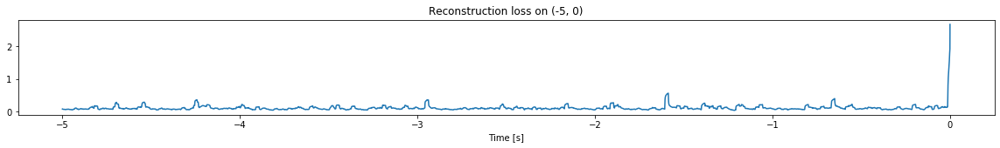

<--------


In [17]:
simulation("./data/Ramp30/", 5, (-300,0))

--------